inspect condsAN.mat

In [ ]:
import scipy.io as sio

# Path to your sample file
mat_path = "D:/VSDI/preprocessed_VSDdata/boromir_241121c/condsAN.mat"


# Load the .mat file structure
print(f"Inspecting file: {mat_path}")
contents = sio.whosmat(mat_path)
print("\nVariables in the file:")
for var in contents:
    print(f" - Name: {var[0]}, Shape: {var[1]}, Type: {var[2]}")

# Load actual data
mat = sio.loadmat(mat_path)

# Try to extract the first non-meta variable and print its shape
for key in mat:
    if not key.startswith("__"):
        data = mat[key]
        print(f"\nSelected variable: {key}")
        print(f"Data shape: {data.shape}")
        print(f"Data type: {data.dtype}")
        break

Inspecting file: D:/VSDI/preprocessed_VSDdata/boromir_241121c/condsAN.mat

Variables in the file:
 - Name: blankAN, Shape: (10000, 256, 3), Type: double
 - Name: condAN2, Shape: (10000, 256, 0), Type: double
 - Name: condAN3, Shape: (10000, 256, 0), Type: double
 - Name: condAN4, Shape: (10000, 256, 2), Type: double
 - Name: condAN5, Shape: (10000, 256, 6), Type: double
 - Name: condAN6, Shape: (10000, 256, 3), Type: double
 - Name: condAN7, Shape: (10000, 256), Type: double

Selected variable: blankAN
Data shape: (10000, 256, 3)
Data type: float64


In [21]:
import os
import csv
from pathlib import Path
from collections import defaultdict, OrderedDict

# Root folder containing all session folders
SESSION_ROOT = r"C:\Users\amity\Desktop\Learning\university\Msc\Vision Lab\Thesis\preprocessed_VSDdata"
SESSION_PREFIX = "boromir_"  # session folders start with this
CONDITIONS = [str(i) for i in range(1, 8)]  # 1..7

def parse_condition_from_filename(fname: str) -> str:
    """
    Parse condition ID from filename of format: DDMM_CTTT.mat
    Example: '0812_1002.mat' -> condition '1'
    """
    base = Path(fname).stem  # remove .mat
    if "_" not in base:
        return "unknown"
    after_underscore = base.split("_")[1]
    if len(after_underscore) < 1:
        return "unknown"
    return after_underscore[0]  # first digit = condition ID

def process_session(session_dir: Path):
    """
    Return:
      long_rows: list of dicts with fields [session, condition, regular_count, noisy_count]
      wide_row: single dict with aggregated per-condition counts for this session
    """
    session = session_dir.name

    # Initialize counts for all conditions 1..7 (so zeros appear even if absent)
    counts = {c: {"regular": 0, "noisy": 0} for c in CONDITIONS}

    # Regular trial files (ignore conds.mat)
    for f in session_dir.glob("*.mat"):
        if f.name.lower() == "conds.mat":
            continue
        cond = parse_condition_from_filename(f.name)
        if cond in counts:
            counts[cond]["regular"] += 1

    # Noisy trial files
    noisy_dir = session_dir / "noisyfiles"
    if noisy_dir.exists():
        for f in noisy_dir.glob("*.mat"):
            cond = parse_condition_from_filename(f.name)
            if cond in counts:
                counts[cond]["noisy"] += 1

    # Build long rows
    long_rows = []
    for cond in CONDITIONS:
        long_rows.append({
            "session": session,
            "condition": cond,
            "regular_count": counts[cond]["regular"],
            "noisy_count": counts[cond]["noisy"],
        })

    # Build one wide row
    wide_row = OrderedDict()
    wide_row["session"] = session

    # Per-condition columns
    for cond in CONDITIONS:
        wide_row[f"regular_{cond}"] = counts[cond]["regular"]
    for cond in CONDITIONS:
        wide_row[f"noisy_{cond}"] = counts[cond]["noisy"]

    # Totals
    wide_row["regular_total"] = sum(counts[c]["regular"] for c in CONDITIONS)
    wide_row["noisy_total"]   = sum(counts[c]["noisy"]   for c in CONDITIONS)
    wide_row["all_total"]     = wide_row["regular_total"] + wide_row["noisy_total"]

    return long_rows, wide_row

def main():
    root = Path(SESSION_ROOT)
    sessions = [p for p in root.iterdir() if p.is_dir() and p.name.startswith(SESSION_PREFIX)]
    sessions.sort()

    all_long = []
    all_wide = []

    for sess in sessions:
        long_rows, wide_row = process_session(sess)
        all_long.extend(long_rows)
        all_wide.append(wide_row)

    # Write long format
    long_path = root / "vsdi_condition_file_counts_long.csv"
    with open(long_path, "w", newline="", encoding="utf-8") as f:
        writer = csv.DictWriter(f, fieldnames=["session", "condition", "regular_count", "noisy_count"])
        writer.writeheader()
        writer.writerows(all_long)

    # Write wide format
    if all_wide:
        fieldnames = list(all_wide[0].keys())
        wide_path = root / "vsdi_condition_file_counts_wide.csv"
        with open(wide_path, "w", newline="", encoding="utf-8") as f:
            writer = csv.DictWriter(f, fieldnames=fieldnames)
            writer.writeheader()
            writer.writerows(all_wide)
    else:
        wide_path = root / "vsdi_condition_file_counts_wide.csv"

    print(f"Wrote:\n  {long_path}\n  {wide_path}")
    print("Long = one row per session×condition; Wide = one row per session with columns for each condition.")

if __name__ == "__main__":
    main()


Wrote:
  C:\Users\amity\Desktop\Learning\university\Msc\Vision Lab\Thesis\preprocessed_VSDdata\vsdi_condition_file_counts_long.csv
  C:\Users\amity\Desktop\Learning\university\Msc\Vision Lab\Thesis\preprocessed_VSDdata\vsdi_condition_file_counts_wide.csv
Long = one row per session×condition; Wide = one row per session with columns for each condition.


### Load and Inspect Condition Matrices from `condsAN.mat`

This cell loads the grouped condition data from the VSDI experiment.  
- `condsAN.mat` contains one array per condition:  
  - `blankAN` → condition 1 (blank trials)  
  - `condAN2` … `condAN7` → conditions 2–7  

Each array is typically shaped `[pixels, frames, trials]` (≈10000 × 256 × n).  
This script loads the file and prints the available keys so we know which condition arrays are present.  
We can then extract one condition (e.g., `condAN2`) or the blank condition (`blankAN`) for further analysis.


In [199]:
import numpy as np
import scipy.io

# Load from your MATLAB file
mat_path = "C:/Users/amity/Desktop/Learning/university/Msc/Vision Lab/Thesis/preprocessed_VSDdata/boromir_011221d/condsAN.mat"
mat = scipy.io.loadmat(mat_path)

# List all keys in the file
print(mat.keys())

data_cond2 = mat['condAN2']
print("condAN2 shape:", data_cond2.shape)

data_blank = mat['blankAN']
print("blankAN shape:", data_blank.shape)

dict_keys(['__header__', '__version__', '__globals__', 'blankAN', 'condAN2', 'condAN3', 'condAN4', 'condAN5', 'condAN6', 'condAN7'])
condAN2 shape: (10000, 256, 8)
blankAN shape: (10000, 256, 8)


# format color map like My Preicous

In [10]:
import numpy as np
from matplotlib.colors import ListedColormap

def get_mapgeog_colormap(m: int = None,  bad_color: str = None):
    raw_colors = np.array([ 
        [0, 0, 38],
        [0, 0, 45],
        [0, 0, 52],
        [0, 0, 59],
        [0, 0, 66],
        [0, 0, 73],
        [0, 0, 80],
        [0, 0, 87],
        [0, 0, 94],
        [0, 0, 101],
        [0, 0, 108],
        [0, 0, 115],
        [0, 0, 122],
        [0, 0, 129],
        [0, 0, 136],
        [0, 0, 143],
        [0, 0, 150],
        [0, 0, 157],
        [0, 0, 164],
        [0, 0, 171],
        [0, 0, 178],
        [0, 0, 185],
        [0, 0, 192],
        [0, 0, 199],
        [0, 0, 206],
        [0, 0, 213],
        [0, 0, 220],
        [0, 0, 227],
        [0, 0, 234],
        [0, 0, 241],
        [0, 0, 248],
        [0, 0, 255],
        [0, 3, 252],
        [0, 7, 248],
        [0, 11, 244],
        [0, 15, 240],
        [0, 19, 236],
        [0, 23, 232],
        [0, 27, 228],
        [0, 31, 224],
        [0, 35, 220],
        [0, 39, 216],
        [0, 43, 212],
        [0, 47, 208],
        [0, 51, 204],
        [0, 55, 200],
        [0, 59, 196],
        [0, 63, 192],
        [0, 67, 188],
        [0, 71, 184],
        [0, 75, 180],
        [0, 79, 176],
        [0, 83, 172],
        [0, 87, 168],
        [0, 91, 164],
        [0, 95, 160],
        [0, 99, 156],
        [0, 103, 152],
        [0, 107, 148],
        [0, 111, 144],
        [0, 115, 140],
        [0, 119, 136],
        [0, 123, 132],
        [0, 127, 128],
        [0, 131, 124],
        [0, 135, 120],
        [0, 139, 116],
        [0, 143, 112],
        [0, 147, 108],
        [0, 151, 104],
        [0, 155, 100],
        [0, 159, 96],
        [0, 163, 92],
        [0, 167, 88],
        [0, 171, 84],
        [0, 175, 80],
        [0, 179, 76],
        [0, 183, 72],
        [0, 187, 68],
        [0, 191, 64],
        [0, 195, 60],
        [0, 199, 56],
        [0, 203, 52],
        [0, 207, 48],
        [0, 211, 44],
        [0, 215, 40],
        [0, 219, 36],
        [0, 223, 32],
        [0, 227, 28],
        [0, 231, 24],
        [0, 235, 20],
        [0, 239, 16],
        [0, 243, 12],
        [0, 247, 8],
        [0, 251, 4],
        [0, 255, 0],
        [7, 255, 0],
        [15, 255, 0],
        [23, 255, 0],
        [31, 255, 0],
        [39, 255, 0],
        [47, 255, 0],
        [55, 255, 0],
        [63, 255, 0],
        [71, 255, 0],
        [79, 255, 0],
        [87, 255, 0],
        [95, 255, 0],
        [103, 255, 0],
        [111, 255, 0],
        [119, 255, 0],
        [127, 255, 0],
        [135, 255, 0],
        [143, 255, 0],
        [151, 255, 0],
        [159, 255, 0],
        [167, 255, 0],
        [175, 255, 0],
        [183, 255, 0],
        [191, 255, 0],
        [199, 255, 0],
        [207, 255, 0],
        [215, 255, 0],
        [223, 255, 0],
        [231, 255, 0],
        [239, 255, 0],
        [247, 255, 0],
        [255, 255, 0],
        [255, 252, 0],
        [255, 248, 0],
        [255, 244, 0],
        [255, 240, 0],
        [255, 236, 0],
        [255, 232, 0],
        [255, 228, 0],
        [255, 224, 0],
        [255, 220, 0],
        [255, 216, 0],
        [255, 212, 0],
        [255, 208, 0],
        [255, 204, 0],
        [255, 200, 0],
        [255, 196, 0],
        [255, 192, 0],
        [255, 188, 0],
        [255, 184, 0],
        [255, 180, 0],
        [255, 176, 0],
        [255, 172, 0],
        [255, 168, 0],
        [255, 164, 0],
        [255, 160, 0],
        [255, 156, 0],
        [255, 152, 0],
        [255, 148, 0],
        [255, 144, 0],
        [255, 140, 0],
        [255, 136, 0],
        [255, 132, 0],
        [255, 128, 0],
        [255, 124, 0],
        [255, 120, 0],
        [255, 116, 0],
        [255, 112, 0],
        [255, 108, 0],
        [255, 104, 0],
        [255, 100, 0],
        [255, 96, 0],
        [255, 92, 0],
        [255, 88, 0],
        [255, 84, 0],
        [255, 80, 0],
        [255, 76, 0],
        [255, 72, 0],
        [255, 68, 0],
        [255, 64, 0],
        [255, 60, 0],
        [255, 56, 0],
        [255, 52, 0],
        [255, 48, 0],
        [255, 44, 0],
        [255, 40, 0],
        [255, 36, 0],
        [255, 32, 0],
        [255, 28, 0],
        [255, 24, 0],
        [255, 20, 0],
        [255, 16, 0],
        [255, 12, 0],
        [255, 8, 0],
        [255, 4, 0],
        [255, 0, 0],
        [255, 0, 7],
        [255, 0, 15],
        [255, 0, 23],
        [255, 0, 31],
        [255, 0, 39],
        [255, 0, 47],
        [255, 0, 55],
        [255, 0, 63],
        [255, 0, 71],
        [255, 0, 79],
        [255, 0, 87],
        [255, 0, 95],
        [255, 0, 103],
        [255, 0, 111],
        [255, 0, 119],
        [255, 0, 127],
        [255, 0, 135],
        [255, 0, 143],
        [255, 0, 151],
        [255, 0, 159],
        [255, 0, 167],
        [255, 0, 175],
        [255, 0, 183],
        [255, 0, 191],
        [255, 0, 199],
        [255, 0, 207],
        [255, 0, 215],
        [255, 0, 223],
        [255, 0, 231],
        [255, 0, 239],
        [255, 0, 247],
        [255, 0, 255],
        [255, 7, 255],
        [255, 15, 255],
        [255, 23, 255],
        [255, 31, 255],
        [255, 39, 255],
        [255, 47, 255],
        [255, 55, 255],
        [255, 63, 255],
        [255, 71, 255],
        [255, 79, 255],
        [255, 87, 255],
        [255, 95, 255],
        [255, 103, 255],
        [255, 111, 255],
        [255, 119, 255],
        [255, 127, 255],
        [255, 135, 255],
        [255, 143, 255],
        [255, 151, 255],
        [255, 159, 255],
        [255, 167, 255],
        [255, 175, 255],
        [255, 183, 255],
        [255, 191, 255],
        [255, 199, 255],
        [255, 207, 255],
        [255, 215, 255],
        [255, 223, 255],
        [255, 231, 255],
        [255, 239, 255],
        [255, 247, 255],
        [255, 255, 255]
    ]) / 255.0
    # normalize to [0, 1]

    # Default: if no m given, use 256
    if m is None:
        m = 256

    idx = np.ceil(np.linspace(1, 256, m) * (256 / m)).astype(int) - 1
    idx = np.clip(idx, 0, 255)  # make sure indices stay valid
    y = raw_colors[idx, :]

    cmap = ListedColormap(y, name=f'mapgeog_{m}')
    if bad_color is not None:
        cmap.set_bad(bad_color)

    print(f"Created colormap 'mapgeog' with {m} colors.")
    return cmap

# Usage:
mapgeog = get_mapgeog_colormap()



Created colormap 'mapgeog' with 256 colors.


### Python version of mimg that mirrors the MATLAB behavior (images in columns, clipping modes 'auto' and 'all', optional per-image low/high, and grid width control). It expects each column of X to be one vectorized image of length xsize*ysize (just like MATLAB).

# settings of conds per file

In [246]:
# ---- Human-readable condition names (1..7) ----
COND_TITLES = {
    'blankAN': '"True" blank',
    'condAN2': 'Blank w/ choice',
    'condAN3': '100% Contrast',
    'condAN4': '64% Contrast',
    'condAN5': '32% Contrast',
    'condAN6': '16% Contrast',
    'condAN7': '8% Contrast',
}

def title_from_key(var_name: str) -> str:
    """
    Map MATLAB variable name to a readable title.
    'blankAN' -> cond 1; 'condAN2'..'condAN7' -> cond 2..7.
    """
    if var_name.lower() == 'blankan':
        return COND_TITLES[1]
    if var_name.lower().startswith('condan'):
        try:
            idx = int(var_name[6:])  # e.g., 'condAN5' -> 5
            return COND_TITLES.get(idx, var_name)
        except ValueError:
            return var_name
    return var_name


# plot the mimg for all cond in session

Created colormap 'mapgeog' with 256 colors.
Session: boromir_151221c
Saving plots to: C:/Users/amity/Desktop/Learning/university/Msc/Vision Lab/Thesis/preprocessed_VSDdata/boromir_151221c\plots


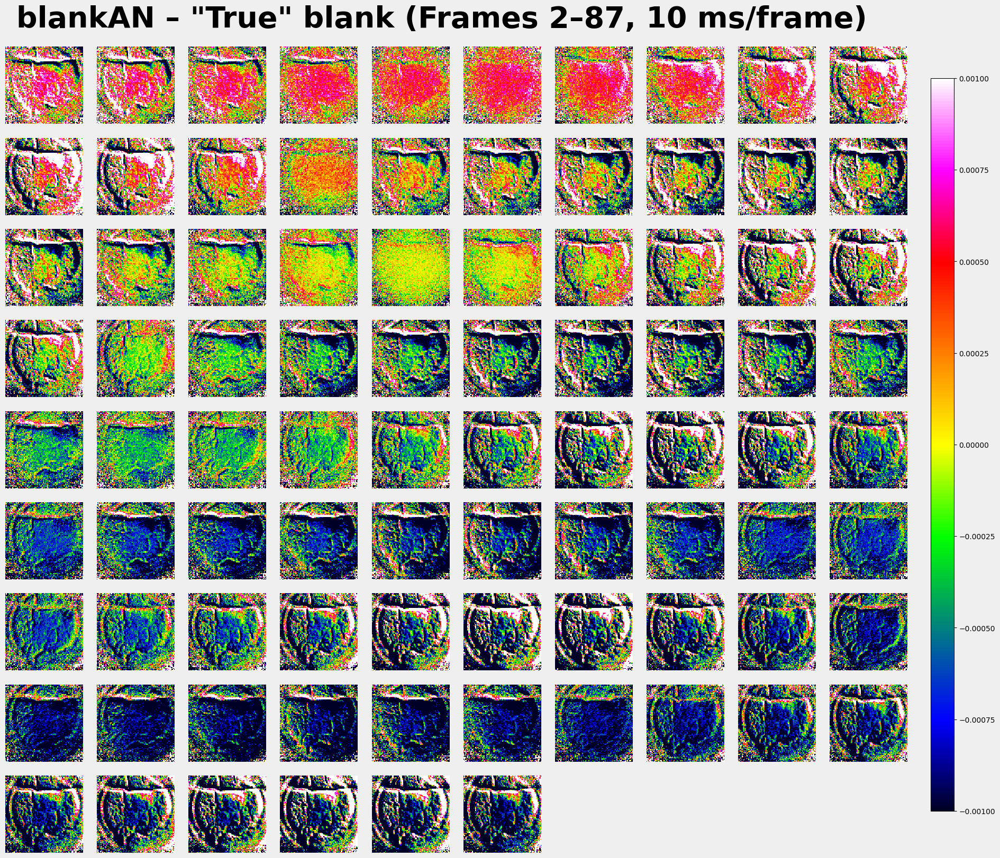

Saved: C:/Users/amity/Desktop/Learning/university/Msc/Vision Lab/Thesis/preprocessed_VSDdata/boromir_151221c\plots\boromir_151221c_blankAN.png


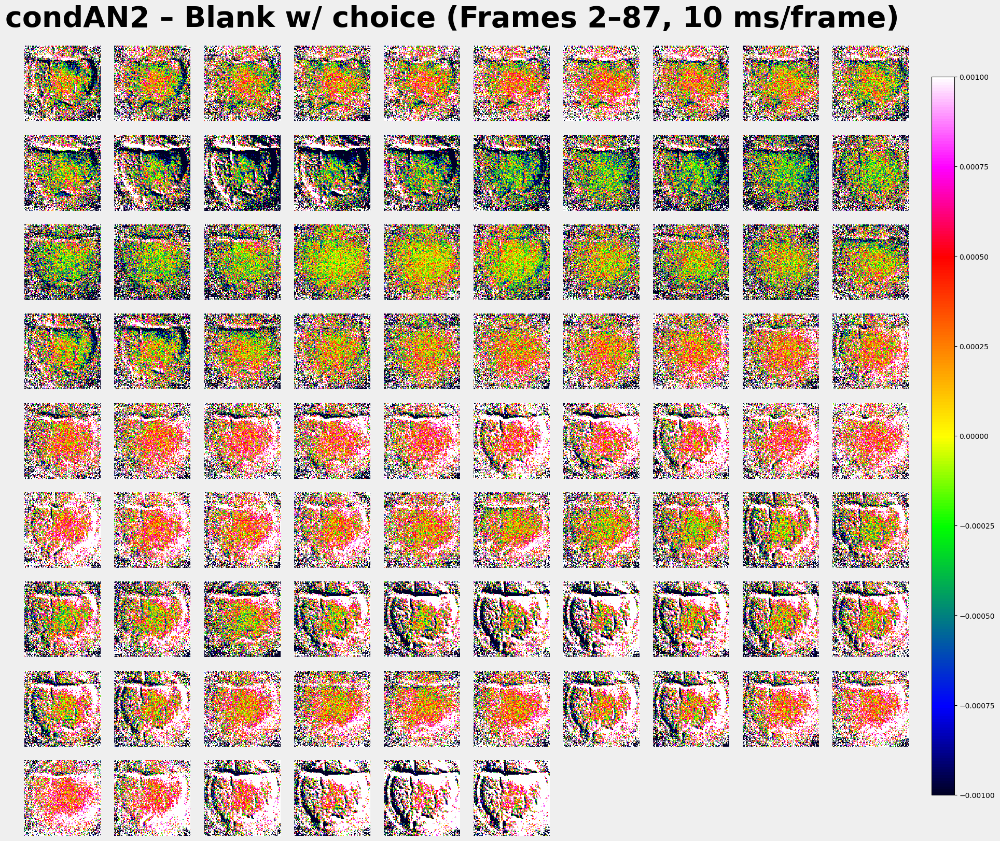

Saved: C:/Users/amity/Desktop/Learning/university/Msc/Vision Lab/Thesis/preprocessed_VSDdata/boromir_151221c\plots\boromir_151221c_condAN2.png


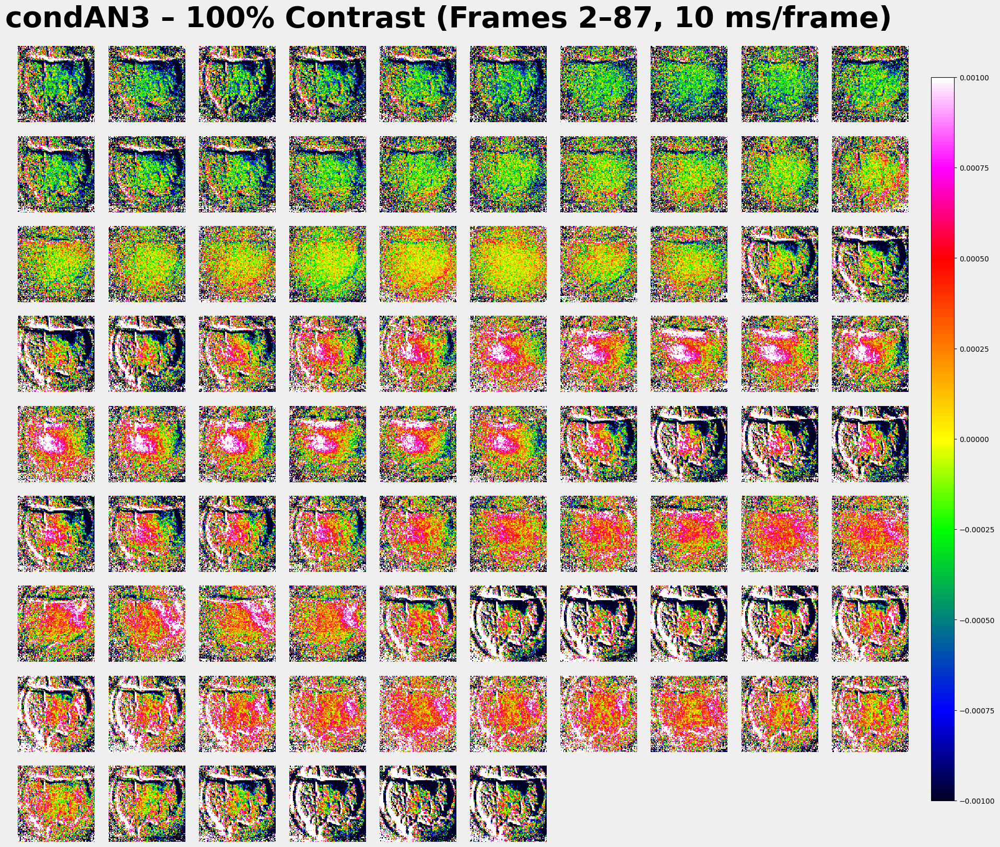

Saved: C:/Users/amity/Desktop/Learning/university/Msc/Vision Lab/Thesis/preprocessed_VSDdata/boromir_151221c\plots\boromir_151221c_condAN3.png


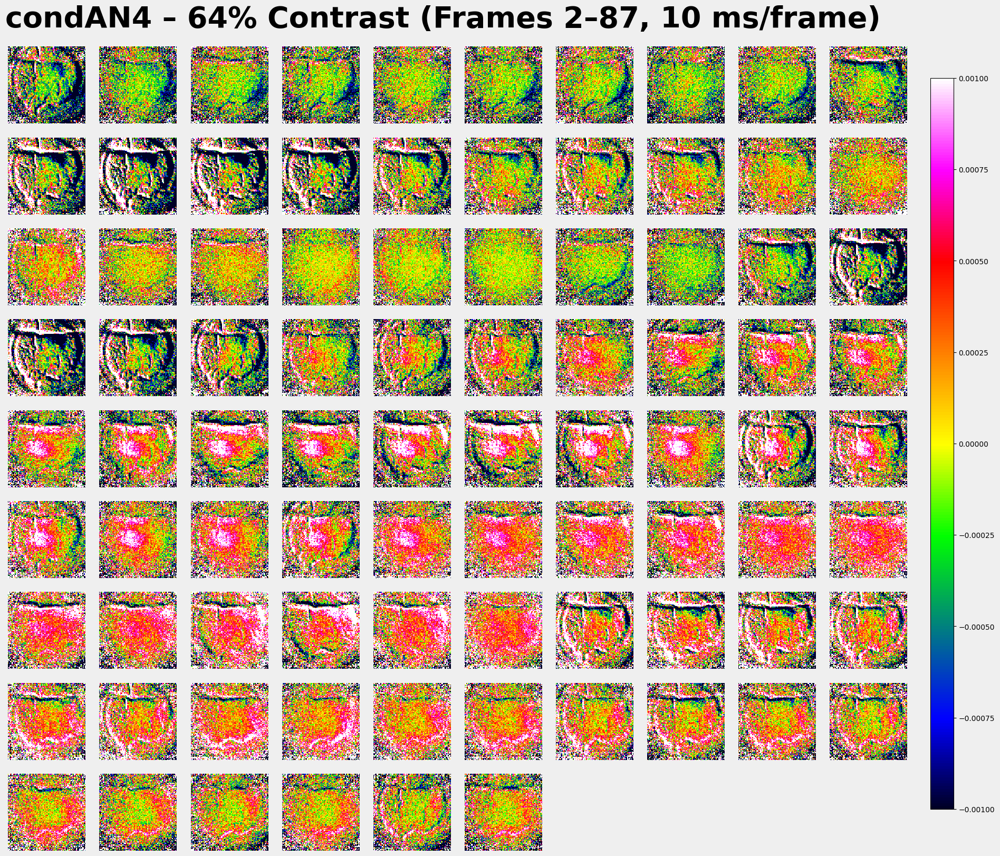

Saved: C:/Users/amity/Desktop/Learning/university/Msc/Vision Lab/Thesis/preprocessed_VSDdata/boromir_151221c\plots\boromir_151221c_condAN4.png


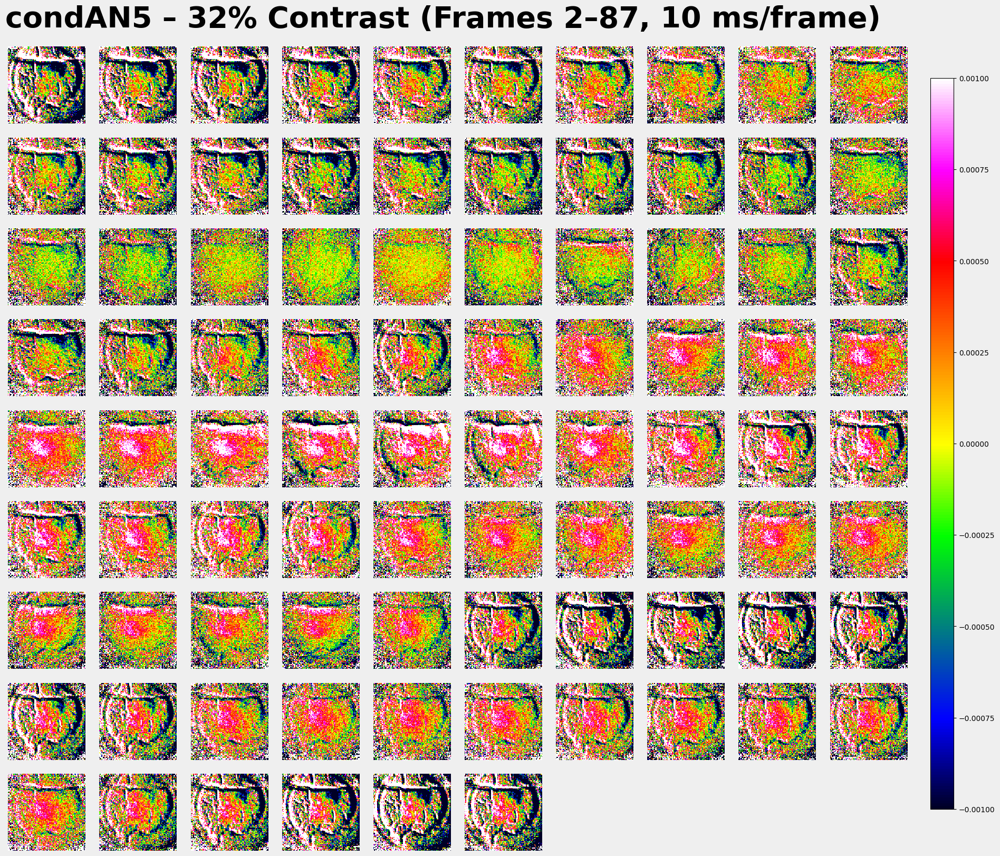

Saved: C:/Users/amity/Desktop/Learning/university/Msc/Vision Lab/Thesis/preprocessed_VSDdata/boromir_151221c\plots\boromir_151221c_condAN5.png


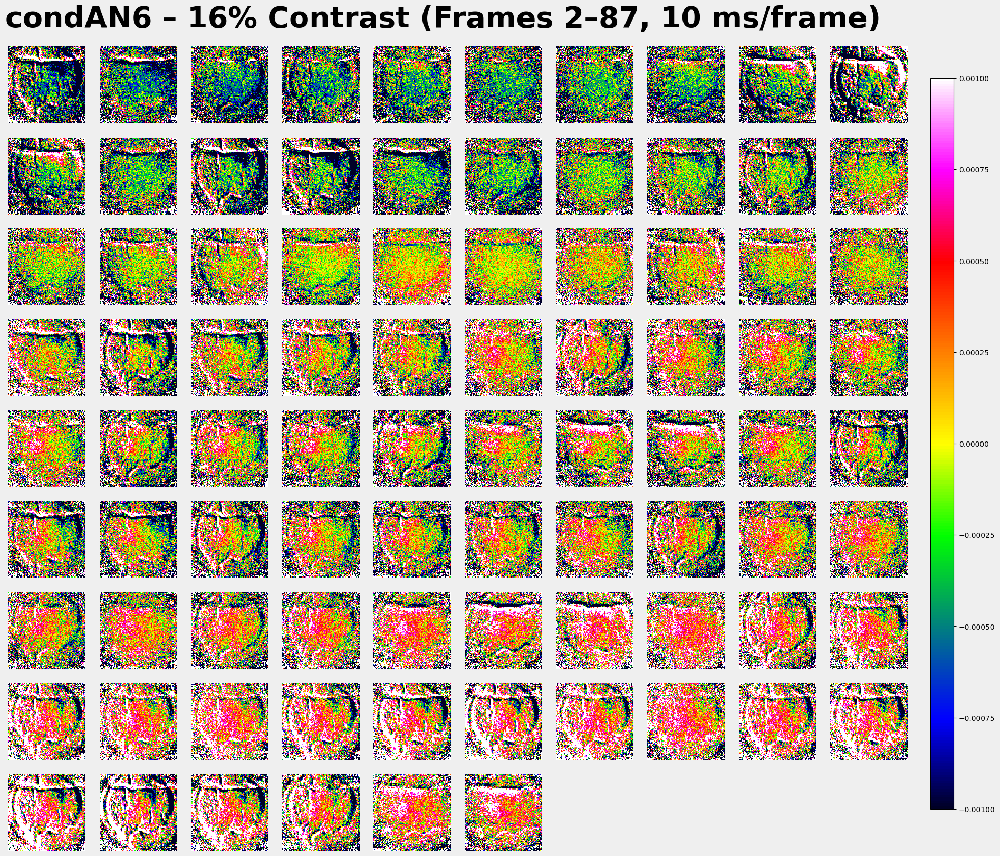

Saved: C:/Users/amity/Desktop/Learning/university/Msc/Vision Lab/Thesis/preprocessed_VSDdata/boromir_151221c\plots\boromir_151221c_condAN6.png


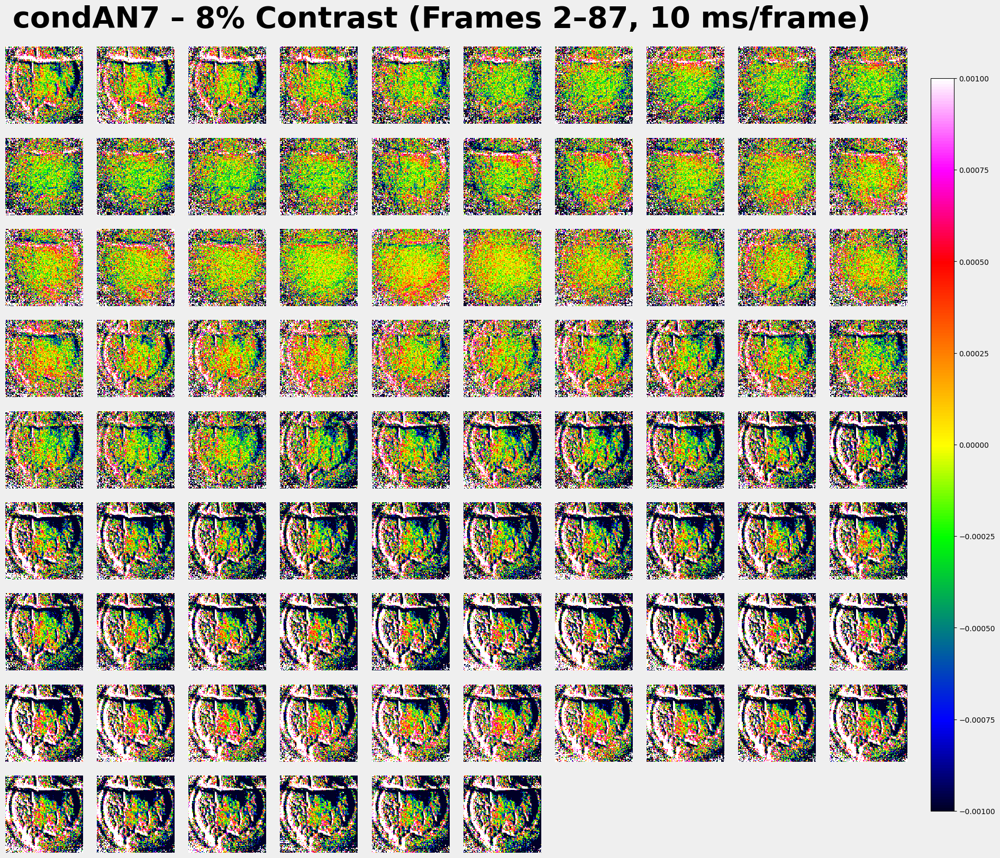

Saved: C:/Users/amity/Desktop/Learning/university/Msc/Vision Lab/Thesis/preprocessed_VSDdata/boromir_151221c\plots\boromir_151221c_condAN7.png


In [247]:
import os
import numpy as np
import matplotlib.pyplot as plt
import scipy.io  # <-- ensure this import

# If you truly have get_mapgeog_colormap(), keep it; otherwise fall back to 'gray'
try:
    mapgeog = get_mapgeog_colormap()
except NameError:
    mapgeog = 'gray'

def show_frames_grid(X, xsize=100, ysize=100, width=10,
                     vmin=-1e-3, vmax=1e-3,
                     cmap='gray', gap=0.18, bg='#eeeeee', border=1,
                     add_colorbar=True, title=None):
    X = np.asarray(X)
    m, n = X.shape
    assert m == xsize*ysize, f"Expected {xsize*ysize} pixels, got {m}"

    if isinstance(cmap, str):
        if cmap.lower() == 'mapgeog':
            cmap = get_mapgeog_colormap()
        else:
            cmap = plt.get_cmap(cmap)

    height = int(np.ceil(n / width))
    fig = plt.figure(figsize=(width*2.2, height*2.2), facecolor=bg)
    gs = fig.add_gridspec(height, width, wspace=gap, hspace=gap)

    k = 0
    for r in range(height):
        for c in range(width):
            ax = fig.add_subplot(gs[r, c])
            ax.set_facecolor(bg)
            ax.axis('off')
            if k < n:
                frame = X[:, k].reshape((ysize, xsize), order='F').T
                ax.imshow(frame, cmap=cmap, vmin=vmin, vmax=vmax,
                          origin='upper', interpolation='nearest')
                if border:
                    for spine in ax.spines.values():
                        spine.set_visible(True)
                        spine.set_color('white')
                        spine.set_linewidth(border)
                k += 1

    if add_colorbar:
        cbar_ax = fig.add_axes([0.92, 0.15, 0.02, 0.7])
        sm = plt.cm.ScalarMappable(cmap=cmap, norm=plt.Normalize(vmin=vmin, vmax=vmax))
        fig.colorbar(sm, cax=cbar_ax)

    if title:
        fig.suptitle(title, fontsize=40, weight='bold', y=0.92)

    plt.show()
    return fig

def to_PF_and_trialcount(A):
    """Return (P,F) array and n_trials; None,0 if empty/missing."""
    A = np.asarray(A)
    if A.size == 0:
        return None, 0
    if A.ndim == 3:              # (P,F,T)
        return A.mean(axis=2), A.shape[2]
    if A.ndim == 2:              # (P,F) already
        return A, 1
    return None, 0               # unexpected -> treat as missing


# === Load MATLAB file ===
mat_path = "C:/Users/amity/Desktop/Learning/university/Msc/Vision Lab/Thesis/preprocessed_VSDdata/boromir_151221c/condsAN.mat"
mat = scipy.io.loadmat(mat_path, squeeze_me=True, struct_as_record=False)

# === Derive session name automatically ===
session_name = os.path.basename(os.path.dirname(mat_path))

# Create save directory for plots
save_dir = os.path.join(os.path.dirname(mat_path), "plots")
os.makedirs(save_dir, exist_ok=True)

print(f"Session: {session_name}")
print(f"Saving plots to: {save_dir}")

py_start, py_end = 1, 87

for var_name in ['blankAN','condAN2','condAN3','condAN4','condAN5','condAN6','condAN7']:
    A2d, nT = to_PF_and_trialcount(mat.get(var_name, None))
    if A2d is None or nT == 0:
        print(f"Skipping {var_name}: empty/missing.")
        continue

    X = A2d[:, py_start:py_end] - 1.0  # keep if already normalized to ~1

    pretty_label = COND_TITLES.get(var_name, var_name)
    title_text = f"{var_name} – {pretty_label} (Frames {py_start+1}–{py_end}, 10 ms/frame)"

    fig = show_frames_grid(
        X, xsize=100, ysize=100, width=10,
        vmin=-1e-3, vmax=1e-3,
        cmap=mapgeog,
        gap=0.18, bg='#efefef', border=1,
        title=title_text
    )

    fname = f"{session_name}_{var_name}.png"
    save_path = os.path.join(save_dir, fname)
    fig.savefig(save_path, dpi=150, bbox_inches="tight")
    plt.close(fig)
    print(f"Saved: {save_path}")


### Averaging Condition Matrices → `conds_all_avg_*`

After loading the grouped matrices (`blankAN`, `condAN2`…`condAN7`),  
the next step is to average across trials for each condition:

- Each `condAN*` has shape `[pixels, frames, trials]`.  
- We average along the **trials dimension** → `[pixels, frames]` per condition.  
- Then, we stack all averaged conditions along a new 3rd axis → `[pixels, frames, n_conditions]`.

This produces the same type of structure as the manual’s *Averaged Matrices*  
(`conds_all_avg_fo`, `conds_all_avg_fz`, `conds_all_avg_bl`, etc.):contentReference[oaicite:0]{index=0}.

If blank normalization is applied:
- `blankAN` is averaged to create a reference baseline.
- Each condition’s average can then be divided by this baseline to obtain `conds_all_avg_bl`.

The result is an “all conditions averaged” matrix that mirrors what the MATLAB GUI would generate.


In [248]:
import re
import numpy as np
import scipy.io

mat_path = r"C:/Users/amity/Desktop/Learning/university/Msc/Vision Lab/Thesis/preprocessed_VSDdata/boromir_151221c/condsAN.mat"
mat = scipy.io.loadmat(mat_path, squeeze_me=True, struct_as_record=False)

# --- collect keys ---
blank = mat.get('blankAN', None)
cond_keys = sorted([k for k in mat.keys() if re.fullmatch(r"condAN\d+", k)],
                   key=lambda k: int(re.findall(r"\d+", k)[0]))
if blank is None:
    raise KeyError("blankAN not found.")
if not cond_keys:
    raise ValueError("No condAN* variables found.")

def to_3d_or_none(a):
    """Return (P,F,T) or None for empty/missing/scalar."""
    if a is None:
        return None
    a = np.asarray(a)
    if a.size == 0:        # MATLAB []
        return None
    if a.ndim == 0:        # scalar (e.g., 0)
        return None
    if a.ndim == 2:        # (P,F) -> add singleton trials dim
        return a[..., None]
    if a.ndim == 3:        # (P,F,T)
        return a
    return None

blank3 = to_3d_or_none(blank)
if blank3 is None:
    raise ValueError("blankAN is empty/missing in this session; cannot proceed.")

px, fr = blank3.shape[:2]

# Choose behavior for missing conditions:
FILL_MISSING_WITH_NAN = False  # set True if you want to keep all cond keys

conds3 = []
kept_keys = []
skipped = []
for k in cond_keys:
    a3 = to_3d_or_none(mat.get(k))
    if a3 is None:
        if FILL_MISSING_WITH_NAN:
            a3 = np.full((px, fr, 1), np.nan, dtype=float)  # placeholder
            print(f"{k}: missing/empty → filling with NaNs")
        else:
            print(f"{k}: missing/empty → skipping")
            skipped.append(k)
            continue
    if a3.shape[:2] != (px, fr):
        raise ValueError(f"{k} has mismatched dims {a3.shape[:2]} vs ({px},{fr})")
    conds3.append(a3)
    kept_keys.append(k)

# Averages
blank_avg = blank3.mean(axis=2)                # (P,F)
cond_avgs = [a.mean(axis=2) for a in conds3]   # list of (P,F)

# Stack (P,F,C)
if cond_avgs:
    conds_all_avg = np.stack(cond_avgs, axis=2)
else:
    conds_all_avg = np.empty((px, fr, 0), dtype=float)

# Optional blank normalization
APPLY_BLANK_NORM = False
if APPLY_BLANK_NORM:
    eps = 1e-12
    conds_all_avg_bl = conds_all_avg / (blank_avg[..., None] + eps)
else:
    conds_all_avg_bl = conds_all_avg

print("blank_avg:", blank_avg.shape)
print("conds_all_avg_bl:", conds_all_avg_bl.shape)
print("kept condition keys:", kept_keys)
if skipped:
    print("skipped (empty):", skipped)

# Save
scipy.io.savemat(
    mat_path.replace("condsAN.mat", "conds_all_avg_from_python.mat"),
    {
        "blank_avg": blank_avg,
        "conds_all_avg_bl": conds_all_avg_bl,
        "cond_names": np.array(kept_keys, dtype=object),  # only those present (or filled)
    }
)


blank_avg: (10000, 256)
conds_all_avg_bl: (10000, 256, 6)
kept condition keys: ['condAN2', 'condAN3', 'condAN4', 'condAN5', 'condAN6', 'condAN7']


# Func time course

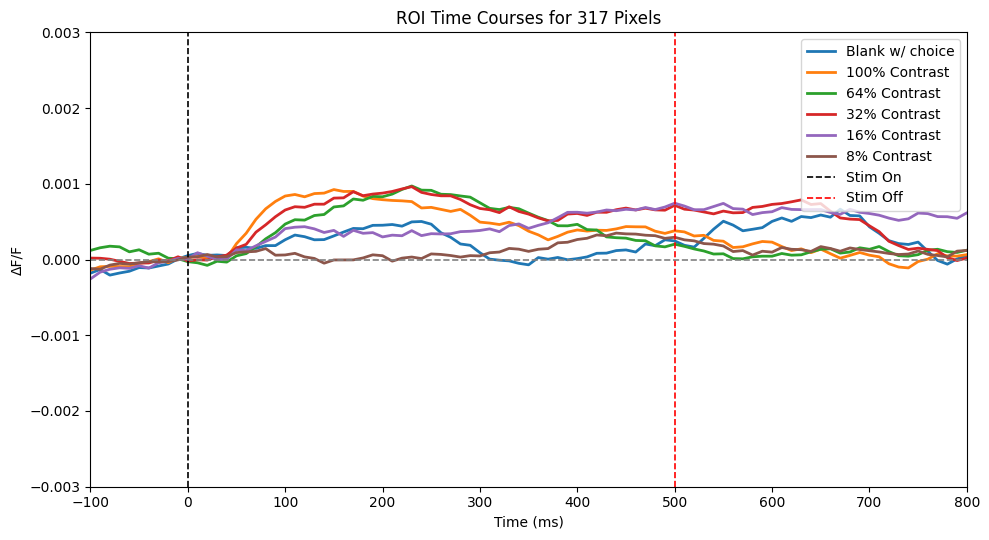

Saved time-course figure to: C:\Users\amity\Desktop\Learning\university\Msc\Vision Lab\Thesis\preprocessed_VSDdata\boromir_151221c\plots\crf\boromir_151221c_CRF_x45_y45_r10.png


In [251]:
import os
from pathlib import Path
import numpy as np
import matplotlib.pyplot as plt

CONDITIONS_ORDER = ['condAN2', 'condAN3', 'condAN4', 'condAN5', 'condAN6', 'condAN7']


def _start_stop(frames):
    if frames is None:
        return None, None
    if isinstance(frames, slice):
        return frames.start, frames.stop
    if isinstance(frames, (tuple, list)) and len(frames) == 2:
        return frames[0], frames[1]
    raise TypeError(f"frames must be slice or (start, stop); got {type(frames)}: {frames}")

def compute_dff(data, cond=None, frames=None, dff_mode="minus1",
                baseline_frames=(24, 27)):
    """
    data: (P,F,C) or (P,F)
    cond: 0-based condition index if data is 3D
    frames: slice or (start, stop) or None -> select returned time range
    baseline_frames: slice or (start, stop) -> used in 'baseline' mode
    """
    # Select condition if 3D
    if data.ndim == 3:
        X = data.mean(axis=2) if cond is None else data[:, :, cond]
    elif data.ndim == 2:
        X = data
    else:
        raise ValueError("data must be (P,F,C) or (P,F)")

    # Limit to requested frames (if any)
    fs, fe = _start_stop(frames)
    if fs is not None:
        X = X[:, fs:fe]

    if dff_mode == "minus1":
        # Assumes input already normalized to frame0/blank so baseline ≈ 1
        return X - 1.0

    elif dff_mode == "baseline":
        bs, be = _start_stop(baseline_frames)
        if bs is None:
            raise ValueError("baseline_frames must be slice or (start, stop)")
        base = X[:, bs:be].mean(axis=1, keepdims=True)
        return X - base

    elif dff_mode == "raw":
        return X

    else:
        raise ValueError("dff_mode must be 'minus1', 'baseline', or 'raw'.")



# --- circular ROI mask --------------------------------------------------------
def circle_roi_mask(seed_xy, radius_px, image_shape=(100,100)):
    h, w = image_shape
    yy, xx = np.mgrid[0:h, 0:w]
    mask2d = (xx - seed_xy[0])**2 + (yy - seed_xy[1])**2 <= radius_px**2
    return mask2d.T.reshape(h*w, order="F")

# --- plot & SAVE all conditions ----------------------------------------------
def plot_roi_timecourses_by_name(
    conds_all_avg_bl,                 # (P,F,C)
    seed_xy, radius_px,
    image_shape=(100,100),
    conditions_order=CONDITIONS_ORDER,
    include_names=None,               # e.g. ['condAN3','condAN4']; default = all
    cond_titles=COND_TITLES,
    blank_avg=None,                   # optional (P,F) for "True blank"
    include_blank=False,              # set True to add blank_avg trace
    dff_mode="minus1",
    baseline_frames=(24,27),
    frame_onset=27, frame_rate=100.0,
    stim_duration_ms=500,
    xlim_ms=(-100, 800), ylim=(-0.003, 0.003),
    linewidth=2.0,
    # saving
    save_dir=None, save_tag=None, save_dpi=200
):
    """
    Plots ΔF/F time courses for the circular ROI across named conditions.
    If save_dir is provided, saves PNG to that folder and returns its path.
    Returns: t_ms, traces, labels, saved_path (or None if not saved)
    """
    h, w = image_shape
    P = h*w
    if conds_all_avg_bl.shape[0] != P:
        raise ValueError(f"image_shape {image_shape} != pixels {conds_all_avg_bl.shape[0]}")

    # map names -> indices (0..C-1) according to conditions_order
    name_to_idx = {name: i for i, name in enumerate(conditions_order)}

    # which names to plot
    names = list(conditions_order) if include_names is None else list(include_names)

    # ROI mask
    mask1d = circle_roi_mask(seed_xy, radius_px, image_shape)
    n_pix = int(mask1d.sum())

    # time axis (ms) with onset at 0
    F = conds_all_avg_bl.shape[1]
    onset_py = frame_onset - 1
    t_ms = (np.arange(F) - onset_py) * (1000.0 / frame_rate)

    # collect traces
    traces = []
    labels = []
    for nm in names:
        if nm not in name_to_idx:
            raise ValueError(f"Condition name '{nm}' not found in conditions_order.")
        c = name_to_idx[nm]
        dff_all = compute_dff(conds_all_avg_bl, cond=c, frames=None,
                              dff_mode=dff_mode, baseline_frames=baseline_frames)
        traces.append(dff_all[mask1d, :].mean(axis=0))
        labels.append(cond_titles.get(nm, nm))

    # optional blank
    if include_blank:
        if blank_avg is None:
            raise ValueError("include_blank=True but blank_avg is None.")
        dff_blank = compute_dff(blank_avg, cond=None, frames=None,
                                dff_mode=dff_mode, baseline_frames=baseline_frames)
        traces.append(dff_blank[mask1d, :].mean(axis=0))
        labels.append(cond_titles.get('blankAN', 'Blank'))

    traces = np.vstack(traces)  # (N, F)

    # plot
    fig = plt.figure(figsize=(10, 5.5))
    for lab, tr in zip(labels, traces):
        plt.plot(t_ms, tr, lw=linewidth, label=lab)

    plt.axvline(0, color="k", ls="--", lw=1.2, label="Stim On")
    if stim_duration_ms is not None:
        plt.axvline(stim_duration_ms, color="r", ls="--", lw=1.2, label="Stim Off")
    plt.axhline(0, color="grey", ls="--", lw=1.2)
    plt.xlabel("Time (ms)")
    plt.ylabel("ΔF/F")
    plt.title(f"ROI Time Courses for {n_pix} Pixels")
    plt.xlim(*xlim_ms)
    plt.ylim(*ylim)
    plt.legend(loc="upper right", frameon=True)
    plt.tight_layout()

    saved_path = None
    if save_dir is not None:
        Path(save_dir).mkdir(parents=True, exist_ok=True)
        tag = save_tag or f"roi_tc_x{seed_xy[0]}_y{seed_xy[1]}_r{radius_px}"
        saved_path = str(Path(save_dir) / f"{tag}.png")
        fig.savefig(saved_path, dpi=save_dpi, bbox_inches="tight")
    plt.show()

    return t_ms, traces, labels, saved_path




# seed and radius you chose on the map
seed_xy   = (45, 45)
radius_px = 10

# Derive a session-based save folder
session_name = os.path.basename(os.path.dirname(mat_path))
save_dir = os.path.join(os.path.dirname(mat_path), "plots", "crf")
os.makedirs(save_dir, exist_ok=True)

# A readable tag for filenames
save_tag = f"{session_name}_CRF_x{seed_xy[0]}_y{seed_xy[1]}_r{radius_px}"

t_ms, traces, labels, fig_path = plot_roi_timecourses_by_name(
    conds_all_avg_bl,
    seed_xy=seed_xy, radius_px=radius_px,
    image_shape=(100,100),
    conditions_order=CONDITIONS_ORDER,
    include_names=None,              # None -> all in CONDITIONS_ORDER
    cond_titles=COND_TITLES,
    blank_avg=None, include_blank=False,
    dff_mode="minus1",
    baseline_frames=(24,27),
    frame_onset=27, frame_rate=100.0,
    stim_duration_ms=500,
    xlim_ms=(-100, 800), ylim=(-0.003, 0.003),
    linewidth=2.0,
    save_dir=save_dir, save_tag=save_tag, save_dpi=200  # <-- save here
)

print("Saved time-course figure to:", fig_path)

# crf

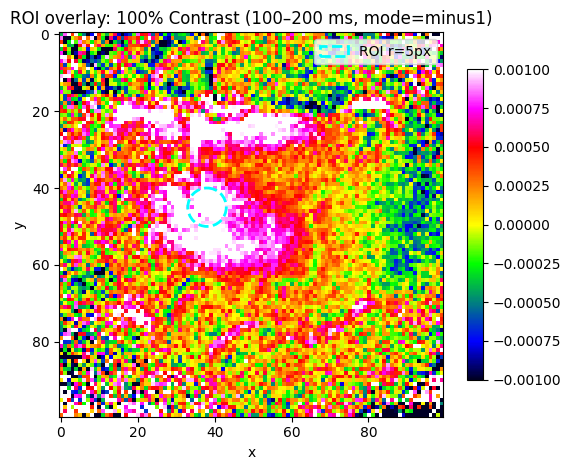

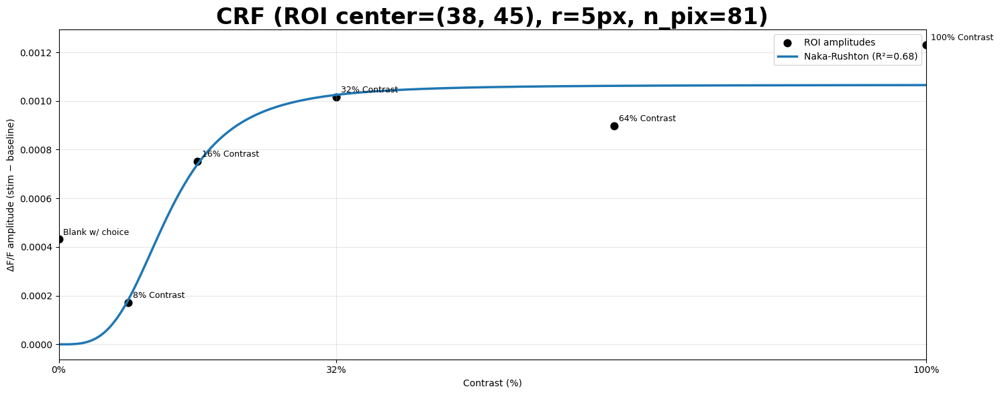

Saved files:
overlay: C:\Users\amity\Desktop\Learning\university\Msc\Vision Lab\Thesis\preprocessed_VSDdata\boromir_151221c\plots\crf\boromir_151221c_CRF_x38_y45_r5_overlay_condAN3.png
crf_plot: C:\Users\amity\Desktop\Learning\university\Msc\Vision Lab\Thesis\preprocessed_VSDdata\boromir_151221c\plots\crf\boromir_151221c_CRF_x38_y45_r5_crf.png
crf_csv: C:\Users\amity\Desktop\Learning\university\Msc\Vision Lab\Thesis\preprocessed_VSDdata\boromir_151221c\plots\crf\boromir_151221c_CRF_x38_y45_r5_crf_points.csv


In [ ]:
import os
from pathlib import Path
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit
from sklearn.metrics import r2_score
from scipy.ndimage import gaussian_filter1d

# ------------------ config / metadata ------------------

# Display names for conditions
COND_TITLES = {
    'blankAN': '"True" blank',
    'condAN2': 'Blank w/ choice',
    'condAN3': '100% Contrast',
    'condAN4': '64% Contrast',
    'condAN5': '32% Contrast',
    'condAN6': '16% Contrast',
    'condAN7': '8% Contrast',
}

# Order of conditions along the 3rd axis of conds_all_avg_bl
CONDITIONS_ORDER = ['condAN2', 'condAN3', 'condAN4', 'condAN5', 'condAN6', 'condAN7']

# Contrast values (in %) by condition name
CONTRAST_BY_NAME = {
    'blankAN': 0,
    'condAN2': 0,    # blank w/ choice
    'condAN3': 100,
    'condAN4': 64,
    'condAN5': 32,
    'condAN6': 16,
    'condAN7': 8,
}

# ------------------ helpers ------------------

def compute_dff(data, cond=None, frames=None, dff_mode="minus1",
                baseline_frames=(24, 27)):
    """
    data: (P,F,C) or (P,F)
    cond: index for 3D; ignored for 2D
    frames: optional (start, end) frame slice (end exclusive)
    dff_mode:
      - 'minus1'   : returns X - 1.0         (if your data are F/F0)
      - 'baseline' : returns X - mean(baseline_frames)
      - 'raw'      : returns X unchanged     (if already ΔF/F and blank-corrected)
    returns: (P, F_sel)
    """
    if data.ndim == 3:
        X = data[:, :, cond] if cond is not None else data.mean(axis=2)
    elif data.ndim == 2:
        X = data
    else:
        raise ValueError("data must be (P,F,C) or (P,F)")

    if frames is not None:
        s, e = frames
        X = X[:, s:e]

    if dff_mode == "minus1":
        return X - 1.0
    elif dff_mode == "baseline":
        b0, b1 = baseline_frames
        base = X[:, b0:b1].mean(axis=1, keepdims=True)
        return X - base
    elif dff_mode == "raw":
        return X
    else:
        raise ValueError("dff_mode must be 'minus1', 'baseline', or 'raw'.")

def _circle_roi_mask(seed_xy, radius_px, image_shape=(100,100)):
    h, w = image_shape
    yy, xx = np.mgrid[0:h, 0:w]
    m2d = (xx - seed_xy[0])**2 + (yy - seed_xy[1])**2 <= radius_px**2
    return m2d.T.reshape(h*w, order="F")

def _ms_window_to_slice(window_ms, frame_onset=27, frame_rate=100.0, n_frames=None):
    """
    window_ms: (start_ms, end_ms) relative to onset (0 at onset).
    returns a Python slice [start, end) clipped to [0, n_frames).
    """
    onset_py = frame_onset - 1
    ms_per_frame = 1000.0 / frame_rate
    s = int(np.floor(onset_py + window_ms[0] / ms_per_frame))
    e = int(np.ceil (onset_py + window_ms[1] / ms_per_frame))
    s = max(0, s)
    if n_frames is not None:
        e = min(n_frames, e)
        if e <= s:
            e = min(n_frames, s + 1)
    return slice(s, e)

# ------------------ model ------------------

def naka_rushton(c, Rmax, c50, n):
    c = np.asarray(c, dtype=float)
    return Rmax * (c**n) / (c**n + c50**n)

# ------------------ optional parameter bar plot ------------------

def plot_model_parameters(fit_results, save_dir=None, save_tag="crf"):
    param_labels = {"Naka-Rushton": ["Rmax", "c50", "n"]}
    fig, axes = plt.subplots(1, len(fit_results), figsize=(12, 4.5))
    if len(fit_results) == 1:
        axes = [axes]
    for ax, (name, res) in zip(axes, fit_results.items()):
        labels = param_labels[name]
        ax.bar(range(len(labels)), res["params"], tick_label=labels)
        ax.set_title(name)
        ax.grid(True, alpha=0.3)
    plt.suptitle("Model Parameter Comparison", fontsize=14)
    plt.tight_layout()
    if save_dir:
        Path(save_dir).mkdir(parents=True, exist_ok=True)
        fig.savefig(Path(save_dir) / f"{save_tag}_param_bars.png", dpi=200, bbox_inches="tight")
    plt.show()

# ------------------ main CRF function ------------------

def crf_from_roi_by_name(
    conds_all_avg_bl,                 # (P,F,C)
    seed_xy, radius_px,
    image_shape=(100,100),
    include_names=None,               # default: all in CONDITIONS_ORDER
    blank_avg=None, include_blank=False,
    dff_mode="minus1", baseline_frames=(24,27),
    frame_onset=27, frame_rate=100.0,
    amplitude_mode="mean", peak_smooth_sigma=1.0,
    baseline_ms=(-170, 0), stim_ms=(100, 300),
    fit_include_blank=False,          # NEW: exclude 0% from fit but still plot
    # plotting
    cmap=None, overlay=True, overlay_name='condAN3', overlay_ms=(100,200),
    overlay_clim=(-1e-3, 1e-3),
    # saving
    save_dir=None, save_tag=None, save_csv=True, save_dpi=200
):
    """
    1) Shows ROI overlay map for 'overlay_name' over 'overlay_ms'.
    2) Computes CRF amplitudes per condition using amplitude_mode ('mean'/'peak').
    3) Fits Naka–Rushton model; can exclude 0% from the fit while still plotting it.

    Returns:
      crf_df: {'names', 'contrasts', 'amplitudes'}
      fit_results: dict of model fits
      saved: dict of saved file paths
    """
    h, w = image_shape
    P, F = conds_all_avg_bl.shape[:2]
    assert P == h*w, "image_shape mismatch."

    names = CONDITIONS_ORDER if include_names is None else list(include_names)

    # ROI mask
    mask1d = _circle_roi_mask(seed_xy, radius_px, image_shape)
    n_pix = int(mask1d.sum())

    # slices from ms
    base_sl = _ms_window_to_slice(baseline_ms, frame_onset, frame_rate, F)
    stim_sl = _ms_window_to_slice(stim_ms,     frame_onset, frame_rate, F)

    # filenames
    base_tag = save_tag or f"crf_roi_x{seed_xy[0]}_y{seed_xy[1]}_r{radius_px}px"
    saved = {}
    if save_dir:
        Path(save_dir).mkdir(parents=True, exist_ok=True)

    # -------- overlay map (optional) --------
    if overlay:
        if overlay_name not in names:
            pass  # still okay to show
        idx_ov = CONDITIONS_ORDER.index(overlay_name)
        dff_ov = compute_dff(conds_all_avg_bl, cond=idx_ov,
                             frames=_ms_window_to_slice(overlay_ms, frame_onset, frame_rate, F),
                             dff_mode=dff_mode, baseline_frames=baseline_frames)
        avg_map = dff_ov.mean(axis=1).reshape((h, w), order="F").T
        fig, ax = plt.subplots(figsize=(6.2, 6.2))
        im = ax.imshow(avg_map, cmap=(cmap if cmap is not None else "hot"),
                       vmin=overlay_clim[0], vmax=overlay_clim[1])
        circ = plt.Circle(seed_xy, radius_px, color="cyan", fill=False, lw=2, ls="--",
                          label=f"ROI r={radius_px}px")
        ax.add_patch(circ)
        plt.colorbar(im, ax=ax, shrink=0.65)
        ax.set_title(f"ROI overlay: {COND_TITLES.get(overlay_name, overlay_name)} "
                     f"({overlay_ms[0]}–{overlay_ms[1]} ms, mode={dff_mode})")
        ax.set_xlabel("x"); ax.set_ylabel("y")
        ax.legend(loc="upper right")
        if save_dir:
            fpath = Path(save_dir) / f"{base_tag}_overlay_{overlay_name}.png"
            fig.savefig(fpath, dpi=save_dpi, bbox_inches="tight")
            saved["overlay"] = str(fpath)
        plt.show()

    # -------- compute amplitudes per condition --------
    contrasts = []
    amps = []

    for nm in names:
        cidx = CONDITIONS_ORDER.index(nm)
        dff = compute_dff(conds_all_avg_bl, cond=cidx, frames=None,
                          dff_mode=dff_mode, baseline_frames=baseline_frames)
        roi_trace = dff[mask1d, :].mean(axis=0)   # ROI average time course
        base_mean = roi_trace[base_sl].mean()
        if amplitude_mode == "mean":
            amp = roi_trace[stim_sl].mean() - base_mean
        elif amplitude_mode == "peak":
            sm = gaussian_filter1d(roi_trace.astype(float),
                                   sigma=peak_smooth_sigma, mode="nearest")
            amp = sm[stim_sl].max() - base_mean
        else:
            raise ValueError("amplitude_mode must be 'mean' or 'peak'")

        contrasts.append(CONTRAST_BY_NAME[nm])
        amps.append(amp)

    # optional separate "true blank"
    if include_blank:
        if blank_avg is None:
            raise ValueError("include_blank=True but blank_avg is None.")
        dff_b = compute_dff(blank_avg, cond=None, frames=None,
                            dff_mode=dff_mode, baseline_frames=baseline_frames)
        roi_trace_b = dff_b[mask1d, :].mean(axis=0)
        base_mean_b = roi_trace_b[base_sl].mean()
        if amplitude_mode == "mean":
            amp_b = roi_trace_b[stim_sl].mean() - base_mean_b
        elif amplitude_mode == "peak":
            sm_b = gaussian_filter1d(roi_trace_b.astype(float),
                                     sigma=peak_smooth_sigma, mode="nearest")
            amp_b = sm_b[stim_sl].max() - base_mean_b
        else:
            raise ValueError("amplitude_mode must be 'mean' or 'peak'")
        contrasts.append(CONTRAST_BY_NAME['blankAN'])
        amps.append(amp_b)
        names.append('blankAN')

    contrasts = np.asarray(contrasts, dtype=float)
    amplitudes = np.asarray(amps, dtype=float)
    sort_idx = np.argsort(contrasts)
    contrasts_s = contrasts[sort_idx]
    amplitudes_s = amplitudes[sort_idx]
    names_s = [names[i] for i in sort_idx]

    # -------- fit model (optionally exclude blank from the fit) --------
    if fit_include_blank:
        fit_mask = np.ones_like(contrasts_s, dtype=bool)
    else:
        fit_mask = contrasts_s > 0

    xfit = contrasts_s[fit_mask]
    yfit = amplitudes_s[fit_mask]

    p0_nr   = [yfit.max() if yfit.size else 1e-3, 15.0, 2.0]
    bnds_nr = ([0.0, 1e-3, 0.5],
               [max(0.02, (yfit.max()*5 if yfit.size else 0.02)), 100.0, 6.0])

    fit_results = {}

    def _fit_and_metrics(x, y, f, p0, bounds):
        try:
            popt, _ = curve_fit(f, x, y, p0=p0, bounds=bounds, maxfev=10000)
            yhat = f(x, *popt)
            r2 = r2_score(y, yhat)
            rmse = np.sqrt(np.mean((y - yhat)**2))
            k = len(popt); n = len(y)
            sse = np.sum((y - yhat)**2)
            aic = n*np.log(sse/n) + 2*k
            return popt, r2, rmse, aic
        except Exception:
            return None, None, None, None

    popt, r2, rmse, aic = _fit_and_metrics(xfit, yfit, naka_rushton, p0_nr, bnds_nr)
    if popt is not None:
        fit_results["Naka-Rushton"] = {"params": popt, "R²": r2, "RMSE": rmse, "AIC": aic}

    # -------- plot CRF + fits --------
    c_fit = np.linspace(0, 100, 400)
    fig = plt.figure(figsize=(15, 6))
    # data (all points, including blank)
    labels = [COND_TITLES.get(nm, nm) for nm in names_s]
    plt.scatter(contrasts_s, amplitudes_s, s=60, color='k', label="ROI amplitudes")
    for x, y, lab in zip(contrasts_s, amplitudes_s, labels):
        plt.annotate(lab, (x, y), textcoords="offset points", xytext=(5,5), fontsize=9)
    # fit curve
    if "Naka-Rushton" in fit_results:
        p = fit_results["Naka-Rushton"]["params"]
        plt.plot(c_fit, naka_rushton(c_fit, *p), lw=2.5,
                 label=f"Naka-Rushton (R²={fit_results['Naka-Rushton']['R²']:.2f})")
    plt.xlabel("Contrast (%)")
    plt.ylabel("ΔF/F amplitude (stim − baseline)")
    plt.title(f"CRF (ROI center={seed_xy}, r={radius_px}px, n_pix={n_pix})", fontsize=24, weight='bold')
    plt.xlim(0, 100)
    xticks = [0, 8, 16, 32, 64, 100]
    plt.xticks(xticks, [f"{v}%" for v in xticks])
    plt.grid(True, alpha=0.3)
    plt.legend()
    plt.tight_layout()
    if save_dir:
        fpath = Path(save_dir) / f"{base_tag}_crf.png"
        fig.savefig(fpath, dpi=save_dpi, bbox_inches="tight")
        saved["crf_plot"] = str(fpath)
    plt.show()

    # optional CSV
    if save_dir and save_csv:
        csv_path = Path(save_dir) / f"{base_tag}_crf_points.csv"
        header = "name,contrast_percent,amplitude_dff"
        rows = [f"{nm},{c:.6g},{a:.8g}" for nm, c, a in zip(names_s, contrasts_s, amplitudes_s)]
        csv_path.write_text(header + "\n" + "\n".join(rows), encoding="utf-8")
        saved["crf_csv"] = str(csv_path)

    crf_df = {"names": names_s, "contrasts": contrasts_s, "amplitudes": amplitudes_s}
    return crf_df, fit_results, saved


# ------------------ example call ------------------

# Choose ROI
seed_xy   = (38, 45)
radius_px = 5

# Derive a session-based save folder (expects you already set mat_path)
session_name = os.path.basename(os.path.dirname(mat_path))
save_dir = os.path.join(os.path.dirname(mat_path), "plots", "crf")
os.makedirs(save_dir, exist_ok=True)

# Base tag for filenames
save_tag = f"{session_name}_CRF_x{seed_xy[0]}_y{seed_xy[1]}_r{radius_px}"

crf_df, fit_results, saved_paths = crf_from_roi_by_name(
     conds_all_avg_bl=conds_all_avg_bl,   # (P,F,C)
     seed_xy=seed_xy, radius_px=radius_px,
     image_shape=(100,100),
     include_names=None,                   # -> all in CONDITIONS_ORDER
     blank_avg=blank_avg, include_blank=False,
     amplitude_mode="mean", peak_smooth_sigma=1.0,
     dff_mode="raw", baseline_frames=(24,27),  # set to "raw" if already ΔF/F & blank-corrected
     frame_onset=27, frame_rate=100.0,
     baseline_ms=(-30, 0),
     stim_ms=(100, 200),
     fit_include_blank=False,             # exclude 0% from the fit
     cmap=mapgeog,
     overlay=True, overlay_name='condAN3', overlay_ms=(100,200),
     overlay_clim=(-1e-3, 1e-3),
     save_dir=save_dir,
     save_tag=save_tag,
     save_csv=True, save_dpi=200
)

print("Saved files:")
for name, path in saved_paths.items():
    print(f"{name}: {path}")


# Run on conditions across days

Created colormap 'mapgeog' with 256 colors.
[DEBUG] Raw df0 shape: (17, 22)
[DEBUG] Detected header row: 1
[DEBUG] Headers row content:
  [00] 'Date'
  [01] 'Session'
  [02] 'Remarks'
  [03] 'Paradigm'
  [04] 'Stimulus Duration (starting frame)'
  [05] 'Target Size'
  [06] 'Target Location (HM;VM)'
  [07] 1
  [08] 2
  [09] 3
  [10] np.float64(4.0)
  [11] np.float64(5.0)
  [12] np.float64(6.0)
  [13] np.float64(7.0)
  [14] 8
  [15] 'Conditions File'
  [16] 'Timing File'
  [17] 'BHV file'
  [18] 'Fixation duration'
  [19] 'Precue'
  [20] 'Trials'
  [21] 'Noisy Trials'
[DEBUG] Condition schema (orig_col_idx -> cond_id): [(7, 1), (8, 2), (9, 3), (10, 4), (11, 5), (12, 6), (13, 7), (14, 8)]
[DEBUG] Loaded 15 non-empty session rows under header
[DEBUG] Fill-down on column 'date': NaNs 10 -> 0
[DEBUG] ----- Session-row 0 -----
[DEBUG] Raw 'Date' cell: Timestamp('2021-12-01 00:00:00')
[DEBUG] Raw 'Session' cell: 'b'
[_best_date_letter] raw_date=Timestamp('2021-12-01 00:00:00') -> date_code=011

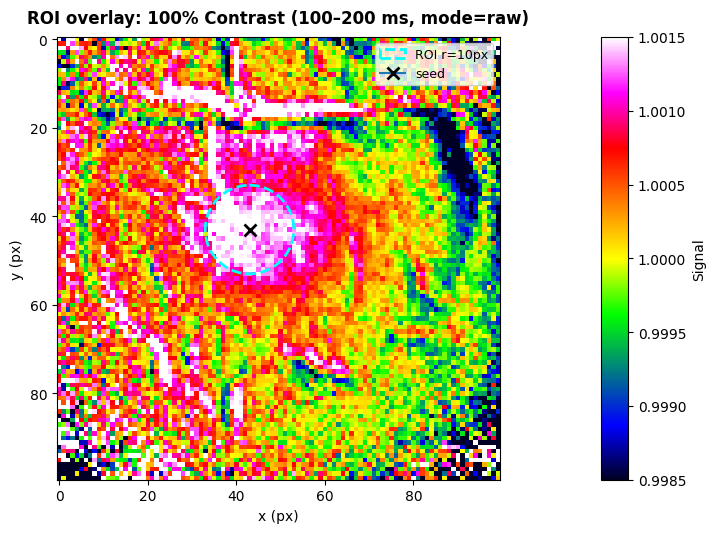

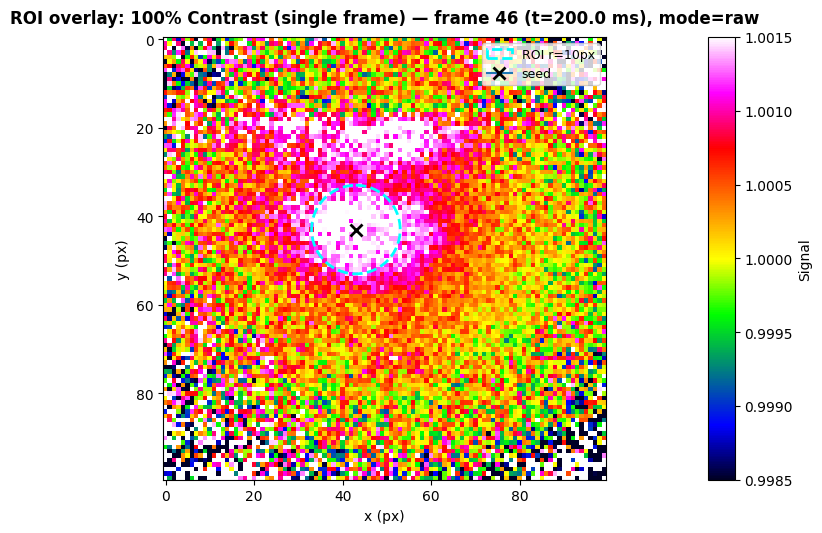

[DEBUG] 151221c: condAN8 not found or empty, skip
[DEBUG] Saved: C:\Users\amity\Desktop\Learning\university\Msc\Vision Lab\Thesis\preprocessed_VSDdata\_overlays_by_contrast_from_excel_roi\sameDayColor\roiR10_auto1_boxX30-60_boxY30-60_seedC100_win100-200_moderaw_fbd2fe\overlay_4pct_roi_same.png


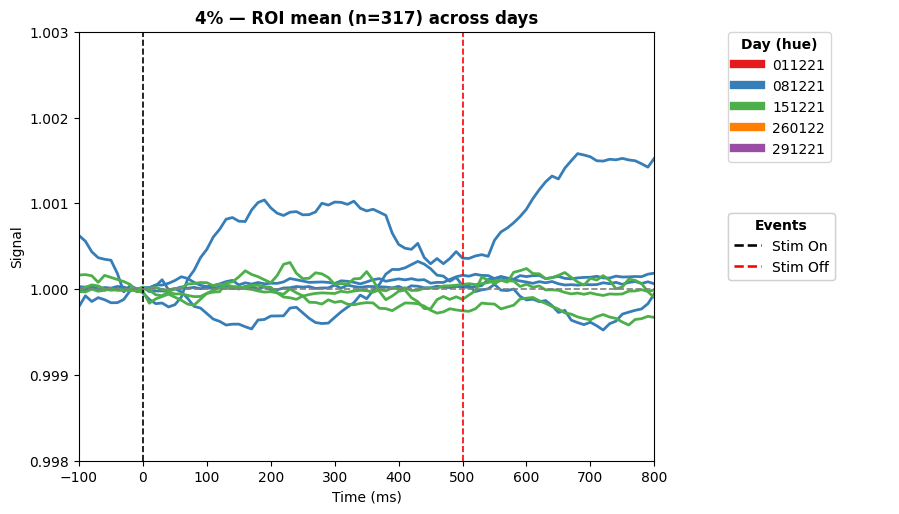

[DEBUG] Saved: C:\Users\amity\Desktop\Learning\university\Msc\Vision Lab\Thesis\preprocessed_VSDdata\_overlays_by_contrast_from_excel_roi\sameDayColor\roiR10_auto1_boxX30-60_boxY30-60_seedC100_win100-200_moderaw_fbd2fe\overlay_8pct_roi_same.png


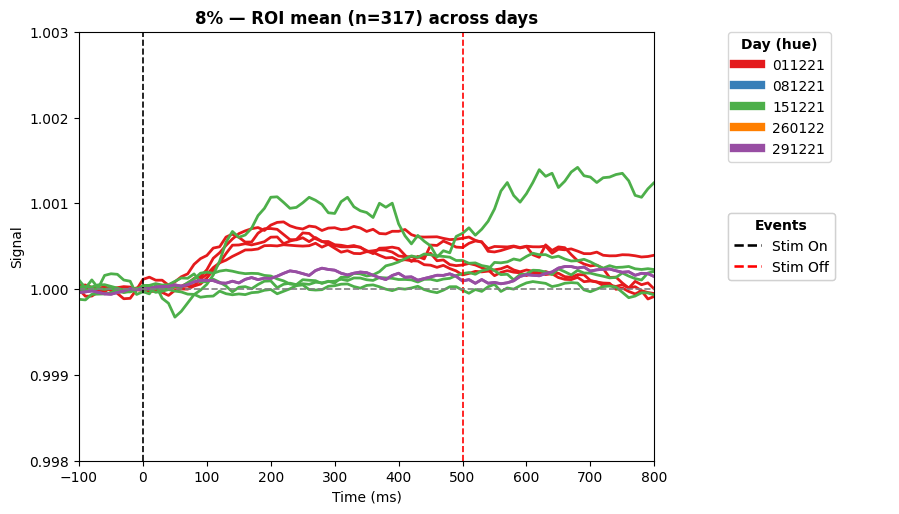

[DEBUG] Saved: C:\Users\amity\Desktop\Learning\university\Msc\Vision Lab\Thesis\preprocessed_VSDdata\_overlays_by_contrast_from_excel_roi\sameDayColor\roiR10_auto1_boxX30-60_boxY30-60_seedC100_win100-200_moderaw_fbd2fe\overlay_10pct_roi_same.png


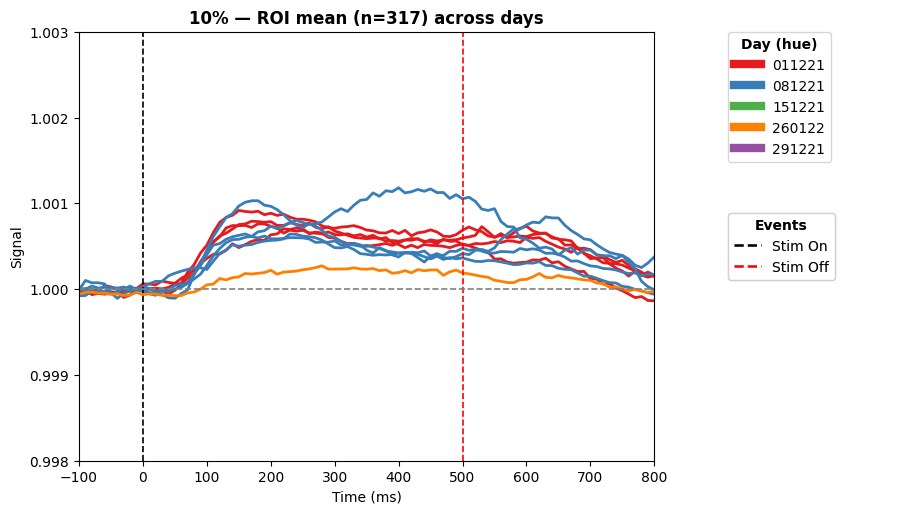

[DEBUG] Saved: C:\Users\amity\Desktop\Learning\university\Msc\Vision Lab\Thesis\preprocessed_VSDdata\_overlays_by_contrast_from_excel_roi\sameDayColor\roiR10_auto1_boxX30-60_boxY30-60_seedC100_win100-200_moderaw_fbd2fe\overlay_12pct_roi_same.png


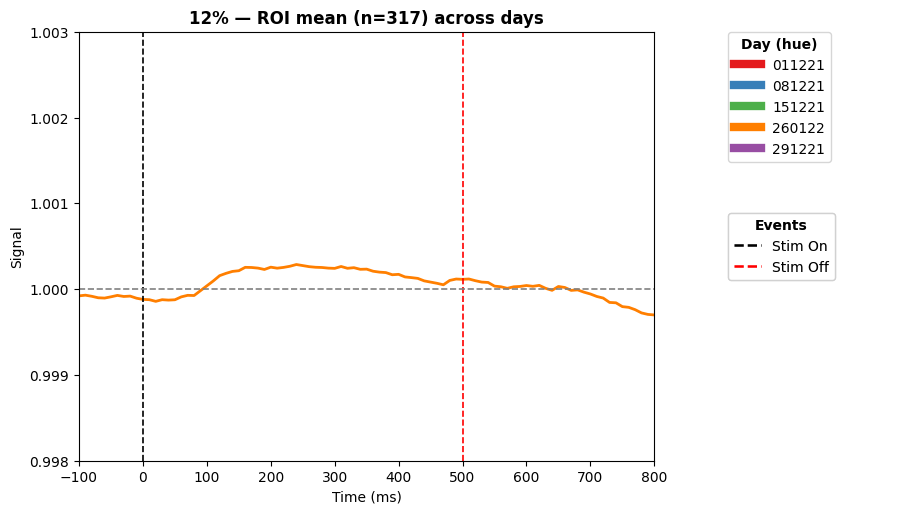

[DEBUG] Saved: C:\Users\amity\Desktop\Learning\university\Msc\Vision Lab\Thesis\preprocessed_VSDdata\_overlays_by_contrast_from_excel_roi\sameDayColor\roiR10_auto1_boxX30-60_boxY30-60_seedC100_win100-200_moderaw_fbd2fe\overlay_16pct_roi_same.png


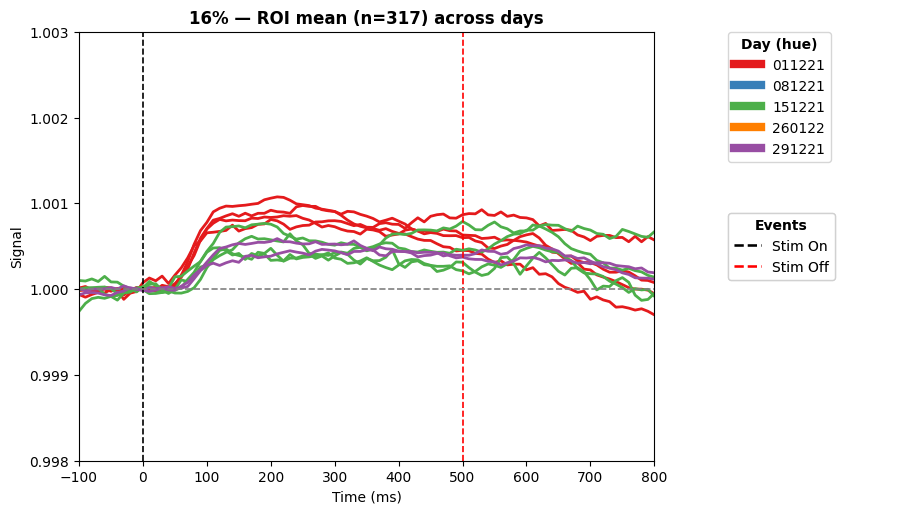

[DEBUG] Saved: C:\Users\amity\Desktop\Learning\university\Msc\Vision Lab\Thesis\preprocessed_VSDdata\_overlays_by_contrast_from_excel_roi\sameDayColor\roiR10_auto1_boxX30-60_boxY30-60_seedC100_win100-200_moderaw_fbd2fe\overlay_24pct_roi_same.png


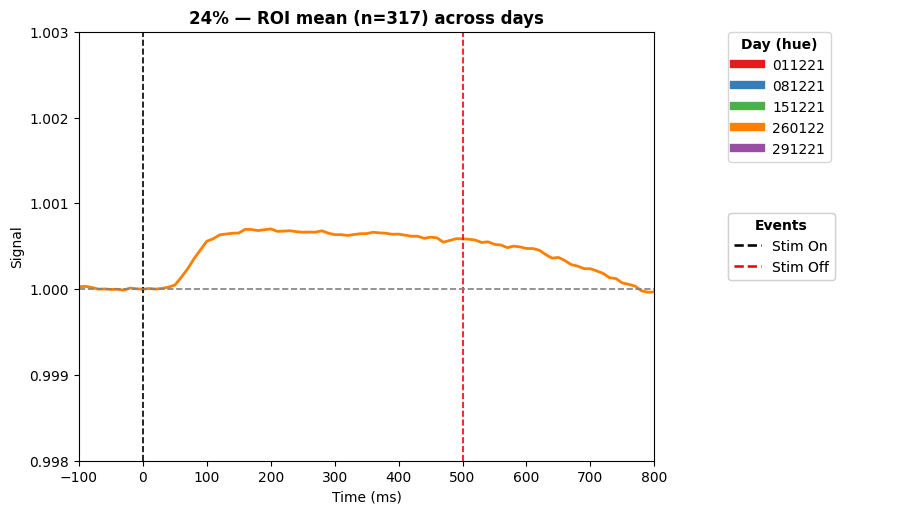

[DEBUG] Saved: C:\Users\amity\Desktop\Learning\university\Msc\Vision Lab\Thesis\preprocessed_VSDdata\_overlays_by_contrast_from_excel_roi\sameDayColor\roiR10_auto1_boxX30-60_boxY30-60_seedC100_win100-200_moderaw_fbd2fe\overlay_32pct_roi_same.png


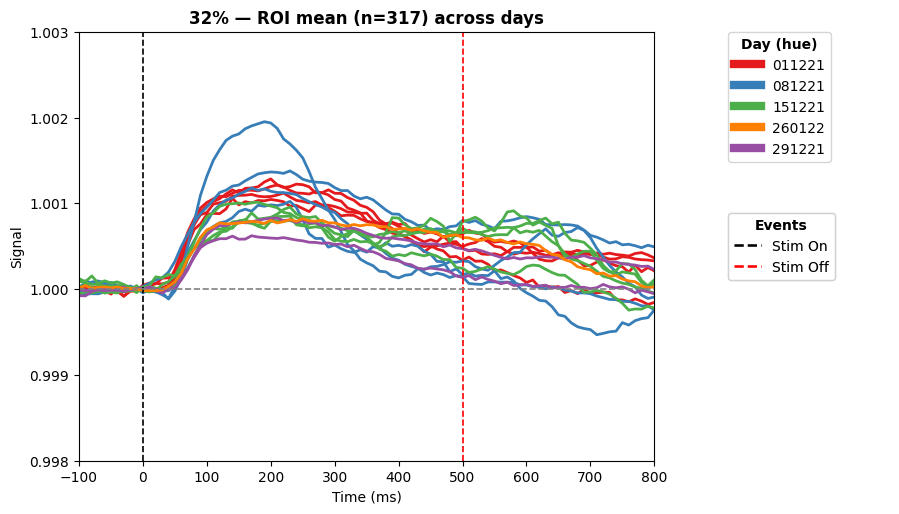

[DEBUG] Saved: C:\Users\amity\Desktop\Learning\university\Msc\Vision Lab\Thesis\preprocessed_VSDdata\_overlays_by_contrast_from_excel_roi\sameDayColor\roiR10_auto1_boxX30-60_boxY30-60_seedC100_win100-200_moderaw_fbd2fe\overlay_64pct_roi_same.png


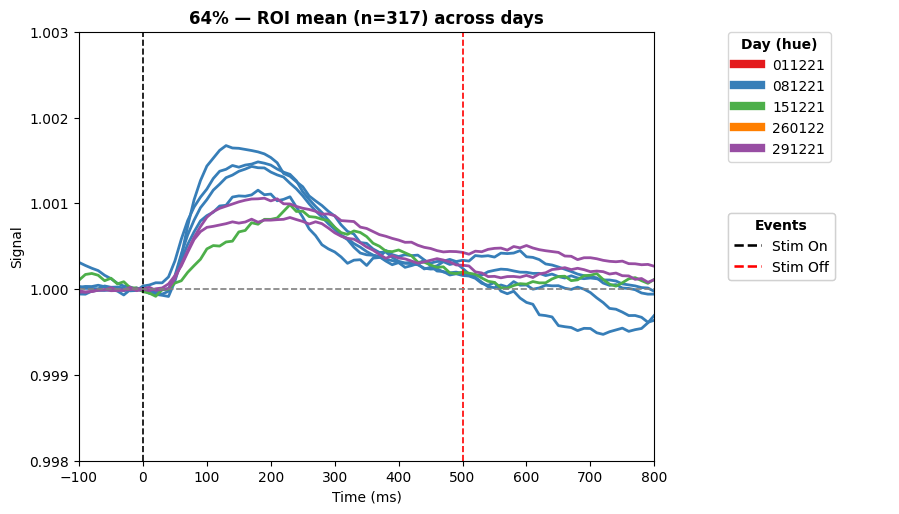

[DEBUG] Saved: C:\Users\amity\Desktop\Learning\university\Msc\Vision Lab\Thesis\preprocessed_VSDdata\_overlays_by_contrast_from_excel_roi\sameDayColor\roiR10_auto1_boxX30-60_boxY30-60_seedC100_win100-200_moderaw_fbd2fe\overlay_100pct_roi_same.png


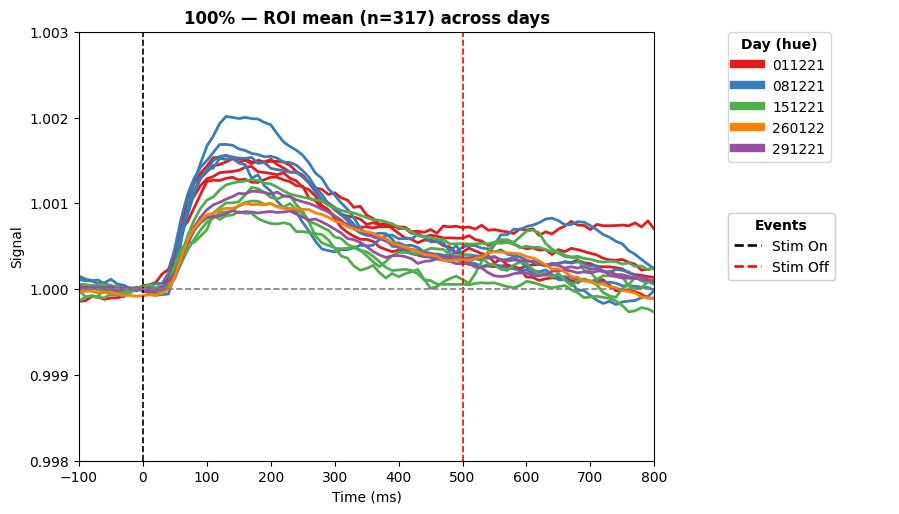

[SAVE] Wrote manifest: C:\Users\amity\Desktop\Learning\university\Msc\Vision Lab\Thesis\preprocessed_VSDdata\_overlays_by_contrast_from_excel_roi\sameDayColor\roiR10_auto1_boxX30-60_boxY30-60_seedC100_win100-200_moderaw_fbd2fe\manifest_sessions_sorted.csv
[DEBUG] 151221c: condAN8 not found or empty, skip
[SAVE] 4%: timecourses -> roi_timecourses_4pct.npz, patterns -> roi_patterns_4pct.npz
[SAVE] Trial counts for 4% -> C:\Users\amity\Desktop\Learning\university\Msc\Vision Lab\Thesis\preprocessed_VSDdata\_overlays_by_contrast_from_excel_roi\sameDayColor\roiR10_auto1_boxX30-60_boxY30-60_seedC100_win100-200_moderaw_fbd2fe\trial_counts_by_pct_4.csv
[SAVE] 8%: timecourses -> roi_timecourses_8pct.npz, patterns -> roi_patterns_8pct.npz
[SAVE] Trial counts for 8% -> C:\Users\amity\Desktop\Learning\university\Msc\Vision Lab\Thesis\preprocessed_VSDdata\_overlays_by_contrast_from_excel_roi\sameDayColor\roiR10_auto1_boxX30-60_boxY30-60_seedC100_win100-200_moderaw_fbd2fe\trial_counts_by_pct_8.csv
[S

In [14]:
# overlays_from_excel_conditions_debug_roi_cfgfolders.ipynb-cell
# Tidy, notebook-friendly version (one cell)
# - Builds per-session contrast→cond mapping from Used_Sessions_details.xlsx
# - Overlays ROI timecourses across days (x in ms; 0=onset, 500=offset)
# - Optional AUTO-SEED picks the best pixel in a box by mean ΔF/F in [t0, t1] ms
# - Each run writes into a unique config folder (with config.json)
# - Saves a seed/ROI map figure and per-contrast overlays + compact NPZs for downstream use

# =========================
# Imports
# =========================
from __future__ import annotations

import os
import re
import json
import math
import hashlib
from pathlib import Path
from datetime import datetime
from collections import OrderedDict
from typing import Optional, Tuple, List, Dict

import numpy as np
import pandas as pd
import scipy.io as sio
from scipy.signal import correlate2d
from scipy.ndimage import binary_erosion
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
from matplotlib.lines import Line2D
from matplotlib.colors import ListedColormap, to_rgb
import seaborn as sns
from collections import defaultdict


# =========================
# Small utilities
# =========================
def get_mapgeog_colormap(m: int = None,  bad_color: str = None):
    raw_colors = np.array([ 
        [0, 0, 38],
        [0, 0, 45],
        [0, 0, 52],
        [0, 0, 59],
        [0, 0, 66],
        [0, 0, 73],
        [0, 0, 80],
        [0, 0, 87],
        [0, 0, 94],
        [0, 0, 101],
        [0, 0, 108],
        [0, 0, 115],
        [0, 0, 122],
        [0, 0, 129],
        [0, 0, 136],
        [0, 0, 143],
        [0, 0, 150],
        [0, 0, 157],
        [0, 0, 164],
        [0, 0, 171],
        [0, 0, 178],
        [0, 0, 185],
        [0, 0, 192],
        [0, 0, 199],
        [0, 0, 206],
        [0, 0, 213],
        [0, 0, 220],
        [0, 0, 227],
        [0, 0, 234],
        [0, 0, 241],
        [0, 0, 248],
        [0, 0, 255],
        [0, 3, 252],
        [0, 7, 248],
        [0, 11, 244],
        [0, 15, 240],
        [0, 19, 236],
        [0, 23, 232],
        [0, 27, 228],
        [0, 31, 224],
        [0, 35, 220],
        [0, 39, 216],
        [0, 43, 212],
        [0, 47, 208],
        [0, 51, 204],
        [0, 55, 200],
        [0, 59, 196],
        [0, 63, 192],
        [0, 67, 188],
        [0, 71, 184],
        [0, 75, 180],
        [0, 79, 176],
        [0, 83, 172],
        [0, 87, 168],
        [0, 91, 164],
        [0, 95, 160],
        [0, 99, 156],
        [0, 103, 152],
        [0, 107, 148],
        [0, 111, 144],
        [0, 115, 140],
        [0, 119, 136],
        [0, 123, 132],
        [0, 127, 128],
        [0, 131, 124],
        [0, 135, 120],
        [0, 139, 116],
        [0, 143, 112],
        [0, 147, 108],
        [0, 151, 104],
        [0, 155, 100],
        [0, 159, 96],
        [0, 163, 92],
        [0, 167, 88],
        [0, 171, 84],
        [0, 175, 80],
        [0, 179, 76],
        [0, 183, 72],
        [0, 187, 68],
        [0, 191, 64],
        [0, 195, 60],
        [0, 199, 56],
        [0, 203, 52],
        [0, 207, 48],
        [0, 211, 44],
        [0, 215, 40],
        [0, 219, 36],
        [0, 223, 32],
        [0, 227, 28],
        [0, 231, 24],
        [0, 235, 20],
        [0, 239, 16],
        [0, 243, 12],
        [0, 247, 8],
        [0, 251, 4],
        [0, 255, 0],
        [7, 255, 0],
        [15, 255, 0],
        [23, 255, 0],
        [31, 255, 0],
        [39, 255, 0],
        [47, 255, 0],
        [55, 255, 0],
        [63, 255, 0],
        [71, 255, 0],
        [79, 255, 0],
        [87, 255, 0],
        [95, 255, 0],
        [103, 255, 0],
        [111, 255, 0],
        [119, 255, 0],
        [127, 255, 0],
        [135, 255, 0],
        [143, 255, 0],
        [151, 255, 0],
        [159, 255, 0],
        [167, 255, 0],
        [175, 255, 0],
        [183, 255, 0],
        [191, 255, 0],
        [199, 255, 0],
        [207, 255, 0],
        [215, 255, 0],
        [223, 255, 0],
        [231, 255, 0],
        [239, 255, 0],
        [247, 255, 0],
        [255, 255, 0],
        [255, 252, 0],
        [255, 248, 0],
        [255, 244, 0],
        [255, 240, 0],
        [255, 236, 0],
        [255, 232, 0],
        [255, 228, 0],
        [255, 224, 0],
        [255, 220, 0],
        [255, 216, 0],
        [255, 212, 0],
        [255, 208, 0],
        [255, 204, 0],
        [255, 200, 0],
        [255, 196, 0],
        [255, 192, 0],
        [255, 188, 0],
        [255, 184, 0],
        [255, 180, 0],
        [255, 176, 0],
        [255, 172, 0],
        [255, 168, 0],
        [255, 164, 0],
        [255, 160, 0],
        [255, 156, 0],
        [255, 152, 0],
        [255, 148, 0],
        [255, 144, 0],
        [255, 140, 0],
        [255, 136, 0],
        [255, 132, 0],
        [255, 128, 0],
        [255, 124, 0],
        [255, 120, 0],
        [255, 116, 0],
        [255, 112, 0],
        [255, 108, 0],
        [255, 104, 0],
        [255, 100, 0],
        [255, 96, 0],
        [255, 92, 0],
        [255, 88, 0],
        [255, 84, 0],
        [255, 80, 0],
        [255, 76, 0],
        [255, 72, 0],
        [255, 68, 0],
        [255, 64, 0],
        [255, 60, 0],
        [255, 56, 0],
        [255, 52, 0],
        [255, 48, 0],
        [255, 44, 0],
        [255, 40, 0],
        [255, 36, 0],
        [255, 32, 0],
        [255, 28, 0],
        [255, 24, 0],
        [255, 20, 0],
        [255, 16, 0],
        [255, 12, 0],
        [255, 8, 0],
        [255, 4, 0],
        [255, 0, 0],
        [255, 0, 7],
        [255, 0, 15],
        [255, 0, 23],
        [255, 0, 31],
        [255, 0, 39],
        [255, 0, 47],
        [255, 0, 55],
        [255, 0, 63],
        [255, 0, 71],
        [255, 0, 79],
        [255, 0, 87],
        [255, 0, 95],
        [255, 0, 103],
        [255, 0, 111],
        [255, 0, 119],
        [255, 0, 127],
        [255, 0, 135],
        [255, 0, 143],
        [255, 0, 151],
        [255, 0, 159],
        [255, 0, 167],
        [255, 0, 175],
        [255, 0, 183],
        [255, 0, 191],
        [255, 0, 199],
        [255, 0, 207],
        [255, 0, 215],
        [255, 0, 223],
        [255, 0, 231],
        [255, 0, 239],
        [255, 0, 247],
        [255, 0, 255],
        [255, 7, 255],
        [255, 15, 255],
        [255, 23, 255],
        [255, 31, 255],
        [255, 39, 255],
        [255, 47, 255],
        [255, 55, 255],
        [255, 63, 255],
        [255, 71, 255],
        [255, 79, 255],
        [255, 87, 255],
        [255, 95, 255],
        [255, 103, 255],
        [255, 111, 255],
        [255, 119, 255],
        [255, 127, 255],
        [255, 135, 255],
        [255, 143, 255],
        [255, 151, 255],
        [255, 159, 255],
        [255, 167, 255],
        [255, 175, 255],
        [255, 183, 255],
        [255, 191, 255],
        [255, 199, 255],
        [255, 207, 255],
        [255, 215, 255],
        [255, 223, 255],
        [255, 231, 255],
        [255, 239, 255],
        [255, 247, 255],
        [255, 255, 255]
    ]) / 255.0
    # normalize to [0, 1]

    # Default: if no m given, use 256
    if m is None:
        m = 256

    idx = np.ceil(np.linspace(1, 256, m) * (256 / m)).astype(int) - 1
    idx = np.clip(idx, 0, 255)  # make sure indices stay valid
    y = raw_colors[idx, :]

    cmap = ListedColormap(y, name=f'mapgeog_{m}')
    if bad_color is not None:
        cmap.set_bad(bad_color)

    print(f"Created colormap 'mapgeog' with {m} colors.")
    return cmap

def dprint(*args, **kwargs):
    if kwargs.pop("_on", True):
        print(*args, **kwargs)

def _norm_key(s: str) -> str:
    return re.sub(r"[^a-z0-9]+", "_", str(s).strip().lower())

def _looks_like_header(vals) -> bool:
    keys = [_norm_key(v) for v in vals if pd.notna(v) and str(v).strip() != ""]
    wanted = ("date", "session", "bhv", "conditions", "contrast", "paradigm")
    hits = sum(any(w in k for k in keys) for w in wanted)
    return hits >= 2

def _find_header_row(df: pd.DataFrame, max_scan: int = 60) -> int:
    n = min(max_scan, len(df))
    for r in range(n):
        if _looks_like_header(df.iloc[r].tolist()):
            return r
    return 0

def _make_day_palettes(
    sessions_sorted,
    n_distinct_days: int = None,
    base_palette: str = "Set1",
    light: float = 0.75,
    dark: float = 0.15,
):
    """
    Build day/letter color maps using Seaborn.

    Parameters
    ----------
    sessions_sorted : list[dict]
        Your sessions metadata (each has "date_code" and "letter")
    n_distinct_days : int, optional
        Number of distinct days. If None, inferred from sessions_sorted.
    base_palette : str
        Seaborn palette name for distinct day hues ("Set1", "Paired", "tab10", etc.)
    light, dark : float
        0..1 blend factors for lighter/darker shades within a day.

    Returns
    -------
    day_to_color : {day -> RGB tuple}
        Base color for the day.
    day_to_palette : {day -> [RGB tuples]}
        Shades for each session letter in that day (light → dark).
    letter_index : {day -> {letter -> idx}}
        Map letter to index into that day's palette.
    """
    # unique days
    days = []
    for s in sessions_sorted:
        d = s["date_code"]
        if d not in days:
            days.append(d)
    if n_distinct_days is None:
        n_distinct_days = len(days)

    # get N distinct base colors from seaborn
    base_colors = sns.color_palette(base_palette, n_distinct_days)
    day_to_color = {d: base_colors[i] for i, d in enumerate(days)}

    # letters per day sorted
    per_day_letters = defaultdict(list)
    for s in sessions_sorted:
        per_day_letters[s["date_code"]].append(s["letter"])
    for d in per_day_letters:
        per_day_letters[d].sort(key=lambda L: LETTER_ORDER.get(L, 99))

    day_to_palette, letter_index = {}, {}
    for d in days:
        letters = per_day_letters[d]
        n = max(1, len(letters))

        base = np.array(day_to_color[d])
        white = np.array([1.0, 1.0, 1.0])
        ts = np.linspace(light, dark, n)
        # blend towards white for lighter shades
        shades = [tuple((1 - t) * base + t * white) for t in ts]

        day_to_palette[d] = shades
        letter_index[d] = {L: i for i, L in enumerate(letters)}

    return day_to_color, day_to_palette, letter_index

# =========================
# Config (edit for your setup)
# =========================
EXCEL_PATH   = r"C:\Users\amity\Desktop\Learning\university\Msc\Vision Lab\Thesis\Used_Sessions_details.xlsx"
PREPROC_BASE = r"C:\Users\amity\Desktop\Learning\university\Msc\Vision Lab\Thesis\preprocessed_VSDdata"
ANIMAL       = "boromir"
MAT_FILENAME = "condsAN.mat"
SHEET_NAME   = None            # None -> take first sheet
MAX_HEADER_SCAN = 60
DEBUG_VERBOSE = True

# ROI settings
USE_CIRCULAR_ROI = True
SEED_XY   = (45, 45)          # used if AUTO_SEED=False
RADIUS_PX = 10
IMAGE_SHAPE = None            # e.g. (100,100); None -> infer from P

# AUTO-SEED (pick best pixel in a box)
AUTO_SEED = True
# How to auto-pick the seed:
# 'peak'    -> current behavior (brightest pixel in the box)
# 'roi_sum' -> new behavior (center that maximizes sum inside the circular ROI)
AUTO_SEED_METHOD = "roi_sum"
AUTO_SEED_BOX_X = (30, 60)
AUTO_SEED_BOX_Y = (30, 60)
AUTO_SEED_CONTRAST_PCT = 100
AUTO_SEED_TIME_MS = (100, 200)
SEEDMAP_CMAP = get_mapgeog_colormap(m=256)  # define after function exists

# ΔF/F and frame selection
DFF_MODE = "raw"           # 'minus1' | 'baseline' | 'raw'
BASELINE_FRAMES = (24, 27)
FRAMES = None                 # None or (start, stop)

# Timing for plotting (ms axis)
FRAME_RATE_HZ     = 100.0
FRAME_ONSET_IDX_1 = 27        # MATLAB-style (1-based)
STIM_DURATION_MS  = 500

# Plot styling
LINEWIDTH = 2.0
XLIM_MS = (-100, 800)
YLIM    = (0.998, 1.003)
# --- Display transforms (plotting only; data/ROI math unchanged) ---
DISPLAY_ORIGIN   = "upper"      # y-down on screen
DISPLAY_ROTATION = "cw"         # 'none' | 'cw' (90° right) | 'ccw'
same_color_per_day = True   # <--- switch between True/False
LEGEND_PANEL_FRAC = 0.28   # width of the legend panel as a fraction of the plot panel




# Session-letter sort order
LETTER_ORDER = {"a":0, "b":1, "c":2, "d":3, "e":4, "f":5}

# Date parsing preferences
YEAR_PREF_RANGE = (2020, 2026)

# Tokens
BLANK_TOKENS = ("blank", '"true" blank')
ERROR_TOKENS = ("error", "err")

# =========================
# Date/session parsing
# =========================
def _parse_6digits(s: str) -> Optional[str]:
    m = re.search(r"(\d{6})", s or "")
    return m.group(1) if m else None

def _interpret_6(code6: str) -> Optional[datetime]:
    for fmt in ("%y%m%d", "%d%m%y", "%m%d%y"):
        try:
            dt = datetime.strptime(code6, fmt)
            if YEAR_PREF_RANGE[0] <= dt.year <= YEAR_PREF_RANGE[1]:
                return dt
        except Exception:
            pass
    for fmt in ("%y%m%d", "%d%m%y", "%m%d%y"):
        try:
            return datetime.strptime(code6, fmt)
        except Exception:
            pass
    return None

def _to_ddmmyy_from_any(date_cell) -> Optional[str]:
    if date_cell is None or (isinstance(date_cell, float) and pd.isna(date_cell)):
        return None
    # timestamps
    if isinstance(date_cell, (pd.Timestamp, datetime, np.datetime64)):
        try:
            dt = pd.to_datetime(date_cell); return dt.strftime("%d%m%y")
        except Exception:
            pass
    # excel serial
    if isinstance(date_cell, (int, float, np.integer, np.floating)) and not isinstance(date_cell, bool):
        if not pd.isna(date_cell):
            try:
                dt = pd.to_datetime(date_cell, unit="D", origin="1899-12-30")
                return dt.strftime("%d%m%y")
            except Exception:
                pass
    # strings
    s = str(date_cell).strip()
    if not s: return None
    try:
        dt = pd.to_datetime(s, dayfirst=True, errors="raise")
        if YEAR_PREF_RANGE[0] <= dt.year <= YEAR_PREF_RANGE[1]:
            return dt.strftime("%d%m%y")
    except Exception:
        pass
    for fmt in ("%d/%m/%Y", "%d/%m/%y", "%Y-%m-%d", "%Y-%m-%d %H:%M:%S",
                "%d-%m-%Y", "%d.%m.%Y", "%m/%d/%Y", "%m/%d/%y"):
        try:
            dt = datetime.strptime(s, fmt)
            if YEAR_PREF_RANGE[0] <= dt.year <= YEAR_PREF_RANGE[1]:
                return dt.strftime("%d%m%y")
        except Exception:
            pass
    code6 = _parse_6digits(s)
    if code6:
        dt = _interpret_6(code6)
        if dt:
            return dt.strftime("%d%m%y")
    return None

def _best_date_letter(rec: dict) -> Tuple[Optional[str], Optional[str]]:
    # date
    date_code, letter = None, None
    raw_date_val = None
    for k in ("date", "session_date", "day", "day_id"):
        if k in rec and pd.notna(rec[k]):
            raw_date_val = rec[k]
            dc = _to_ddmmyy_from_any(rec[k])
            if dc:
                date_code = dc; break
    # letter
    for k in ("session_letter", "letter", "suffix", "session_tag", "session"):
        if k in rec and pd.notna(rec[k]):
            val = str(rec[k]).strip().lower()
            if len(val) == 1 and val.isalpha():
                letter = val; break
            m = re.search(r"[a-f]", val)
            if m:
                letter = m.group(0); break
    dprint(f"[_best_date_letter] raw_date={repr(raw_date_val)} -> date_code={date_code}, letter={letter}", _on=DEBUG_VERBOSE)
    return date_code, letter

def _num_trials(arr: np.ndarray) -> int:
    """Return number of trials in a cond array (P x F x T) or 1 if already averaged (P x F)."""
    A = np.asarray(arr)
    return int(A.shape[2]) if A.ndim == 3 else 1


# =========================
# Condition schema + Excel mapping
# =========================
def discover_condition_schema(headers_row: List) -> List[Tuple[int, int]]:
    """
    Finds numeric condition columns in the header row.
    Returns list of (orig_col_idx, cond_id) sorted by cond_id.
    """
    schema = []
    for idx, h in enumerate(headers_row):
        if pd.isna(h): continue
        if isinstance(h, str):
            m = re.fullmatch(r"\s*(\d+)\s*", h)
            if m: schema.append((idx, int(m.group(1)))); continue
        if isinstance(h, (int, float, np.integer, np.floating)) and not isinstance(h, bool):
            if not pd.isna(h):
                schema.append((idx, int(round(float(h)))))
    schema.sort(key=lambda t: t[1])
    return schema

def extract_percent(val) -> Optional[int]:
    if val is None or (isinstance(val, float) and pd.isna(val)):
        return None
    if isinstance(val, (int, float, np.integer, np.floating)) and not isinstance(val, bool):
        if pd.isna(val): return None
        v = float(val)
        if 0 <= v <= 1.5: return int(round(v * 100))
        if v > 1:         return int(round(v))
        return None
    s = str(val).strip()
    if not s: return None
    m_plain = re.fullmatch(r"\s*(\d+(?:\.\d+)?)\s*", s)
    if m_plain: return int(round(float(m_plain.group(1))))
    m_any = re.search(r"(\d+(?:\.\d+)?)\s*%?", s)
    if m_any:  return int(round(float(m_any.group(1))))
    return None

def row_pct_to_cond_from_excel_with_schema_rawrow(raw_row: pd.Series,
                                                  cond_schema: List[Tuple[int,int]]) -> Dict[int, str]:
    """
    Given the raw sheet row and a condition schema, returns mapping {percent:int -> 'condAN#'}.
    Skips plain 'blank' cells with no digits.
    """
    pct_to_cond = {}
    for col_idx, cond_id in cond_schema:
        if col_idx >= len(raw_row): continue
        val = raw_row.iat[col_idx]
        if pd.isna(val): continue
        text_low = str(val).strip().lower()
        if any(tok in text_low for tok in BLANK_TOKENS) and not re.search(r"\d", text_low):
            continue
        pct = extract_percent(val)
        if pct is None: continue
        pct_to_cond[pct] = f"condAN{cond_id}"
    return pct_to_cond

# =========================
# Image/ROI helpers
# =========================
def _start_stop(frames):
    if frames is None: return None, None
    if isinstance(frames, slice): return frames.start, frames.stop
    if isinstance(frames, (tuple, list)) and len(frames) == 2: return frames[0], frames[1]
    raise TypeError("frames must be slice or (start, stop)")

def compute_dff(data: np.ndarray,
                cond: Optional[int] = None,
                frames=None,
                dff_mode: str = "minus1",
                baseline_frames: Tuple[int,int] = (24,27)) -> np.ndarray:
    """
    data: (P, F, C) or (P, F)
    cond: if data is (P, F, C), cond=None => mean across conds; otherwise selects single cond index
    frames: None or (start, stop)
    dff_mode: 'minus1' | 'baseline' | 'raw'
    """
    A = np.asarray(data)
    if A.ndim == 3:
        X = A.mean(axis=2) if cond is None else A[:, :, cond]
    elif A.ndim == 2:
        X = A
    else:
        raise ValueError("data must be (P,F,C) or (P,F)")
    fs, fe = _start_stop(frames)
    if fs is not None:
        X = X[:, fs:fe]
    if dff_mode == "minus1":
        return X - 1.0
    if dff_mode == "baseline":
        bs, be = _start_stop(baseline_frames)
        if bs is None: raise ValueError("baseline_frames must be slice or (start, stop)")
        base = X[:, bs:be].mean(axis=1, keepdims=True)
        return X - base
    if dff_mode == "raw":
        return X
    raise ValueError("dff_mode must be 'minus1', 'baseline', or 'raw'")

def pick_seed_by_roi_sum(scores_flat, image_shape, radius_px, box_x, box_y):
    """
    scores_flat: mean activity per pixel (length P)
    Returns (x,y) that maximizes the sum inside a circle of radius_px.
    Honors the AUTO_SEED box and keeps the full circle inside the image.
    """
    H, W = image_shape
    img = scores_flat.reshape((H, W), order="F")

    r = int(radius_px)
    yy, xx = np.ogrid[-r:r+1, -r:r+1]
    kernel = (xx*xx + yy*yy <= r*r).astype(float)     # circular footprint

    # Convolution-like sum of values under the circular kernel, center at each pixel
    heat = correlate2d(img, kernel, mode="same", boundary="fill", fillvalue=img.min())

    # Valid centers where the full circle fits
    valid = binary_erosion(np.ones((H, W), bool), structure=kernel, border_value=0)

    # Limit to the user box
    bx0, bx1 = box_x; by0, by1 = box_y
    allowed = np.zeros((H, W), bool)
    allowed[by0:by1+1, bx0:bx1+1] = True

    mask = valid & allowed
    heat[~mask] = -np.inf

    flat = np.nanargmax(heat)
    y, x = np.unravel_index(flat, (H, W))  # row, col
    return (int(x), int(y))

def _apply_display_rotation(img2d, xy, rotation):
    """
    Rotate the shown image (not the data) and transform (x,y) for the overlay.
    xy = (x,y) before rotation.
    """
    H, W = img2d.shape
    x, y = xy

    # base rotation
    if rotation == "none":
        img2d_r, x2, y2 = img2d, x, y
    elif rotation == "cw":  # 90° clockwise
        img2d_r = np.rot90(img2d, -1)
        x2, y2 = H - 1 - y, x
    elif rotation == "ccw":  # 90° counterclockwise
        img2d_r = np.rot90(img2d, 1)
        x2, y2 = y, W - 1 - x
    else:
        raise ValueError("DISPLAY_ROTATION must be 'none'|'cw'|'ccw'")

    # >>> NEW: horizontal flip if needed
    img2d_r = np.fliplr(img2d_r)
    x2 = img2d_r.shape[1] - 1 - x2  # adjust overlay x accordingly

    return img2d_r, (x2, y2)



def circle_roi_mask(seed_xy: Tuple[int,int], radius_px: int, image_shape: Tuple[int,int]) -> np.ndarray:
    h, w = image_shape
    yy, xx = np.mgrid[0:h, 0:w]
    mask2d = (xx - seed_xy[0])**2 + (yy - seed_xy[1])**2 <= radius_px**2
    # keep consistency with data flattening (Fortran order)
    return mask2d.reshape(h*w, order="F")

def box_roi_mask(x_range: Tuple[int,int], y_range: Tuple[int,int], image_shape: Tuple[int,int]) -> np.ndarray:
    h, w = image_shape
    x0, x1 = x_range; y0, y1 = y_range
    yy, xx = np.mgrid[0:h, 0:w]
    mask2d = (xx >= x0) & (xx <= x1) & (yy >= y0) & (yy <= y1)
    return mask2d.reshape(h*w, order="F")

def infer_image_shape_from_P(P: int) -> Optional[Tuple[int,int]]:
    r = int(round(math.sqrt(P)))
    return (r, r) if r*r == P else None

def roi_mean_timecourse(arr: np.ndarray, mask1d: np.ndarray,
                        frames=None, dff_mode="minus1", baseline_frames=(24, 27)) -> np.ndarray:
    A = np.asarray(arr)
    if A.ndim not in (2, 3):
        return A.ravel()
    P = A.shape[0]
    if mask1d is None or mask1d.size != P:
        raise ValueError(f"ROI mask length {mask1d.size if mask1d is not None else None} != pixels {P}")
    X = compute_dff(A, cond=None, frames=frames, dff_mode=dff_mode, baseline_frames=baseline_frames)
    return X[mask1d.astype(bool), :].mean(axis=0)

def ms_to_frame_offset(ms: float, frame_rate_hz: float) -> int:
    return int(round((ms / 1000.0) * frame_rate_hz))

def build_time_axis_ms(n_frames: int, frame_rate_hz: float, frame_onset_idx_1: int, frames=None) -> np.ndarray:
    onset_zero = frame_onset_idx_1 - 1
    fs, _ = _start_stop(frames); fs = fs or 0
    onset_in_cropped = onset_zero - fs
    dt = 1000.0 / frame_rate_hz
    return (np.arange(n_frames) - onset_in_cropped) * dt

def roi_pattern_vector(arr: np.ndarray, roi_mask: np.ndarray,
                       frame_rate_hz: float, onset_idx_1: int,
                       window_ms=(100,200), dff_mode="minus1", baseline_frames=(24,27)) -> np.ndarray:
    X = compute_dff(np.asarray(arr), cond=None, frames=None,
                    dff_mode=dff_mode, baseline_frames=baseline_frames)  # (P,F)
    onset0 = onset_idx_1 - 1
    s = onset0 + ms_to_frame_offset(window_ms[0], frame_rate_hz)
    e = onset0 + ms_to_frame_offset(window_ms[1], frame_rate_hz)
    s = max(0, min(X.shape[1]-1, s))
    e = max(s+1, min(X.shape[1], e))
    vec = X[:, s:e].mean(axis=1)
    return vec[roi_mask.astype(bool)]

# =========================
# Plotting helpers
# =========================
def plot_seed_roi_overlay(ref_arr: np.ndarray,
                          image_shape: Tuple[int,int],
                          seed_xy: Tuple[int,int],
                          radius_px: int,
                          window_ms: Tuple[int,int],
                          frame_rate_hz: float,
                          onset_idx_1: int,
                          dff_mode: str,
                          baseline_frames: Tuple[int,int],
                          cmap: ListedColormap,
                          title_prefix: str = "",
                          save_path: Optional[Path] = None) -> None:
    X = compute_dff(np.asarray(ref_arr), cond=None, frames=None,
                    dff_mode=dff_mode, baseline_frames=baseline_frames)  # (P,F)
    onset0 = onset_idx_1 - 1
    s = onset0 + ms_to_frame_offset(window_ms[0], frame_rate_hz)
    e = onset0 + ms_to_frame_offset(window_ms[1], frame_rate_hz)
    s = max(0, min(X.shape[1]-1, s))
    e = max(s+1, min(X.shape[1],   e))
    img_flat = X[:, s:e].mean(axis=1)

    H, W = image_shape
    img = img_flat.reshape((H, W), order="F")

    # Rotate for display and transform seed coords to match
    img, seed_xy_disp = _apply_display_rotation(img, seed_xy, DISPLAY_ROTATION)

    # ---- layout: image hard-left, skinny colorbar on the right
    fig = plt.figure(figsize=(7.2, 5.4), constrained_layout=False)
    gs  = fig.add_gridspec(1, 2, width_ratios=[1.0, 0.045], wspace=0.08)
    ax  = fig.add_subplot(gs[0, 0])
    cax = fig.add_subplot(gs[0, 1])

    im = ax.imshow(
        img,
        origin=DISPLAY_ORIGIN,
        cmap=cmap,
        vmin=1.0 - 0.0015,
        vmax=1.0 + 0.0015,
        interpolation="nearest"
    )

    from matplotlib.patches import Circle
    cx, cy = seed_xy_disp
    circ = Circle((cx, cy), radius_px, edgecolor="cyan", facecolor="none",
                  lw=2.0, ls="--", label=f"ROI r={radius_px}px")
    ax.add_patch(circ)
    ax.plot([cx], [cy], marker="x", ms=8, mec="k", mfc="none", mew=2.0, label="seed")

    # keep legend inside so it doesn't create margins
    ax.legend(loc="upper right", frameon=True, fontsize=9)

    cb = fig.colorbar(im, cax=cax)
    cb.set_label("ΔF/F" if dff_mode != "raw" else "Signal")

    ax.set_title(f"{title_prefix} ({window_ms[0]}–{window_ms[1]} ms, mode={dff_mode})", pad=10, fontweight="bold")
    ax.set_xlabel("x (px)")
    ax.set_ylabel("y (px)")
    ax.set_aspect("equal")

    # Pull the whole thing left & trim margins
    fig.subplots_adjust(left=0.06, right=0.96, top=0.92, bottom=0.10)

    if save_path is not None:
        Path(save_path).parent.mkdir(parents=True, exist_ok=True)
        fig.savefig(save_path, dpi=150, bbox_inches="tight")
    plt.show()



def plot_single_frame_overlay(arr: np.ndarray,
                              image_shape: Tuple[int,int],
                              seed_xy: Tuple[int,int],
                              radius_px: int,
                              frame_rate_hz: float,
                              onset_idx_1: int,
                              dff_mode: str,
                              baseline_frames: Tuple[int,int],
                              cmap: ListedColormap,
                              frame_idx: Optional[int] = None,
                              time_ms: Optional[float] = None,
                              title_prefix: str = "Single frame",
                              save_path: Optional[Path] = None) -> None:
    X = compute_dff(np.asarray(arr), cond=None, frames=None,
                    dff_mode=dff_mode, baseline_frames=baseline_frames)  # (P,F)

    # pick frame
    if time_ms is not None:
        onset0 = onset_idx_1 - 1
        fi = onset0 + ms_to_frame_offset(time_ms, frame_rate_hz)
    elif frame_idx is not None:
        fi = int(frame_idx)
    else:
        raise ValueError("Provide either frame_idx or time_ms.")

    fi = int(np.clip(fi, 0, X.shape[1]-1))
    rel_ms = (fi - (onset_idx_1 - 1)) * (1000.0 / frame_rate_hz)

    # flatten -> image
    img_flat = X[:, fi]
    H, W = image_shape
    img = img_flat.reshape((H, W), order="F")

    # rotate for display & transform seed
    img, seed_xy_disp = _apply_display_rotation(img, seed_xy, DISPLAY_ROTATION)

    # ---- layout: image hard-left, skinny colorbar on the right
    fig = plt.figure(figsize=(7.2, 5.4), constrained_layout=False)
    gs  = fig.add_gridspec(1, 2, width_ratios=[1.0, 0.045], wspace=0.08)
    ax  = fig.add_subplot(gs[0, 0])
    cax = fig.add_subplot(gs[0, 1])

    im = ax.imshow(
        img,
        origin=DISPLAY_ORIGIN,
        cmap=cmap,
        interpolation="nearest",
        vmin=1.0 - 0.0015,
        vmax=1.0 + 0.0015
    )

    from matplotlib.patches import Circle
    cx, cy = seed_xy_disp
    circ = Circle((cx, cy), radius_px, edgecolor="cyan", facecolor="none",
                  lw=2.0, ls="--", label=f"ROI r={radius_px}px")
    ax.add_patch(circ)
    ax.plot([cx], [cy], marker="x", ms=8, mec="k", mfc="none", mew=2.0, label="seed")

    # legend inside to avoid layout growth; move if you want
    ax.legend(loc="upper right", frameon=True, fontsize=9)

    cb = fig.colorbar(im, cax=cax)
    cb.set_label("ΔF/F" if dff_mode != "raw" else "Signal")

    ax.set_title(f"{title_prefix} — frame {fi} (t={rel_ms:.1f} ms), mode={dff_mode}", pad=10, fontweight="bold")
    ax.set_xlabel("x (px)")
    ax.set_ylabel("y (px)")
    ax.set_aspect("equal")

    # Pull the content left & trim margins
    fig.subplots_adjust(left=0.06, right=0.96, top=0.92, bottom=0.10)

    if save_path is not None:
        Path(save_path).parent.mkdir(parents=True, exist_ok=True)
        fig.savefig(save_path, dpi=150, bbox_inches="tight")
    plt.show()




# =========================
# Session sort & saving bundles
# =========================
def datecode_to_dt(dc: str) -> datetime:
    return datetime.strptime(dc, "%d%m%y")

def sort_sessions(sessions_list: List[dict]) -> List[dict]:
    return sorted(
        sessions_list,
        key=lambda s: (datecode_to_dt(s["date_code"]),
                       LETTER_ORDER.get(s["letter"], 99))
    )

def save_session_order_and_data(
    sessions: List[dict],
    roi_mask: np.ndarray,
    all_pcts: List[int],
    outdir: Path,
    frame_rate_hz: float,
    onset_idx_1: int,
    dff_mode: str,
    baseline_frames: Tuple[int,int],
    time_window_ms: Tuple[int,int],
    frames_crop
) -> None:
    sess_sorted = sort_sessions(sessions)

    manifest_rows = []
    for i, s in enumerate(sess_sorted):
        manifest_rows.append({
            "order_index": i,
            "date_code": s["date_code"],
            "session_letter": s["letter"],
            "mat_path": s["mat_path"],
            "pct_to_cond_json": str(OrderedDict(sorted(s["pct_to_cond"].items())))
        })
    pd.DataFrame(manifest_rows).to_csv(outdir / "manifest_sessions_sorted.csv", index=False)
    print(f"[SAVE] Wrote manifest: {outdir / 'manifest_sessions_sorted.csv'}")

    # NEW: global table of trial counts: {label -> {pct -> n_trials}}
    trial_counts_global: Dict[str, Dict[int, int]] = {}

    for pct in all_pcts:
        Ys, labels, patterns, t_ms_ref = [], [], [], None
        n_trials_this_pct = []  # NEW: per-session n_trials for this contrast
        rows_for_csv = []       # NEW: to write trial_counts_by_pct_<pct>.csv

        for s in sess_sorted:
            cond_key = s["pct_to_cond"].get(pct)
            if not cond_key:
                # NEW: still ensure label exists in global map
                label = f"{s['date_code']}{s['letter']}"
                trial_counts_global.setdefault(label, {}).setdefault(pct, 0)
                continue

            mp = Path(s["mat_path"])
            if not mp.exists():
                print(f"[WARN] missing file: {mp}")
                continue
            mat = sio.loadmat(str(mp), squeeze_me=True, struct_as_record=False)
            arr = mat.get(cond_key)
            if arr is None:
                print(f"[DEBUG] {s['date_code']}{s['letter']}: {cond_key} not found or empty, skip")
                continue

            # NEW: count trials
            ntr = _num_trials(np.asarray(arr))
            label = f"{s['date_code']}{s['letter']}"
            trial_counts_global.setdefault(label, {})[pct] = ntr
            n_trials_this_pct.append(ntr)
            rows_for_csv.append({"label": label, "date_code": s["date_code"], "session_letter": s["letter"], "n_trials": ntr})

            y = roi_mean_timecourse(np.asarray(arr), roi_mask,
                                    frames=frames_crop, dff_mode=dff_mode, baseline_frames=baseline_frames)
            if t_ms_ref is None:
                t_ms_ref = build_time_axis_ms(len(y), frame_rate_hz, onset_idx_1, frames=frames_crop)
            Ys.append(y)
            labels.append(label)

            pat = roi_pattern_vector(arr, roi_mask, frame_rate_hz, onset_idx_1,
                                     window_ms=time_window_ms, dff_mode=dff_mode,
                                     baseline_frames=baseline_frames)
            patterns.append(pat)

        if not Ys:
            print(f"[NOTE] No data to save for {pct}%")
            continue

        Ys = np.vstack(Ys)
        pats = np.vstack(patterns)

        # Save timecourses + patterns as before, but include n_trials and pct
        np.savez_compressed(outdir / f"roi_timecourses_{pct}pct.npz",
                            t_ms=t_ms_ref, labels=np.array(labels, dtype=object), Y=Ys,
                            n_trials=np.array(n_trials_this_pct, dtype=int), pct=int(pct))
        np.savez_compressed(outdir / f"roi_patterns_{pct}pct.npz",
                            labels=np.array(labels, dtype=object), patterns=pats,
                            window_ms=np.array(time_window_ms),
                            n_trials=np.array(n_trials_this_pct, dtype=int), pct=int(pct))
        print(f"[SAVE] {pct}%: timecourses -> roi_timecourses_{pct}pct.npz, patterns -> roi_patterns_{pct}pct.npz")

        # NEW: per-contrast CSV
        if rows_for_csv:
            df_pct = pd.DataFrame(rows_for_csv).sort_values(["date_code","session_letter"])
            df_pct.to_csv(outdir / f"trial_counts_by_pct_{pct}.csv", index=False)
            print(f"[SAVE] Trial counts for {pct}% -> {outdir / f'trial_counts_by_pct_{pct}.csv'}")

    # NEW: write a wide CSV with all pct columns per session
    if trial_counts_global:
        labels_sorted = sorted(trial_counts_global.keys(),
                               key=lambda s: (datecode_to_dt(s[:-1]).timestamp(), LETTER_ORDER.get(s[-1], 99)))
        cols = [f"{pct}%" for pct in all_pcts]
        rows = []
        for label in labels_sorted:
            row = {"label": label,
                   "date_code": label[:-1],
                   "session_letter": label[-1]}
            for pct in all_pcts:
                row[f"{pct}%"] = trial_counts_global[label].get(pct, 0)
            rows.append(row)
        df_all = pd.DataFrame(rows, columns=["label","date_code","session_letter"] + cols)
        df_all.to_csv(outdir / "trial_counts_per_session.csv", index=False)
        print(f"[SAVE] Trial counts per session -> {outdir / 'trial_counts_per_session.csv'}")


# =========================
# Config folder utilities
# =========================
def config_dict() -> OrderedDict:
    return OrderedDict({
        "roi_shape": "circle" if USE_CIRCULAR_ROI else "other",
        "radius_px": RADIUS_PX,
        "auto_seed": AUTO_SEED,
        "seed_xy_if_manual": SEED_XY,
        "seed_box_x": AUTO_SEED_BOX_X,
        "seed_box_y": AUTO_SEED_BOX_Y,
        "seed_contrast_pct": AUTO_SEED_CONTRAST_PCT,
        "seed_time_ms": AUTO_SEED_TIME_MS,
        "dff_mode": DFF_MODE,
        "baseline_frames": BASELINE_FRAMES,
        "frames_crop": FRAMES,
        "frame_rate_hz": FRAME_RATE_HZ,
        "frame_onset_idx_1": FRAME_ONSET_IDX_1,
        "stim_duration_ms": STIM_DURATION_MS,
        "xlim_ms": XLIM_MS,
        "ylim": YLIM,
        "same_color_per_day": same_color_per_day,
    })

def config_tag(cfg: OrderedDict) -> str:
    parts = [
        f"roiR{cfg['radius_px']}",
        f"auto{int(cfg['auto_seed'])}",
        f"boxX{cfg['seed_box_x'][0]}-{cfg['seed_box_x'][1]}",
        f"boxY{cfg['seed_box_y'][0]}-{cfg['seed_box_y'][1]}",
        f"seedC{cfg['seed_contrast_pct']}",
        f"win{cfg['seed_time_ms'][0]}-{cfg['seed_time_ms'][1]}",
        f"mode{cfg['dff_mode']}"
    ]
    raw = json.dumps(cfg, default=str, sort_keys=True)
    short = hashlib.md5(raw.encode("utf-8")).hexdigest()[:6]
    return "_".join(parts + [short])

def prepare_outdir_and_write_config(base_dir: Path,
                                    cfg: OrderedDict,
                                    extra_info: Optional[dict] = None) -> Path:
    tag = config_tag(cfg)
    outdir = base_dir / tag
    outdir.mkdir(parents=True, exist_ok=True)
    cfg_to_write = OrderedDict(cfg)
    if extra_info:
        cfg_to_write.update(extra_info)
    with open(outdir / "config.json", "w", encoding="utf-8") as f:
        json.dump(cfg_to_write, f, indent=2, default=str)
    return outdir

# =========================
# Main driver for notebooks
# =========================
def run():
    # --- Load sheet (headerless) ---
    if SHEET_NAME is None:
        xls = pd.ExcelFile(EXCEL_PATH)
        sheet_name = xls.sheet_names[0]
        df0 = xls.parse(sheet_name, header=None)
    else:
        df0 = pd.read_excel(EXCEL_PATH, sheet_name=SHEET_NAME, header=None)

    dprint(f"[DEBUG] Raw df0 shape: {df0.shape}", _on=DEBUG_VERBOSE)
    hdr = _find_header_row(df0, max_scan=MAX_HEADER_SCAN)
    headers_row = df0.iloc[hdr].tolist()
    print(f"[DEBUG] Detected header row: {hdr}")
    print("[DEBUG] Headers row content:")
    for i, h in enumerate(headers_row):
        print(f"  [{i:02d}] {repr(h)}")

    cond_schema = discover_condition_schema(headers_row)
    print(f"[DEBUG] Condition schema (orig_col_idx -> cond_id): {cond_schema}")
    if not cond_schema:
        print("Could not detect any numbered condition columns in the header row.")
        return

    # Build dict-like rows under header
    headers = {c: _norm_key(df0.iat[hdr, c]) for c in range(df0.shape[1]) if pd.notna(df0.iat[hdr, c])}
    rows, orig_rows = [], []
    for r in range(hdr + 1, len(df0)):
        rec, empty = {}, True
        for c, key in headers.items():
            val = df0.iat[r, c]
            if pd.notna(val) and str(val).strip() != "":
                empty = False
            rec[key] = val
        if not empty:
            rows.append(rec); orig_rows.append(r)
    print(f"[DEBUG] Loaded {len(rows)} non-empty session rows under header")
    if not rows:
        return
    df = pd.DataFrame(rows)

    # Fill-down merged Excel dates (so c/d/e rows inherit the day's date)
    date_like_cols = [c for c in df.columns if re.search(r"\bdate\b", str(c), flags=re.I)]
    for c in date_like_cols:
        before = df[c].isna().sum()
        df[c] = df[c].replace("", np.nan).ffill()
        dprint(f"[DEBUG] Fill-down on column '{c}': NaNs {before} -> {df[c].isna().sum()}", _on=DEBUG_VERBOSE)

    # Build sessions list
    sessions = []
    for idx, (_, row_series) in enumerate(df.iterrows()):
        print(f"[DEBUG] ----- Session-row {idx} -----")
        print(f"[DEBUG] Raw 'Date' cell: {repr(row_series.get('date', None))}")
        print(f"[DEBUG] Raw 'Session' cell: {repr(row_series.get('session', None))}")
        date_code, letter = _best_date_letter(row_series.to_dict())
        print(f"[DEBUG] Parsed date_code={date_code}, letter={letter}")
        if date_code is None or letter is None:
            print("  -> skipping (missing date or session letter)"); continue
        folder = f"{ANIMAL}_{date_code}{letter}"
        mat_path = Path(PREPROC_BASE) / folder / MAT_FILENAME
        raw_row = df0.iloc[orig_rows[idx]]
        pct_to_cond = row_pct_to_cond_from_excel_with_schema_rawrow(raw_row, cond_schema)
        print(f"[DEBUG] {date_code}{letter}: pct_to_cond = {pct_to_cond}")
        sessions.append({"date_code": date_code, "letter": letter, "folder": folder,
                         "mat_path": str(mat_path), "pct_to_cond": pct_to_cond})

    all_pcts = sorted({pct for s in sessions for pct in s["pct_to_cond"].keys()})
    print(f"[DEBUG] All contrasts collected across sessions: {all_pcts}")
    if not all_pcts:
        print("No contrast percentages found in the Excel condition columns.")
        return

    # Infer image shape + optionally choose AUTO-SEED reference array
    image_shape = None
    seed_xy = SEED_XY
    ref_session_for_seed = None
    ref_arr_for_seed = None


    for s in sessions:
        # first array that lets us infer shape
        got_shape = False
        for _, condkey in s["pct_to_cond"].items():
            mp = Path(s["mat_path"])
            if mp.exists():
                mat = sio.loadmat(str(mp), squeeze_me=True, struct_as_record=False)
                arr = mat.get(condkey)
                if arr is None: continue
                P = int(np.asarray(arr).shape[0])
                image_shape = IMAGE_SHAPE or infer_image_shape_from_P(P)
                if image_shape is None:
                    raise ValueError(f"Cannot infer IMAGE_SHAPE from P={P}. Set IMAGE_SHAPE.")
                got_shape = True
                break
        if not got_shape:
            continue
        # find reference for auto-seed using desired contrast
        condkey_ref = s["pct_to_cond"].get(AUTO_SEED_CONTRAST_PCT)
        if AUTO_SEED and condkey_ref:
            mat2 = sio.loadmat(str(Path(s["mat_path"])), squeeze_me=True, struct_as_record=False)
            arr2 = mat2.get(condkey_ref)
            if arr2 is not None:
                ref_session_for_seed = s
                ref_arr_for_seed = np.asarray(arr2)
        break

    if image_shape is None:
        raise RuntimeError("Could not infer image shape; no usable MAT found.")
    print(f"[DEBUG] Using IMAGE_SHAPE={image_shape}")

    if AUTO_SEED:
        if ref_arr_for_seed is None:
            print(f"[WARN] Could not find data for {AUTO_SEED_CONTRAST_PCT}% to auto-select seed. Using SEED_XY={SEED_XY}.")
            seed_xy = SEED_XY
        else:
            X = compute_dff(ref_arr_for_seed, cond=None, frames=None,
                            dff_mode=DFF_MODE, baseline_frames=BASELINE_FRAMES)  # (P,F)
            onset_zero = FRAME_ONSET_IDX_1 - 1
            start = onset_zero + ms_to_frame_offset(AUTO_SEED_TIME_MS[0], FRAME_RATE_HZ)
            stop  = onset_zero + ms_to_frame_offset(AUTO_SEED_TIME_MS[1], FRAME_RATE_HZ)
            start = max(0, min(X.shape[1]-1, start))
            stop  = max(start+1, min(X.shape[1],   stop))

            scores = X[:, start:stop].mean(axis=1)  # mean activity per pixel in window

            if AUTO_SEED_METHOD == "roi_sum":
                seed_xy = pick_seed_by_roi_sum(scores, image_shape, RADIUS_PX,
                                            AUTO_SEED_BOX_X, AUTO_SEED_BOX_Y)
            else:  # 'peak' (original behavior)
                box_mask = box_roi_mask(AUTO_SEED_BOX_X, AUTO_SEED_BOX_Y, image_shape)
                if box_mask.sum() == 0:
                    raise ValueError("AUTO_SEED box mask is empty. Check ranges and IMAGE_SHAPE.")
                masked_scores = np.where(box_mask, scores, -np.inf)
                flat_idx = int(np.argmax(masked_scores))
                h, w = image_shape
                col = flat_idx // h
                row = flat_idx % h
                seed_xy = (col, row)

            print(f"[DEBUG] AUTO-SEED method={AUTO_SEED_METHOD} from {ref_session_for_seed['date_code']}{ref_session_for_seed['letter']} "
                f"({AUTO_SEED_CONTRAST_PCT}%): seed_xy={seed_xy}, window_frames=[{start},{stop})")


    # ROI mask
    if USE_CIRCULAR_ROI:
        roi_mask = circle_roi_mask(seed_xy, RADIUS_PX, image_shape)
    else:
        raise NotImplementedError("Only circular ROI implemented.")
    print(f"[DEBUG] ROI pixels (radius {RADIUS_PX} at {seed_xy}): {int(roi_mask.sum())}")

    # Prepare config outdir and write config.json
    cfg = config_dict()

    # separate subfolder per color mode
    color_mode = "sameDayColor" if same_color_per_day else "gradientColors"
    out_base = Path(PREPROC_BASE) / "_overlays_by_contrast_from_excel_roi" / color_mode

    outdir = prepare_outdir_and_write_config(
        out_base,
        cfg,
        extra_info={"chosen_seed_xy": seed_xy, "roi_pixels": int(roi_mask.sum()),
                    "image_shape": tuple(image_shape),
                    "same_color_per_day": same_color_per_day}  # for clarity in config.json
    )


    # Optional seed/ROI overlay map
    if ref_arr_for_seed is not None:
        plot_seed_roi_overlay(
            ref_arr_for_seed, image_shape, seed_xy, RADIUS_PX,
            window_ms=AUTO_SEED_TIME_MS, frame_rate_hz=FRAME_RATE_HZ,
            onset_idx_1=FRAME_ONSET_IDX_1, dff_mode=DFF_MODE,
            baseline_frames=BASELINE_FRAMES, cmap=SEEDMAP_CMAP,
            title_prefix=f"ROI overlay: {AUTO_SEED_CONTRAST_PCT}% Contrast",
            save_path=outdir / f"seed_roi_map_{AUTO_SEED_CONTRAST_PCT}pct.png"
        )

        plot_single_frame_overlay(
            ref_arr_for_seed, image_shape, seed_xy, RADIUS_PX,
            frame_rate_hz=FRAME_RATE_HZ, onset_idx_1=FRAME_ONSET_IDX_1,
            dff_mode=DFF_MODE, baseline_frames=BASELINE_FRAMES, cmap=SEEDMAP_CMAP,
            time_ms=200,
            title_prefix=f"ROI overlay: {AUTO_SEED_CONTRAST_PCT}% Contrast (single frame)",
            save_path=outdir / f"single_frame_{AUTO_SEED_CONTRAST_PCT}pct_t240ms.png"
        )


    # --- Plot overlays (sessions sorted for consistent legend/order)
    sessions_sorted = sort_sessions(sessions)
    day_to_color, day_to_palette, letter_index = _make_day_palettes(
        sessions_sorted, base_palette="Set1"
    )

    for pct in all_pcts:
        fig = plt.figure(figsize=(9, 5.5), constrained_layout=False)
        gs  = fig.add_gridspec(1, 2, width_ratios=[1.0, LEGEND_PANEL_FRAC], wspace=0.20)
        ax        = fig.add_subplot(gs[0, 0])
        ax_leg    = fig.add_subplot(gs[0, 1]); ax_leg.axis("off")

        plotted = False
        session_handles = []  # only used if same_color_per_day == False

        # ---- plot time series
        for s in sessions_sorted:
            cond_key = s["pct_to_cond"].get(pct)
            if not cond_key:
                continue
            mp = Path(s["mat_path"])
            if not mp.exists():
                print(f"[WARN] missing file: {mp}")
                continue
            mat = sio.loadmat(str(mp), squeeze_me=True, struct_as_record=False)
            arr = mat.get(cond_key)
            if arr is None:
                print(f"[DEBUG] {s['date_code']}{s['letter']}: {cond_key} not found or empty, skip")
                continue

            y = roi_mean_timecourse(np.asarray(arr), roi_mask,
                                    frames=FRAMES, dff_mode=DFF_MODE, baseline_frames=BASELINE_FRAMES)
            t_ms = build_time_axis_ms(len(y), FRAME_RATE_HZ, FRAME_ONSET_IDX_1, frames=FRAMES)

            day, let = s["date_code"], s["letter"]
            color = day_to_color[day] if same_color_per_day else day_to_palette[day][letter_index[day][let]]

            line, = ax.plot(t_ms, y, lw=LINEWIDTH, color=color, label=f"{day}{let}")
            if not same_color_per_day:
                session_handles.append(line)
            plotted = True

        # ---- decorate, legends, save (only once per pct)
        if plotted:
            # event/reference lines
            ax.axvline(0, color="k", ls="--", lw=1.2)                 # Stim On
            ax.axvline(STIM_DURATION_MS, color="r", ls="--", lw=1.2)  # Stim Off
            ax.axhline(1, color="grey", ls="--", lw=1.2)              # baseline

            ax.set_title(f"{pct}% — ROI mean (n={int(roi_mask.sum())}) across days", fontweight="bold")
            ax.set_xlabel("Time (ms)")
            ax.set_ylabel("ΔF/F" if DFF_MODE != "raw" else "Signal")
            ax.set_xlim(*XLIM_MS)
            ax.set_ylim(*YLIM)

            # Day legend (always show)
            day_handles = [Line2D([0],[0], color=day_to_color[d], lw=6, label=d)
                        for d in sorted(day_to_color.keys())]
            leg_day = ax_leg.legend(handles=day_handles, title="Day (hue)",
                                    loc="upper left", frameon=True, borderaxespad=0.0)
            ax_leg.add_artist(leg_day)
            leg_day.get_title().set_fontweight("bold")

            # Events legend (always show)
            event_handles = [
                Line2D([0],[0], color="k", ls="--", lw=1.8, label="Stim On"),
                Line2D([0],[0], color="r", ls="--", lw=1.8, label="Stim Off"),
                # Line2D([0],[0], color="grey", ls="--", lw=1.8, label="Baseline (ΔF/F=1)"),
            ]
            leg_evt = ax_leg.legend(handles=event_handles, title="Events",
                                    loc="center left", frameon=True, borderaxespad=0.0)
            ax_leg.add_artist(leg_evt)
            leg_evt.get_title().set_fontweight("bold")

            # Session legend (only if colors differ within a day)
            if not same_color_per_day:
                leg_sess = ax_leg.legend(handles=session_handles, title="Session",
                                        fontsize=9, loc="lower left", frameon=True, borderaxespad=0.0)
                leg_sess.get_title().set_fontweight("bold")

            fig.subplots_adjust(left=0.08, right=0.98, top=0.90, bottom=0.12)
            mode_tag = "same" if same_color_per_day else "grad"
            fig_path = outdir / f"overlay_{pct}pct_roi_{mode_tag}.png"
            fig.savefig(fig_path, dpi=150)
            print(f"[DEBUG] Saved: {fig_path}")
            plt.show()
        else:
            print(f"[NOTE] No sessions with usable data for {pct}%")




    # Save ordered matrices for downstream analyses (timecourses + spatial patterns)
    save_session_order_and_data(
        sessions=sessions,
        roi_mask=roi_mask,
        all_pcts=all_pcts,
        outdir=outdir,
        frame_rate_hz=FRAME_RATE_HZ,
        onset_idx_1=FRAME_ONSET_IDX_1,
        dff_mode=DFF_MODE,
        baseline_frames=BASELINE_FRAMES,
        time_window_ms=AUTO_SEED_TIME_MS,   # use same window as seed by default
        frames_crop=FRAMES
    )

    return sessions, image_shape, seed_xy, outdir

# ---- Run in notebook ----
sessions, image_shape, seed_xy, outdir = run()



In [1]:
from pathlib import Path
from collections import defaultdict
from datetime import datetime
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os

# ===========
# 1. Point to base preproc folder
# ===========
PREPROC_BASE = Path(r"C:\Users\amity\Desktop\Learning\university\Msc\Vision Lab\Thesis\preprocessed_VSDdata")
color_mode   = "sameDayColor"  # or "gradientColors" if you used that

root = PREPROC_BASE / "_overlays_by_contrast_from_excel_roi" / color_mode

# Pick the *latest* config folder (by modification time)
cfg_dirs = [d for d in root.iterdir() if d.is_dir()]
if not cfg_dirs:
    raise RuntimeError(f"No config folders found under {root}")

outdir = max(cfg_dirs, key=lambda p: p.stat().st_mtime)
print("Using config folder:", outdir)

# ===========
# 2. Load the 100% contrast ROI timecourses
# ===========
npz_path = outdir / "roi_timecourses_100pct.npz"
if not npz_path.exists():
    raise FileNotFoundError(f"Could not find {npz_path}")

data_100 = np.load(npz_path, allow_pickle=True)

t_ms   = data_100["t_ms"]          # time axis (ms)
labels = data_100["labels"]        # e.g. "ddmmyyA"
Y      = data_100["Y"]             # shape: (n_sessions, n_time)

print("Loaded:", npz_path)
print("Y shape:", Y.shape)
print("First few labels:", labels[:5])

# ===========
# 3. Group sessions by day (date_code only, without letter)
# ===========
day_to_rows = defaultdict(list)
for i, lab in enumerate(labels):
    lab_str = str(lab)
    day = lab_str[:-1]   # "ddmmyy", last char is the letter
    day_to_rows[day].append(i)

def dc_to_dt(dc: str):
    return datetime.strptime(dc, "%d%m%y")

sorted_days = sorted(day_to_rows.keys(), key=dc_to_dt)
print("Days found:", sorted_days)

# ===========
# 4. Plot: one line per day (mean across that day's sessions)
# ===========
# Re-define the minimal plotting constants (same as in your main script)
STIM_DURATION_MS = 500
XLIM_MS = (-100, 800)
YLIM = (0.998, 1.003)
DFF_MODE = "raw"   # change if you used minus1/baseline instead

colors = sns.color_palette("Set1", len(sorted_days))

fig, ax = plt.subplots(figsize=(8, 5))

for color, day in zip(colors, sorted_days):
    idxs = day_to_rows[day]
    day_Y = Y[idxs, :]                     # (n_sessions_for_day, n_time)
    mean_ts = day_Y.mean(axis=0)

    # Optional: SEM
    # sem_ts = day_Y.std(axis=0, ddof=1) / np.sqrt(day_Y.shape[0])

    ax.plot(t_ms, mean_ts, lw=2.5, color=color,
            label=f"{day} (n={len(idxs)})")

    # If you want shading:
    # ax.fill_between(t_ms,
    #                 mean_ts - sem_ts,
    #                 mean_ts + sem_ts,
    #                 color=color, alpha=0.2, linewidth=0)

# Decorate
ax.axvline(0,                color="k", ls="--", lw=1.2)  # Stim On
ax.axvline(STIM_DURATION_MS, color="r", ls="--", lw=1.2)  # Stim Off
ax.axhline(1,                color="grey", ls="--", lw=1.2)

ax.set_title("100% contrast — ROI mean per day", fontweight="bold")
ax.set_xlabel("Time (ms)")
ax.set_ylabel("ΔF/F" if DFF_MODE != "raw" else "Signal")

ax.set_xlim(*XLIM_MS)
ax.set_ylim(*YLIM)

ax.legend(title="Day (ddmmyy)", fontsize=9)
fig.tight_layout()

fig_path = outdir / "overlay_100pct_roi_mean_per_day.png"
fig.savefig(fig_path, dpi=150)
print("Saved figure to:", fig_path)
plt.show()


NameError: name 'outdir' is not defined

# activation maps for specific contrast per session

Using outdir: C:\Users\amity\Desktop\Learning\university\Msc\Vision Lab\VSDI\preprocessed_VSDdata\_overlays_by_contrast_from_excel_roi\gradientColors\roiR10_auto1_boxX30-60_boxY30-60_seedC100_win100-200_moderaw_a876b6
Loaded: C:\Users\amity\Desktop\Learning\university\Msc\Vision Lab\VSDI\preprocessed_VSDdata\_overlays_by_contrast_from_excel_roi\gradientColors\roiR10_auto1_boxX30-60_boxY30-60_seedC100_win100-200_moderaw_a876b6\roi_timecourses_100pct.npz
Shape Y: (15, 256)
Example labels: ['011221b' '011221c' '011221d' '011221e' '081221b']
Days found: ['011221', '081221', '151221', '291221', '260122']
Saved figure to: C:\Users\amity\Desktop\Learning\university\Msc\Vision Lab\VSDI\preprocessed_VSDdata\_overlays_by_contrast_from_excel_roi\gradientColors\roiR10_auto1_boxX30-60_boxY30-60_seedC100_win100-200_moderaw_a876b6\overlay_100pct_roi_mean_per_day.png


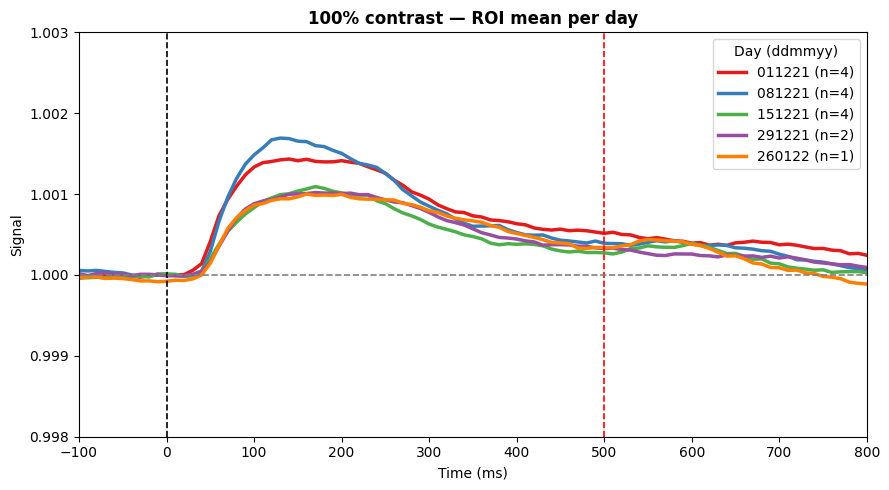

In [4]:
from pathlib import Path
from collections import defaultdict
from datetime import datetime
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# =====================================================
# 1. SET YOUR ACTUAL OUTDIR EXACTLY AS YOU PROVIDED
# =====================================================
outdir = Path(r"C:\Users\amity\Desktop\Learning\university\Msc\Vision Lab\VSDI\preprocessed_VSDdata\_overlays_by_contrast_from_excel_roi\gradientColors\roiR10_auto1_boxX30-60_boxY30-60_seedC100_win100-200_moderaw_a876b6")

print("Using outdir:", outdir)

npz_path = outdir / "roi_timecourses_100pct.npz"
if not npz_path.exists():
    raise FileNotFoundError(f"NPZ not found: {npz_path}")

# =====================================================
# 2. LOAD THE NPZ FOR 100% CONTRAST
# =====================================================
data_100 = np.load(npz_path, allow_pickle=True)
t_ms   = data_100["t_ms"]
labels = data_100["labels"]
Y      = data_100["Y"]

print("Loaded:", npz_path)
print("Shape Y:", Y.shape)
print("Example labels:", labels[:5])

# =====================================================
# 3. GROUP SESSIONS BY DAY ("ddmmyy")
# =====================================================
day_to_rows = defaultdict(list)
for i, lab in enumerate(labels):
    lab = str(lab)
    day = lab[:-1]     # drop the session letter
    day_to_rows[day].append(i)

def dc_to_dt(dc):
    return datetime.strptime(dc, "%d%m%y")

sorted_days = sorted(day_to_rows.keys(), key=dc_to_dt)
print("Days found:", sorted_days)

# =====================================================
# 4. PLOT MEAN TIMECOURSE PER DAY
# =====================================================
STIM_DURATION_MS = 500
XLIM_MS = (-100, 800)
YLIM = (0.998, 1.003)
DFF_MODE = "raw"

colors = sns.color_palette("Set1", len(sorted_days))

fig, ax = plt.subplots(figsize=(9, 5))

for col, day in zip(colors, sorted_days):
    idxs = day_to_rows[day]
    mean_ts = Y[idxs].mean(axis=0)
    ax.plot(t_ms, mean_ts, color=col, lw=2.5,
            label=f"{day} (n={len(idxs)})")

# Decorations
ax.axvline(0, color="k", ls="--", lw=1.2)
ax.axvline(STIM_DURATION_MS, color="r", ls="--", lw=1.2)
ax.axhline(1, color="grey", ls="--", lw=1.2)

ax.set_xlim(*XLIM_MS)
ax.set_ylim(*YLIM)
ax.set_title("100% contrast — ROI mean per day", fontweight="bold")
ax.set_xlabel("Time (ms)")
ax.set_ylabel("ΔF/F" if DFF_MODE != "raw" else "Signal")
ax.legend(title="Day (ddmmyy)")

plt.tight_layout()

save_path = outdir / "overlay_100pct_roi_mean_per_day.png"
plt.savefig(save_path, dpi=150)
print("Saved figure to:", save_path)

plt.show()


# activation maps for specific contrast per day

[PER-DAY MAPS] Using outdir: C:\Users\amity\Desktop\Learning\university\Msc\Vision Lab\Thesis\preprocessed_VSDdata\_overlays_by_contrast_from_excel_roi\sameDayColor\roiR10_auto1_boxX30-60_boxY30-60_seedC100_win100-200_moderaw_fbd2fe
[PER-DAY MAPS] Saving to: C:\Users\amity\Desktop\Learning\university\Msc\Vision Lab\Thesis\preprocessed_VSDdata\_overlays_by_contrast_from_excel_roi\sameDayColor\roiR10_auto1_boxX30-60_boxY30-60_seedC100_win100-200_moderaw_fbd2fe\_daymaps\e7a69ec1
[PER-DAY MAPS] Contrasts used: [100, 64, 32, 16, 10]
[PER-DAY MAPS] Shared ROI scale: vmin=1.00021, vmax=1.00159


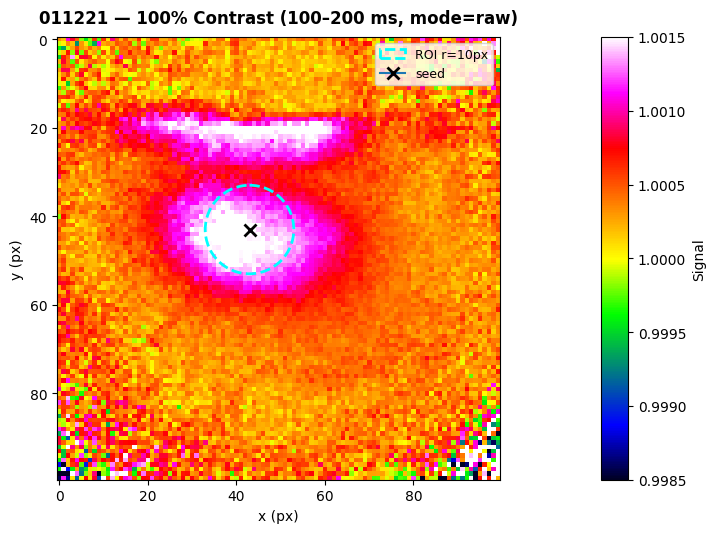

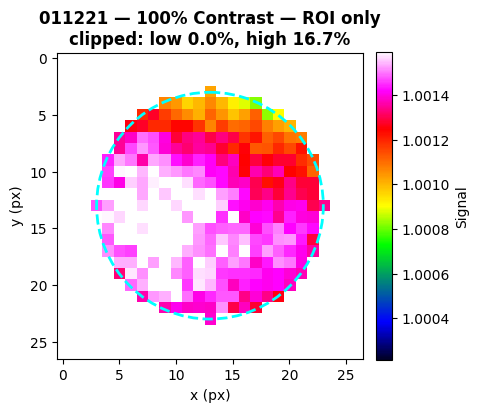

[SKIP] 011221 — 64% (no sessions with this contrast)


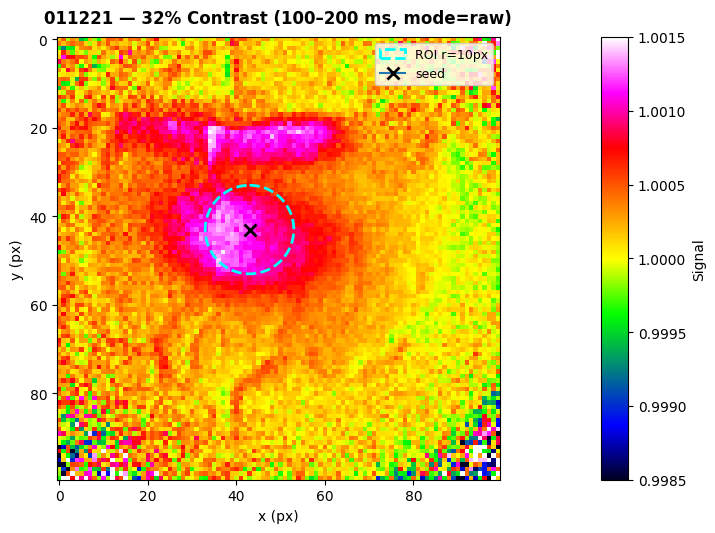

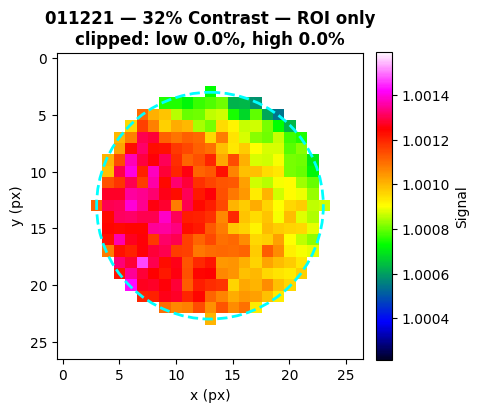

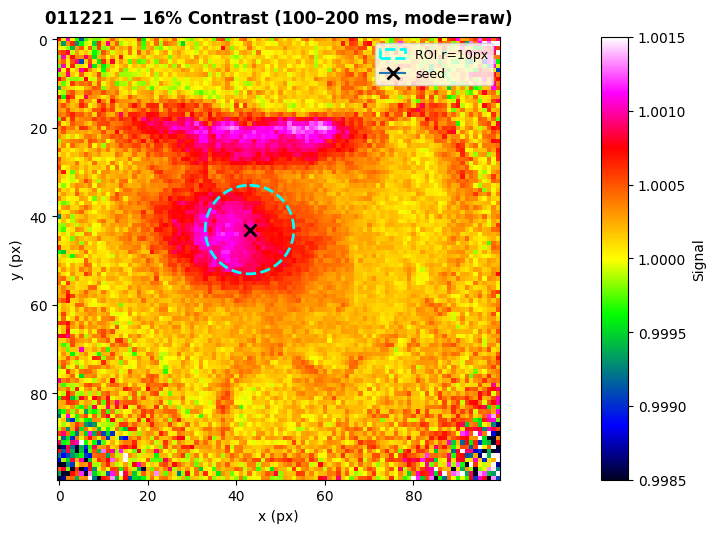

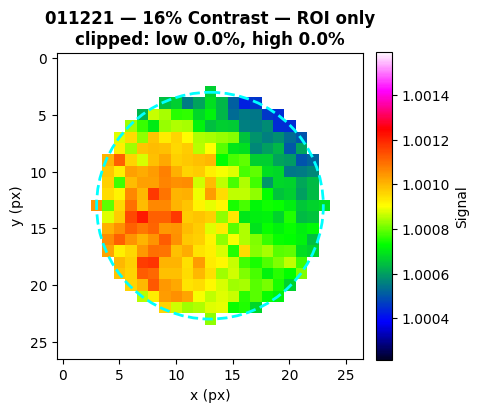

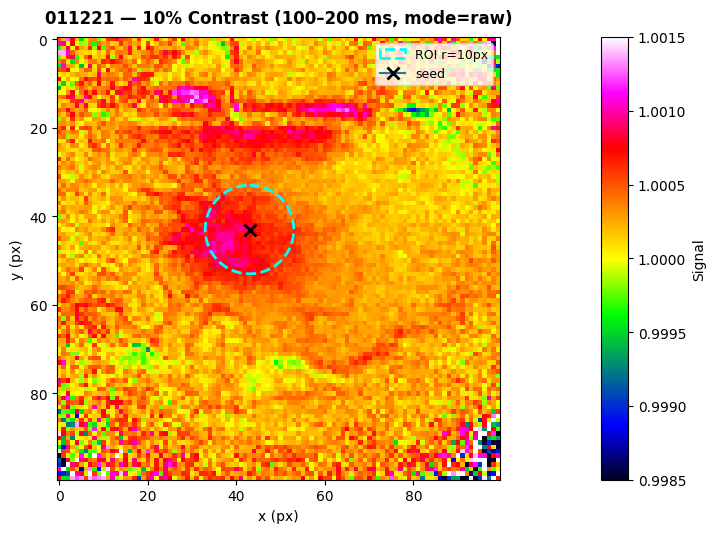

...

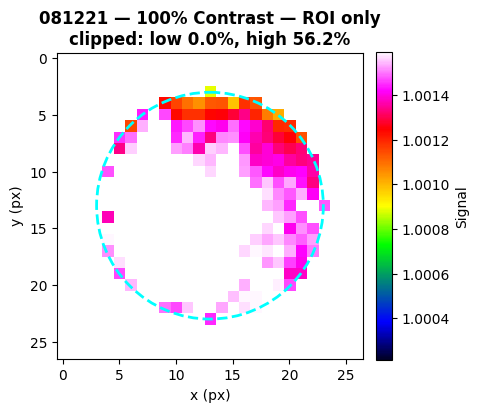

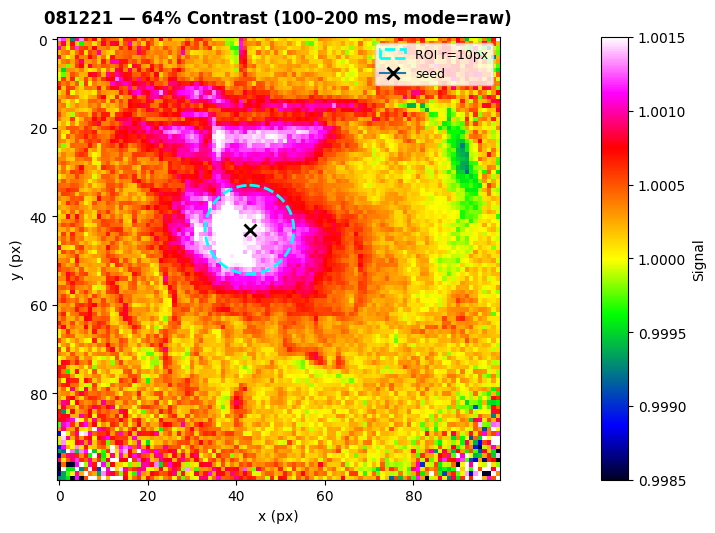

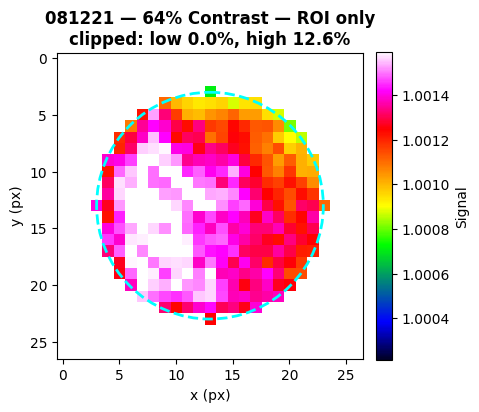

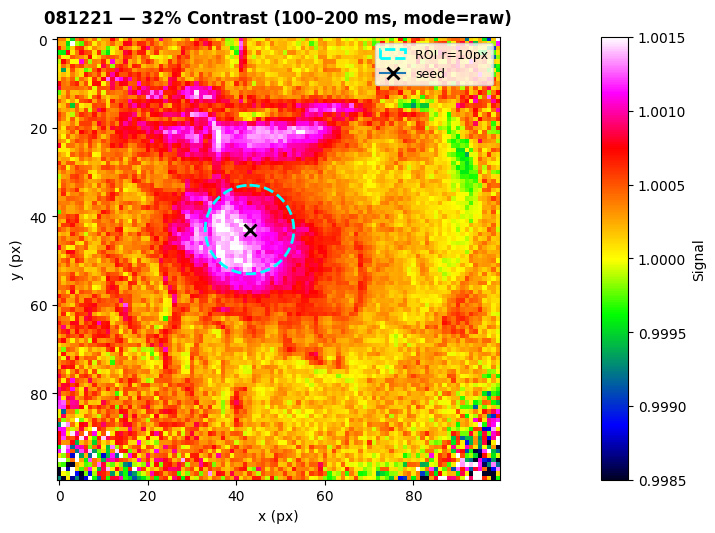

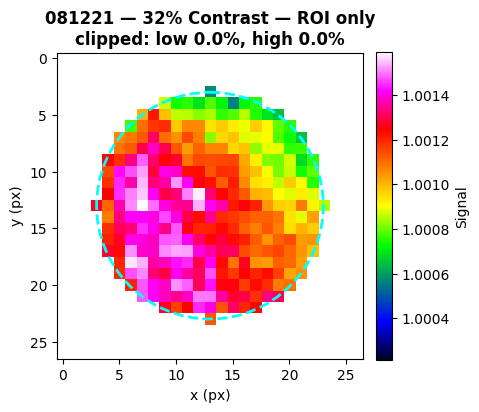

[SKIP] 081221 — 16% (no sessions with this contrast)


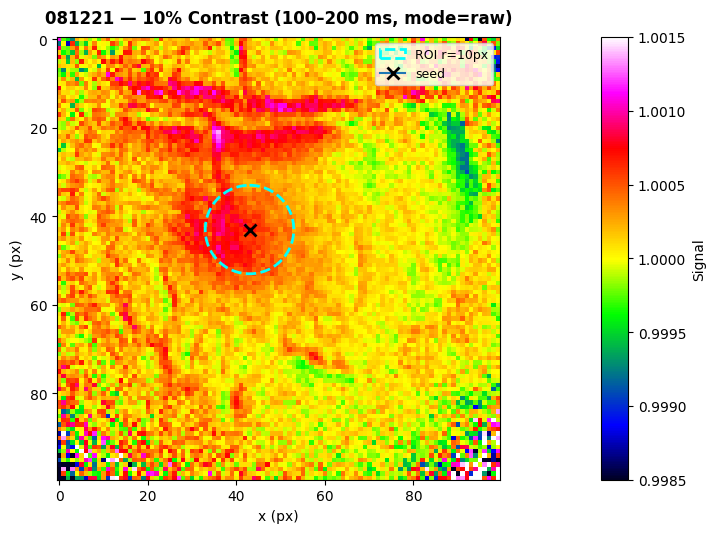

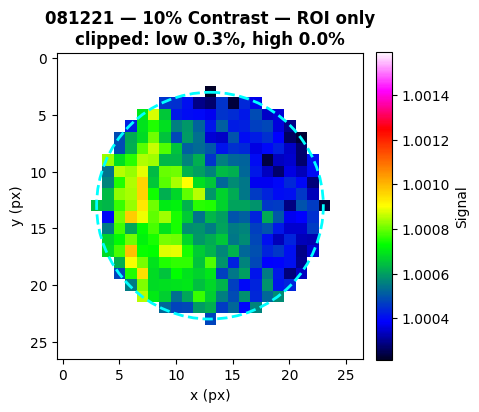

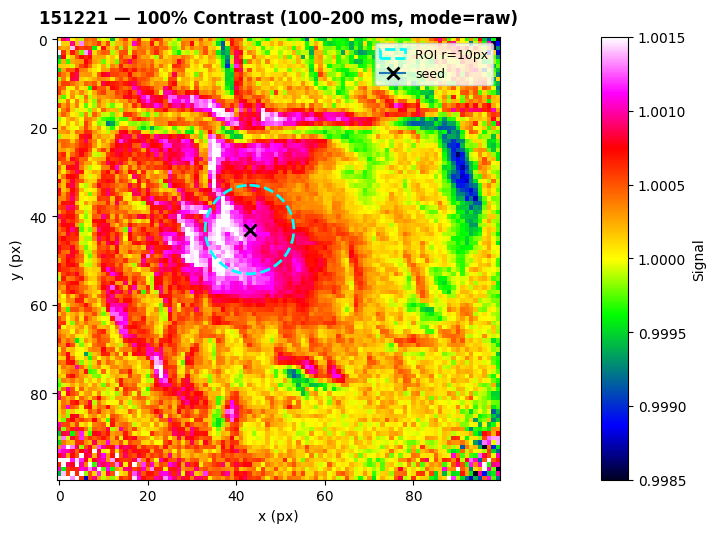

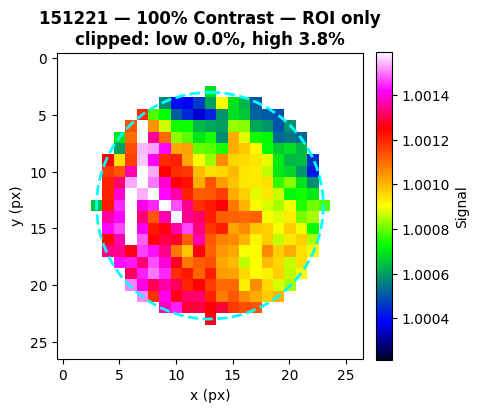

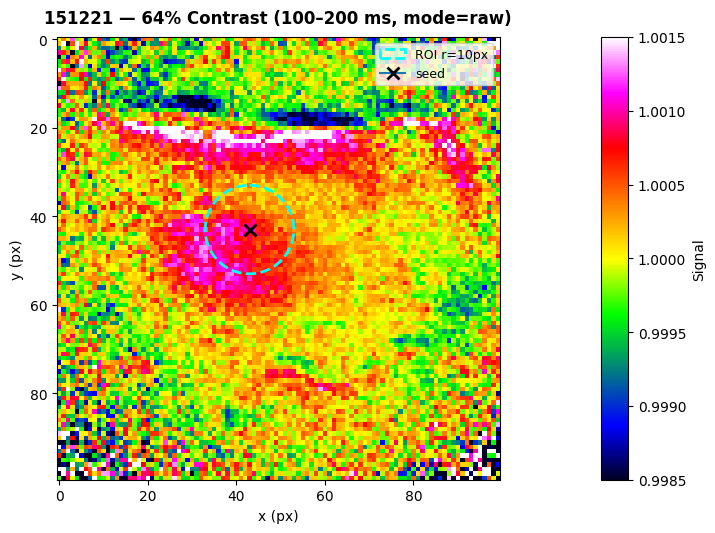

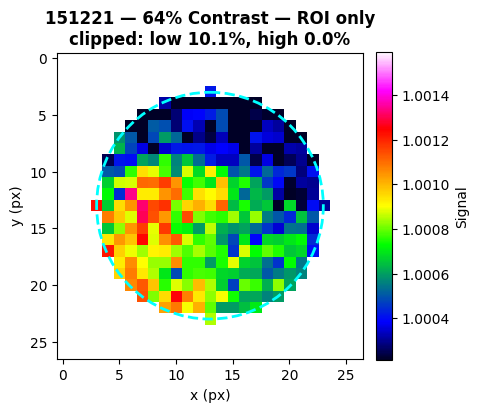

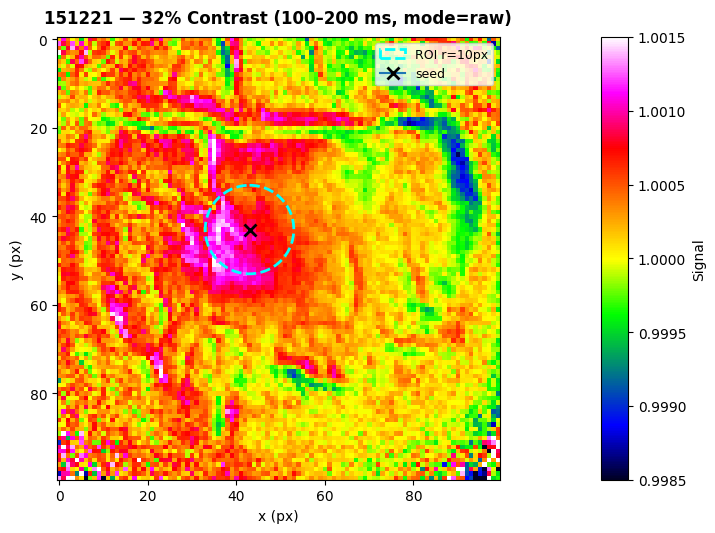

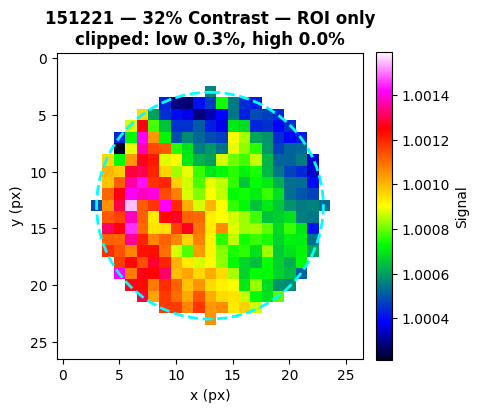

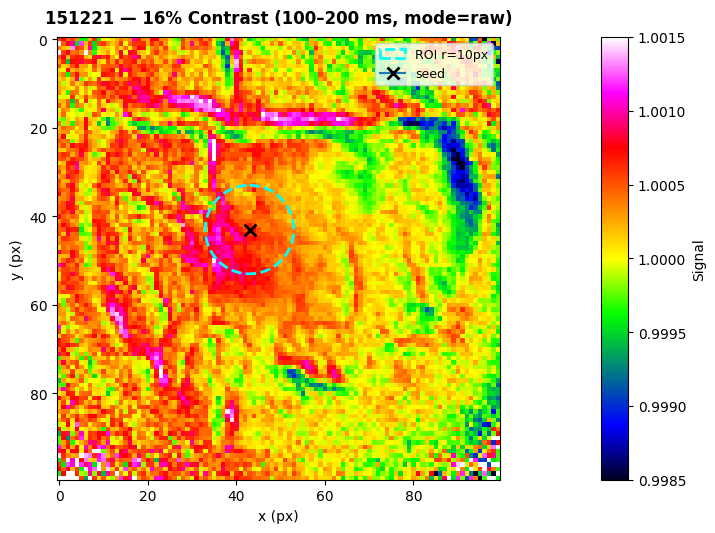

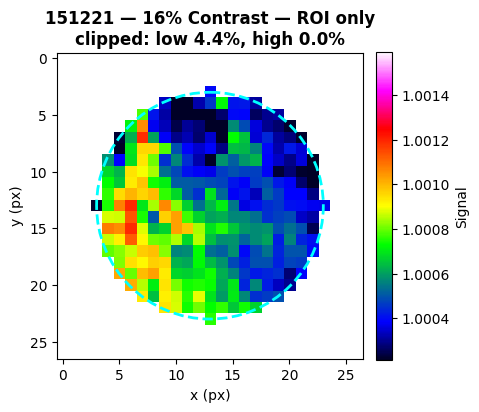

[SKIP] 151221 — 10% (no sessions with this contrast)


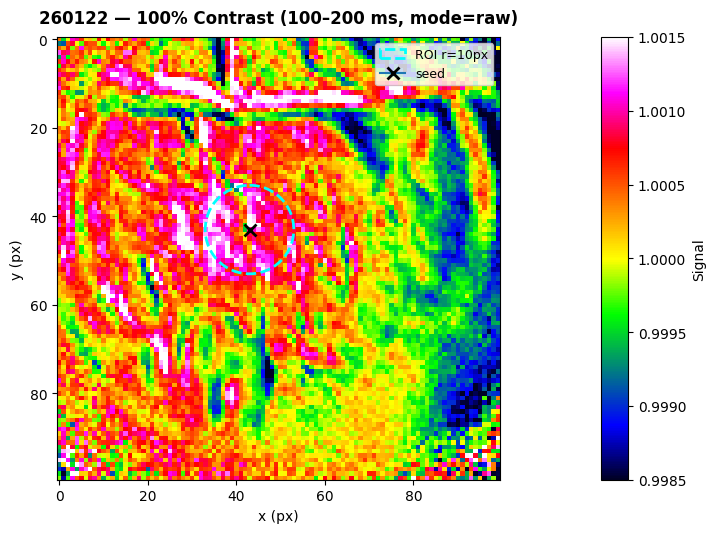

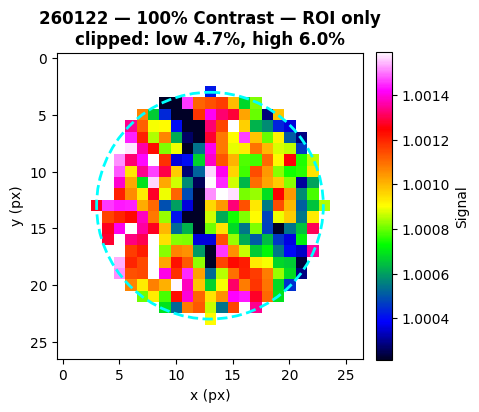

[SKIP] 260122 — 64% (no sessions with this contrast)


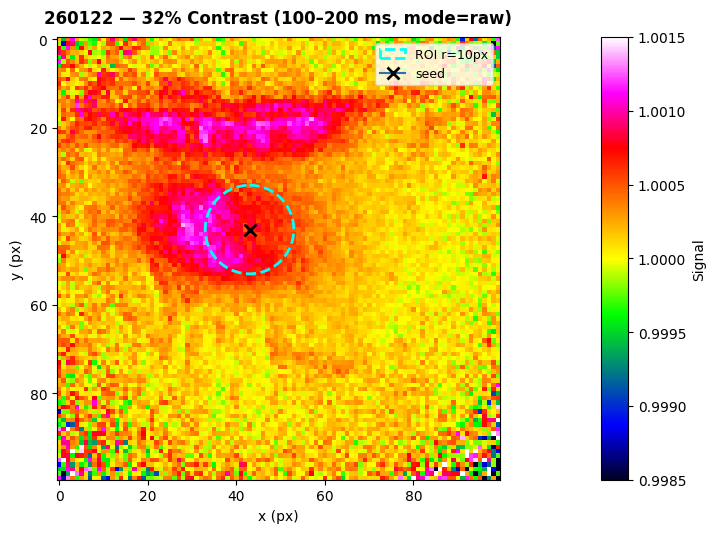

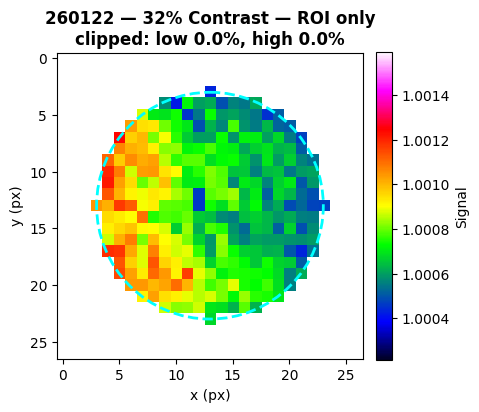

[SKIP] 260122 — 16% (no sessions with this contrast)


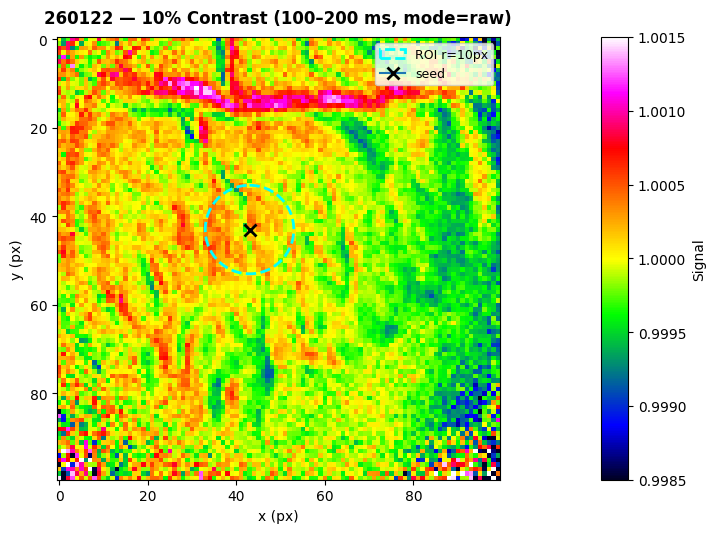

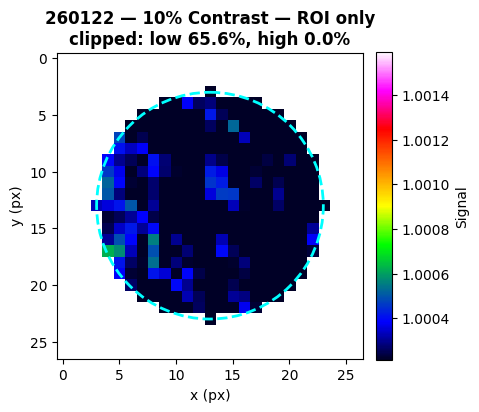

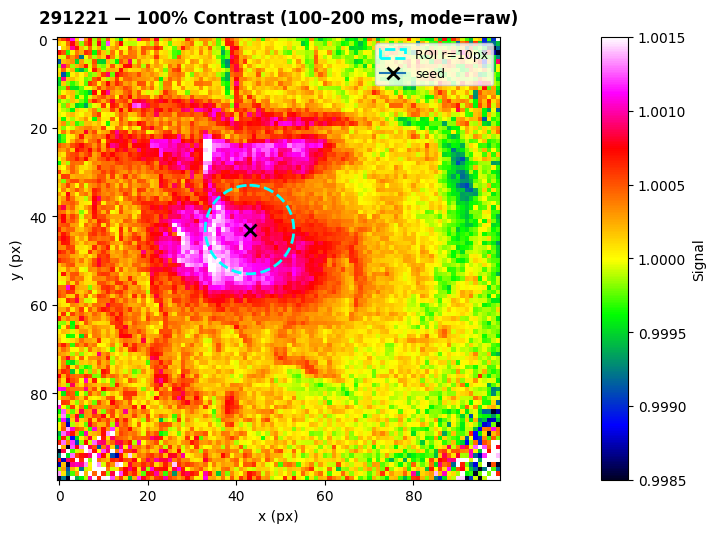

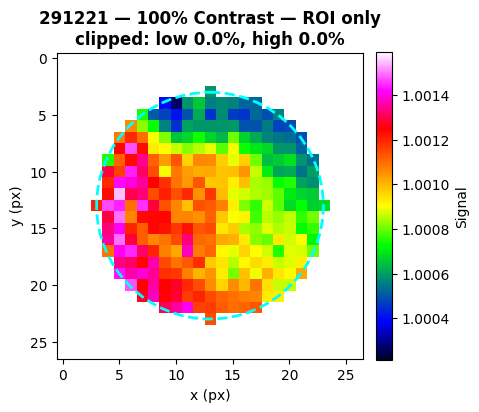

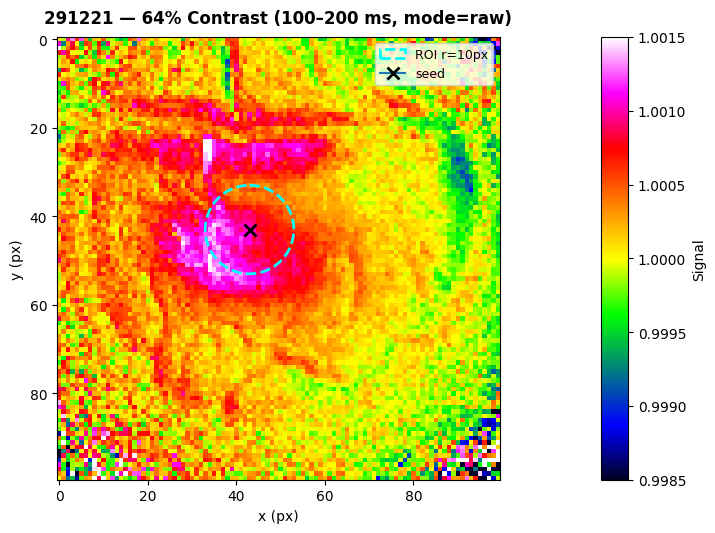

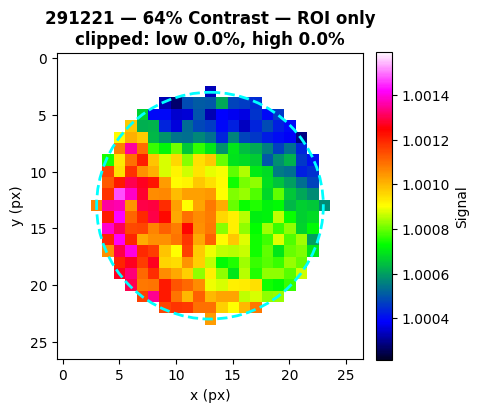

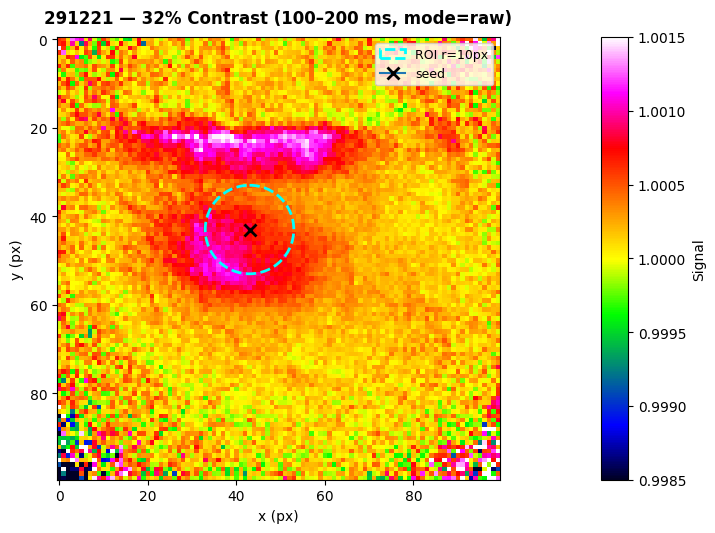

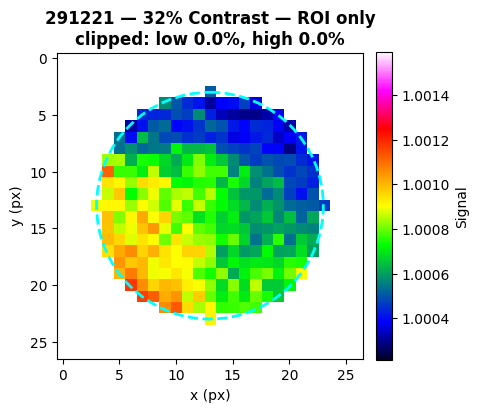

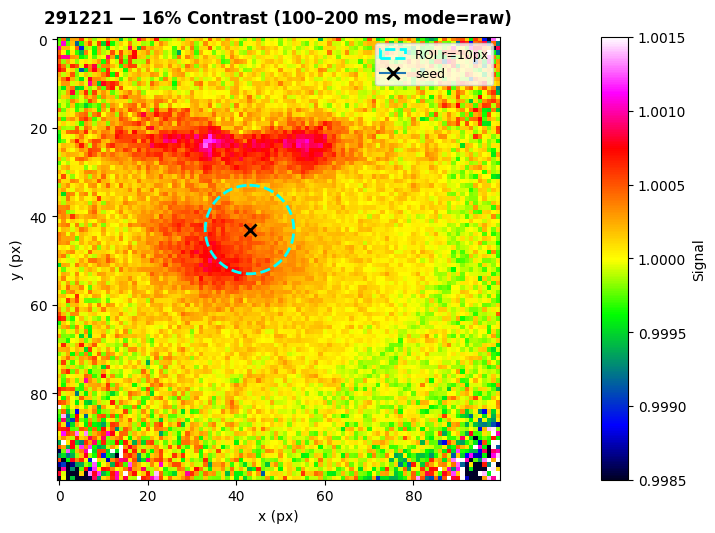

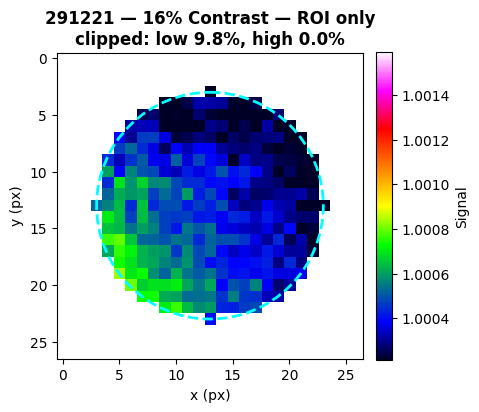

[SKIP] 291221 — 10% (no sessions with this contrast)
[DONE] Per-day activation maps written to:
  C:\Users\amity\Desktop\Learning\university\Msc\Vision Lab\Thesis\preprocessed_VSDdata\_overlays_by_contrast_from_excel_roi\sameDayColor\roiR10_auto1_boxX30-60_boxY30-60_seedC100_win100-200_moderaw_fbd2fe\_daymaps\e7a69ec1\full
  C:\Users\amity\Desktop\Learning\university\Msc\Vision Lab\Thesis\preprocessed_VSDdata\_overlays_by_contrast_from_excel_roi\sameDayColor\roiR10_auto1_boxX30-60_boxY30-60_seedC100_win100-200_moderaw_fbd2fe\_daymaps\e7a69ec1\roi


In [41]:
# =========================
# Per-day activation maps (full FOV + ROI-only), per contrast
# =========================
from pathlib import Path
import sys, re, json, hashlib
import numpy as np
import pandas as pd
import scipy.io as sio
import matplotlib.pyplot as plt
from matplotlib.patches import Circle

# ---------- Config (mirrors per-session defaults) ----------
DAYMAP_CONTRASTS         = (100, 64, 32, 16, 10)
DAYMAP_WINDOW_MS         = tuple(globals().get("AUTO_SEED_TIME_MS", (100, 200)))
DAYMAP_DFF_MODE          = globals().get("DFF_MODE", "raw")
DAYMAP_BASELINE_FRAMES   = globals().get("BASELINE_FRAMES", (24, 27))
DAYMAP_CMAP              = globals().get("SEEDMAP_CMAP", plt.cm.viridis)
DAYMAP_ROI_PAD_PX        = 3
DAYMAP_USE_TRIAL_WEIGHTS = True       # session average weighted by n_trials
DAYMAP_SCALE_PCT         = (5, 95)    # shared ROI scale over ALL per-day ROI pixels

# ---------- Safe save (handles Windows long paths) ----------
def _safe_savefig(fig, path, **kwargs):
    p = Path(path)
    p.parent.mkdir(parents=True, exist_ok=True)
    try:
        fig.savefig(p, **kwargs)
    except FileNotFoundError:
        if sys.platform.startswith("win"):
            fig.savefig("\\\\?\\" + str(p), **kwargs)
        else:
            raise

# ---------- Resolve the same run folder you used for per-session ----------
def _find_outdir():
    if "outdir" in globals() and any(Path(outdir).glob("roi_timecourses_*pct.npz")):
        return Path(outdir)
    root = Path(PREPROC_BASE) / "_overlays_by_contrast_from_excel_roi"
    rows = []
    for cfg in root.rglob("config.json"):
        run_dir = cfg.parent
        npz_count = len(list(run_dir.glob("roi_timecourses_*pct.npz")))
        rows.append((cfg.stat().st_mtime, npz_count, run_dir))
    rows.sort(reverse=True)
    for _, n, d in rows:
        if n > 0:
            return d
    raise RuntimeError("No runs with NPZ files found.")

try:
    _outdir
except NameError:
    _outdir = _find_outdir()

print(f"[PER-DAY MAPS] Using outdir: {_outdir}")

# ---------- Hashed output dir so we don't overwrite earlier runs ----------
_cfg_for_hash = dict(
    win=tuple(DAYMAP_WINDOW_MS),
    dff=DAYMAP_DFF_MODE,
    base=tuple(DAYMAP_BASELINE_FRAMES),
    scale_pct=tuple(DAYMAP_SCALE_PCT),
    weights=int(DAYMAP_USE_TRIAL_WEIGHTS),
    contrasts=tuple(DAYMAP_CONTRASTS),
    radius=int(globals().get("RADIUS_PX", 0)),
)
DAYMAP_HASH = hashlib.md5(json.dumps(_cfg_for_hash, sort_keys=True).encode("utf-8")).hexdigest()[:8]

# Short, flat path to avoid MAX_PATH issues
_daymaps_root = Path(_outdir) / "_daymaps" / DAYMAP_HASH
daymap_dir_full = _daymaps_root / "full"
daymap_dir_roi  = _daymaps_root / "roi"
daymap_dir_full.mkdir(parents=True, exist_ok=True)
daymap_dir_roi.mkdir(parents=True, exist_ok=True)
with open(_daymaps_root / "meta.json", "w", encoding="utf-8") as f:
    json.dump(dict(outdir=str(_outdir), **_cfg_for_hash), f, indent=2)
print(f"[PER-DAY MAPS] Saving to: {_daymaps_root}")

# ---------- Load n_trials for weighting (from the NPZs you already save) ----------
npz_files = sorted(Path(_outdir).glob("roi_timecourses_*pct.npz"))
lab2pctN = {}   # session label -> {contrast: n_trials}
contrasts_found = []
for f in npz_files:
    m = re.search(r"roi_timecourses_(\d+)pct\.npz$", f.name)
    if not m:
        continue
    pct = int(m.group(1)); contrasts_found.append(pct)
    Z = np.load(f, allow_pickle=True)
    labels = [str(x) for x in Z["labels"]]
    ntr    = Z["n_trials"] if "n_trials" in Z.files else np.ones(len(labels), int)
    for li, lab in enumerate(labels):
        lab2pctN.setdefault(lab, {})[pct] = int(ntr[li])
contrasts_avail = sorted(set(contrasts_found))
contrasts = [c for c in DAYMAP_CONTRASTS if c in contrasts_avail] or contrasts_avail
print(f"[PER-DAY MAPS] Contrasts used: {contrasts}")

# ---------- Helpers ----------
def _split_day_letter(lab: str):
    s = lab.strip().lower()
    m = re.match(r"(\d{6})([a-z])$", s)
    return (m.group(1), m.group(2)) if m else (s[:-1], s[-1])

day_list = sorted({ s["date_code"] for s in sessions })

# precompute ROI mask flat (data coords)
roi_mask_flat = circle_roi_mask(seed_xy, RADIUS_PX, image_shape).astype(bool)

# ---------- Build per-day mean-in-window flat images ----------
# day_mean[(day, contrast)] -> flat array length P
day_mean = {}
roi_vals_for_scale = []

for d in day_list:
    sess_list = [s for s in sessions if s["date_code"] == d]
    for pct in contrasts:
        per_sess = []
        weights  = []
        for s in sess_list:
            mp = Path(s["mat_path"])
            if not mp.exists():
                continue
            mat = sio.loadmat(str(mp), squeeze_me=True, struct_as_record=False)
            ck  = s["pct_to_cond"].get(pct)
            arr = mat.get(ck) if ck else None
            if arr is None:
                continue

            arr = np.asarray(arr)
            X = compute_dff(arr, cond=None, frames=None,
                            dff_mode=DAYMAP_DFF_MODE, baseline_frames=DAYMAP_BASELINE_FRAMES)  # (P,F)
            onset0 = FRAME_ONSET_IDX_1 - 1
            s0 = onset0 + ms_to_frame_offset(DAYMAP_WINDOW_MS[0], FRAME_RATE_HZ)
            e0 = onset0 + ms_to_frame_offset(DAYMAP_WINDOW_MS[1], FRAME_RATE_HZ)
            s0 = max(0, min(X.shape[1]-1, s0))
            e0 = max(s0+1, min(X.shape[1],   e0))
            img_flat = X[:, s0:e0].mean(axis=1)  # (P,)

            per_sess.append(img_flat)
            if DAYMAP_USE_TRIAL_WEIGHTS:
                lab = f"{s['date_code']}{s['letter']}"
                weights.append(max(1, lab2pctN.get(lab, {}).get(pct, 1)))
            else:
                weights.append(1.0)

        if per_sess:
            A = np.stack(per_sess, axis=0)        # (S,P)
            w = np.asarray(weights, float)
            w = w / np.sum(w)
            mean_flat = np.sum(A * w[:, None], axis=0)
            day_mean[(d, pct)] = mean_flat
            roi_vals_for_scale.append(mean_flat[roi_mask_flat])

# ---------- Shared ROI scale from all per-day ROI pixels ----------
if roi_vals_for_scale:
    z = np.concatenate([v[np.isfinite(v)] for v in roi_vals_for_scale if np.isfinite(v).any()])
    if z.size:
        roi_vmin = float(np.percentile(z, DAYMAP_SCALE_PCT[0]))
        roi_vmax = float(np.percentile(z, DAYMAP_SCALE_PCT[1]))
    else:
        roi_vmin, roi_vmax = 1.0 - 0.0015, 1.0 + 0.0015
else:
    roi_vmin, roi_vmax = 1.0 - 0.0015, 1.0 + 0.0015
print(f"[PER-DAY MAPS] Shared ROI scale: vmin={roi_vmin:.6g}, vmax={roi_vmax:.6g}")

# ---------- Plotters ----------
def _plot_full_from_flat(flat, title_prefix, save_path, cmap=DAYMAP_CMAP, vmin=None, vmax=None):
    """Fallback full-FOV map if plot_seed_roi_overlay isn't available."""
    H, W = image_shape
    img2d = flat.reshape((H, W), order="F")
    img_disp, (cx, cy) = _apply_display_rotation(img2d, seed_xy, DISPLAY_ROTATION)

    fig = plt.figure(figsize=(6.2, 5.2))
    ax  = fig.add_subplot(111)
    im = ax.imshow(img_disp, origin=DISPLAY_ORIGIN, cmap=cmap, vmin=vmin, vmax=vmax, interpolation="nearest")
    ax.plot(cx, cy, marker="x", ms=8, mew=2, color="k", label="seed")
    ax.add_patch(Circle((cx, cy), RADIUS_PX, edgecolor="cyan", facecolor="none", lw=2.0, ls="--", label=f"ROI r={RADIUS_PX}px"))
    ax.legend(loc="upper right", frameon=True, fontsize=9)
    tag = f"{DAYMAP_WINDOW_MS[0]}-{DAYMAP_WINDOW_MS[1]} ms, mode={DAYMAP_DFF_MODE}"
    ax.set_title(f"{title_prefix} ({tag})", fontweight="bold")
    ax.set_xlabel("x (px)"); ax.set_ylabel("y (px)")
    ax.set_aspect("equal")
    cb = plt.colorbar(im, ax=ax, fraction=0.046, pad=0.04)
    cb.set_label("ΔF/F" if DAYMAP_DFF_MODE != "raw" else "Signal")
    fig.tight_layout()
    _safe_savefig(fig, save_path, dpi=150, bbox_inches="tight")
    plt.show()

def _plot_roi_only_from_flat(flat, title_prefix, save_path,
                             cmap=DAYMAP_CMAP, vmin=None, vmax=None, pad_px=DAYMAP_ROI_PAD_PX,
                             add_clip_note=True):
    """ROI-only crop with clipping % annotation (identical look to your per-session ROI-only)."""
    H, W = image_shape
    img2d = flat.reshape((H, W), order="F")
    img_disp, (cx, cy) = _apply_display_rotation(img2d, seed_xy, DISPLAY_ROTATION)

    # crop to ROI
    y0 = max(0, int(np.floor(cy - RADIUS_PX - pad_px)))
    y1 = min(img_disp.shape[0], int(np.ceil (cy + RADIUS_PX + pad_px + 1)))
    x0 = max(0, int(np.floor(cx - RADIUS_PX - pad_px)))
    x1 = min(img_disp.shape[1], int(np.ceil (cx + RADIUS_PX + pad_px + 1)))
    img_crop  = img_disp[y0:y1, x0:x1]

    # ROI mask in display coords for clipping stats
    roi_mask_disp, _ = _apply_display_rotation(
        roi_mask_flat.reshape((H, W), order="F").astype(float), seed_xy, DISPLAY_ROTATION
    )
    roi_mask_disp = roi_mask_disp.astype(bool)[y0:y1, x0:x1]
    roi_vals = img_crop[roi_mask_disp]
    finite = roi_vals[np.isfinite(roi_vals)]
    pct_low = pct_high = 0.0
    if finite.size:
        pct_low  = 100.0 * float((finite <= vmin).sum()) / float(finite.size)
        pct_high = 100.0 * float((finite >= vmax).sum()) / float(finite.size)

    fig = plt.figure(figsize=(4.8, 4.3))
    ax  = fig.add_subplot(111)
    im = ax.imshow(np.where(roi_mask_disp, img_crop, np.nan),
                   origin=DISPLAY_ORIGIN, cmap=cmap, vmin=vmin, vmax=vmax, interpolation="nearest")
    ax.add_patch(Circle((cx - x0, cy - y0), RADIUS_PX, edgecolor="cyan", facecolor="none", lw=2.0, ls="--"))
    t = f"{title_prefix} — ROI only"
    if add_clip_note:
        t += f"\nclipped: low {pct_low:.1f}%, high {pct_high:.1f}%"
    ax.set_title(t, fontweight="bold")
    ax.set_xlabel("x (px)"); ax.set_ylabel("y (px)")
    ax.set_aspect("equal")
    cb = plt.colorbar(im, ax=ax, fraction=0.046, pad=0.04)
    cb.set_label("ΔF/F" if DAYMAP_DFF_MODE != "raw" else "Signal")
    fig.tight_layout()
    _safe_savefig(fig, save_path, dpi=150, bbox_inches="tight")
    plt.show()

# ---------- Generate and save maps ----------
for d in day_list:
    for pct in contrasts:
        flat = day_mean.get((d, pct), None)
        if flat is None:
            print(f"[SKIP] {d} — {pct}% (no sessions with this contrast)")
            continue

        title = f"{d} — {pct}% Contrast"

        # FULL FOV (use your plot_seed_roi_overlay if defined; else fallback)
        f_full = daymap_dir_full / f"{d}_{pct:03d}pct.png"
        try:
            H, W = image_shape
            img2d = flat.reshape((H, W), order="F")
            # plot_seed_roi_overlay expects time-series; pass a 2-frame stub
            arr_stub = np.tile(img2d.reshape(-1, 1, order="F"), (1, 2))
            # ensure the plotter uses our shared vmin/vmax if it supports it; otherwise colorbar is from function
            plot_seed_roi_overlay(
                np.asarray(arr_stub), image_shape, seed_xy, RADIUS_PX,
                window_ms=DAYMAP_WINDOW_MS, frame_rate_hz=FRAME_RATE_HZ,
                onset_idx_1=FRAME_ONSET_IDX_1, dff_mode=DAYMAP_DFF_MODE,
                baseline_frames=DAYMAP_BASELINE_FRAMES, cmap=DAYMAP_CMAP,
                title_prefix=title, save_path=f_full
            )
        except NameError:
            _plot_full_from_flat(flat, title, f_full, vmin=roi_vmin, vmax=roi_vmax)

        # ROI ONLY (shared scale + clipping % in title)
        f_roi  = daymap_dir_roi / f"{d}_{pct:03d}pct_roi.png"
        _plot_roi_only_from_flat(flat, title, f_roi, vmin=roi_vmin, vmax=roi_vmax)

print(f"[DONE] Per-day activation maps written to:\n  {daymap_dir_full}\n  {daymap_dir_roi}")


# CRF across days

[CRF] Using outdir: C:\Users\amity\Desktop\Learning\university\Msc\Vision Lab\Thesis\preprocessed_VSDdata\_overlays_by_contrast_from_excel_roi\sameDayColor\roiR10_auto1_boxX30-60_boxY30-60_seedC100_win100-200_moderaw_fbd2fe
[CRF] Saving outputs to: C:\Users\amity\Desktop\Learning\university\Msc\Vision Lab\Thesis\preprocessed_VSDdata\_overlays_by_contrast_from_excel_roi\sameDayColor\roiR10_auto1_boxX30-60_boxY30-60_seedC100_win100-200_moderaw_fbd2fe\crf_8396c1a1
[CRF] Contrasts found: [4, 8, 10, 12, 16, 24, 32, 64, 100]
[CRF] Saved CRF points: C:\Users\amity\Desktop\Learning\university\Msc\Vision Lab\Thesis\preprocessed_VSDdata\_overlays_by_contrast_from_excel_roi\sameDayColor\roiR10_auto1_boxX30-60_boxY30-60_seedC100_win100-200_moderaw_fbd2fe\crf_8396c1a1\points.csv (weighted=True)
[CRF] Saved parameters: C:\Users\amity\Desktop\Learning\university\Msc\Vision Lab\Thesis\preprocessed_VSDdata\_overlays_by_contrast_from_excel_roi\sameDayColor\roiR10_auto1_boxX30-60_boxY30-60_seedC100_win10

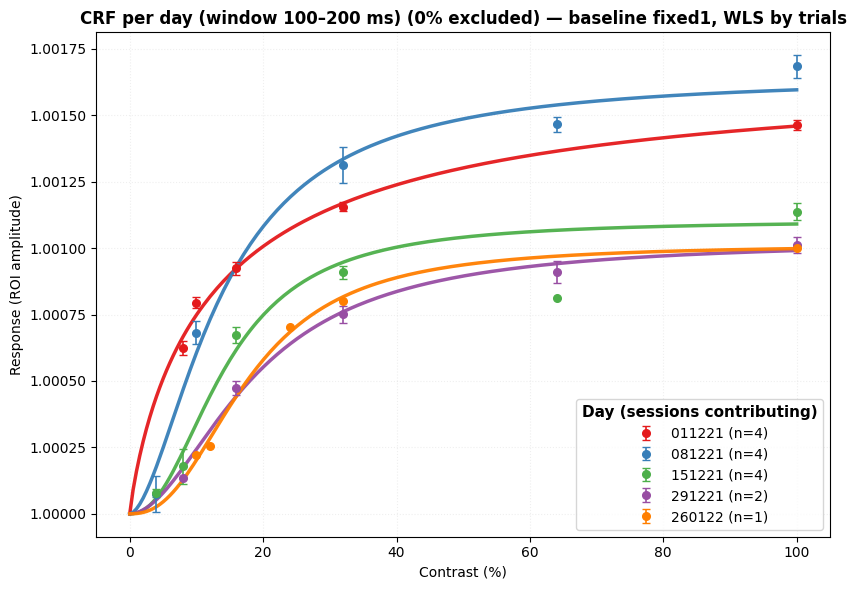

[CRF] Saved per-day parameter plot with better n annotations: C:\Users\amity\Desktop\Learning\university\Msc\Vision Lab\Thesis\preprocessed_VSDdata\_overlays_by_contrast_from_excel_roi\sameDayColor\roiR10_auto1_boxX30-60_boxY30-60_seedC100_win100-200_moderaw_fbd2fe\crf_8396c1a1\params_plus_with_npoints.png


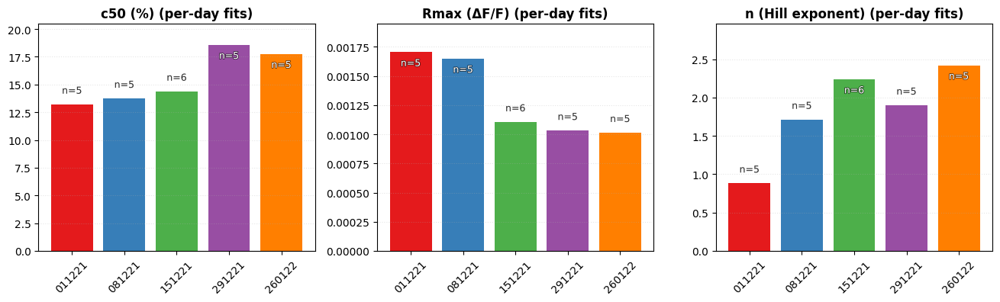

[CRF] Saved plot with n annotations: C:\Users\amity\Desktop\Learning\university\Msc\Vision Lab\Thesis\preprocessed_VSDdata\_overlays_by_contrast_from_excel_roi\sameDayColor\roiR10_auto1_boxX30-60_boxY30-60_seedC100_win100-200_moderaw_fbd2fe\crf_8396c1a1\r2_by_day_bar_with_npoints.png


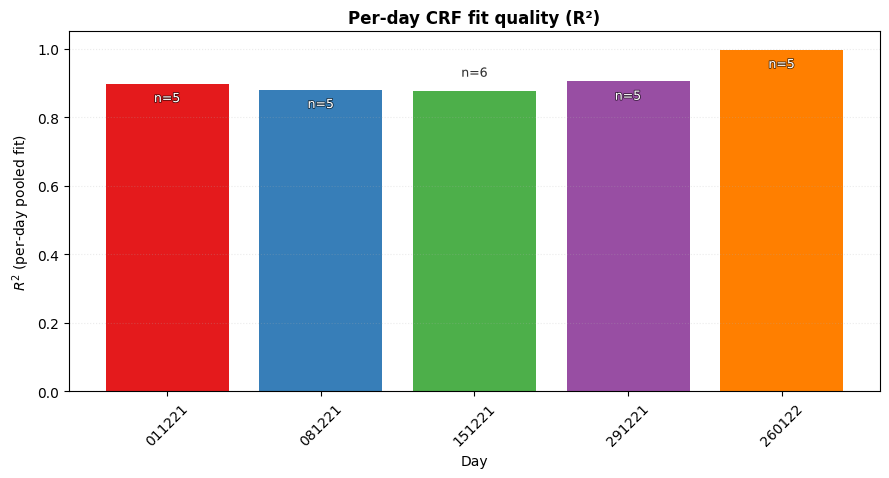

[CRF] Saved session-level R²: C:\Users\amity\Desktop\Learning\university\Msc\Vision Lab\Thesis\preprocessed_VSDdata\_overlays_by_contrast_from_excel_roi\sameDayColor\roiR10_auto1_boxX30-60_boxY30-60_seedC100_win100-200_moderaw_fbd2fe\crf_8396c1a1\session_r2.csv

[DEBUG] R² values for 151221:
    session        R2
8   151221b  0.988939
9   151221c  0.979523
10  151221d  0.960286
11  151221e  0.402350

[DEBUG] R² values for 081221:
   session        R2
4  081221b  0.872170
5  081221c  0.778442
6  081221d  0.983005
7  081221e  0.992892
[CRF] Saved plot showing outliers: C:\Users\amity\Desktop\Learning\university\Msc\Vision Lab\Thesis\preprocessed_VSDdata\_overlays_by_contrast_from_excel_roi\sameDayColor\roiR10_auto1_boxX30-60_boxY30-60_seedC100_win100-200_moderaw_fbd2fe\crf_8396c1a1\r2_by_day_box_with_outlier.png


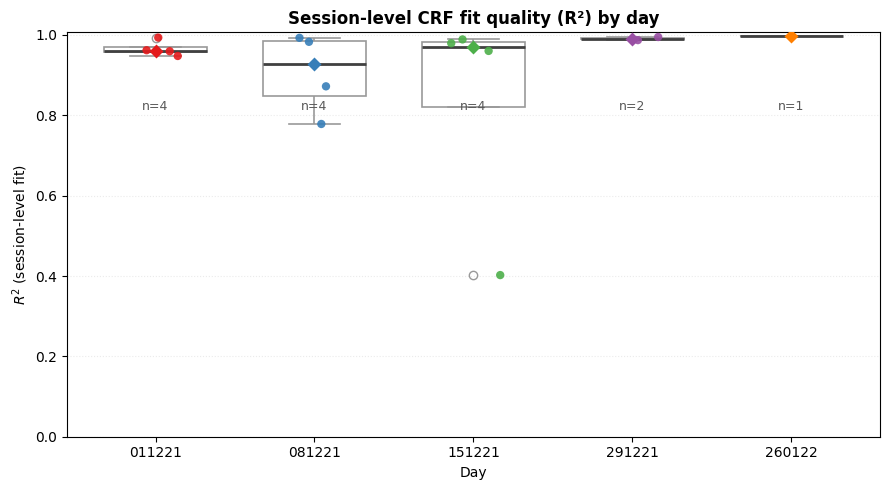

[CRF] Saved per-session parameters: C:\Users\amity\Desktop\Learning\university\Msc\Vision Lab\Thesis\preprocessed_VSDdata\_overlays_by_contrast_from_excel_roi\sameDayColor\roiR10_auto1_boxX30-60_boxY30-60_seedC100_win100-200_moderaw_fbd2fe\crf_8396c1a1\session_params.csv
[CRF] Saved per-session parameter distributions: C:\Users\amity\Desktop\Learning\university\Msc\Vision Lab\Thesis\preprocessed_VSDdata\_overlays_by_contrast_from_excel_roi\sameDayColor\roiR10_auto1_boxX30-60_boxY30-60_seedC100_win100-200_moderaw_fbd2fe\crf_8396c1a1\params_by_day_sessionfits.png


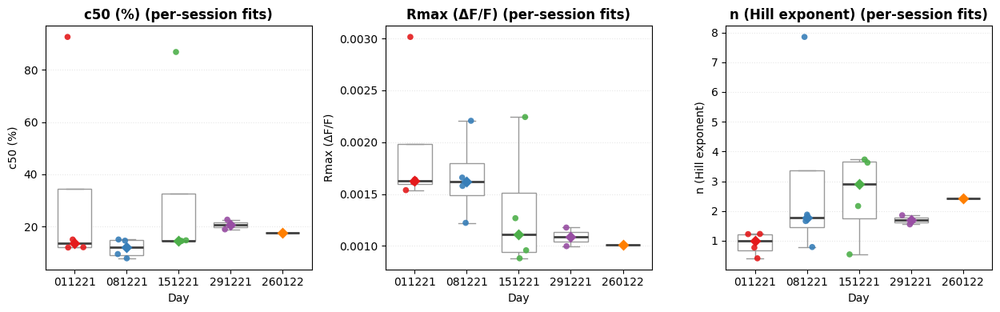

In [37]:
# === CRF (Naka–Rushton) analysis ACROSS DAYS (short-path, non-overwriting) ===
from pathlib import Path
import os, re, json, hashlib
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit
import seaborn as sns
from collections import defaultdict

# ---- Config for CRF extraction/plots ----
CRF_WINDOW_MS = AUTO_SEED_TIME_MS        # time window to summarize response (ms)
CRF_METHOD    = "peak"                   # "mean" | "peak" (within window)
CRF_PALETTE   = "Set1"                   # day hues
CRF_MIN_POINTS_TO_FIT = 3                # need ≥3 non-zero contrasts to fit
CRF_EXCLUDE_ZERO_FROM_FIT = True         # don't use 0% in Naka–Rushton fitting
CRF_SHOW_ZERO_POINTS      = True         # still show 0% as hollow markers on the plot
CRF_SHOW_ERRORBARS        = True         # draw SEM bars on scatter points
CRF_FIT_BASELINE_MODE     = "fixed1"     # "free" | "fixed1" (force baseline to 1.0 in fit)

# Weighting toggle
CRF_USE_TRIAL_WEIGHTS     = True         # True → WLS with weights ∝ n_trials; False → unweighted OLS

# Optional: force a specific run folder (paste full path string or leave empty)
CRF_OUTDIR_OVERRIDE = r""

# ---- Model ----
def naka_rushton(c, Rmax, c50, n, R0):
    c = np.asarray(c, dtype=float); eps = 1e-12
    return R0 + Rmax * (c**n / (c**n + c50**n + eps))

def naka_rushton_fixedR0(c, Rmax, c50, n):
    c = np.asarray(c, dtype=float); eps = 1e-12
    return 1.0 + Rmax * (c**n / (c**n + c50**n + eps))

# ---- Robust outdir discovery (only choose runs that have NPZs) ----
ROOT = Path(PREPROC_BASE) / "_overlays_by_contrast_from_excel_roi"

def _list_runs_with_npz(root=ROOT):
    rows = []
    for cfg in root.rglob("config.json"):
        run_dir = cfg.parent
        npz_count = len(list(run_dir.glob("roi_timecourses_*pct.npz")))
        rows.append((cfg.stat().st_mtime, npz_count, run_dir))
    rows.sort(reverse=True)
    print("[CRF] Runs found (newest first):")
    for _, n, d in rows: print(f"  {d}  — NPZ files: {n}")
    return rows

def _latest_outdir_with_npz(root=ROOT):
    rows = _list_runs_with_npz(root)
    for _, n, d in rows:
        if n > 0: return d
    raise RuntimeError("No runs with NPZ files found under: " + str(root))

if CRF_OUTDIR_OVERRIDE:
    _outdir = Path(CRF_OUTDIR_OVERRIDE)
elif "outdir" in globals() and any(Path(outdir).glob("roi_timecourses_*pct.npz")):
    _outdir = Path(outdir)
else:
    _outdir = _latest_outdir_with_npz()

print(f"[CRF] Using outdir: {_outdir}")

# ---- Hash a compact subfolder so runs don't overwrite each other ----
_cfg_for_hash = dict(method=CRF_METHOD,
                     win=tuple(CRF_WINDOW_MS),
                     base=CRF_FIT_BASELINE_MODE,
                     ex0=CRF_EXCLUDE_ZERO_FROM_FIT,
                     wts=int(CRF_USE_TRIAL_WEIGHTS))
CRF_HASH = hashlib.md5(json.dumps(_cfg_for_hash, sort_keys=True).encode("utf-8")).hexdigest()[:8]
crf_dir = _outdir / f"crf_{CRF_HASH}"
crf_dir.mkdir(parents=True, exist_ok=True)
print(f"[CRF] Saving outputs to: {crf_dir}")

with open(crf_dir / "meta.json", "w", encoding="utf-8") as f:
    json.dump(dict(outdir=str(_outdir), **_cfg_for_hash), f, indent=2)

# ---- Load timecourses & extract amplitudes per session/contrast ----
npz_files = sorted(_outdir.glob("roi_timecourses_*pct.npz"))
if not npz_files:
    raise RuntimeError(f"No roi_timecourses_XXpct.npz found in: {_outdir}")

lab2pctamp, lab2pctn, pcts_found = {}, {}, []
for f in npz_files:
    m = re.search(r"roi_timecourses_(\d+)pct\.npz$", f.name)
    if not m: continue
    pct = int(m.group(1)); pcts_found.append(pct)
    Z = np.load(f, allow_pickle=True)
    t_ms, labels, Y = Z["t_ms"], Z["labels"], Z["Y"]
    ntr = Z["n_trials"] if "n_trials" in Z.files else np.ones(len(labels), dtype=int)
    iwin = (t_ms >= CRF_WINDOW_MS[0]) & (t_ms <= CRF_WINDOW_MS[1])
    if not np.any(iwin):
        raise RuntimeError(f"No timepoints within CRF window {CRF_WINDOW_MS} in {f.name}")
    for li, lab in enumerate(labels.astype(str)):
        y = Y[li]
        amp = float(np.nanmean(y[iwin]) if CRF_METHOD == "mean" else np.nanmax(y[iwin]))
        lab2pctamp.setdefault(lab, {})[pct] = amp
        lab2pctn.setdefault(lab,   {})[pct] = int(ntr[li])

pcts_found = sorted(set(pcts_found))
print(f"[CRF] Contrasts found: {pcts_found}")

# ---- Group by day (ddmmyy) & color map ----
try:
    datecode_to_dt
except NameError:
    from datetime import datetime
    def datecode_to_dt(dc): return datetime.strptime(dc, "%d%m%y")

def _split_day_letter(lab: str):
    s = lab.strip().lower()
    m = re.match(r"(\d{6})([a-z])$", s)
    return (m.group(1), m.group(2)) if m else (s[:-1], s[-1])

day_list = sorted({ _split_day_letter(lab)[0] for lab in lab2pctamp },
                  key=lambda d: datecode_to_dt(d))
palette = sns.color_palette(CRF_PALETTE, max(1, len(day_list)))
day_colors = {d: palette[i] for i, d in enumerate(day_list)}

# ---- OPTIONAL trial-level SEM intake (reuses within-day helper if present) ----
lab2pctsem_trials = {}
def _get_trial_sem(label, pct):
    # If _trial_sem_for_point is defined in the kernel (from within-day script), use it.
    try:
        val = _trial_sem_for_point(label, pct)
        return float(val)
    except Exception:
        return np.nan

for lab, pctamp in lab2pctamp.items():
    for pct in pctamp.keys():
        lab2pctsem_trials.setdefault(lab, {})[pct] = _get_trial_sem(lab, pct)

# ---- Build per-day session points (store amp, n_trials, and label) ----
# day -> pct -> [(amp, n_trials, label), ...]
day_points = defaultdict(lambda: defaultdict(list))
for lab, pctamp in lab2pctamp.items():
    day, _ = _split_day_letter(lab)
    for pct, amp in pctamp.items():
        n = lab2pctn[lab].get(pct, 1)
        day_points[day][pct].append((amp, n, lab))

# ---- Reduce to (weighted) mean and SEM per day/contrast, trial-aware ----
def _combine_trial_aware_for_pct(triplets, pct, mode="ntrials"):
    """
    triplets: [(amp, n_trials, label), ...]
    Returns: (mean, sem, total_weight)
    """
    means = np.asarray([a for a, _, _ in triplets], float)
    w     = np.asarray([max(1, int(n)) for _, n, _ in triplets], float)
    mu    = np.average(means, weights=w)

    # attempt trial-level SEM combination if available for >=2 sessions
    sems  = np.asarray([lab2pctsem_trials.get(lbl, {}).get(pct, np.nan)
                        for _, __, lbl in triplets], float)
    mask  = np.isfinite(sems)

    if mask.sum() >= 2:
        if mode == "invvar":
            iv = 1.0 / np.maximum(sems[mask]**2, 1e-12)
            sem_mu = np.sqrt(1.0 / iv.sum())
        else:
            # weight by trial counts: propagate uncertainty of weighted mean
            sem_mu = np.sqrt(np.sum((w[mask]**2) * (sems[mask]**2))) / np.sum(w[mask])
    else:
        # fallback: SEM across session means with frequency weights
        V1, V2 = w.sum(), np.sum(w**2)
        if len(means) > 1 and V1**2 > V2:
            var = np.sum(w * (means - mu)**2) * V1 / (V1**2 - V2)
            sem_mu = np.sqrt(var / V1)
        else:
            sem_mu = np.nan

    return mu, float(sem_mu), int(w.sum())

day_mean, day_sem, day_n, points_rows = {}, {}, {}, []
for d in day_list:
    for pct, triplets in day_points[d].items():
        mu, sem, Nw = _combine_trial_aware_for_pct(triplets, pct, mode="ntrials")
        day_mean.setdefault(d, {})[pct] = mu
        day_sem.setdefault(d,  {})[pct] = sem
        day_n.setdefault(d,    {})[pct] = Nw
        points_rows.append(dict(day=d, contrast=pct, mean=mu, sem=sem, n=Nw))

points_df = pd.DataFrame(points_rows).sort_values(["day","contrast"])
points_df.to_csv(crf_dir / "points.csv", index=False)
print(f"[CRF] Saved CRF points: {crf_dir / 'points.csv'} (weighted={CRF_USE_TRIAL_WEIGHTS})")


def _annotate_counts_smart(
    ax, values, texts,
    headroom_frac=0.30,          # add 30% data-range headroom
    inside_frac=0.85,            # if bar >= 85% of max, put label inside bar
    inside_pad_pts=6,            # inside offset downward (points)
    above_pad_pts=8,             # above-bar offset (points)
    fontsize=9
):
    import numpy as np
    import matplotlib.patheffects as pe

    vals = np.asarray(values, float)
    finite = np.isfinite(vals)
    if not finite.any():
        return

    vmax = np.nanmax(vals[finite])
    vmin = np.nanmin(vals[finite])
    rng  = vmax - vmin if vmax > vmin else (abs(vmax) if vmax != 0 else 1.0)

    # Always create headroom so above-labels can't hit the title
    ylo, _ = ax.get_ylim()
    ax.set_ylim(ylo, vmax + headroom_frac * rng)

    for i, (v, t) in enumerate(zip(values, texts)):
        if not np.isfinite(v):
            continue
        if v >= inside_frac * vmax:
            # inside the bar near the top
            txt = ax.annotate(
                t, (i, v), xytext=(0, -inside_pad_pts),
                textcoords="offset points", ha="center", va="top",
                fontsize=fontsize, color="white", clip_on=False
            )
            txt.set_path_effects([pe.withStroke(linewidth=1.2, foreground="black", alpha=0.65)])
        else:
            # above the bar
            txt = ax.annotate(
                t, (i, v), xytext=(0, above_pad_pts),
                textcoords="offset points", ha="center", va="bottom",
                fontsize=fontsize, color="0.2", clip_on=False
            )
            txt.set_path_effects([pe.withStroke(linewidth=0.8, foreground="white", alpha=0.6)])




# ---- Fit curves per day (session-level), with optional WLS ----
def _fit_day(d, baseline_mode="fixed1", use_weights=True):
    cs, rs, ns = [], [], []
    for pct, triplets in day_points[d].items():
        if pct == 0 and CRF_EXCLUDE_ZERO_FROM_FIT:
            continue
        for amp, n, _ in triplets:
            cs.append(float(pct)); rs.append(float(amp)); ns.append(max(1, int(n)))
    if len(set(cs)) < CRF_MIN_POINTS_TO_FIT:
        return dict(Rmax=np.nan, c50=np.nan, n=np.nan, R0=np.nan, R2=np.nan, n_points=0)

    cs = np.asarray(cs, float); rs = np.asarray(rs, float); ns = np.asarray(ns, float)

    R0_guess   = np.nanmin(rs)
    Rmax_guess = max(np.nanmax(rs) - R0_guess, 1e-6)
    c50_guess  = np.nanpercentile(cs, 50)
    n_guess    = 2.0

    kwargs = dict(maxfev=20000)
    sigma = None
    if use_weights:
        sigma = 1.0 / np.sqrt(np.maximum(ns, 1.0))
        kwargs.update(sigma=sigma, absolute_sigma=True)

    try:
        if baseline_mode == "fixed1":
            p0     = [Rmax_guess, max(c50_guess, 1.0), n_guess]
            bounds = ([0.0, 0.1, 0.25], [np.inf, 100.0, 8.0])
            popt, _ = curve_fit(naka_rushton_fixedR0, cs, rs, p0=p0, bounds=bounds, **kwargs)
            Rmax, c50, npar = popt; R0 = 1.0
            r_pred = naka_rushton_fixedR0(cs, *popt)
        else:
            p0     = [Rmax_guess, max(c50_guess, 1.0), n_guess, R0_guess]
            bounds = ([0.0, 0.1, 0.25, np.min(rs)-abs(np.min(rs))*2],
                      [np.inf, 100.0, 8.0, np.max(rs)+abs(np.max(rs))*2])
            popt, _ = curve_fit(naka_rushton, cs, rs, p0=p0, bounds=bounds, **kwargs)
            Rmax, c50, npar, R0 = popt
            r_pred = naka_rushton(cs, *popt)

        if use_weights:
            ss_res = np.nansum(((rs - r_pred)/sigma)**2)
            ss_tot = np.nansum(((rs - np.nanmean(rs))/sigma)**2)
        else:
            ss_res = np.nansum((rs - r_pred)**2)
            ss_tot = np.nansum((rs - np.nanmean(rs))**2)
        R2 = 1.0 - (ss_res / ss_tot) if ss_tot > 0 else np.nan

        return dict(Rmax=Rmax, c50=c50, n=npar, R0=R0, R2=R2, n_points=len(np.unique(cs)))
    except Exception:
        return dict(Rmax=np.nan, c50=np.nan, n=np.nan, R0=np.nan, R2=np.nan, n_points=0)

fit_rows = []
for d in day_list:
    pars = _fit_day(d, baseline_mode=CRF_FIT_BASELINE_MODE, use_weights=CRF_USE_TRIAL_WEIGHTS)
    pars["day"]  = d
    pars["Rabs"] = pars["R0"] + pars["Rmax"] if np.isfinite(pars["R0"]) and np.isfinite(pars["Rmax"]) else np.nan
    fit_rows.append(pars)

fit_df = pd.DataFrame(fit_rows)
fit_df.to_csv(crf_dir / "fits.csv", index=False)
print(f"[CRF] Saved parameters: {crf_dir / 'fits.csv'} (exclude0={CRF_EXCLUDE_ZERO_FROM_FIT}, baseline={CRF_FIT_BASELINE_MODE}, weighted={CRF_USE_TRIAL_WEIGHTS})")

# ---- Plot CRF curves per day (trial-aware SEMs where available) ----
day_session_counts = {
    d: len({lab for lab, pctamp in lab2pctamp.items()
            if str(lab).startswith(d) and any(p > 0 for p in pctamp)})
    for d in day_list
}

fig, ax = plt.subplots(figsize=(8.5, 6.0))
pcts_nonzero = sorted([p for p in pcts_found if p > 0]) or pcts_found
xmax = max(pcts_nonzero) if pcts_nonzero else 100
xs = np.linspace(0, xmax, 200)

for d in day_list:
    cs_all = sorted(day_mean.get(d, {}).keys())
    cs_nz  = [c for c in cs_all if c > 0]
    rs_nz  = [day_mean[d][c] for c in cs_nz]

    day_label = f"{d} (n={day_session_counts.get(d, 0)})"

    if cs_nz:
        if CRF_SHOW_ERRORBARS:
            es = [day_sem[d].get(c, np.nan) for c in cs_nz]
            ax.errorbar(cs_nz, rs_nz, yerr=es, fmt='o', ms=5.5, capsize=3,
                        color=day_colors[d], ecolor=day_colors[d], elinewidth=1.2,
                        label=day_label, zorder=3)
        else:
            ax.scatter(cs_nz, rs_nz, label=day_label, s=40, color=day_colors[d], zorder=3)

    if CRF_SHOW_ZERO_POINTS and 0 in cs_all:
        r0 = day_mean[d][0]
        ax.scatter([0], [r0], s=45, facecolors='none', edgecolors='0.5',
            linewidths=1.2, zorder=2, label="_nolegend_")

    row = fit_df[fit_df["day"] == d].iloc[0]
    if row["n_points"] >= CRF_MIN_POINTS_TO_FIT and np.isfinite(row["c50"]):
        ys = (naka_rushton_fixedR0(xs, row["Rmax"], row["c50"], row["n"])
              if CRF_FIT_BASELINE_MODE == "fixed1"
              else naka_rushton(xs, row["Rmax"], row["c50"], row["n"], row["R0"]))
        ax.plot(xs, ys, color=day_colors[d], lw=2.5, alpha=0.95, label="_nolegend_")

wtag = "WLS by trials" if CRF_USE_TRIAL_WEIGHTS else "unweighted OLS"
subtitle = (" (0% excluded)" if CRF_EXCLUDE_ZERO_FROM_FIT else "") + f" — baseline {CRF_FIT_BASELINE_MODE}, {wtag}"
ax.set_title(f"CRF per day (window {CRF_WINDOW_MS[0]}–{CRF_WINDOW_MS[1]} ms){subtitle}", fontweight="bold")
ax.set_xlabel("Contrast (%)")
ax.set_ylabel("Response (ROI amplitude)")
ax.grid(True, alpha=0.2, linestyle=":")
leg = ax.legend(title="Day (sessions contributing)", frameon=True, borderaxespad=0.5, title_fontsize=11)
leg.get_title().set_fontweight("bold")
fig.tight_layout()
fig.savefig(crf_dir / "crf.png", dpi=150)
print(f"[CRF] Saved plot: {crf_dir / 'crf.png'}")
plt.show()

# ---- Parameter comparison plots: c50, Rmax, n, and slope at c50 (PER-DAY FITS) ----

# Adjust vertical offset for text and overall layout
y_offset_factor = 0.07  # move text further above bars (was 0.03)

vals = {
    "c50 (%)":     fit_df["c50"].values,
    "Rmax (ΔF/F)": fit_df["Rmax"].values,
    "n (Hill exponent)": fit_df["n"].values,
}
n = len(vals)
cols = 3
rows = (n + cols - 1) // cols
fig, axs = plt.subplots(rows, cols, figsize=(4.4*cols, 4.2*rows))
axs = np.atleast_1d(axs).ravel()
colors = [day_colors[d] for d in day_list]

n_points_per_day = fit_df.set_index("day")["n_points"].reindex(day_list).fillna(0).astype(int)

for ax, (title, arr) in zip(axs, vals.items()):
    ax.bar(range(len(day_list)), arr, color=colors)
    ax.set_xticks(range(len(day_list)))
    ax.set_xticklabels(day_list, rotation=45)
    ax.set_title(title + " (per-day fits)", fontweight="bold")
    ax.grid(True, axis="y", linestyle=":", alpha=0.3)

    # NEW: clean n-labels that don't overlap/clamp nicely
    texts = [f"n={int(n_points_per_day[d])}" for d in day_list]  # or sessions if you prefer
    _annotate_counts_smart(ax, arr, texts, headroom_frac=0.35, inside_frac=0.85)


# Hide unused axes if any
for ax in axs[len(vals):]:
    ax.axis("off")

fig.tight_layout(rect=[0, 0, 1, 0.93])     # leave room for titles
fig.subplots_adjust(top=0.88, hspace=0.35) # extra vertical spacing
fig.savefig(crf_dir / "params_plus_with_npoints.png", dpi=150)
print(f"[CRF] Saved per-day parameter plot with better n annotations: {crf_dir / 'params_plus_with_npoints.png'}")
plt.show()



# ---- NEW: Per-day R² bar (PER-DAY FITS) ---------------------------------------
if not fit_df.empty:
    fig, ax = plt.subplots(figsize=(9.0, 5.0))
    day_order = [d for d in day_list if d in set(fit_df["day"])]

    r2_vals = [
        float(fit_df.loc[fit_df["day"] == d, "R2"].iloc[0])
        if (fit_df["day"] == d).any() else np.nan
        for d in day_order
    ]
    n_points = [
        int(fit_df.loc[fit_df["day"] == d, "n_points"].iloc[0])
        if (fit_df["day"] == d).any() else 0
        for d in day_order
    ]

    # --- plot bars ---
    colors = [day_colors[d] for d in day_order]
    ax.bar(range(len(day_order)), r2_vals, color=colors)

    # --- clean, non-overlapping labels ---
    texts = [f"n={n}" for n in n_points]  # or use session counts
    _annotate_counts_smart(ax, r2_vals, texts, headroom_frac=0.25, inside_frac=0.88)

    # --- axes and labels ---
    ax.set_xticks(range(len(day_order)))
    ax.set_xticklabels(day_order, rotation=45)
    ax.set_ylim(0, 1.05)
    ax.set_ylabel(r"$R^2$ (per-day pooled fit)")
    ax.set_xlabel("Day")
    ax.set_title("Per-day CRF fit quality (R²)", fontweight="bold")
    ax.grid(True, axis="y", alpha=0.25, linestyle=":")

    fig.tight_layout(rect=[0, 0, 1, 0.92])
    fig.subplots_adjust(top=0.88, bottom=0.16)

    outpng = crf_dir / "r2_by_day_bar_with_npoints.png"
    fig.savefig(outpng, dpi=150)
    print(f"[CRF] Saved plot with n annotations: {outpng}")
    plt.show()
else:
    print("[CRF] No per-day fits to plot R².")


# ---- Session-level R²: boxplot by day (PER-SESSION FITS) ----------------------
CRF_USE_WEIGHTS = CRF_USE_TRIAL_WEIGHTS
CRF_WEIGHT_MODE = "trials"

lab2pctN = {}
for f in npz_files:
    m = re.search(r"roi_timecourses_(\d+)pct\.npz$", f.name)
    if not m: continue
    pct = int(m.group(1))
    Z   = np.load(f, allow_pickle=True)
    labels = [str(x) for x in Z["labels"]]
    ntr   = Z["n_trials"] if "n_trials" in Z else np.ones(len(labels), int)
    for li, lab in enumerate(labels):
        lab2pctN.setdefault(lab, {})[pct] = int(ntr[li])

def _fit_session_CRf(c, r, baseline_mode="fixed1", w=None):
    c = np.asarray(c, float); r = np.asarray(r, float)
    R0_guess   = np.nanmin(r)
    Rmax_guess = max(np.nanmax(r) - R0_guess, 1e-6)
    c50_guess  = np.nanpercentile(c, 50) if np.sum(~np.isnan(c)) else 30.0
    n_guess    = 2.0
    if baseline_mode == "fixed1":
        p0     = [Rmax_guess, max(c50_guess, 1.0), n_guess]
        bounds = ([0.0, 0.1, 0.25], [np.inf, 100.0, 8.0])
        if w is not None:
            sigma = 1.0 / np.sqrt(np.maximum(w, 1e-6))
            popt, _ = curve_fit(naka_rushton_fixedR0, c, r, p0=p0, bounds=bounds,
                                sigma=sigma, absolute_sigma=True, maxfev=20000)
        else:
            popt, _ = curve_fit(naka_rushton_fixedR0, c, r, p0=p0, bounds=bounds, maxfev=20000)
        R0 = 1.0
        r_pred = naka_rushton_fixedR0(c, *popt)
        Rmax, c50, n = popt
    else:
        p0     = [Rmax_guess, max(c50_guess, 1.0), n_guess, R0_guess]
        bounds = ([0.0, 0.1, 0.25, np.min(r)-abs(np.min(r))*2],
                  [np.inf, 100.0, 8.0,  np.max(r)+abs(np.max(r))*2])
        if w is not None:
            sigma = 1.0 / np.sqrt(np.maximum(w, 1e-6))
            popt, _ = curve_fit(naka_rushton, c, r, p0=p0, bounds=bounds,
                                sigma=sigma, absolute_sigma=True, maxfev=20000)
        else:
            popt, _ = curve_fit(naka_rushton, c, r, p0=p0, bounds=bounds, maxfev=20000)
        Rmax, c50, n, R0 = popt
        r_pred = naka_rushton(c, *popt)

    ss_res = np.nansum((r - r_pred)**2)
    ss_tot = np.nansum((r - np.nanmean(r))**2)
    R2 = 1.0 - (ss_res / ss_tot) if ss_tot > 0 else np.nan
    return dict(R2=R2, Rmax=Rmax, c50=c50, n=n, R0=R0, n_points=len(c))

r2_rows = []
for lab, pctamp in lab2pctamp.items():
    c_all = sorted(pctamp.keys())
    c_fit = [c for c in c_all if (c > 0 or not CRF_EXCLUDE_ZERO_FROM_FIT)]
    r_fit = [pctamp[c] for c in c_fit]
    if len(c_fit) < CRF_MIN_POINTS_TO_FIT: continue
    w_fit = None
    if CRF_USE_WEIGHTS and CRF_WEIGHT_MODE == "trials":
        w_fit = np.array([lab2pctN.get(lab, {}).get(c, np.nan) for c in c_fit], float)
        if not np.all(np.isfinite(w_fit)): w_fit = None
    res = _fit_session_CRf(c_fit, r_fit, baseline_mode=CRF_FIT_BASELINE_MODE, w=w_fit)
    day = _split_day_letter(lab)[0]
    r2_rows.append(dict(day=day, session=lab, **res))

r2_df = pd.DataFrame(r2_rows).sort_values(["day","session"])
r2_df.to_csv(crf_dir / "session_r2.csv", index=False)
print(f"[CRF] Saved session-level R²: {crf_dir / 'session_r2.csv'}")

# --- Inspect R² values for a specific day to verify number of sessions ---
print("\n[DEBUG] R² values for 151221:")
print(r2_df.loc[r2_df["day"] == "151221", ["session", "R2"]])
print("\n[DEBUG] R² values for 081221:")
print(r2_df.loc[r2_df["day"] == "081221", ["session", "R2"]])


# ---- Session-level R²: boxplot by day (PER-SESSION FITS) ----------------------
if not r2_df.empty:
    day_order = [d for d in day_list if d in set(r2_df["day"])]
    counts = r2_df.groupby("day")["R2"].size().reindex(day_order, fill_value=0)
    r2_vals = r2_df["R2"].to_numpy(dtype=float)
    lo = np.nanmin(r2_vals) if np.isfinite(r2_vals).any() else 0.8
    hi = np.nanmax(r2_vals) if np.isfinite(r2_vals).any() else 1.0
    y0 = max(0.80, lo - 0.03); y1 = min(1.01, hi + 0.01)

    fig, ax = plt.subplots(figsize=(9.0, 5.0))

    # --- boxplot: now showing outliers explicitly ---
    sns.boxplot(
        data=r2_df, x="day", y="R2", order=day_order, ax=ax,
        showfliers=True,                      # <-- this shows the outlier points!
        fliersize=6, linewidth=1.2,
        color="white",
        width=0.65,
        boxprops=dict(edgecolor="0.6"),
        whiskerprops=dict(color="0.6"),
        capprops=dict(color="0.6"),
        medianprops=dict(color="0.25", lw=2)
    )

    # --- overlay individual session points ---
    sns.stripplot(
        data=r2_df, x="day", y="R2", order=day_order,
        hue="day", hue_order=day_order, palette=day_colors,
        dodge=False, jitter=0.18, size=6, alpha=0.9, ax=ax, legend=False
    )

    # --- add per-day median diamonds + n labels ---
    for i, d in enumerate(day_order):
        vals = r2_df.loc[r2_df["day"] == d, "R2"].to_numpy(dtype=float)
        vals = vals[np.isfinite(vals)]
        if vals.size == 0:
            continue
        med = float(np.median(vals))
        ax.plot(i, med, marker="D", ms=7, mec="none", mfc=day_colors[d], zorder=5)
        ax.text(i, y0 + 0.005, f"n={counts[d]}",
                ha="center", va="bottom", fontsize=9, color="0.35")

    ax.set_ylim(0, y1)
    ax.set_ylabel(r"$R^2$ (session-level fit)")
    ax.set_xlabel("Day")
    ax.set_title("Session-level CRF fit quality (R²) by day", fontweight="bold")
    ax.grid(True, axis="y", alpha=0.25, linestyle=":")

    fig.tight_layout()
    outpng = crf_dir / "r2_by_day_box_with_outlier.png"
    fig.savefig(outpng, dpi=150)
    print(f"[CRF] Saved plot showing outliers: {outpng}")
    plt.show()
else:
    print("[CRF] No session had enough non-zero contrasts to compute R².")


# ---- NEW: Per-session parameter plots (PER-SESSION FITS) ----------------------
# Build per-session parameter DF aligned with r2_df granularity
sess_fit_rows = []
for lab, pctamp in lab2pctamp.items():
    c_all = sorted(pctamp.keys())
    c_fit = [c for c in c_all if (c > 0 or not CRF_EXCLUDE_ZERO_FROM_FIT)]
    r_fit = [pctamp[c] for c in c_fit]
    if len(c_fit) < CRF_MIN_POINTS_TO_FIT:
        continue
    # optional trial weights
    w_fit = None
    if CRF_USE_TRIAL_WEIGHTS:
        w_fit = np.array([lab2pctN.get(lab, {}).get(c, np.nan) for c in c_fit], float)
        if not np.all(np.isfinite(w_fit)):
            w_fit = None
    res = _fit_session_CRf(c_fit, r_fit, baseline_mode=CRF_FIT_BASELINE_MODE, w=w_fit)
    day = _split_day_letter(lab)[0]
    sess_fit_rows.append(dict(day=day, session=lab, **res))

sess_fit_df = pd.DataFrame(sess_fit_rows).sort_values(["day", "session"])
sess_fit_df.to_csv(crf_dir / "session_params.csv", index=False)
print(f"[CRF] Saved per-session parameters: {crf_dir / 'session_params.csv'}")

# ---------- Plot: per-session parameter distributions by day ----------
param_specs = [
    ("c50 (%)",          "c50"),
    ("Rmax (ΔF/F)",      "Rmax"),
    ("n (Hill exponent)","n"),
]

day_order = [d for d in day_list if d in set(sess_fit_df["day"])]

# dynamic grid based on how many panels we actually plot
n = len(param_specs)
cols = 3
rows = (n + cols - 1) // cols
fig, axs = plt.subplots(rows, cols, figsize=(4.2*cols, 4.0*rows))
axs = np.atleast_1d(axs).ravel()

for ax, (title, col) in zip(axs[:n], param_specs):
    data = sess_fit_df[np.isfinite(sess_fit_df[col])]
    if data.empty:
        ax.set_title(f"{title} (no data)")
        ax.axis("off")
        continue

    sns.boxplot(
        data=data, x="day", y=col, order=day_order, ax=ax,
        showfliers=False, width=0.65, color="white",
        boxprops=dict(edgecolor="0.6"),
        whiskerprops=dict(color="0.6"),
        capprops=dict(color="0.6"),
        medianprops=dict(color="0.25", lw=2),
    )
    sns.stripplot(
        data=data, x="day", y=col, order=day_order,
        hue="day", hue_order=day_order, palette=day_colors,
        dodge=False, jitter=0.18, size=5.5, alpha=0.9, ax=ax, legend=False
    )
    # add per-day medians as diamonds
    for i, d in enumerate(day_order):
        vals = data.loc[data["day"] == d, col].to_numpy(dtype=float)
        vals = vals[np.isfinite(vals)]
        if vals.size == 0:
            continue
        med = float(np.median(vals))
        ax.plot(i, med, marker="D", ms=7, mec="none", mfc=day_colors[d], zorder=5)

    ax.set_title(title + " (per-session fits)", fontweight="bold")
    ax.set_xlabel("Day")
    ax.set_ylabel(title)
    ax.grid(True, axis="y", linestyle=":", alpha=0.3)

# hide any extra axes if grid > n
for ax in axs[n:]:
    ax.axis("off")

fig.tight_layout()
outpng_params = crf_dir / "params_by_day_sessionfits.png"
fig.savefig(outpng_params, dpi=150)
print(f"[CRF] Saved per-session parameter distributions: {outpng_params}")
plt.show()



# model metrics

[CRF] Saved metrics: C:\Users\amity\Desktop\Learning\university\Msc\Vision Lab\Thesis\preprocessed_VSDdata\_overlays_by_contrast_from_excel_roi\gradientColors\roiR10_auto1_boxX30-60_boxY30-60_seedC100_win200-300_moderaw_adb9cf\crf_04435759\fits_metrics.csv
      day  n_points        R2     adjR2         AIC        AICc         BIC  \
2  151221         6  0.993660  0.984149 -120.436628 -108.436628 -121.061349   
0  011221         5  0.997209  0.988835 -105.414437  -81.414437 -106.586123   
3  291221         5  0.994649  0.978598 -101.990607  -77.990607 -103.162294   
4  260122         5  0.993237  0.972949 -100.548834  -76.548834 -101.720520   
1  081221         5  0.993018  0.972074  -95.462916  -71.462916  -96.634602   

            RSS      Rmax        c50         n   R0      Rabs  
2  4.230220e-09  0.001034  13.457112  1.682592  1.0  1.001034  
0  1.051078e-09  0.001736  14.086832  0.793498  1.0  1.001736  
3  2.084611e-09  0.001127  20.549344  1.298927  1.0  1.001127  
4  2.781352e

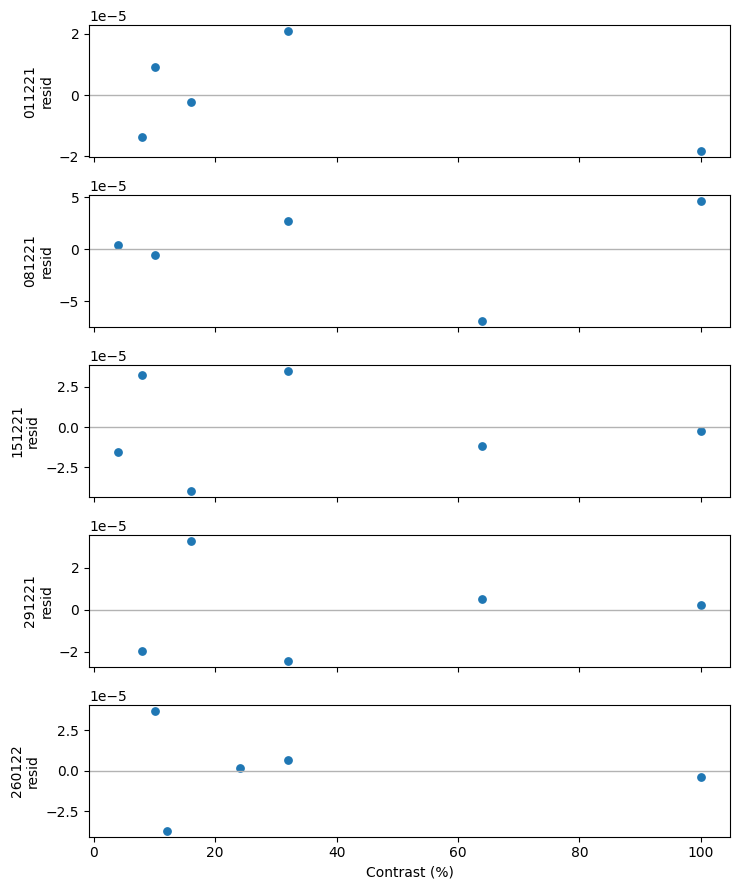

In [79]:
# === Goodness-of-fit metrics + residual diagnostics (fixed naming) ===
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

def _pred_for_day(d, contrasts):
    row = fit_df.loc[fit_df["day"] == d].iloc[0]
    c = np.asarray(contrasts, float)
    if CRF_FIT_BASELINE_MODE == "fixed1":
        return naka_rushton_fixedR0(c, row["Rmax"], row["c50"], row["n"])
    else:
        return naka_rushton(c, row["Rmax"], row["c50"], row["n"], row["R0"])

def _metrics_for_day(d):
    """Compute RSS, AIC, AICc, BIC, adjusted R² for the day using points used for fitting."""
    c_all = sorted(day_mean.get(d, {}).keys())
    c_fit = [cc for cc in c_all if (cc > 0 or not CRF_EXCLUDE_ZERO_FROM_FIT)]
    y = np.array([day_mean[d][cc] for cc in c_fit], float)
    n_obs = len(c_fit)
    if n_obs < CRF_MIN_POINTS_TO_FIT:
        return dict(AIC=np.nan, AICc=np.nan, BIC=np.nan, RSS=np.nan, adjR2=np.nan)

    yhat = _pred_for_day(d, c_fit)
    resid = y - yhat
    RSS = float(np.nansum(resid**2))

    # number of free parameters in the model
    k = 3 if CRF_FIT_BASELINE_MODE == "fixed1" else 4

    # Information criteria (Gaussian residuals, unknown variance)
    AIC  = n_obs * np.log(RSS / n_obs) + 2 * k
    BIC  = n_obs * np.log(RSS / n_obs) + k * np.log(n_obs)
    AICc = AIC + (2 * k * (k + 1)) / (n_obs - k - 1) if (n_obs - k - 1) > 0 else np.nan

    R2 = fit_df.loc[fit_df["day"] == d, "R2"].values[0]
    adjR2 = 1 - (1 - R2) * (n_obs - 1) / (n_obs - k - 1) if (n_obs - k - 1) > 0 else np.nan

    return dict(AIC=AIC, AICc=AICc, BIC=BIC, RSS=RSS, adjR2=adjR2)

# Compute + save metrics
metrics = []
for d in day_list:
    m = _metrics_for_day(d)
    m["day"] = d
    metrics.append(m)

metrics_df = pd.DataFrame(metrics)
fit_metrics_df = fit_df.merge(metrics_df, on="day", how="left")
metrics_path = crf_dir / "fits_metrics.csv"
fit_metrics_df.to_csv(metrics_path, index=False)
print(f"[CRF] Saved metrics: {metrics_path}")

# Show a tidy table (note: 'n' here is the Hill exponent; count is 'n_points')
display_cols = ["day", "n_points", "R2", "adjR2", "AIC", "AICc", "BIC", "RSS",
                "Rmax", "c50", "n", "R0", "Rabs"]
print(fit_metrics_df[display_cols].sort_values("AIC"))

# Residuals vs contrast plot
fig, axs = plt.subplots(len(day_list), 1, figsize=(7.5, 1.8 * len(day_list)), sharex=True)
if len(day_list) == 1:
    axs = [axs]

for ax, d in zip(axs, day_list):
    c_all = sorted(day_mean.get(d, {}).keys())
    c_fit = [cc for cc in c_all if (cc > 0 or not CRF_EXCLUDE_ZERO_FROM_FIT)]
    if not c_fit:
        continue
    y = np.array([day_mean[d][cc] for cc in c_fit], float)
    yhat = _pred_for_day(d, c_fit)
    resid = y - yhat
    ax.axhline(0, color="0.7", lw=1)
    ax.scatter(c_fit, resid, s=28)
    ax.set_ylabel(f"{d}\nresid")

axs[-1].set_xlabel("Contrast (%)")
fig.tight_layout()
resid_path = crf_dir / "residuals.png"
fig.savefig(resid_path, dpi=150)
print(f"[CRF] Saved residuals plot: {resid_path}")
plt.show()


[CRF] Saved metrics bars: C:\Users\amity\Desktop\Learning\university\Msc\Vision Lab\Thesis\preprocessed_VSDdata\_overlays_by_contrast_from_excel_roi\gradientColors\roiR10_auto1_boxX30-60_boxY30-60_seedC100_win200-300_moderaw_adb9cf\crf_04435759\fit_metrics_bars.png


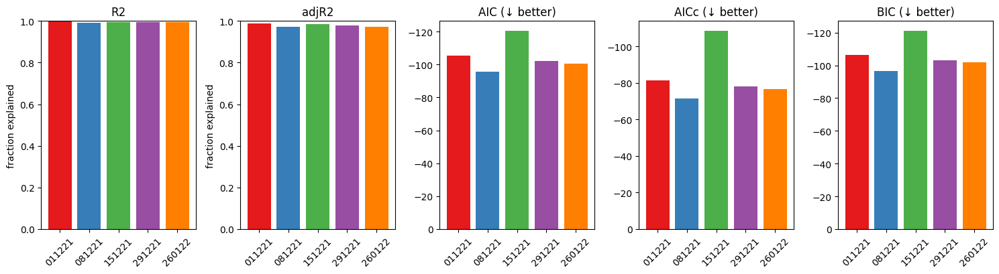

In [80]:
# === Metrics bar plots: R2, adjR2, AIC, AICc, BIC ===
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# Load metrics table if needed
if 'fit_metrics_df' in globals():
    M = fit_metrics_df.copy()
else:
    M = pd.read_csv(crf_dir / "fits_metrics.csv")

# Respect the day ordering used in the CRF plots
order = day_list if 'day_list' in globals() else list(M['day'])
M['day'] = pd.Categorical(M['day'], categories=order, ordered=True)
M = M.sort_values('day')

# Fallback colors if day_colors isn't defined
if 'day_colors' in globals():
    colors = [day_colors.get(d, None) or plt.rcParams['axes.prop_cycle'].by_key()['color'][i % 10]
              for i, d in enumerate(order)]
else:
    colors = plt.rcParams['axes.prop_cycle'].by_key()['color'][:len(order)]

metrics_left  = ['R2', 'adjR2']      # higher is better
metrics_right = ['AIC', 'AICc', 'BIC']  # lower is better

fig, axs = plt.subplots(1, len(metrics_left) + len(metrics_right),
                        figsize=(15, 4.2), sharex=False)

# Plot R2 / adjR2 (0..1)
for i, met in enumerate(metrics_left):
    ax = axs[i]
    vals = M[met].values
    ax.bar(range(len(order)), vals, color=colors)
    ax.set_title(met)
    ax.set_ylim(0, 1)
    ax.set_ylabel('fraction explained')
    ax.set_xticks(range(len(order)))
    ax.set_xticklabels(order, rotation=45)

# Plot AIC / AICc / BIC (lower is better)
for j, met in enumerate(metrics_right, start=len(metrics_left)):
    ax = axs[j]
    vals = M[met].values
    ax.bar(range(len(order)), vals, color=colors)
    ax.set_title(met + " (↓ better)")
    ax.set_xticks(range(len(order)))
    ax.set_xticklabels(order, rotation=45)
    # Optional: flip y-axis so smaller is visually higher. Comment this out if you prefer normal.
    ax.invert_yaxis()

fig.tight_layout()
out_path = crf_dir / "fit_metrics_bars.png"
fig.savefig(out_path, dpi=150)
print(f"[CRF] Saved metrics bars: {out_path}")
plt.show()


# CRF within DAY

[CRF] Using outdir: C:\Users\amity\Desktop\Learning\university\Msc\Vision Lab\Thesis\preprocessed_VSDdata\_overlays_by_contrast_from_excel_roi\sameDayColor\roiR5_auto1_boxX30-60_boxY30-60_seedC100_win100-200_moderaw_a2cfdb
[CRF] Saving outputs to: C:\Users\amity\Desktop\Learning\university\Msc\Vision Lab\Thesis\preprocessed_VSDdata\_overlays_by_contrast_from_excel_roi\sameDayColor\roiR5_auto1_boxX30-60_boxY30-60_seedC100_win100-200_moderaw_a2cfdb\crf_d7d25c33
[CRF] Contrasts found: [4, 8, 10, 12, 16, 24, 32, 64, 100]
[CRF] Manifest sessions loaded: 15
[CRF] No pct→var auto-fills were made (manifest likely complete or names non-standard).
[CRF] Saved per-session params/metrics: C:\Users\amity\Desktop\Learning\university\Msc\Vision Lab\Thesis\preprocessed_VSDdata\_overlays_by_contrast_from_excel_roi\sameDayColor\roiR5_auto1_boxX30-60_boxY30-60_seedC100_win100-200_moderaw_a2cfdb\crf_d7d25c33\day_011221\fits_sessions.csv

[CHECK] Day 011221
  011221b: finite SEMs 0/5
  011221c: finite SEMs

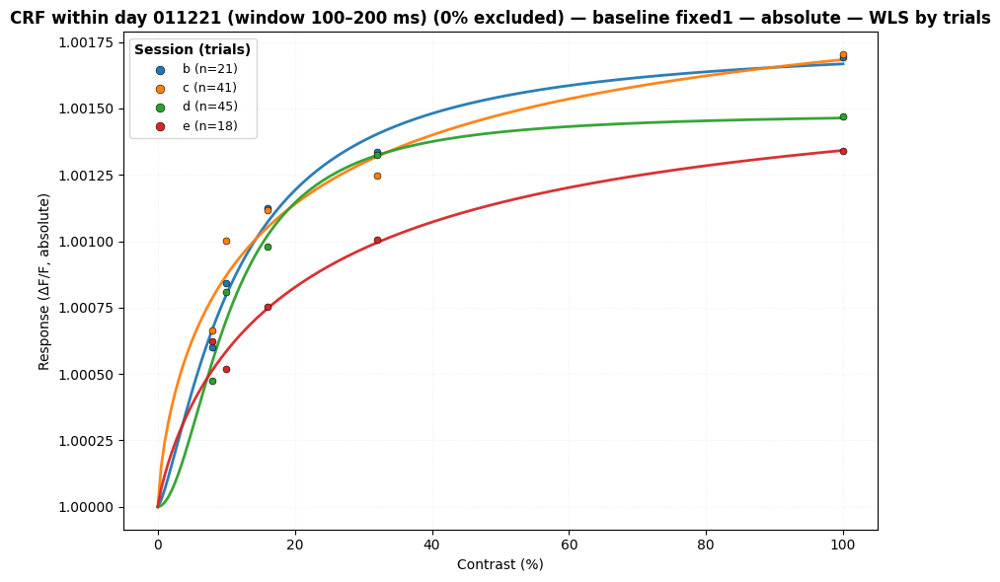

[CRF] Saved plot: C:\Users\amity\Desktop\Learning\university\Msc\Vision Lab\Thesis\preprocessed_VSDdata\_overlays_by_contrast_from_excel_roi\sameDayColor\roiR5_auto1_boxX30-60_boxY30-60_seedC100_win100-200_moderaw_a2cfdb\crf_d7d25c33\day_011221\crf_sessions_absolute.png


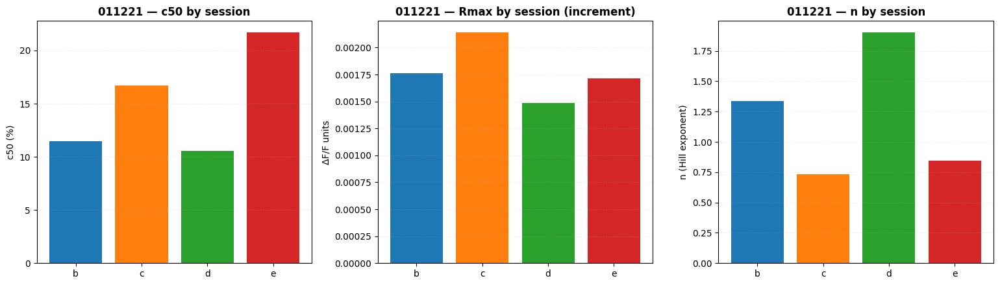

[CRF] Saved plot: C:\Users\amity\Desktop\Learning\university\Msc\Vision Lab\Thesis\preprocessed_VSDdata\_overlays_by_contrast_from_excel_roi\sameDayColor\roiR5_auto1_boxX30-60_boxY30-60_seedC100_win100-200_moderaw_a2cfdb\crf_d7d25c33\day_011221\params_sessions_plus.png


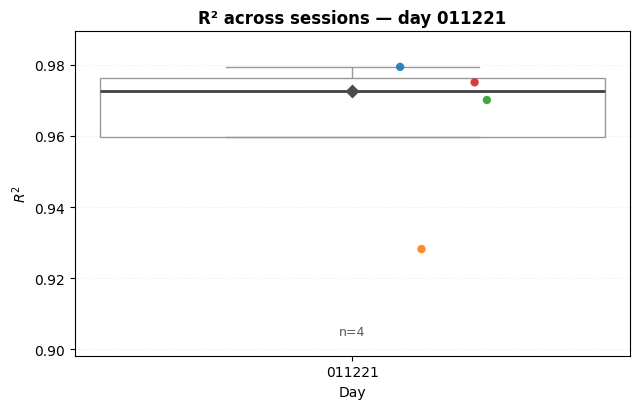

[CRF] Saved plot: C:\Users\amity\Desktop\Learning\university\Msc\Vision Lab\Thesis\preprocessed_VSDdata\_overlays_by_contrast_from_excel_roi\sameDayColor\roiR5_auto1_boxX30-60_boxY30-60_seedC100_win100-200_moderaw_a2cfdb\crf_d7d25c33\day_011221\r2_box_day.png


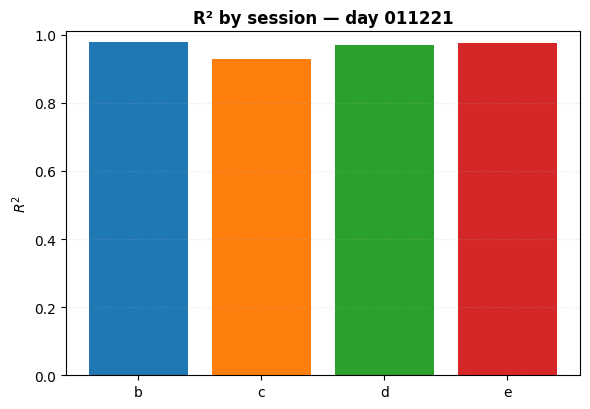

[CRF] Saved plot: C:\Users\amity\Desktop\Learning\university\Msc\Vision Lab\Thesis\preprocessed_VSDdata\_overlays_by_contrast_from_excel_roi\sameDayColor\roiR5_auto1_boxX30-60_boxY30-60_seedC100_win100-200_moderaw_a2cfdb\crf_d7d25c33\day_011221\r2_by_session.png
[CRF] Saved per-session params/metrics: C:\Users\amity\Desktop\Learning\university\Msc\Vision Lab\Thesis\preprocessed_VSDdata\_overlays_by_contrast_from_excel_roi\sameDayColor\roiR5_auto1_boxX30-60_boxY30-60_seedC100_win100-200_moderaw_a2cfdb\crf_d7d25c33\day_081221\fits_sessions.csv

[CHECK] Day 081221
  081221b: finite SEMs 0/5
  081221c: finite SEMs 0/5
  081221d: finite SEMs 0/5
  081221e: finite SEMs 0/5

[DEBUG] Trial-SEM diagnostics for day 081221
  Session 081221b
      4% → NO BAR (pct_not_in_mapping)
     10% → NO BAR (pct_not_in_mapping)
     32% → NO BAR (pct_not_in_mapping)
     64% → NO BAR (pct_not_in_mapping)
    100% → NO BAR (pct_not_in_mapping)
  Session 081221c
      4% → NO BAR (pct_not_in_mapping)
     10%

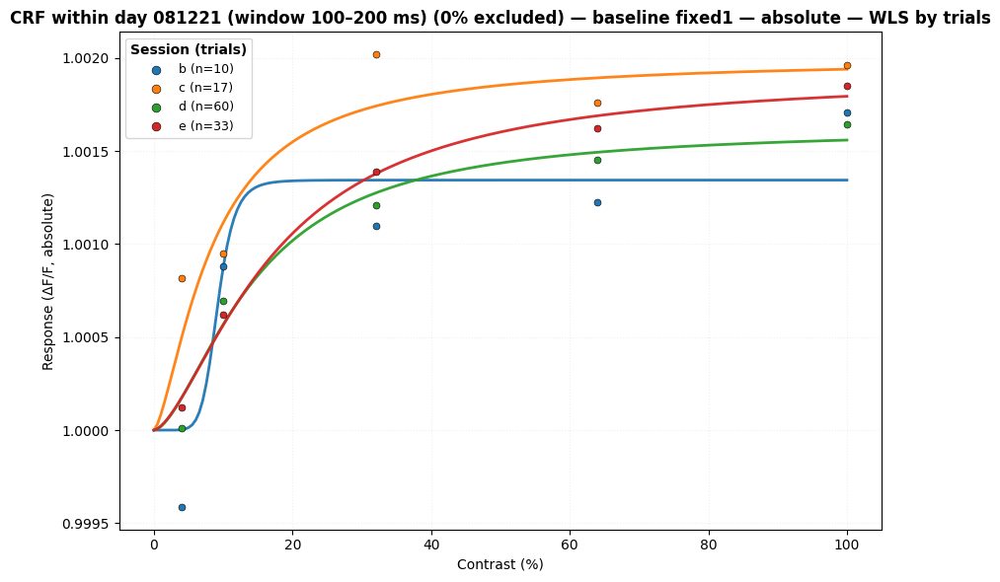

[CRF] Saved plot: C:\Users\amity\Desktop\Learning\university\Msc\Vision Lab\Thesis\preprocessed_VSDdata\_overlays_by_contrast_from_excel_roi\sameDayColor\roiR5_auto1_boxX30-60_boxY30-60_seedC100_win100-200_moderaw_a2cfdb\crf_d7d25c33\day_081221\crf_sessions_absolute.png


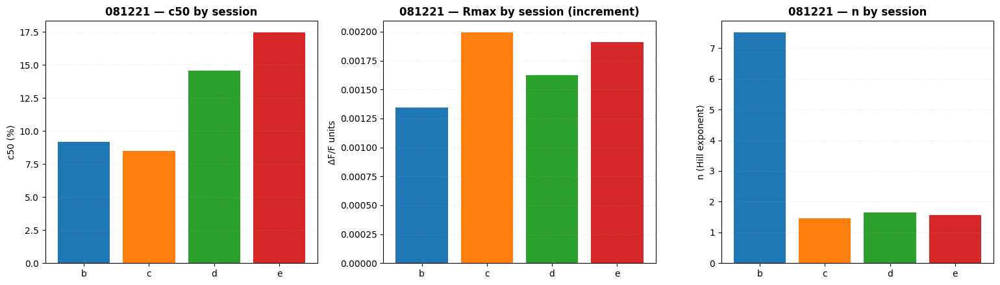

[CRF] Saved plot: C:\Users\amity\Desktop\Learning\university\Msc\Vision Lab\Thesis\preprocessed_VSDdata\_overlays_by_contrast_from_excel_roi\sameDayColor\roiR5_auto1_boxX30-60_boxY30-60_seedC100_win100-200_moderaw_a2cfdb\crf_d7d25c33\day_081221\params_sessions_plus.png


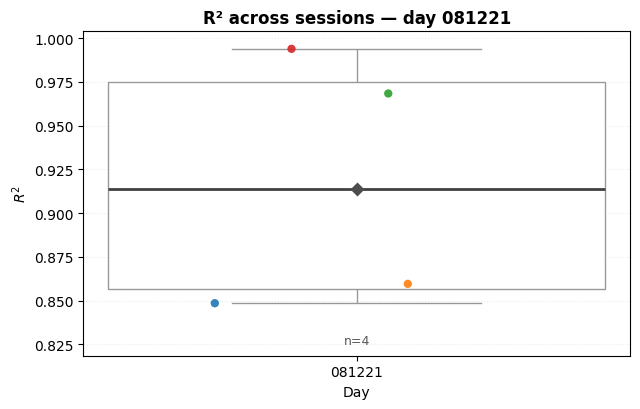

[CRF] Saved plot: C:\Users\amity\Desktop\Learning\university\Msc\Vision Lab\Thesis\preprocessed_VSDdata\_overlays_by_contrast_from_excel_roi\sameDayColor\roiR5_auto1_boxX30-60_boxY30-60_seedC100_win100-200_moderaw_a2cfdb\crf_d7d25c33\day_081221\r2_box_day.png


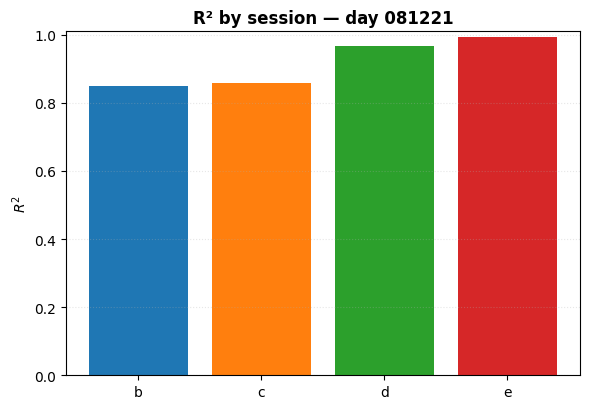

[CRF] Saved plot: C:\Users\amity\Desktop\Learning\university\Msc\Vision Lab\Thesis\preprocessed_VSDdata\_overlays_by_contrast_from_excel_roi\sameDayColor\roiR5_auto1_boxX30-60_boxY30-60_seedC100_win100-200_moderaw_a2cfdb\crf_d7d25c33\day_081221\r2_by_session.png
[CRF] Saved per-session params/metrics: C:\Users\amity\Desktop\Learning\university\Msc\Vision Lab\Thesis\preprocessed_VSDdata\_overlays_by_contrast_from_excel_roi\sameDayColor\roiR5_auto1_boxX30-60_boxY30-60_seedC100_win100-200_moderaw_a2cfdb\crf_d7d25c33\day_151221\fits_sessions.csv

[CHECK] Day 151221
  151221b: finite SEMs 0/5
  151221c: finite SEMs 0/5
  151221d: finite SEMs 0/5
  151221e: finite SEMs 0/5

[DEBUG] Trial-SEM diagnostics for day 151221
  Session 151221b
      4% → NO BAR (pct_not_in_mapping)
      8% → NO BAR (pct_not_in_mapping)
     16% → NO BAR (pct_not_in_mapping)
     32% → NO BAR (pct_not_in_mapping)
    100% → NO BAR (pct_not_in_mapping)
  Session 151221c
      8% → NO BAR (pct_not_in_mapping)
     16%

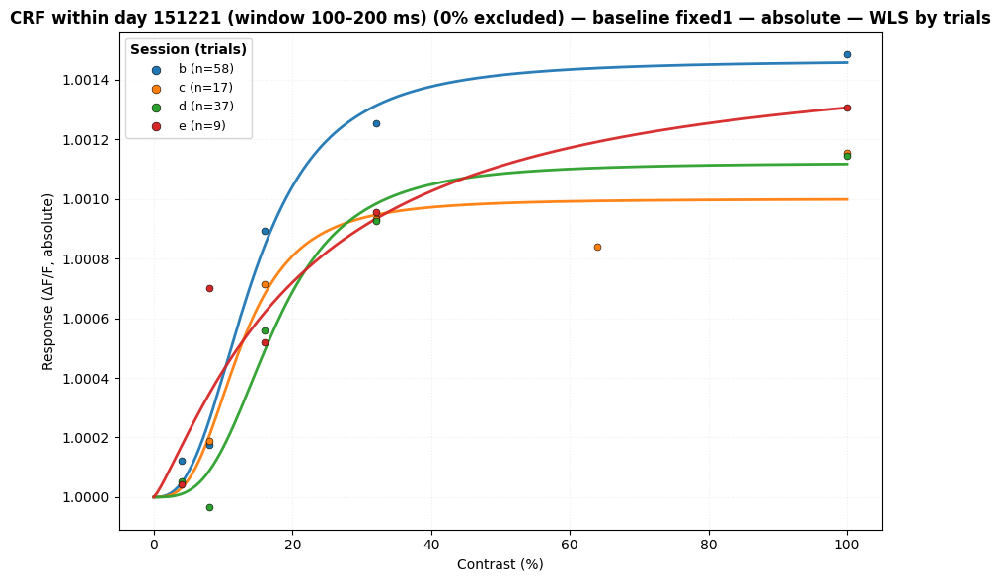

[CRF] Saved plot: C:\Users\amity\Desktop\Learning\university\Msc\Vision Lab\Thesis\preprocessed_VSDdata\_overlays_by_contrast_from_excel_roi\sameDayColor\roiR5_auto1_boxX30-60_boxY30-60_seedC100_win100-200_moderaw_a2cfdb\crf_d7d25c33\day_151221\crf_sessions_absolute.png


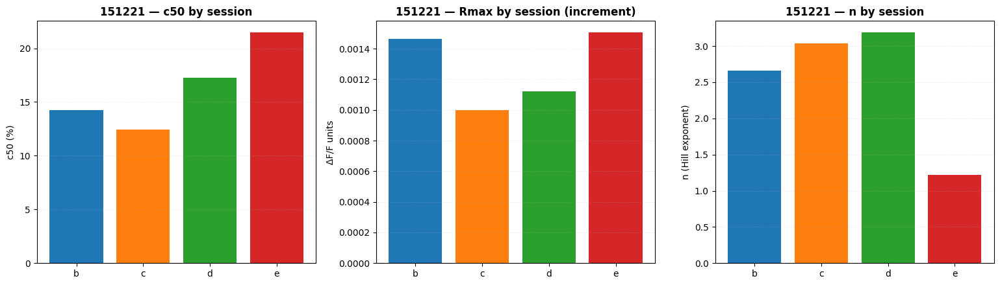

[CRF] Saved plot: C:\Users\amity\Desktop\Learning\university\Msc\Vision Lab\Thesis\preprocessed_VSDdata\_overlays_by_contrast_from_excel_roi\sameDayColor\roiR5_auto1_boxX30-60_boxY30-60_seedC100_win100-200_moderaw_a2cfdb\crf_d7d25c33\day_151221\params_sessions_plus.png


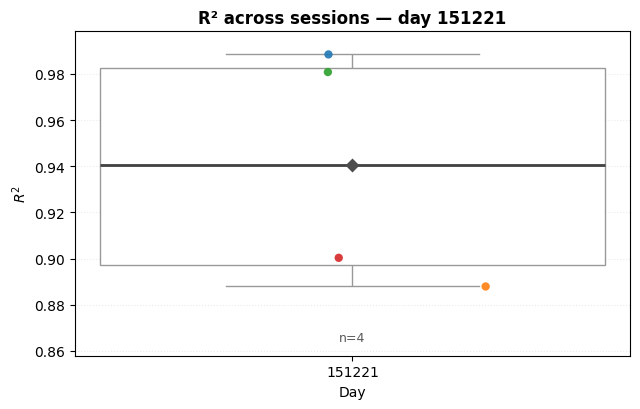

[CRF] Saved plot: C:\Users\amity\Desktop\Learning\university\Msc\Vision Lab\Thesis\preprocessed_VSDdata\_overlays_by_contrast_from_excel_roi\sameDayColor\roiR5_auto1_boxX30-60_boxY30-60_seedC100_win100-200_moderaw_a2cfdb\crf_d7d25c33\day_151221\r2_box_day.png


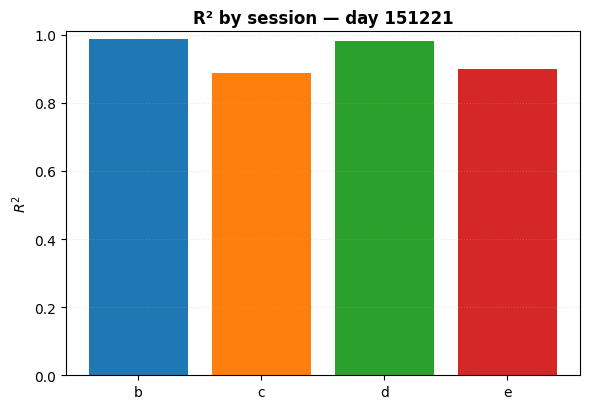

[CRF] Saved plot: C:\Users\amity\Desktop\Learning\university\Msc\Vision Lab\Thesis\preprocessed_VSDdata\_overlays_by_contrast_from_excel_roi\sameDayColor\roiR5_auto1_boxX30-60_boxY30-60_seedC100_win100-200_moderaw_a2cfdb\crf_d7d25c33\day_151221\r2_by_session.png
[CRF] Saved per-session params/metrics: C:\Users\amity\Desktop\Learning\university\Msc\Vision Lab\Thesis\preprocessed_VSDdata\_overlays_by_contrast_from_excel_roi\sameDayColor\roiR5_auto1_boxX30-60_boxY30-60_seedC100_win100-200_moderaw_a2cfdb\crf_d7d25c33\day_291221\fits_sessions.csv

[CHECK] Day 291221
  291221b: finite SEMs 0/5
  291221c: finite SEMs 0/5

[DEBUG] Trial-SEM diagnostics for day 291221
  Session 291221b
      8% → NO BAR (pct_not_in_mapping)
     16% → NO BAR (pct_not_in_mapping)
     32% → NO BAR (pct_not_in_mapping)
     64% → NO BAR (pct_not_in_mapping)
    100% → NO BAR (pct_not_in_mapping)
  Session 291221c
      8% → NO BAR (pct_not_in_mapping)
     16% → NO BAR (pct_not_in_mapping)
     32% → NO BAR (pct_

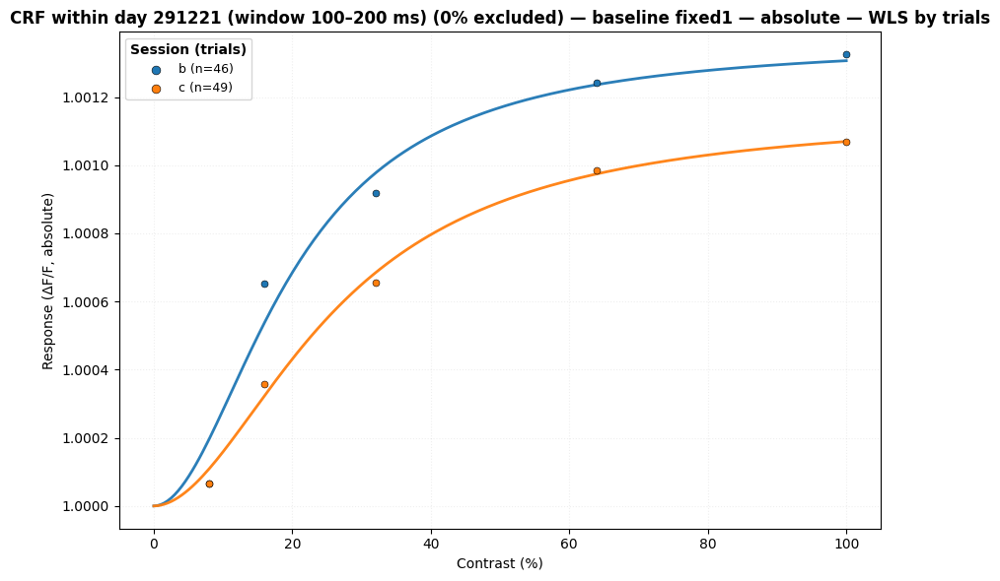

[CRF] Saved plot: C:\Users\amity\Desktop\Learning\university\Msc\Vision Lab\Thesis\preprocessed_VSDdata\_overlays_by_contrast_from_excel_roi\sameDayColor\roiR5_auto1_boxX30-60_boxY30-60_seedC100_win100-200_moderaw_a2cfdb\crf_d7d25c33\day_291221\crf_sessions_absolute.png


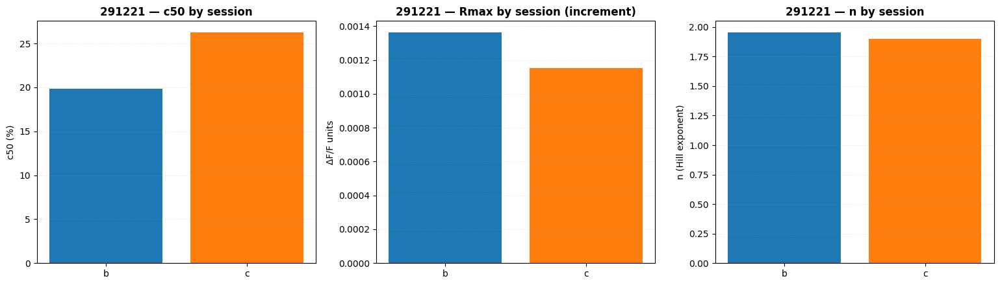

[CRF] Saved plot: C:\Users\amity\Desktop\Learning\university\Msc\Vision Lab\Thesis\preprocessed_VSDdata\_overlays_by_contrast_from_excel_roi\sameDayColor\roiR5_auto1_boxX30-60_boxY30-60_seedC100_win100-200_moderaw_a2cfdb\crf_d7d25c33\day_291221\params_sessions_plus.png


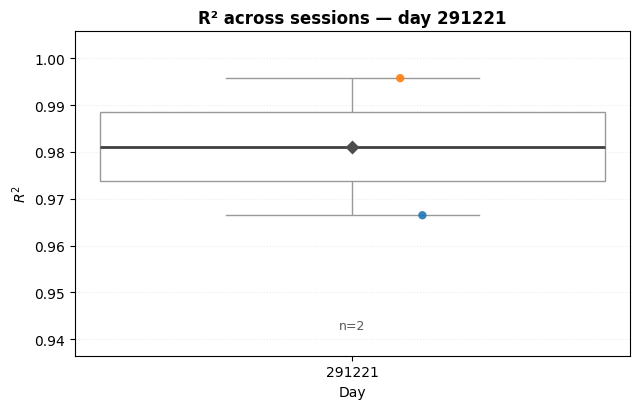

[CRF] Saved plot: C:\Users\amity\Desktop\Learning\university\Msc\Vision Lab\Thesis\preprocessed_VSDdata\_overlays_by_contrast_from_excel_roi\sameDayColor\roiR5_auto1_boxX30-60_boxY30-60_seedC100_win100-200_moderaw_a2cfdb\crf_d7d25c33\day_291221\r2_box_day.png


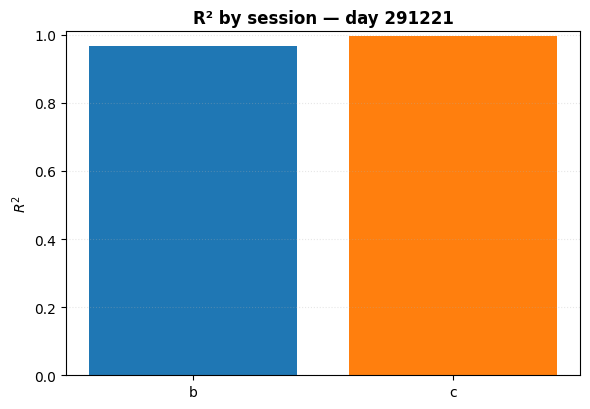

[CRF] Saved plot: C:\Users\amity\Desktop\Learning\university\Msc\Vision Lab\Thesis\preprocessed_VSDdata\_overlays_by_contrast_from_excel_roi\sameDayColor\roiR5_auto1_boxX30-60_boxY30-60_seedC100_win100-200_moderaw_a2cfdb\crf_d7d25c33\day_291221\r2_by_session.png
[CRF] Saved per-session params/metrics: C:\Users\amity\Desktop\Learning\university\Msc\Vision Lab\Thesis\preprocessed_VSDdata\_overlays_by_contrast_from_excel_roi\sameDayColor\roiR5_auto1_boxX30-60_boxY30-60_seedC100_win100-200_moderaw_a2cfdb\crf_d7d25c33\day_260122\fits_sessions.csv

[CHECK] Day 260122
  260122b: finite SEMs 0/5

[DEBUG] Trial-SEM diagnostics for day 260122
  Session 260122b
     10% → NO BAR (pct_not_in_mapping)
     12% → NO BAR (pct_not_in_mapping)
     24% → NO BAR (pct_not_in_mapping)
     32% → NO BAR (pct_not_in_mapping)
    100% → NO BAR (pct_not_in_mapping)
[WARN] No trial SEM available for 260122b; drew points without bars.


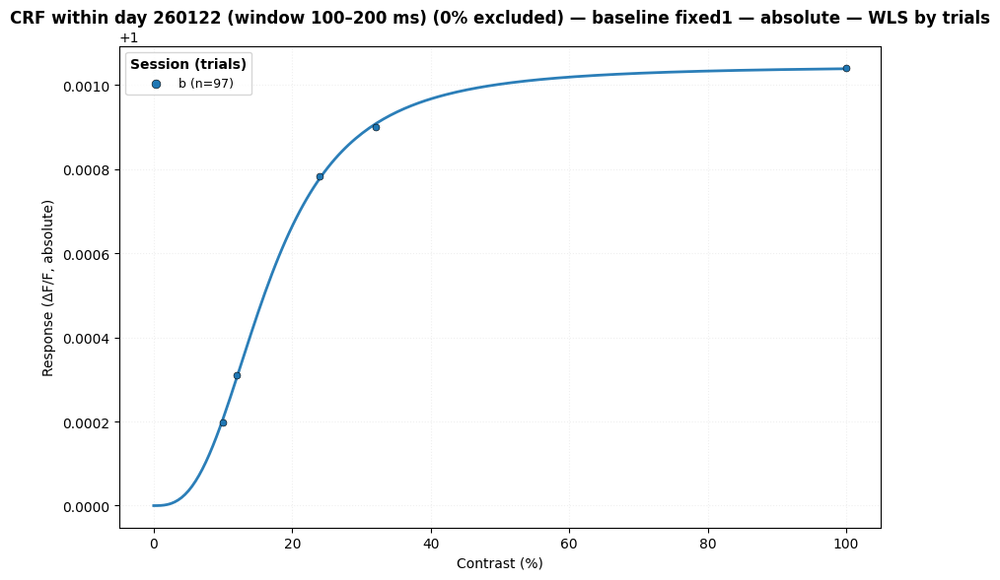

[CRF] Saved plot: C:\Users\amity\Desktop\Learning\university\Msc\Vision Lab\Thesis\preprocessed_VSDdata\_overlays_by_contrast_from_excel_roi\sameDayColor\roiR5_auto1_boxX30-60_boxY30-60_seedC100_win100-200_moderaw_a2cfdb\crf_d7d25c33\day_260122\crf_sessions_absolute.png


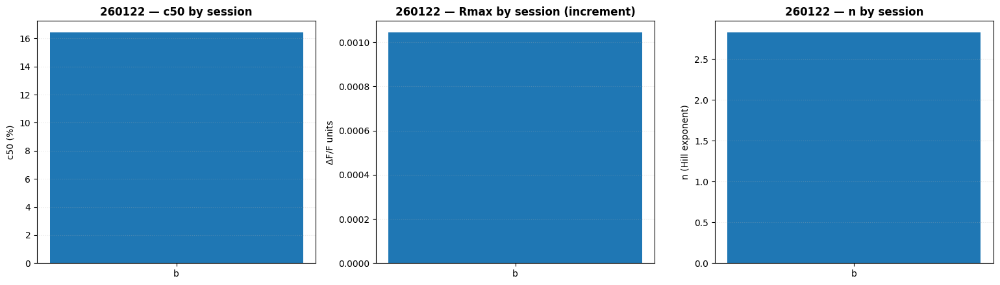

[CRF] Saved plot: C:\Users\amity\Desktop\Learning\university\Msc\Vision Lab\Thesis\preprocessed_VSDdata\_overlays_by_contrast_from_excel_roi\sameDayColor\roiR5_auto1_boxX30-60_boxY30-60_seedC100_win100-200_moderaw_a2cfdb\crf_d7d25c33\day_260122\params_sessions_plus.png


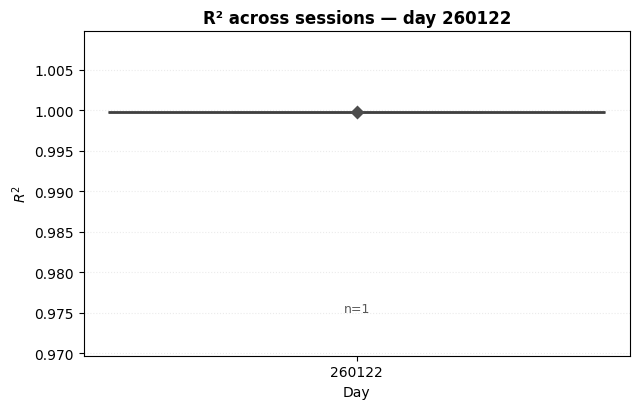

[CRF] Saved plot: C:\Users\amity\Desktop\Learning\university\Msc\Vision Lab\Thesis\preprocessed_VSDdata\_overlays_by_contrast_from_excel_roi\sameDayColor\roiR5_auto1_boxX30-60_boxY30-60_seedC100_win100-200_moderaw_a2cfdb\crf_d7d25c33\day_260122\r2_box_day.png


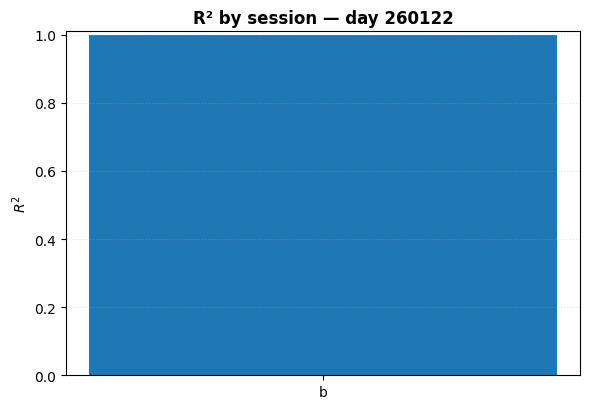

[CRF] Saved plot: C:\Users\amity\Desktop\Learning\university\Msc\Vision Lab\Thesis\preprocessed_VSDdata\_overlays_by_contrast_from_excel_roi\sameDayColor\roiR5_auto1_boxX30-60_boxY30-60_seedC100_win100-200_moderaw_a2cfdb\crf_d7d25c33\day_260122\r2_by_session.png


In [29]:
# === CRF (Naka–Rushton) WITHIN DAY (per-session) — WLS by trials, non-overwriting ===
from pathlib import Path
import os, re, json, hashlib
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit
import seaborn as sns
import scipy.io as sio
import ast  # for safe tuple parsing

# ---- Config ----
CRF_WINDOW_MS = AUTO_SEED_TIME_MS        # time window to summarize response (ms)
CRF_METHOD    = "mean"                   # "mean" | "peak"
CRF_MIN_POINTS_TO_FIT = 3                # need ≥3 non-zero contrasts to fit
CRF_EXCLUDE_ZERO_FROM_FIT = True         # don't use 0% in Naka–Rushton fitting
CRF_SHOW_ZERO_POINTS      = True         # still show 0% as hollow markers
CRF_FIT_BASELINE_MODE     = "fixed1"     # "free" | "fixed1"
CRF_SESSION_PALETTE       = "tab10"      # colors for sessions within a day
CRF_PLOT_MODE             = "absolute"   # "absolute" | "increment"
CRF_SHOW_TRIAL_ERRORBARS  = True         # draw per-session×contrast SEM across trials (if available)

# Weighting
CRF_USE_TRIAL_WEIGHTS     = True         # True → WLS with weights ∝ n_trials

# Optional: force a specific run folder (paste full path string or leave empty)
CRF_OUTDIR_OVERRIDE = r""

# ---- Model ----
def naka_rushton(c, Rmax, c50, n, R0):
    c = np.asarray(c, dtype=float); eps = 1e-12
    return R0 + Rmax * (c**n / (c**n + c50**n + eps))

def naka_rushton_fixedR0(c, Rmax, c50, n):
    c = np.asarray(c, dtype=float); eps = 1e-12
    return 1.0 + Rmax * (c**n / (c**n + c50**n + eps))

def _apply_plot_mode(y_abs, baseline):
    return (y_abs - baseline) if CRF_PLOT_MODE == "increment" else y_abs

# ---- Robust outdir discovery (only choose runs that have NPZs) ----
ROOT = Path(PREPROC_BASE) / "_overlays_by_contrast_from_excel_roi"
def _list_runs_with_npz(root=ROOT):
    rows = []
    for cfg in root.rglob("config.json"):
        run_dir = cfg.parent
        npz_count = len(list(run_dir.glob("roi_timecourses_*pct.npz")))
        rows.append((cfg.stat().st_mtime, npz_count, run_dir))
    rows.sort(reverse=True)
    print("[CRF] Runs found (newest first):")
    for _, n, d in rows: print(f"  {d}  — NPZ files: {n}")
    return rows
def _latest_outdir_with_npz(root=ROOT):
    rows = _list_runs_with_npz(root)
    for _, n, d in rows:
        if n > 0: return d
    raise RuntimeError("No runs with NPZ files found under: " + str(root))

if CRF_OUTDIR_OVERRIDE:
    _outdir = Path(CRF_OUTDIR_OVERRIDE)
elif "outdir" in globals() and any(Path(outdir).glob("roi_timecourses_*pct.npz")):
    _outdir = Path(outdir)
else:
    _outdir = _latest_outdir_with_npz()

print(f"[CRF] Using outdir: {_outdir}")

# ---- Hash a compact subfolder so runs don't overwrite each other ----
_cfg_for_hash = dict(method=CRF_METHOD,
                     win=tuple(CRF_WINDOW_MS),
                     base=CRF_FIT_BASELINE_MODE,
                     ex0=CRF_EXCLUDE_ZERO_FROM_FIT,
                     scope="within_day",
                     plot=CRF_PLOT_MODE,
                     wts=int(CRF_USE_TRIAL_WEIGHTS),
                     err=int(CRF_SHOW_TRIAL_ERRORBARS))
CRF_HASH = hashlib.md5(json.dumps(_cfg_for_hash, sort_keys=True).encode("utf-8")).hexdigest()[:8]
crf_dir = _outdir / f"crf_{CRF_HASH}"
crf_dir.mkdir(parents=True, exist_ok=True)
print(f"[CRF] Saving outputs to: {crf_dir}")
with open(crf_dir / "meta.json", "w", encoding="utf-8") as f:
    json.dump(dict(outdir=str(_outdir), **_cfg_for_hash), f, indent=2)

# ---- Load timecourses & extract amplitudes per session/contrast ----
npz_files = sorted(_outdir.glob("roi_timecourses_*pct.npz"))
if not npz_files:
    raise RuntimeError(f"No roi_timecourses_XXpct.npz found in: {_outdir}")

lab2pctamp, lab2pctn, pcts_found = {}, {}, []
for f in npz_files:
    m = re.search(r"roi_timecourses_(\d+)pct\.npz$", f.name)
    if not m: continue
    pct = int(m.group(1)); pcts_found.append(pct)
    Z = np.load(f, allow_pickle=True)
    t_ms, labels, Y = Z["t_ms"], Z["labels"], Z["Y"]
    ntr = Z["n_trials"] if "n_trials" in Z.files else np.ones(len(labels), dtype=int)
    iwin = (t_ms >= CRF_WINDOW_MS[0]) & (t_ms <= CRF_WINDOW_MS[1])
    if not np.any(iwin):
        raise RuntimeError(f"No timepoints within CRF window {CRF_WINDOW_MS} in {f.name}")
    for li, lab in enumerate(labels.astype(str)):
        y = Y[li]
        amp = float(np.nanmean(y[iwin]) if CRF_METHOD == "mean" else np.nanmax(y[iwin]))
        lab2pctamp.setdefault(lab, {})[pct] = amp
        lab2pctn.setdefault(lab,   {})[pct] = int(ntr[li])

pcts_found = sorted(set(pcts_found))
print(f"[CRF] Contrasts found: {pcts_found}")

# ---- Helpers for labels/days ----
try:
    datecode_to_dt
except NameError:
    from datetime import datetime
    def datecode_to_dt(dc): return datetime.strptime(dc, "%d%m%y")

LETTER_ORDER = globals().get("LETTER_ORDER", {"a":0,"b":1,"c":2,"d":3,"e":4,"f":5})

def _split_day_letter(lab: str):
    s = lab.strip().lower()
    m = re.match(r"(\d{6})([a-z])$", s)
    if m: return m.group(1), m.group(2)
    return s[:-1], s[-1]

def _session_order_key(label: str):
    day, let = _split_day_letter(label)
    return (datecode_to_dt(day), LETTER_ORDER.get(let, 99), let)

# ---- Weighted fit helper ----
def _fit_session(c, r, baseline_mode="fixed1", w=None):
    c = np.asarray(c, float); r = np.asarray(r, float)
    R0_guess   = np.nanmin(r)
    Rmax_guess = max(np.nanmax(r) - R0_guess, 1e-6)
    c50_guess  = np.nanpercentile(c, 50) if np.sum(~np.isnan(c)) else 30.0
    n_guess    = 2.0

    kwargs = dict(maxfev=20000)
    sigma = None
    if w is not None:
        sigma = 1.0 / np.sqrt(np.maximum(np.asarray(w, float), 1.0))
        kwargs.update(sigma=sigma, absolute_sigma=True)

    if baseline_mode == "fixed1":
        p0     = [Rmax_guess, max(c50_guess, 1.0), n_guess]
        bounds = ([0.0, 0.1, 0.25], [np.inf, 100.0, 8.0])
        popt, _ = curve_fit(naka_rushton_fixedR0, c, r, p0=p0, bounds=bounds, **kwargs)
        Rmax, c50, n = popt; R0 = 1.0
        rhat = naka_rushton_fixedR0(c, *popt)
    else:
        p0     = [Rmax_guess, max(c50_guess, 1.0), n_guess, R0_guess]
        bounds = ([0.0, 0.1, 0.25, np.min(r)-abs(np.min(r))*2],
                  [np.inf, 100.0, 8.0,  np.max(r)+abs(np.max(r))*2])
        popt, _ = curve_fit(naka_rushton, c, r, p0=p0, bounds=bounds, **kwargs)
        Rmax, c50, n, R0 = popt
        rhat = naka_rushton(c, *popt)

    if sigma is not None:
        RSS = float(np.nansum(((r - rhat)/sigma)**2))
        TSS = float(np.nansum(((r - np.nanmean(r))/sigma)**2))
    else:
        RSS = float(np.nansum((r - rhat)**2))
        TSS = float(np.nansum((r - np.nanmean(r))**2))
    R2 = 1.0 - RSS/TSS if TSS > 0 else np.nan

    return dict(Rmax=Rmax, c50=c50, n=n, R0=R0, R2=R2)

# ---- Trial-level SEM support (reads config + manifest + MATs) ----
cfg_path = Path(_outdir) / "config.json"
man_path = Path(_outdir) / "manifest_sessions_sorted.csv"
_label2meta, _roi_ready = {}, False
_TRIAL_SEM_CACHE = {}  # (label, pct, window, method, dff_mode, baseline_frames) -> sem

def _circle_roi_mask(seed_xy, radius_px, image_shape):
    h, w = image_shape
    yy, xx = np.mgrid[0:h, 0:w]
    mask2d = (xx - seed_xy[0])**2 + (yy - seed_xy[1])**2 <= radius_px**2
    return mask2d.reshape(h*w, order="F")

def _ms_to_frame_offset(ms, hz): return int(round((ms/1000.0)*hz))

def _as_tuple(val, default=()):
    if val is None: return default
    if isinstance(val, (list, tuple, np.ndarray)): return tuple(val)
    try: return tuple(ast.literal_eval(str(val)))
    except Exception: return default

def _norm_day_code(x):
    s = re.sub(r"\D", "", str(x).strip())
    if len(s) < 6: s = s.zfill(6)
    elif len(s) > 6: s = s[-6:]
    return s

# Defaults if config fields missing
_FRAME_RATE_HZ      = float(globals().get("FRAME_RATE_HZ", 30.0) or 30.0)
_FRAME_ONSET_IDX_1  = int(globals().get("FRAME_ONSET_IDX_1", 1) or 1)
_DFF_MODE           = (globals().get("DFF_MODE", "raw") or "raw")  # "raw" | "minus1" | "baseline"
_BASELINE_FRAMES    = _as_tuple(globals().get("BASELINE_FRAMES", (24,27)), (24,27))
_IMAGE_SHAPE        = _as_tuple(globals().get("IMAGE_SHAPE", ()), ())
_SEED_XY            = _as_tuple(globals().get("SEED_XY", ()), ())
_RADIUS_PX          = int(globals().get("RADIUS_PX", 3) or 3)

# --- Helper: guess a var name for a given pct by scanning .mat keys ---
_PAT_CACHE = {}
def _find_var_for_pct(varnames, pct: int):
    """Return best-guess variable name in varnames for this percentage or None."""
    key = (tuple(sorted(varnames)), int(pct))
    if key in _PAT_CACHE: return _PAT_CACHE[key]
    sPct  = str(int(pct))
    sPct0 = sPct.zfill(2)  # "08" for 8
    pats = [
        rf"(?:^|[_\-]){sPct}(?:[_\-]|$)",
        rf"(?:^|[_\-]){sPct0}(?:[_\-]|$)",
        rf"(?:^|[_\-]){sPct}pct(?:[_\-]|$)",
        rf"(?:^|[_\-]){sPct0}pct(?:[_\-]|$)",
        rf"(?:^|[_\-])c0*{sPct}(?:[_\-]|$)",
        rf"(?:^|[_\-])cond0*{sPct}(?:[_\-]|$)",
        rf"(?:^|[_\-])contrast0*{sPct}(?:[_\-]|$)",
        rf"(?:^|[_\-])p0*{sPct}(?:[_\-]|$)",
    ]
    cands = []
    for v in varnames:
        name = str(v).lower()
        if any(re.search(p, name) for p in pats):
            cands.append(v)
    if not cands:
        _PAT_CACHE[key] = None; return None
    # tie-break: prefer names mentioning contrast/pct/cond; then shortest
    def score(v):
        s = v.lower()
        bonus = 0
        if "contrast" in s: bonus -= 3
        if "cond" in s:     bonus -= 2
        if "pct" in s or "percent" in s or s.endswith("p"): bonus -= 1
        return (bonus, len(s))
    cands.sort(key=score)
    _PAT_CACHE[key] = cands[0]
    return cands[0]

if CRF_SHOW_TRIAL_ERRORBARS and cfg_path.exists() and man_path.exists():
    cfg = json.loads(Path(cfg_path).read_text(encoding="utf-8"))
    _FRAME_RATE_HZ     = cfg.get("frame_rate_hz", _FRAME_RATE_HZ)
    _FRAME_ONSET_IDX_1 = cfg.get("frame_onset_idx_1", _FRAME_ONSET_IDX_1)
    _DFF_MODE          = cfg.get("dff_mode", _DFF_MODE)
    _BASELINE_FRAMES   = tuple(cfg.get("baseline_frames", list(_BASELINE_FRAMES)))
    _IMAGE_SHAPE       = tuple(cfg.get("image_shape", list(_IMAGE_SHAPE)))
    _SEED_XY           = tuple(cfg.get("chosen_seed_xy", list(_SEED_XY)))
    _RADIUS_PX         = int(cfg.get("radius_px", _RADIUS_PX))

    man = pd.read_csv(man_path)
    man.columns = [str(c).strip().lower() for c in man.columns]

    def col(row, names):
        for n in names:
            if n in row.index and pd.notna(row[n]): return row[n]
        return None

    # Step 1: load whatever the manifest already knows
    for _, row in man.iterrows():
        day_raw = col(row, ["date_code","datecode","day_code","day","date"])
        let_raw = col(row, ["session_letter","letter","sess","session"])
        mpath   = col(row, ["mat_path","matpath","mat_file","matfile","mat","path"])
        if day_raw is None or let_raw is None or mpath is None: continue

        day   = _norm_day_code(day_raw)
        let   = str(let_raw).strip().lower()[:1]
        label = f"{day}{let}"

        mapping = {}
        for key in ("pct_to_cond_json","pct_to_cond","contrast_to_var","pct_to_var"):
            if key in row.index and pd.notna(row[key]):
                try:
                    text = str(row[key]).replace("OrderedDict","dict")
                    mapping = ast.literal_eval(text)
                except Exception:
                    mapping = {}
                break
        try:
            mapping = {int(k): v for k, v in dict(mapping).items()}
        except Exception:
            mapping = {}

        _label2meta[label] = dict(mat_path=str(mpath), pct_to_cond=mapping)

    # ROI mask ready?
    if len(_IMAGE_SHAPE) == 2 and len(_SEED_XY) == 2 and all(np.isfinite(_SEED_XY)):
        _ROI_MASK = _circle_roi_mask(_SEED_XY, _RADIUS_PX, _IMAGE_SHAPE)
        _roi_ready = True

    # Step 2 (NEW): auto-fill missing pct→var mappings by scanning .mat names
    pcts_needed = sorted({p for p in set(pcts_found) if p > 0})  # only nonzero contrasts need SEM bars
    auto_filled = []
    for label, meta in _label2meta.items():
        mfile = Path(meta["mat_path"])
        if not mfile.exists(): continue
        need = [p for p in pcts_needed if p not in meta["pct_to_cond"]]
        if not need: continue
        try:
            mat_hdr = sio.whosmat(str(mfile))  # fast listing (no data load)
            varnames = [v[0] for v in mat_hdr]
        except Exception:
            # fall back to loadmat just to get keys if whosmat fails
            try:
                mk = sio.loadmat(str(mfile), squeeze_me=True, struct_as_record=False).keys()
                varnames = [k for k in mk if not k.startswith("__")]
            except Exception:
                continue
        for pct in need:
            v = _find_var_for_pct(varnames, pct)
            if v:
                meta["pct_to_cond"][pct] = v
                auto_filled.append((label, pct, v))

    print(f"[CRF] Manifest sessions loaded: {len(_label2meta)}")
    if auto_filled:
        show = ", ".join([f"{lab}:{pct}->{var}" for lab,pct,var in auto_filled[:8]])
        extra = " ..." if len(auto_filled) > 8 else ""
        print(f"[CRF] Auto-filled pct→var from .mat for {len(auto_filled)} entries: {show}{extra}")
    else:
        print("[CRF] No pct→var auto-fills were made (manifest likely complete or names non-standard).")

if CRF_SHOW_TRIAL_ERRORBARS and (not _roi_ready or not _label2meta):
    print("[CRF] Trial-level error bars requested, but ROI/config/manifest incomplete. Bars will be omitted where info is missing.")


def _trial_sem_for_point(label, pct):
    """Return SEM across trials for this session×contrast; NaN if unavailable."""
    cache_key = (label, pct, tuple(CRF_WINDOW_MS), CRF_METHOD, _DFF_MODE, _BASELINE_FRAMES)
    if cache_key in _TRIAL_SEM_CACHE:
        return _TRIAL_SEM_CACHE[cache_key]

    meta = _label2meta.get(label)
    if not (meta and _roi_ready and pct in meta.get("pct_to_cond", {})):
        _TRIAL_SEM_CACHE[cache_key] = np.nan; return np.nan

    mp = Path(meta["mat_path"])
    if not mp.exists():
        print(f"[SEM] Missing .mat: {mp}")
        _TRIAL_SEM_CACHE[cache_key] = np.nan; return np.nan

    try:
        mat = sio.loadmat(str(mp), squeeze_me=True, struct_as_record=False)
    except Exception as e:
        print(f"[SEM] loadmat failed for {mp.name}: {e}")
        _TRIAL_SEM_CACHE[cache_key] = np.nan; return np.nan

    varname = meta["pct_to_cond"][pct]
    A = mat.get(varname, None)
    if A is None:
        print(f"[SEM] {mp.name}: variable '{varname}' not found")
        _TRIAL_SEM_CACHE[cache_key] = np.nan; return np.nan
    A = np.asarray(A)

    # Normalize to (pixels, frames, trials)
    H, W = (_IMAGE_SHAPE if len(_IMAGE_SHAPE) == 2 else (None, None))
    if A.ndim == 4 and H and W and A.shape[0] == H and A.shape[1] == W:
        # (H, W, F, T) -> (P, F, T) using Fortran order (MATLAB-like)
        A = A.reshape(H*W, A.shape[2], A.shape[3], order="F")
    elif A.ndim == 3:
        PFT = A.shape
        P_expected = H*W if H and W else None
        if P_expected is not None and PFT[0] != P_expected:
            if PFT[1] == P_expected:       # (F, P, T)
                A = np.transpose(A, (1, 0, 2))
            elif PFT[2] == P_expected:     # (F, T, P)
                A = np.transpose(A, (2, 0, 1))
    else:
        print(f"[SEM] Unexpected array ndim={A.ndim} for {mp.name}:{varname}")
        _TRIAL_SEM_CACHE[cache_key] = np.nan; return np.nan

    if A.ndim != 3:
        print(f"[SEM] Could not coerce to (P,F,T): got {A.shape}")
        _TRIAL_SEM_CACHE[cache_key] = np.nan; return np.nan

    P, F, T = A.shape
    roi_idx = _ROI_MASK.astype(bool)
    if roi_idx.size != P:
        print(f"[SEM] ROI size {roi_idx.size} != pixels {P} for {mp.name}")
        _TRIAL_SEM_CACHE[cache_key] = np.nan; return np.nan

    onset0 = _FRAME_ONSET_IDX_1 - 1
    s = max(0, min(F-1, onset0 + _ms_to_frame_offset(CRF_WINDOW_MS[0], _FRAME_RATE_HZ)))
    e = max(s+1, min(F,   onset0 + _ms_to_frame_offset(CRF_WINDOW_MS[1], _FRAME_RATE_HZ)))

    if _DFF_MODE == "baseline":
        bs, be = _BASELINE_FRAMES
        bs = max(0, min(F-1, bs)); be = max(bs+1, min(F, be))
        base = A[:, bs:be, :].mean(axis=1, keepdims=True)
        A = A - base
    elif _DFF_MODE == "minus1":
        A = A - 1.0

    tc  = A[roi_idx, :, :].mean(axis=0)   # (F, T)
    seg = tc[s:e, :]
    amps = np.nanmean(seg, axis=0) if CRF_METHOD == "mean" else np.nanmax(seg, axis=0)
    T_eff = int(np.sum(np.isfinite(amps)))
    if T_eff <= 1:
        print(f"[SEM] Too few finite trials: T_eff={T_eff} for {label}@{pct}%")
        _TRIAL_SEM_CACHE[cache_key] = np.nan; return np.nan

    sem = float(np.nanstd(amps, ddof=1) / np.sqrt(T_eff))
    _TRIAL_SEM_CACHE[cache_key] = sem
    return sem

# ---- Per-day, per-session fits/plots ----
day_list = sorted({ _split_day_letter(lab)[0] for lab in lab2pctamp.keys() },
                  key=lambda d: datecode_to_dt(d))

for d in day_list:
    day_dir = crf_dir / f"day_{d}"
    day_dir.mkdir(parents=True, exist_ok=True)

    sess_labels = sorted([lab for lab in lab2pctamp if _split_day_letter(lab)[0] == d],
                         key=_session_order_key)
    cmap = sns.color_palette(CRF_SESSION_PALETTE, max(1,len(sess_labels)))
    sess_colors = {sess_labels[i]: cmap[i] for i in range(len(sess_labels))}

    # fit each session
    rows = []
    for lab in sess_labels:
        pctamp = lab2pctamp[lab]
        c_all  = sorted(pctamp.keys())
        c_fit  = [c for c in c_all if (c > 0 or not CRF_EXCLUDE_ZERO_FROM_FIT)]
        r_fit  = [pctamp[c] for c in c_fit]
        w_fit  = [lab2pctn.get(lab, {}).get(c, 1) for c in c_fit] if CRF_USE_TRIAL_WEIGHTS else None

        if len(c_fit) >= CRF_MIN_POINTS_TO_FIT:
            pars = _fit_session(c_fit, r_fit, baseline_mode=CRF_FIT_BASELINE_MODE, w=w_fit)
        else:
            pars = dict(Rmax=np.nan, c50=np.nan, n=np.nan,
                        R0=(1.0 if CRF_FIT_BASELINE_MODE=="fixed1" else np.nan), R2=np.nan)

        rows.append(dict(
            day=d, session=lab, letter=_split_day_letter(lab)[1],
            n_points=len(c_fit),
            Rmax=pars["Rmax"], c50=pars["c50"], n_exp=pars["n"], R0=pars["R0"], R2=pars["R2"],
            Rabs=(pars["R0"]+pars["Rmax"]) if (np.isfinite(pars.get("R0",np.nan)) and np.isfinite(pars.get("Rmax",np.nan))) else np.nan
        ))

    sess_df = pd.DataFrame(rows).sort_values("session", key=lambda s: s.map(_session_order_key))
    sess_df.to_csv(day_dir / "fits_sessions.csv", index=False)
    print(f"[CRF] Saved per-session params/metrics: {day_dir / 'fits_sessions.csv'}")

    # ---------- quick diagnostics + verbose reasons ----------
    def _trial_sem_for_point_verbose(label, pct):
        meta = _label2meta.get(label)
        if not meta: return (np.nan, "no_manifest_meta")
        if not _roi_ready: return (np.nan, "roi_not_ready")
        if pct not in meta.get("pct_to_cond", {}): return (np.nan, "pct_not_in_mapping")

        mp = Path(meta["mat_path"])
        if not mp.exists(): return (np.nan, "mat_missing")

        try:
            mat = sio.loadmat(str(mp), squeeze_me=True, struct_as_record=False)
        except Exception as e:
            return (np.nan, f"loadmat_error:{type(e).__name__}")

        varname = meta["pct_to_cond"][pct]
        A = mat.get(varname, None)
        if A is None: return (np.nan, "var_not_found")
        A = np.asarray(A)

        H, W = (_IMAGE_SHAPE if len(_IMAGE_SHAPE) == 2 else (None, None))
        coerced = False
        if A.ndim == 4 and H and W and A.shape[0] == H and A.shape[1] == W:
            A = A.reshape(H*W, A.shape[2], A.shape[3], order="F"); coerced = True
        elif A.ndim == 3 and H and W:
            P_expected = H*W
            if A.shape[1] == P_expected: A = np.transpose(A, (1,0,2)); coerced = True
            elif A.shape[2] == P_expected: A = np.transpose(A, (2,0,1)); coerced = True
        if A.ndim != 3: return (np.nan, f"bad_shape:{getattr(A,'shape',None)}")

        P, F, T = A.shape
        if T <= 1: return (np.nan, f"no_trials_T={T}")
        roi_idx = _ROI_MASK.astype(bool)
        if roi_idx.size != P: return (np.nan, f"roi_mismatch_P={P}_roi={roi_idx.size}")

        onset0 = _FRAME_ONSET_IDX_1 - 1
        s = onset0 + int(round((CRF_WINDOW_MS[0]/1000.0)*_FRAME_RATE_HZ))
        e = onset0 + int(round((CRF_WINDOW_MS[1]/1000.0)*_FRAME_RATE_HZ))
        s = max(0, min(F-1, s)); e = max(s+1, min(F, e))
        if e - s < 1: return (np.nan, f"short_window_frames={e-s}")

        if _DFF_MODE == "baseline":
            bs, be = _BASELINE_FRAMES
            bs = max(0, min(F-1, bs)); be = max(bs+1, min(F, be))
            if be - bs < 1: return (np.nan, f"bad_baseline_frames={be-bs}")
            base = A[:, bs:be, :].mean(axis=1, keepdims=True)
            A = A - base
        elif _DFF_MODE == "minus1":
            A = A - 1.0

        tc = A[roi_idx, :, :].mean(axis=0)
        seg = tc[s:e, :]
        amps = np.nanmean(seg, axis=0) if CRF_METHOD == "mean" else np.nanmax(seg, axis=0)
        T_eff = int(np.isfinite(amps).sum())
        if T_eff <= 1: return (np.nan, f"too_few_finite_trials_Teff={T_eff}")

        sem = float(np.nanstd(amps, ddof=1) / np.sqrt(T_eff))
        return (sem, f"ok_PFT={P,F,T}_coerced={coerced}_frames={s}-{e}")

    def debug_trial_sem_for_day(day_code, max_sessions=99):
        print(f"\n[DEBUG] Trial-SEM diagnostics for day {day_code}")
        sl = [lab for lab in lab2pctamp if lab.startswith(day_code)]
        for lab in sorted(sl)[:max_sessions]:
            cs_nz = sorted(c for c in lab2pctamp[lab] if c > 0)
            print(f"  Session {lab}")
            for pct in cs_nz:
                sem, reason = _trial_sem_for_point_verbose(lab, pct)
                status = f"SEM={sem:.5g}" if np.isfinite(sem) else f"NO BAR ({reason})"
                print(f"    {pct:>3d}% → {status}")

    if CRF_SHOW_TRIAL_ERRORBARS:
        print(f"\n[CHECK] Day {d}")
        for _lab in sess_labels:
            _cs = [c for c in sorted(lab2pctamp[_lab]) if c > 0]
            _y  = np.array([_trial_sem_for_point(_lab, c) for c in _cs], float)
            print(f"  {_lab}: finite SEMs {np.isfinite(_y).sum()}/{len(_cs)}")
        debug_trial_sem_for_day(d)

    # --- Plot CRF curves per session (within the day) ---
    fig, ax = plt.subplots(figsize=(8.8, 6.0))
    pcts_nonzero = sorted([p for p in pcts_found if p > 0]) or pcts_found
    xmax = max(pcts_nonzero) if pcts_nonzero else 100
    xs = np.linspace(0, xmax, 200)

    for lab in sess_labels:
        pctamp = lab2pctamp[lab]
        c_all  = sorted(pctamp.keys())
        cs_nz  = [c for c in c_all if c > 0]
        col    = sess_colors[lab]

        row = sess_df[sess_df["session"]==lab].iloc[0]
        base = 1.0 if CRF_FIT_BASELINE_MODE=="fixed1" else row["R0"]

        rs_nz_abs  = [pctamp[c] for c in cs_nz]
        rs_nz_plot = [_apply_plot_mode(y, base) for y in rs_nz_abs]

        # --- gated error bars: draw points-only if all SEMs are NaN ---
        if CRF_SHOW_TRIAL_ERRORBARS:
            yerrs = np.array([_trial_sem_for_point(lab, c) for c in cs_nz], float)
            has_sem = np.isfinite(yerrs).any()
            ax.errorbar(
                cs_nz, rs_nz_plot,
                yerr=(yerrs if has_sem else None),
                fmt='o', ms=5, capsize=3,
                color=col, ecolor=col, elinewidth=1.0,
                mec='k', mew=0.4, mfc=col, zorder=3
            )
            if not has_sem:
                print(f"[WARN] No trial SEM available for {lab}; drew points without bars.")
        else:
            ax.scatter(cs_nz, rs_nz_plot, s=40, color=col, alpha=0.9,
                       zorder=3, edgecolor='k', linewidth=0.4, label="_nolegend_")

        if CRF_SHOW_ZERO_POINTS and 0 in c_all:
            y0_plot = _apply_plot_mode(pctamp[0], base)
            ax.scatter([0],[y0_plot], s=40, facecolors='none', edgecolors=col,
                       linewidths=0.9, zorder=2, label="_nolegend_")

        if row["n_points"] >= CRF_MIN_POINTS_TO_FIT and np.isfinite(row["c50"]):
            y_curve_abs = (naka_rushton_fixedR0(xs, row["Rmax"], row["c50"], row["n_exp"])
                           if CRF_FIT_BASELINE_MODE=="fixed1"
                           else naka_rushton(xs, row["Rmax"], row["c50"], row["n_exp"], row["R0"]))
            y_curve_plot = _apply_plot_mode(y_curve_abs, base)
            ax.plot(xs, y_curve_plot, color=col, lw=2.0, alpha=0.95, label="_nolegend_")

    # --- explicit-trials legend (fixed marker size for all entries) ---
    handles, labels = [], []
    for lab in sess_labels:
        used_cs = [c for c in lab2pctamp[lab].keys() if (c > 0 or not CRF_EXCLUDE_ZERO_FROM_FIT)]
        total_trials = int(sum(lab2pctn.get(lab, {}).get(c, 0) for c in used_cs))
        h = ax.scatter([], [], s=40, color=sess_colors[lab], edgecolor='k', linewidth=0.4)
        letter = _split_day_letter(lab)[1]
        labels.append(f"{letter} (n={total_trials})")
        handles.append(h)

    wtag = "WLS by trials" if CRF_USE_TRIAL_WEIGHTS else "unweighted OLS"
    subtitle = (" (0% excluded)" if CRF_EXCLUDE_ZERO_FROM_FIT else "") + f" — baseline {CRF_FIT_BASELINE_MODE} — {CRF_PLOT_MODE} — {wtag}"
    ax.set_title(f"CRF within day {d} (window {CRF_WINDOW_MS[0]}–{CRF_WINDOW_MS[1]} ms){subtitle}", fontweight="bold")
    ax.set_xlabel("Contrast (%)")
    ax.set_ylabel("Response increment (ΔF/F above baseline)" if CRF_PLOT_MODE=="increment" else "Response (ΔF/F, absolute)")
    ax.grid(True, alpha=0.2, linestyle=":")
    leg = ax.legend(handles, labels, title="Session (trials)", frameon=True, fontsize=9, borderaxespad=0.5)
    leg.get_title().set_fontweight("bold")

    fig.tight_layout()
    out_png = day_dir / f"crf_sessions_{CRF_PLOT_MODE}.png"
    fig.savefig(out_png, dpi=150)
    plt.show()
    print(f"[CRF] Saved plot: {out_png}")

    # --- Params bars: c50, Rmax, and n per session ---
    fig3, axs3 = plt.subplots(1, 3, figsize=(15.5, 4.5))
    x = np.arange(len(sess_df))
    cols = [sess_colors[s] for s in sess_df["session"]]
    axs3[0].bar(x, sess_df["c50"].values, color=cols)
    axs3[0].set_xticks(x); axs3[0].set_xticklabels(sess_df["letter"].tolist())
    axs3[0].set_title(f"{d} — c50 by session", fontweight="bold"); axs3[0].set_ylabel("c50 (%)")
    axs3[1].bar(x, sess_df["Rmax"].values, color=cols)
    axs3[1].set_xticks(x); axs3[1].set_xticklabels(sess_df["letter"].tolist())
    axs3[1].set_title(f"{d} — Rmax by session (increment)", fontweight="bold"); axs3[1].set_ylabel("ΔF/F units")
    axs3[2].bar(x, sess_df["n_exp"].values, color=cols)
    axs3[2].set_xticks(x); axs3[2].set_xticklabels(sess_df["letter"].tolist())
    axs3[2].set_title(f"{d} — n by session", fontweight="bold"); axs3[2].set_ylabel("n (Hill exponent)")
    for ax_ in axs3: ax_.grid(True, axis="y", linestyle=":", alpha=0.3)
    fig3.tight_layout()
    params_plus_png = day_dir / "params_sessions_plus.png"
    fig3.savefig(params_plus_png, dpi=150)
    plt.show()
    print(f"[CRF] Saved plot: {params_plus_png}")

    # === NEW: R² visualizations for this day ===
    r2_day = sess_df.loc[
        (sess_df["n_points"] >= CRF_MIN_POINTS_TO_FIT) & np.isfinite(sess_df["R2"]),
        ["session","letter","R2"]
    ].copy()

    if not r2_day.empty:
        # ---- 1) Per-day box plot (one box; jittered colored points = sessions) ----
        r2_day["day"] = d
        letter_palette = {
            _split_day_letter(s)[1]: sess_colors[s] for s in sess_labels
            if _split_day_letter(s)[0] == d
        }

        fig4, ax4 = plt.subplots(figsize=(6.5, 4.2))
        sns.boxplot(
            data=r2_day, x="day", y="R2",
            color="white", width=0.55, showfliers=False, ax=ax4,
            boxprops=dict(edgecolor="0.6"),
            whiskerprops=dict(color="0.6"),
            capprops=dict(color="0.6"),
            medianprops=dict(color="0.25", lw=2),
        )
        sns.stripplot(
            data=r2_day, x="day", y="R2", hue="letter",
            palette=letter_palette, dodge=False, jitter=0.18, size=6, alpha=0.9,
            ax=ax4, legend=False
        )
        r2_vals = r2_day["R2"].to_numpy(float)
        lo = np.nanmin(r2_vals); hi = np.nanmax(r2_vals)
        y0 = max(0.80, lo - 0.03); y1 = min(1.01, hi + 0.01)
        med = float(np.nanmedian(r2_vals))
        ax4.plot(0, med, marker="D", ms=7, mec="none", mfc="0.3", zorder=5)
        ax4.text(0, y0 + 0.005, f"n={len(r2_vals)}", ha="center", va="bottom", fontsize=9, color="0.35")
        ax4.set_ylim(y0, y1)
        ax4.set_xlabel("Day")
        ax4.set_ylabel(r"$R^2$")
        ax4.set_title(f"R² across sessions — day {d}", fontweight="bold")
        ax4.grid(True, axis="y", alpha=0.25, linestyle=":")
        fig4.tight_layout()
        outpng4 = day_dir / "r2_box_day.png"
        fig4.savefig(outpng4, dpi=150); plt.show()
        print(f"[CRF] Saved plot: {outpng4}")

        # ---- 2) Per-session R² (bar chart, one bar per session letter) ----
        order_letters = [ _split_day_letter(s)[1] for s in sess_labels if _split_day_letter(s)[0] == d ]
        r2_map = r2_day.set_index("letter")["R2"]
        letters_in = [L for L in order_letters if L in r2_map.index]
        vals = [ float(r2_map[L]) for L in letters_in ]
        cols_bars = [
            sess_colors[[s for s in sess_labels if _split_day_letter(s)[1]==L and _split_day_letter(s)[0]==d][0]]
            for L in letters_in
        ]

        fig5, ax5 = plt.subplots(figsize=(max(6.0, 1.2*len(letters_in)), 4.2))
        ax5.bar(range(len(letters_in)), vals, color=cols_bars)
        ax5.set_xticks(range(len(letters_in)))
        ax5.set_xticklabels(letters_in)
        ax5.set_ylabel(r"$R^2$")
        ax5.set_title(f"R² by session — day {d}", fontweight="bold")
        ax5.set_ylim(0.0, 1.01)
        ax5.grid(True, axis="y", linestyle=":", alpha=0.3)
        fig5.tight_layout()
        outpng5 = day_dir / "r2_by_session.png"
        fig5.savefig(outpng5, dpi=150); plt.show()
        print(f"[CRF] Saved plot: {outpng5}")
    else:
        print(f"[CRF] Day {d}: no sessions with finite R² and enough points.")

    # --- Save per-session summary (includes R²) ---
    sess_df[["session","letter","R2","c50","Rmax","n_exp","R0","Rabs","n_points"]].to_csv(day_dir / "session_r2.csv", index=False)


# Similarity

[SIM] Using outdir: C:\Users\amity\Desktop\Learning\university\Msc\Vision Lab\VSDI\preprocessed_VSDdata\_overlays_by_contrast_from_excel_roi\gradientColors\roiR10_auto1_boxX30-60_boxY30-60_seedC100_win100-200_moderaw_a876b6
[SIM] Loaded 75 (session,contrast) vectors; ROI pixels = 317
[SIM] Excluding contrasts (too few days/sessions): [12, 24]


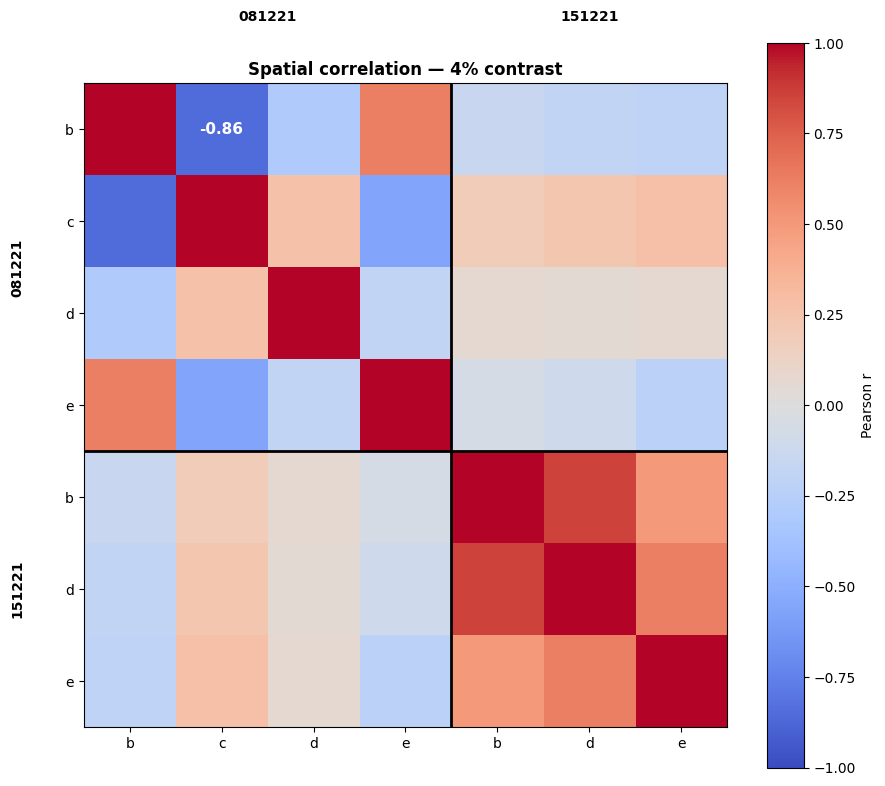

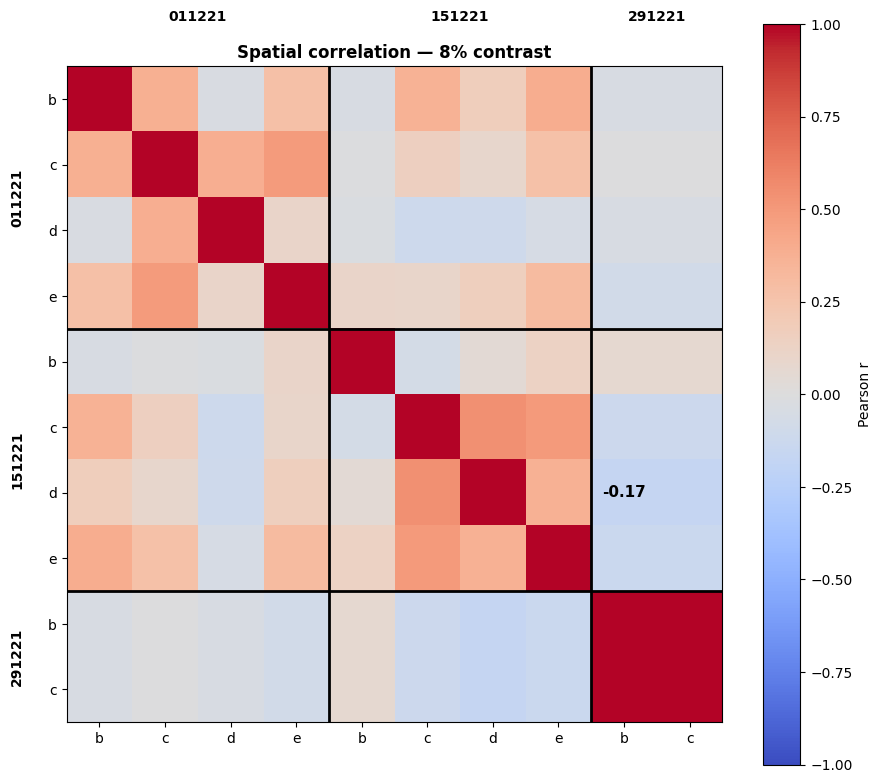

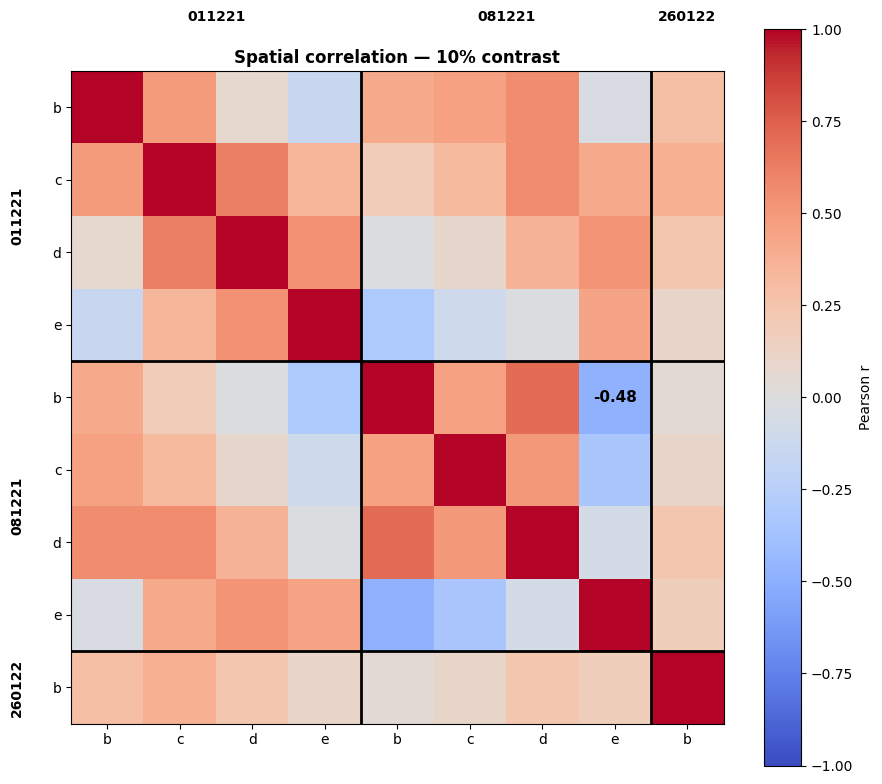

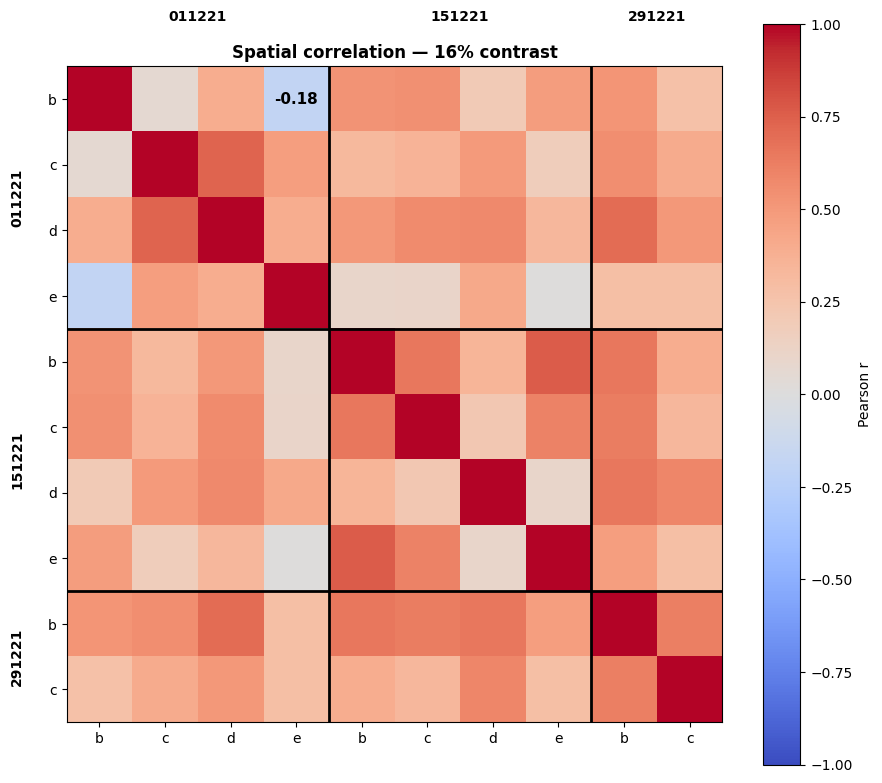

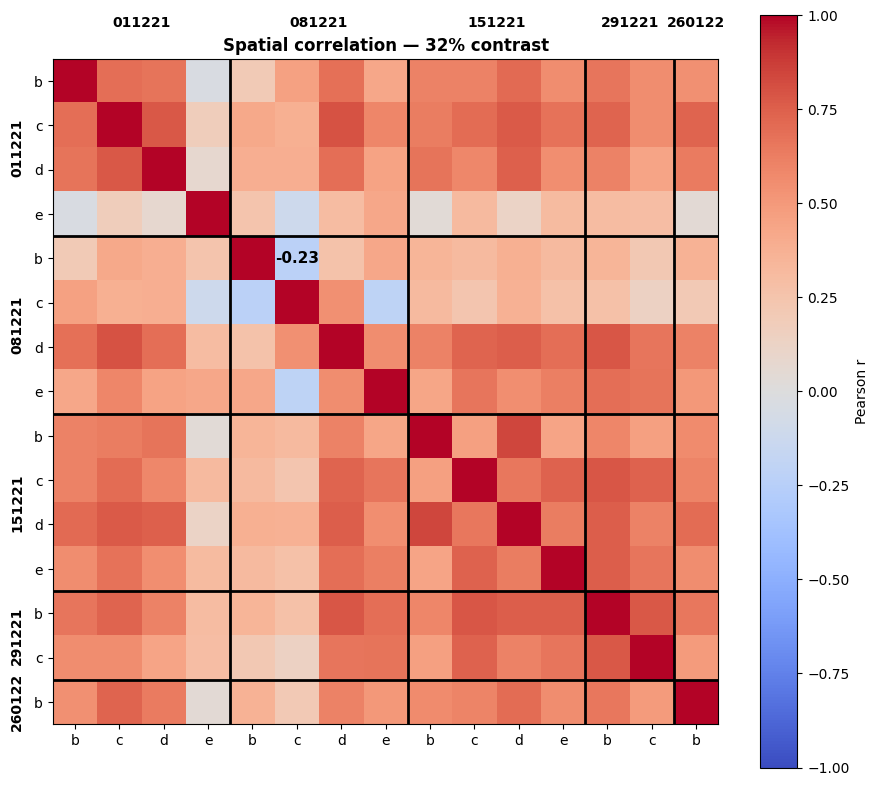

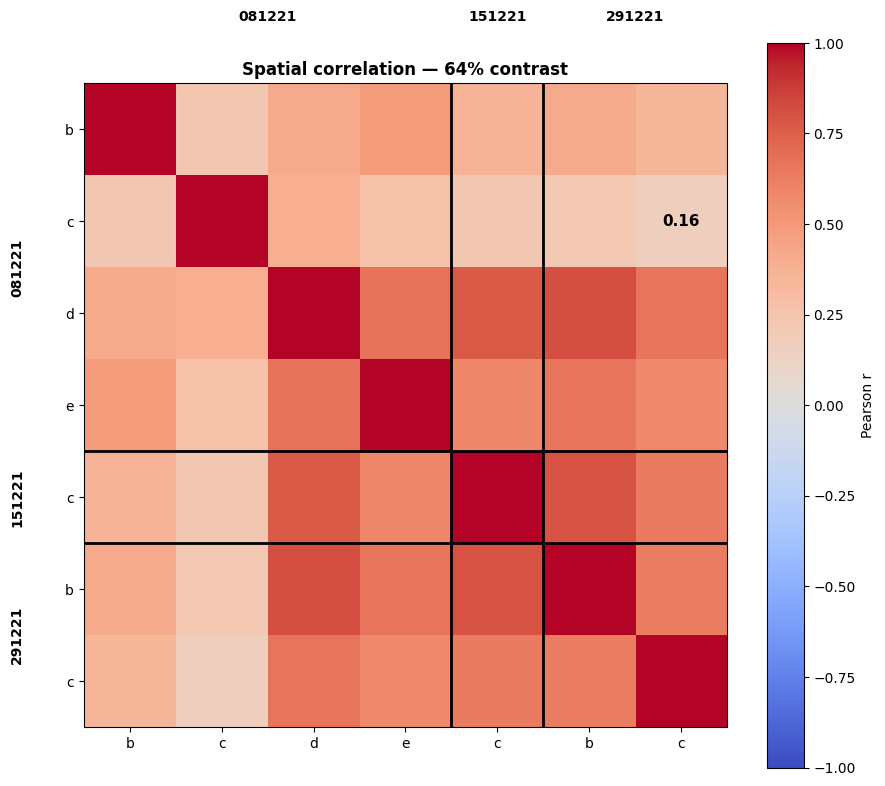

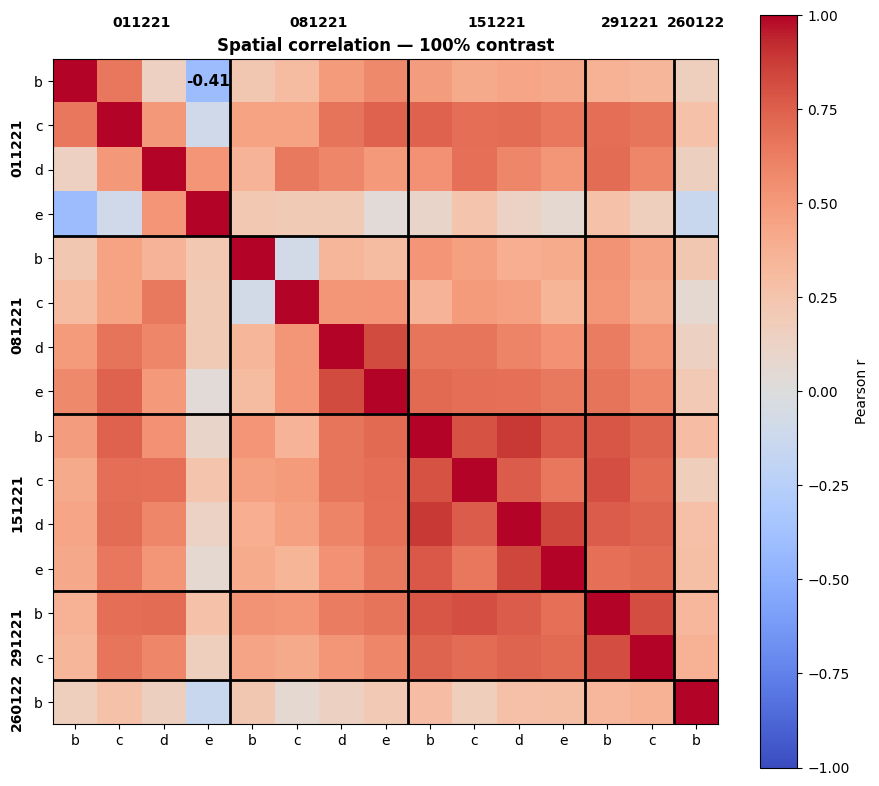

[SIM] Saved pairwise table: C:\Users\amity\Desktop\Learning\university\Msc\Vision Lab\VSDI\preprocessed_VSDdata\_overlays_by_contrast_from_excel_roi\gradientColors\roiR10_auto1_boxX30-60_boxY30-60_seedC100_win100-200_moderaw_a876b6\pattern_similarity\pairs_all.csv (rows=2628)
   metric  signal_mean  signal_median  noise_mean  noise_median  n_signal  \
0       r     0.377515       0.411107    0.379383      0.453230       378   
1     1-r     0.622485       0.588893    0.620617      0.546770       378   
2  euclid    19.262203      19.291959   18.975891     18.589198       378   

   n_noise  
0      526  
1      526  
2      526  


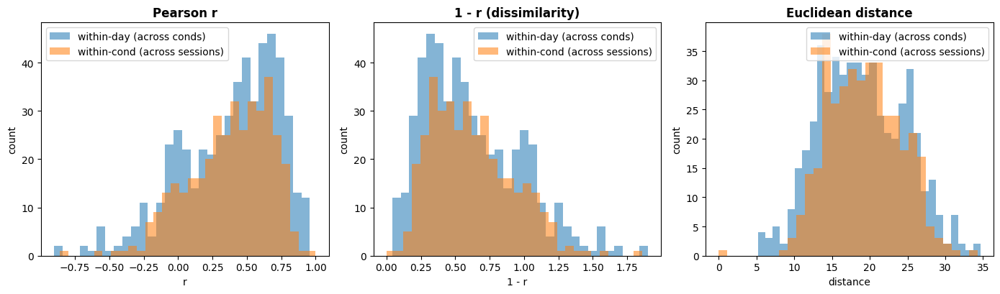

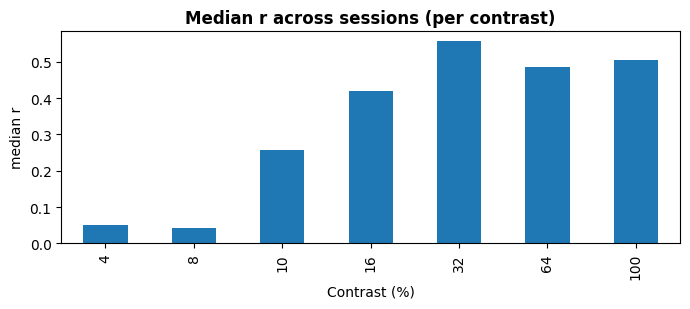

[BAL] noise days=5, signal WD units=20, signal AD units=33
                              group  n_units    r_mean  r_median  1-r_mean  \
0                  noise_within_day        5  0.519340  0.495172  0.480660   
1   signal_within_day_same_contrast       20  0.481332  0.422693  0.518668   
2  signal_across_days_same_contrast       33  0.401616  0.453497  0.598384   

   1-r_median  euclid_mean  euclid_median  
0    0.504828    17.302309      17.862007  
1    0.577307    17.139019      18.845517  
2    0.546503    19.121856      18.565828  


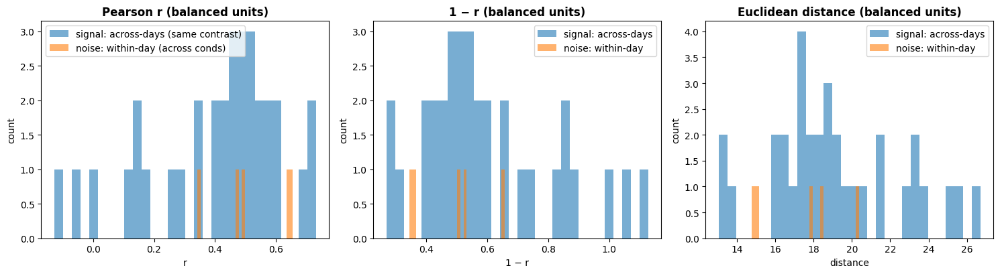

[BOOT] mean r(signal_across_days) − mean r(noise_within_day) = -0.1188  (95% CI -0.2432 .. 0.0043)


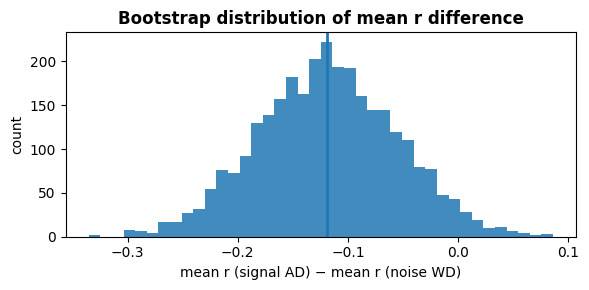

[SIM] 100% contrast: within-day pairs : 19
[SIM] 100% contrast: across-days pairs: 86

=== 100% Contrast: Variance of r (within-day vs across-days) ===
         group  mean_r   var_r   std_r  n_pairs
0   within_day  0.4881  0.1369  0.3700       19
1  across_days  0.4581  0.0464  0.2153       86
Observed difference (mean within - across): 0.029981328864860823
Permutation p-value: 0.6346


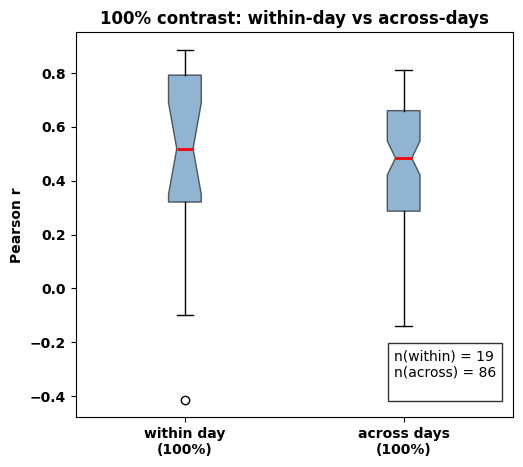

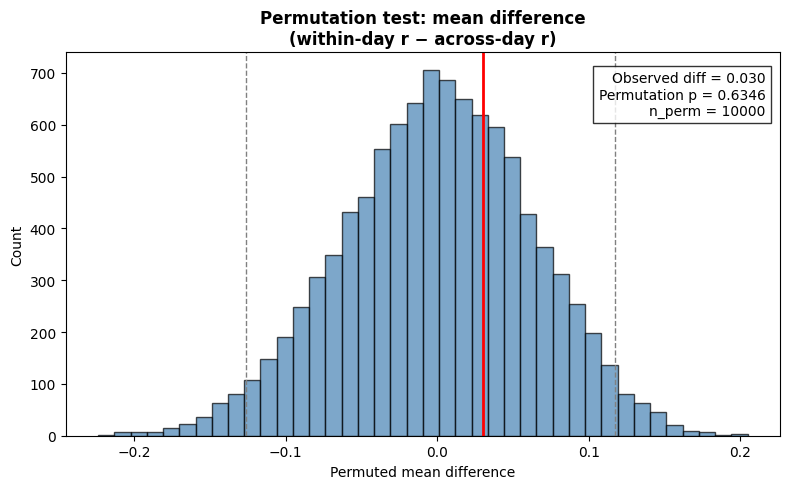

[SIM] Done (variance + permutation test for 100% contrast only).


In [37]:
# === Spatial pattern similarity (reuses roi_patterns_XXpct.npz) ================
# - For each contrast: session×session correlation heatmap, grouped by day
# - Across sessions/contrasts: pairwise table (r and Euclidean) + summary plots

from pathlib import Path
import re, json, numpy as np, pandas as pd, matplotlib.pyplot as plt
from collections import defaultdict

# ---------------- Config --------------------------------------------------------
SIM_EXCLUDE_ZERO = True                 # skip 0% “blank” condition
SIM_ZSCORE_BEFORE_EUCLIDEAN = True      # z-score each vector before Euclidean
SIM_OUTDIR_OVERRIDE = r"C:\Users\amity\Desktop\Learning\university\Msc\Vision Lab\VSDI\preprocessed_VSDdata\_overlays_by_contrast_from_excel_roi\gradientColors\roiR10_auto1_boxX30-60_boxY30-60_seedC100_win100-200_moderaw_a876b6"
HEATMAP_FIGSIZE = (9, 8)
HEATMAP_ANNOTATE_BLOCK_MEANS = False    # show mean r inside each day block
# Exclude contrasts that are under-represented:
SIM_MIN_DAYS_PER_CONTRAST = 2
SIM_MIN_TOTAL_SESS_PER_CONTRAST = 2

# ---------------- Resolve run folder with roi_patterns_* ------------------------
def _latest_outdir_with_patterns(root: Path):
    candidates = []
    for cfg in root.rglob("config.json"):
        d = cfg.parent
        if any(d.glob("roi_patterns_*pct.npz")):
            candidates.append((cfg.stat().st_mtime, d))
    if not candidates:
        raise RuntimeError("No runs with roi_patterns_*pct.npz found.")
    return max(candidates, key=lambda t: t[0])[1]

if SIM_OUTDIR_OVERRIDE:
    _outdir = Path(SIM_OUTDIR_OVERRIDE)
elif "_outdir" in globals():
    _outdir = Path(globals()["_outdir"])
else:
    ROOT = Path(PREPROC_BASE) / "_overlays_by_contrast_from_excel_roi"
    _outdir = _latest_outdir_with_patterns(ROOT)

print(f"[SIM] Using outdir: {_outdir}")

sim_dir = _outdir / "pattern_similarity"
sim_dir.mkdir(parents=True, exist_ok=True)

# Robust CSV saver: always create parent dir before writing
def _save_csv(df: pd.DataFrame, path, index: bool = False):
    p = Path(path)
    p.parent.mkdir(parents=True, exist_ok=True)
    df.to_csv(p, index=index)

with open(sim_dir / "meta.json", "w", encoding="utf-8") as f:
    json.dump({
        "outdir": str(_outdir),
        "exclude_zero": SIM_EXCLUDE_ZERO,
        "zscore_euclidean": SIM_ZSCORE_BEFORE_EUCLIDEAN,
        "min_days_per_contrast": SIM_MIN_DAYS_PER_CONTRAST,
        "min_total_sessions_per_contrast": SIM_MIN_TOTAL_SESS_PER_CONTRAST,
    }, f, indent=2)

# ---------------- Helpers -------------------------------------------------------
def _split_day_letter(lab: str):
    s = str(lab).strip().lower()
    m = re.match(r"(\d{6})([a-z])$", s)
    return (m.group(1), m.group(2)) if m else (s[:-1], s[-1])

try:
    datecode_to_dt  # defined earlier in your notebook
except NameError:
    from datetime import datetime
    def datecode_to_dt(dc): return datetime.strptime(dc, "%d%m%y")

def _pearson_corr(A):
    A = np.asarray(A, float)
    # subtract column means (per feature/pixel)
    A = A - A.mean(axis=1, keepdims=True)
    
    # correlation = normalized covariance
    denom = A.std(axis=1, ddof=1)
    denom[denom == 0] = 1.0
    Z = A / denom[:, None]
    
    # now the dot product gives Pearson correlation
    n = A.shape[1]
    return (Z @ Z.T) / (n - 1)

def _euclidean_dist(A, zscore=SIM_ZSCORE_BEFORE_EUCLIDEAN):
    A = np.asarray(A, float)
    if zscore:
        mu = A.mean(axis=1, keepdims=True)
        sd = A.std(axis=1, keepdims=True, ddof=1)
        sd[sd == 0] = 1.0
        A = (A - mu) / sd
    G = A @ A.T
    nrm = np.sum(A*A, axis=1, keepdims=True)
    D2 = nrm + nrm.T - 2*G
    D2[D2 < 0] = 0.0
    return np.sqrt(D2)

def _prep_df_for_contrast(patterns_df, contrast):
    sub = patterns_df.loc[patterns_df["contrast"] == contrast,
                          ["contrast", "label", "day", "letter", "vec"]].copy()
    if sub.empty:
        raise ValueError(f"No rows for contrast {contrast}.")
    # order: by day (chronological) then by session letter
    day_order = {d:i for i, d in enumerate(sorted(sub["day"].unique(), key=datecode_to_dt))}
    let_order = {l:i for i, l in enumerate(sorted(sub["letter"].unique()))}
    sub.sort_values(["day", "letter"],
                    key=lambda s: s.map(day_order) if s.name == "day" else s.map(let_order),
                    inplace=True)
    sub.reset_index(drop=True, inplace=True)
    return sub

# ---------- NEW: helpers to aggregate sessions within a day ----------
def _mean_vectors_by_day(sub_df: pd.DataFrame) -> pd.DataFrame:
    """
    Input: sub_df from _prep_df_for_contrast(...) with columns:
           ['contrast','label','day','letter','vec'] for a *single* contrast.
    Output: DataFrame with one row per day, 'vec' averaged across that day's sessions.
    """
    # sort days chronologically
    days_sorted = sorted(sub_df["day"].unique(), key=datecode_to_dt)
    rows = []
    for d in days_sorted:
        X = np.vstack(sub_df.loc[sub_df["day"] == d, "vec"].to_list())  # SxP
        vec_mean = X.mean(axis=0)                                       # P
        # fabricate a clean label for the day-averaged row
        day_label = f"{d}_avg"
        rows.append((int(sub_df["contrast"].iloc[0]), day_label, d, "avg", vec_mean))
    return pd.DataFrame(rows, columns=["contrast","label","day","letter","vec"])


# ---------- heatmap plotter with by='session' or 'day' ----------
def plot_corr_heatmap_by_day(patterns_df, contrast, figsize=HEATMAP_FIGSIZE,
                             annotate_means=False, by="session"):
    """
    by = 'session' or 'day'
    - draws thick borders between days
    - writes the date above/left of each day block
    - annotates only the minimum off-diagonal r value
    """
    # ----- prepare data -----
    sub = _prep_df_for_contrast(patterns_df, contrast)

    if by == "day":
        sub = _mean_vectors_by_day(sub)
        labels_for_axes = sub["day"].tolist()
        days = labels_for_axes[:]           # one row per day
        title_suffix = " (day-averaged)"
    else:
        labels_for_axes = sub["letter"].tolist()
        days = sub["day"].tolist()          # one entry per session
        title_suffix = ""

    A = np.vstack(sub["vec"].to_list())
    R = _pearson_corr(A)

    # ----- day blocks (for borders + titles) -----
    blocks = []
    s = 0
    for i in range(1, len(days)):
        if days[i] != days[i-1]:
            blocks.append((days[s], s, i))   # (day, start_idx, end_idx)
            s = i
    blocks.append((days[s], s, len(days)))

    # ----- plot heatmap -----
    fig, ax = plt.subplots(figsize=figsize)
    im = ax.imshow(R, vmin=-1, vmax=1, cmap="coolwarm")
    ax.set_title(f"Spatial correlation — {contrast}% contrast{title_suffix}", fontweight="bold")

    ax.set_xticks(range(len(labels_for_axes)))
    ax.set_xticklabels(labels_for_axes, rotation=0)
    ax.set_yticks(range(len(labels_for_axes)))
    ax.set_yticklabels(labels_for_axes)
    cb = plt.colorbar(im, ax=ax)
    cb.set_label("Pearson r")

    # ----- thick borders between different days -----
    for _, start, end in blocks[:-1]:
        ax.axhline(end - 0.5, color="k", lw=2)
        ax.axvline(end - 0.5, color="k", lw=2)

    # ----- day labels above columns and left of rows -----
    for day, start, end in blocks:
        center = (start + end - 1) / 2.0

        # top (over the corresponding columns)
        ax.text(center, -1.15, day,
                ha="center", va="bottom",
                fontsize=10, fontweight="bold")

        # left (beside the corresponding rows)
        ax.text(-1.15, center, day,
                ha="right", va="center",
                fontsize=10, fontweight="bold", rotation=90)

    # ----- annotate only the minimum off-diagonal r -----
    n = R.shape[0]
    if n > 1:
        iu, ju = np.triu_indices(n, k=1)     # upper triangle, k=1 excludes diagonal
        vals = R[iu, ju]
        kmin = np.argmin(vals)
        i_min, j_min = iu[kmin], ju[kmin]
        min_val = vals[kmin]

        text_color = "white" if abs(min_val) > 0.6 else "black"
        ax.text(j_min, i_min, f"{min_val:.2f}",
                ha="center", va="center",
                fontsize=11, fontweight="bold",
                color=text_color)

    fig.tight_layout()
    return fig, ax, R, sub





# ---------------- Load all pattern files ---------------------------------------
pat_files = sorted(_outdir.glob("roi_patterns_*pct.npz"))
if not pat_files:
    raise RuntimeError("No roi_patterns_*pct.npz in the chosen outdir.")

all_items = []   # rows: (pct, label, day, letter, vec)
for f in pat_files:
    m = re.search(r"roi_patterns_(\d+)pct\.npz$", f.name)
    if not m:
        continue
    pct = int(m.group(1))
    if SIM_EXCLUDE_ZERO and pct == 0:
        continue
    Z = np.load(f, allow_pickle=True)
    labels = Z["labels"].astype(str)      # (N_sessions,)
    P = np.array(Z["patterns"])           # (N_sessions, n_pixels_in_roi)
    if P.ndim != 2:
        raise ValueError(f"{f.name}: expected 2D 'patterns' (S×P), got {P.shape}")
    for i, lab in enumerate(labels):
        day, let = _split_day_letter(lab)
        all_items.append((pct, lab, day, let, P[i]))

if not all_items:
    raise RuntimeError("No items loaded (check filters).")

patterns_df = pd.DataFrame(all_items, columns=["contrast", "label", "day", "letter", "vec"])

# ROI size sanity check + n_pix for the log line
n_pix = len(patterns_df.iloc[0]["vec"])
assert all(len(v) == n_pix for v in patterns_df["vec"]), "ROI size mismatch across items."

# global consistent ordering: contrast → day (chronological) → letter
day_order_all = {d:i for i, d in enumerate(sorted(patterns_df["day"].unique(), key=datecode_to_dt))}
let_order_all = {l:i for i, l in enumerate(sorted(patterns_df["letter"].unique()))}
patterns_df = patterns_df.sort_values(
    ["contrast", "day", "letter"],
    key=lambda s: (
        s if s.name == "contrast"
        else s.map(day_order_all) if s.name == "day"
        else s.map(let_order_all)
    )
).reset_index(drop=True)

print(f"[SIM] Loaded {len(patterns_df)} (session,contrast) vectors; ROI pixels = {n_pix}")

# ---------------- Filter contrasts with too few days/sessions -------------------
counts = (
    patterns_df.groupby("contrast")
    .agg(n_days=("day", "nunique"), n_total=("label", "count"))
    .reset_index()
)
keep_contrasts = counts.query(
    "n_days >= @SIM_MIN_DAYS_PER_CONTRAST and n_total >= @SIM_MIN_TOTAL_SESS_PER_CONTRAST"
)["contrast"].tolist()
dropped = sorted(set(patterns_df["contrast"]) - set(keep_contrasts))
if dropped:
    print(f"[SIM] Excluding contrasts (too few days/sessions): {dropped}")
patterns_df = patterns_df[patterns_df["contrast"].isin(keep_contrasts)].reset_index(drop=True)

# ---------------- Per-contrast heatmaps (now DAY-LEVEL) ----------------
for pct in sorted(patterns_df["contrast"].unique()):
    sub = patterns_df.query("contrast == @pct")
    if sub["day"].nunique() < 2:
        print(f"[SIM] Skip heatmap for {pct}% (only one day present).")
        continue

    # DAY-AVERAGED matrix
    fig, ax, R_day, sub_day = plot_corr_heatmap_by_day(patterns_df, pct, by="session")
    mat_day = pd.DataFrame(R_day, index=sub_day["day"], columns=sub_day["day"])
    _save_csv(mat_day, sim_dir / f"corr_days_{pct}pct.csv", index=True)
    fig.savefig(sim_dir / f"corr_days_{pct}pct.png", dpi=150)
    plt.show()


# ---------------- Global pairwise table (across kept items) ---------------------
rows = []
V = np.vstack(patterns_df["vec"].to_list())   # (N, P)
R = _pearson_corr(V)
D = _euclidean_dist(V)                        # z-scored if config True
N = len(patterns_df)

for i in range(N):
    for j in range(i+1, N):
        rows.append(dict(
            i=i, j=j,
            label_i=patterns_df.iloc[i]["label"], label_j=patterns_df.iloc[j]["label"],
            day_i=patterns_df.iloc[i]["day"], day_j=patterns_df.iloc[j]["day"],
            letter_i=patterns_df.iloc[i]["letter"], letter_j=patterns_df.iloc[j]["letter"],
            contrast_i=int(patterns_df.iloc[i]["contrast"]), contrast_j=int(patterns_df.iloc[j]["contrast"]),
            same_day = (patterns_df.iloc[i]["day"] == patterns_df.iloc[j]["day"]),
            same_contrast = (int(patterns_df.iloc[i]["contrast"]) == int(patterns_df.iloc[j]["contrast"])),
            r = float(R[i, j]),
            one_minus_r = float(1.0 - R[i, j]),
            euclid = float(D[i, j])
        ))

pairs = pd.DataFrame(rows)
_save_csv(pairs, sim_dir / "pairs_all.csv")
print(f"[SIM] Saved pairwise table: {sim_dir/'pairs_all.csv'} (rows={len(pairs)})")

# ---------------- Summary: signal (within-contrast) vs noise (within-day) ------
signal = pairs.query("same_contrast == True and label_i != label_j")
noise  = pairs.query("same_day == True and same_contrast == False")

summary = pd.DataFrame({
    "metric": ["r", "1-r", "euclid"],
    "signal_mean": [signal["r"].mean(), signal["one_minus_r"].mean(), signal["euclid"].mean()],
    "signal_median": [signal["r"].median(), signal["one_minus_r"].median(), signal["euclid"].median()],
    "noise_mean": [noise["r"].mean(), noise["one_minus_r"].mean(), noise["euclid"].mean()],
    "noise_median": [noise["r"].median(), noise["one_minus_r"].median(), noise["euclid"].median()],
    "n_signal": [len(signal)]*3,
    "n_noise": [len(noise)]*3
})
_save_csv(summary, sim_dir / "summary_signal_vs_noise.csv")
print(summary)

# ---------------- Distributions of r and distances (bold titles) ---------------
fig, axs = plt.subplots(1, 3, figsize=(14, 4.2))

def _plot_hist(ax, sig_series, noise_series, title, xlabel):
    ax.hist(noise_series.dropna(), bins=30, alpha=0.55, label="within-day (across conds)")
    ax.hist(sig_series.dropna(), bins=30, alpha=0.55, label="within-cond (across sessions)")
    ax.set_title(title, fontweight='bold'); ax.set_xlabel(xlabel); ax.set_ylabel("count"); ax.legend()

_plot_hist(axs[0], signal["r"],            noise["r"],            "Pearson r", "r")
_plot_hist(axs[1], signal["one_minus_r"],  noise["one_minus_r"],  "1 - r (dissimilarity)", "1 - r")
_plot_hist(axs[2], signal["euclid"],       noise["euclid"],       "Euclidean distance", "distance")

fig.tight_layout()
fig.savefig(sim_dir / "signal_vs_noise_hist.png", dpi=150)
plt.show()

# ---------------- Optional: per-contrast stability (exclude weak contrasts) -----
stable = pairs.query("same_contrast == True")
by_pct = stable.groupby("contrast_i")["r"].median().sort_index()
ax = by_pct.plot(kind="bar", figsize=(7, 3.2), title="Median r across sessions (per contrast)")
ax.set_xlabel("Contrast (%)"); ax.set_ylabel("median r"); ax.title.set_weight('bold')
plt.tight_layout(); plt.savefig(sim_dir / "median_r_by_contrast.png", dpi=150); plt.show()

# === Balanced, pair-count-fair comparison ======================================
# One value per "unit" so days with many sessions don't dominate.
#   • noise (within-day across conditions):     1 value per day
#   • signal across-days (same contrast):       1 value per (day-pair, contrast)
#   • (optional) signal within-day same contrast: 1 value per (day, contrast)

# Use a short subfolder + short filenames to avoid Windows path-length errors
balanced_dir = sim_dir / "balanced"
balanced_dir.mkdir(parents=True, exist_ok=True)

# Sanity: ensure required columns exist
_required = {
    "label_i","label_j","day_i","day_j","letter_i","letter_j",
    "contrast_i","contrast_j","same_day","same_contrast","r","one_minus_r","euclid"
}
_missing = _required - set(pairs.columns)
if _missing:
    raise ValueError(f"`pairs` is missing columns: {sorted(_missing)}")

def _day_pair(a, b):
    """Make an unordered day-pair key like ('011221','151221')."""
    return tuple(sorted((str(a), str(b))))

# --------- Aggregate units ---------
# Noise: same day, different contrasts -> one value per day
noise_raw = pairs.query("same_day and not same_contrast").copy()
noise_bal = (
    noise_raw
    .assign(day=lambda d: d["day_i"])  # (same as day_j)
    .groupby("day", as_index=False)
    .agg(r=("r","median"),
         one_minus_r=("one_minus_r","median"),
         euclid=("euclid","median"),
         n_pairs=("r","size"))
)
_save_csv(noise_bal, balanced_dir / "noise_day.csv")

# Signal within-day (same contrast, different sessions) -> one value per (day, contrast)
sig_wd_raw = pairs.query("same_contrast and same_day and label_i != label_j").copy()
sig_wd_bal = (
    sig_wd_raw
    .assign(day=lambda d: d["day_i"], contrast=lambda d: d["contrast_i"])
    .groupby(["day","contrast"], as_index=False)
    .agg(r=("r","median"),
         one_minus_r=("one_minus_r","median"),
         euclid=("euclid","median"),
         n_pairs=("r","size"))
)
_save_csv(sig_wd_bal, balanced_dir / "sig_wd.csv")

# Signal across-days (same contrast, different days) -> one value per (day-pair, contrast)
sig_ad_raw = pairs.query("same_contrast and day_i != day_j").copy()
sig_ad_bal = sig_ad_raw.copy()
sig_ad_bal["day_pair"] = sig_ad_bal.apply(lambda x: _day_pair(x["day_i"], x["day_j"]), axis=1)
sig_ad_bal["contrast"] = sig_ad_bal["contrast_i"]
sig_ad_bal = (
    sig_ad_bal
    .groupby(["day_pair","contrast"], as_index=False)
    .agg(r=("r","median"),
         one_minus_r=("one_minus_r","median"),
         euclid=("euclid","median"),
         n_pairs=("r","size"))
)
_save_csv(sig_ad_bal, balanced_dir / "sig_ad.csv")

print(f"[BAL] noise days={len(noise_bal)}, signal WD units={len(sig_wd_bal)}, signal AD units={len(sig_ad_bal)}")

# --------- Summary table (balanced units) ---------
def _summ(df, label):
    return {
        "group": label,
        "n_units": len(df),
        "r_mean": df["r"].mean(), "r_median": df["r"].median(),
        "1-r_mean": df["one_minus_r"].mean(), "1-r_median": df["one_minus_r"].median(),
        "euclid_mean": df["euclid"].mean(), "euclid_median": df["euclid"].median(),
    }

balanced_summary = pd.DataFrame([
    _summ(noise_bal,  "noise_within_day"),
    _summ(sig_wd_bal, "signal_within_day_same_contrast"),
    _summ(sig_ad_bal, "signal_across_days_same_contrast"),
])
_save_csv(balanced_summary, balanced_dir / "summary.csv")
print(balanced_summary)

# --------- Plots: balanced histograms ---------
fig, axs = plt.subplots(1, 3, figsize=(15, 4.2))

def _hist(ax, a, b, title, xlabel, lab_a, lab_b):
    ax.hist(a.dropna(),   bins=30, alpha=0.6, label=lab_a)
    ax.hist(b.dropna(),   bins=30, alpha=0.6, label=lab_b)
    ax.set_title(title, fontweight="bold"); ax.set_xlabel(xlabel); ax.set_ylabel("count"); ax.legend()

_hist(axs[0], sig_ad_bal["r"],           noise_bal["r"],
      "Pearson r (balanced units)", "r",
      "signal: across-days (same contrast)", "noise: within-day (across conds)")
_hist(axs[1], sig_ad_bal["one_minus_r"], noise_bal["one_minus_r"],
      "1 − r (balanced units)", "1 − r",
      "signal: across-days", "noise: within-day")
_hist(axs[2], sig_ad_bal["euclid"],      noise_bal["euclid"],
      "Euclidean distance (balanced units)", "distance",
      "signal: across-days", "noise: within-day")

fig.tight_layout()
fig.savefig(balanced_dir / "hist.png", dpi=150)
plt.show()

# --------- Optional: stratified bootstrap for CI on mean r difference ---------
rng = np.random.default_rng(0)

def _rows_by_key(df, key_cols):
    d = defaultdict(list)
    # Store row *integer* indices per key
    for idx, row in df.iterrows():
        d[tuple(row[c] for c in key_cols)].append(idx)
    return d

def stratified_bootstrap_mean_diff(sig_df, sig_key_cols, noise_df, noise_key_cols,
                                   value_col="r", n_iter=3000):
    # Build maps: key -> list of row indices
    sig_map   = _rows_by_key(sig_df,   sig_key_cols)
    noise_map = _rows_by_key(noise_df, noise_key_cols)

    sig_keys   = list(sig_map.keys())
    noise_keys = list(noise_map.keys())
    if len(sig_keys) == 0 or len(noise_keys) == 0:
        raise ValueError("Not enough balanced units to bootstrap.")

    diffs = np.empty(n_iter, float)

    for i in range(n_iter):
        # sample integer indices of keys (not the tuple keys themselves)
        sig_key_idx = rng.choice(np.arange(len(sig_keys)), size=len(sig_keys), replace=True)
        noi_key_idx = rng.choice(np.arange(len(noise_keys)), size=len(noise_keys), replace=True)

        # pick one row index from each sampled key's pool
        sig_row_idx = [rng.choice(sig_map[sig_keys[k]]) for k in sig_key_idx]
        noi_row_idx = [rng.choice(noise_map[noise_keys[k]]) for k in noi_key_idx]

        sig_mean = sig_df.loc[sig_row_idx, value_col].mean()
        noi_mean = noise_df.loc[noi_row_idx, value_col].mean()
        diffs[i] = sig_mean - noi_mean

    lo, hi = np.percentile(diffs, [2.5, 97.5])
    return diffs, (lo, hi)

# Bootstrap: mean r difference between signal (across-days) and noise (within-day)
if len(sig_ad_bal) and len(noise_bal):
    diffs, ci = stratified_bootstrap_mean_diff(
        sig_df=sig_ad_bal,  sig_key_cols=["day_pair","contrast"],
        noise_df=noise_bal, noise_key_cols=["day"],
        value_col="r", n_iter=3000
    )
    print(f"[BOOT] mean r(signal_across_days) − mean r(noise_within_day) "
          f"= {diffs.mean():.4f}  (95% CI {ci[0]:.4f} .. {ci[1]:.4f})")
    plt.figure(figsize=(6,3))
    plt.hist(diffs, bins=40, alpha=0.85)
    plt.axvline(diffs.mean(), lw=2)
    
    plt.title("Bootstrap distribution of mean r difference", fontweight="bold")
    plt.xlabel("mean r (signal AD) − mean r (noise WD)"); plt.ylabel("count")
    plt.tight_layout()
    plt.savefig((sim_dir / "balanced" / "bootstrap_diff_r.png"), dpi=150)
    plt.show()
else:
    print("[BOOT] Skipped bootstrap (not enough balanced units).")
# ===============================================================================

# ======================================================================
#   Variance of correlation: within-day vs across-days (contrast = 100%)
# ======================================================================

var_dir = sim_dir / "var_100pct"
var_dir.mkdir(parents=True, exist_ok=True)

# --- filter only 100% contrast pairs ---
pairs100 = pairs.query("contrast_i == 100 and contrast_j == 100").copy()

# within-day: same contrast, same day, different sessions
sameC_within = pairs100.query(
    "same_day == True and label_i != label_j"
).copy()

# across-days: same contrast, different days
sameC_across = pairs100.query(
    "day_i != day_j"
).copy()

print(f"[SIM] 100% contrast: within-day pairs : {len(sameC_within)}")
print(f"[SIM] 100% contrast: across-days pairs: {len(sameC_across)}")

# ---------- overall variance summary ----------
overall_var_100 = pd.DataFrame({
    "group": ["within_day", "across_days"],
    "mean_r": [sameC_within["r"].mean(), sameC_across["r"].mean()],
    "var_r":  [sameC_within["r"].var(),  sameC_across["r"].var()],
    "std_r":  [sameC_within["r"].std(),  sameC_across["r"].std()],
    "n_pairs": [len(sameC_within), len(sameC_across)]
})

print("\n=== 100% Contrast: Variance of r (within-day vs across-days) ===")
print(overall_var_100.round(4))

_save_csv(overall_var_100, var_dir / "overall_100pct.csv")

# ---------- permutation test on mean r (within vs across) ----------
import numpy as np

within = sameC_within["r"].dropna().values
across = sameC_across["r"].dropna().values

obs_diff = within.mean() - across.mean()

n_iter = 10_000
combined = np.concatenate([within, across])
n_within = len(within)

perm_diffs = np.empty(n_iter, dtype=float)
for k in range(n_iter):
    shuffled = np.copy(combined)
    np.random.shuffle(shuffled)
    perm_within = shuffled[:n_within]
    perm_across = shuffled[n_within:]
    perm_diffs[k] = perm_within.mean() - perm_across.mean()

p_value = np.mean(np.abs(perm_diffs) >= np.abs(obs_diff))

print("Observed difference (mean within - across):", obs_diff)
print("Permutation p-value:", p_value)

# ---------- boxplot with legend + permutation statistics ----------
plt.figure(figsize=(7, 5))

plt.boxplot(
    [within, across],
    tick_labels=["within day\n(100%)", "across days\n(100%)"],
    notch=True, patch_artist=True,
    boxprops=dict(facecolor='steelblue', alpha=0.6),
    medianprops=dict(color='red', lw=2),
)

plt.ylabel("Pearson r", fontweight="bold")
plt.title("100% contrast: within-day vs across-days", fontweight="bold")
# Make tick labels bold
plt.xticks(fontweight="bold")
plt.yticks(fontweight="bold")
# Reserve space on the right for the legend
plt.subplots_adjust(right=0.75)

# --- Build legend text ---
legend_text = (
    f"n(within) = {len(within)}\n"
    f"n(across) = {len(across)}\n"
)

# --- Add legend box OUTSIDE the plot ---
plt.gcf().text(
    0.58, 0.2,               # move legend to the right side
    legend_text,
    fontsize=10,
    ha="left", va="center",
    bbox=dict(facecolor="white", edgecolor="black", alpha=0.8)
)

plt.savefig(var_dir / "box.png", dpi=150)
plt.show()

# === Plot permutation-test null distribution ===
plt.figure(figsize=(8, 5))

# histogram
plt.hist(perm_diffs, bins=40, alpha=0.7, color="steelblue", edgecolor="black")

# observed difference line
plt.axvline(obs_diff, color="red", lw=2, label=f"Observed diff = {obs_diff:.3f}")

# Add vertical lines at +/- critical values (optional)
plt.axvline(np.percentile(perm_diffs, 97.5), color="gray", ls="--", lw=1)
plt.axvline(np.percentile(perm_diffs, 2.5),  color="gray", ls="--", lw=1)

plt.title("Permutation test: mean difference\n(within-day r − across-day r)", fontweight="bold")
plt.xlabel("Permuted mean difference")
plt.ylabel("Count")

# Text box with stats
plt.text(
    0.98, 0.95,
    f"Observed diff = {obs_diff:.3f}\n"
    f"Permutation p = {p_value:.4f}\n"
    f"n_perm = {n_iter}",
    ha="right", va="top",
    transform=plt.gca().transAxes,
    fontsize=10,
    bbox=dict(facecolor="white", edgecolor="black", alpha=0.8)
)

plt.tight_layout()
plt.show()



print("[SIM] Done (variance + permutation test for 100% contrast only).")



[INFO] Group sizes:
  Same contrast across days: n=286, mean=0.382
  Different contrasts within day: n=526, mean=0.379
[INFO] Welch t-test: t=0.102, p=0.919


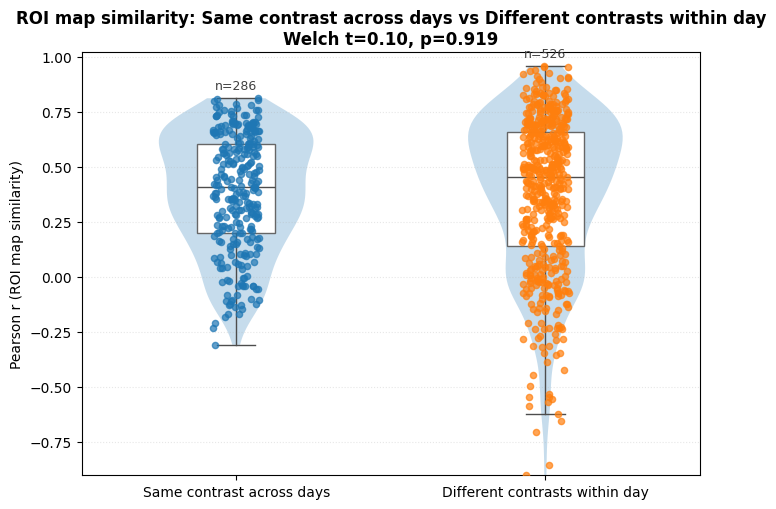

[SUMMARY] Observed mean corr over lags≥1: 0.327
[SUMMARY] Permutation null mean ± SD: 0.338 ± 0.046
[SUMMARY] One-sided p (obs > null): p = 0.5271


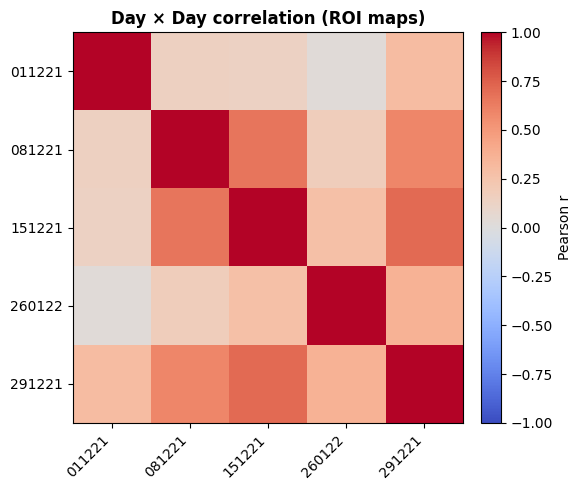

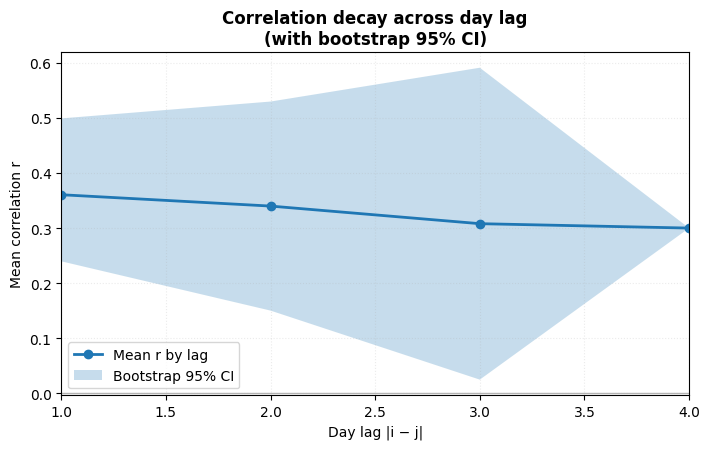

FileNotFoundError: [Errno 2] No such file or directory: 'C:\\Users\\amity\\Desktop\\Learning\\university\\Msc\\Vision Lab\\Thesis\\preprocessed_VSDdata\\_overlays_by_contrast_from_excel_roi\\sameDayColor\\roiR10_auto1_boxX30-60_boxY30-60_seedC100_win100-200_moderaw_fbd2fe\\day_corr_analysis_7c8af981\\permutation_null_vs_observed.png'

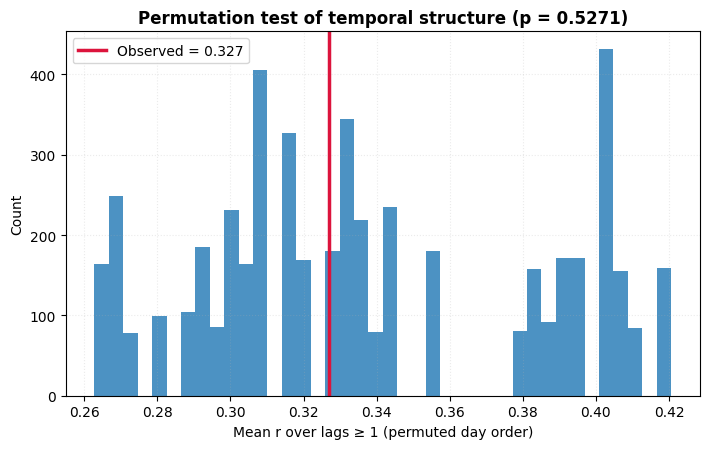

In [51]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy import stats

# Use your DataFrame name here if not 'pairs'
pairs_df = pairs.copy()

# Ensure the key columns exist
required = {"r", "same_contrast", "same_day", "day_i", "day_j"}
missing = required - set(pairs_df.columns)
if missing:
    raise KeyError(f"pairs_df is missing columns: {missing}")

# Make sure flags are boolean
for c in ["same_contrast", "same_day"]:
    if pairs_df[c].dtype != bool:
        pairs_df[c] = pairs_df[c].astype(bool)

# ---------------------------------------------------------
# DEFINE THE TWO COMPARISONS
# Pick ONE of the following options by setting USE_OPTION:

USE_OPTION = "A"   # "A" or "B"

# Option A (what you described you expect to be higher):
#   SAME = same contrast across DIFFERENT days
#   DIFF = different contrasts within the SAME day
if USE_OPTION == "A":
    mask_same = (pairs_df["same_contrast"] == True) & (pairs_df["day_i"] != pairs_df["day_j"])
    mask_diff = (pairs_df["same_contrast"] == False) & (pairs_df["day_i"] == pairs_df["day_j"])
    same_label = "Same contrast across days"
    diff_label = "Different contrasts within day"

# Option B (alternative you might want to compare):
#   SAME = same contrast (day can be anything)
#   DIFF = different contrast (day can be anything)
elif USE_OPTION == "B":
    mask_same = (pairs_df["same_contrast"] == True)
    mask_diff = (pairs_df["same_contrast"] == False)
    same_label = "Same contrast (any day)"
    diff_label = "Different contrasts (any day)"
else:
    raise ValueError("USE_OPTION must be 'A' or 'B'")

# Extract vectors and clean
same = pairs_df.loc[mask_same, "r"].to_numpy(dtype=float)
diff = pairs_df.loc[mask_diff, "r"].to_numpy(dtype=float)
same = same[np.isfinite(same)]
diff = diff[np.isfinite(diff)]

print("[INFO] Group sizes:")
print(f"  {same_label}: n={same.size}, mean={np.nanmean(same) if same.size else np.nan:.3f}")
print(f"  {diff_label}: n={diff.size}, mean={np.nanmean(diff) if diff.size else np.nan:.3f}")

# Basic t-test (Welch’s by default)
tstat, pval = (np.nan, np.nan)
if same.size >= 2 and diff.size >= 2:
    tstat, pval = stats.ttest_ind(same, diff, equal_var=False, nan_policy="omit")
print(f"[INFO] Welch t-test: t={tstat:.3f}, p={pval:.3g}")

# ---------------------------------------------------------
# Plot: violin + box + jitter + N labels
fig, ax = plt.subplots(figsize=(7.2, 5.2))

data = [same, diff]
labels = [same_label, diff_label]

# Violin
parts = ax.violinplot(data, showmeans=False, showmedians=False, showextrema=False)
for pc in parts['bodies']:
    pc.set_alpha(0.25)

# Boxplots over violins
bp = ax.boxplot(data, widths=0.25, patch_artist=True, showfliers=False)
for b in bp['boxes']:
    b.set(facecolor='white', edgecolor='0.4')
for element in ['whiskers', 'caps', 'medians']:
    for artist in bp[element]:
        artist.set(color='0.3')

# Jittered points
rng = np.random.default_rng(0)
for i, vals in enumerate(data, start=1):
    if vals.size == 0: 
        continue
    x = i + (rng.random(vals.size) - 0.5) * 0.15
    ax.scatter(x, vals, s=20, alpha=0.7, zorder=3)

# N labels above boxes
ymax = np.nanmax(np.concatenate([d for d in data if d.size])) if any(len(d) for d in data) else 1.0
for i, vals in enumerate(data, start=1):
    if vals.size == 0: 
        continue
    y = np.nanmax(vals)
    ax.text(i, y + 0.03 * max(0.1, ymax), f"n={vals.size}", ha="center", va="bottom", fontsize=9, color="0.25")

ax.set_xticks([1, 2])
ax.set_xticklabels(labels, rotation=0)
ax.set_ylabel("Pearson r (ROI map similarity)")
ax.set_title(f"ROI map similarity: {same_label} vs {diff_label}\nWelch t={tstat:.2f}, p={pval:.3g}", fontweight="bold")
ax.set_ylim(min(-0.1, np.nanmin(np.concatenate([same, diff]) if same.size and diff.size else [0])) , 1.02)
ax.grid(True, axis="y", linestyle=":", alpha=0.3)
fig.tight_layout()

# Optionally save
# fig.savefig(Path(_outdir) / "similarity_same_vs_diff.png", dpi=150)

plt.show()



# === Day-structure test with bootstrap CI and permutation null ===
import numpy as np
import matplotlib.pyplot as plt
import hashlib, json
from pathlib import Path

# --- sanity checks ---
assert isinstance(day_corr, np.ndarray) and day_corr.ndim == 2 and day_corr.shape[0] == day_corr.shape[1], \
    "day_corr must be an (N_days x N_days) symmetric matrix"
assert len(day_labels) == day_corr.shape[0], "day_labels length must match day_corr"

# --- helper: per-lag means along matrix diagonals (skip self lag=0 if wanted) ---
def per_lag_means(mat, skip_zero=True):
    n = mat.shape[0]
    lags = np.arange(n)
    means = []
    counts = []
    for d in lags:
        if d == 0 and skip_zero:
            means.append(np.nan)
            counts.append(0)
            continue
        vals = np.concatenate([np.diag(mat, k=d), np.diag(mat, k=-d)])
        vals = vals[np.isfinite(vals)]
        means.append(np.nanmean(vals) if vals.size else np.nan)
        counts.append(vals.size)
    return lags, np.array(means, float), np.array(counts, int)

# --- helper: bootstrap CI for the per-lag means (resample along each diagonal) ---
def bootstrap_per_lag_CI(mat, n_boot=2000, ci=95, rng=None):
    rng = np.random.default_rng(rng)
    n = mat.shape[0]
    lags = np.arange(1, n)  # skip 0
    boot_means = np.full((n_boot, len(lags)), np.nan)
    for b in range(n_boot):
        row = []
        for d in lags:
            vals = np.concatenate([np.diag(mat, k=d), np.diag(mat, k=-d)])
            vals = vals[np.isfinite(vals)]
            if vals.size:
                samp = rng.choice(vals, size=vals.size, replace=True)
                row.append(np.mean(samp))
            else:
                row.append(np.nan)
        boot_means[b, :] = row
    low = np.nanpercentile(boot_means, (100-ci)/2, axis=0)
    high = np.nanpercentile(boot_means, 100-(100-ci)/2, axis=0)
    return lags, low, high

# --- helper: a single-number "structured correlation" metric (avg over lags >=1) ---
def avg_corr_over_lags(mat):
    _, m, _ = per_lag_means(mat, skip_zero=True)
    return np.nanmean(m[1:]) if m.size > 1 else np.nan

# --- permutation null: shuffle day order, recompute avg over lags ---
def permutation_null(mat, n_perm=5000, rng=None):
    rng = np.random.default_rng(rng)
    n = mat.shape[0]
    vals = np.empty(n_perm, float)
    for k in range(n_perm):
        p = rng.permutation(n)
        mp = mat[p][:, p]              # destroy temporal ordering but keep values
        vals[k] = avg_corr_over_lags(mp)
    return vals

# ---------- outputs dir ----------
_obs = dict(days=day_labels, shape=tuple(day_corr.shape))
key = hashlib.md5(json.dumps(_obs, sort_keys=True).encode("utf-8")).hexdigest()[:8]
out_dir = Path(_outdir) / f"day_corr_analysis_{key}"
out_dir.mkdir(parents=True, exist_ok=True)

# ---------- compute summaries ----------
lags, lag_means, lag_counts = per_lag_means(day_corr, skip_zero=True)
lags_ci, ci_low, ci_high = bootstrap_per_lag_CI(day_corr, n_boot=2000, ci=95, rng=42)
obs_struct = avg_corr_over_lags(day_corr)  # observed structured correlation

null_vals = permutation_null(day_corr, n_perm=5000, rng=123)
p_val = (np.sum(null_vals >= obs_struct) + 1) / (len(null_vals) + 1)  # right-tailed

print(f"[SUMMARY] Observed mean corr over lags≥1: {obs_struct:.3f}")
print(f"[SUMMARY] Permutation null mean ± SD: {np.nanmean(null_vals):.3f} ± {np.nanstd(null_vals):.3f}")
print(f"[SUMMARY] One-sided p (obs > null): p = {p_val:.4f}")

# ---------- Plot 1: heatmap of day_corr ----------
fig, ax = plt.subplots(figsize=(5.8, 5.0))
im = ax.imshow(day_corr, vmin=-1, vmax=1, cmap="coolwarm")
ax.set_xticks(range(len(day_labels))); ax.set_yticks(range(len(day_labels)))
ax.set_xticklabels(day_labels, rotation=45, ha="right"); ax.set_yticklabels(day_labels)
ax.set_title("Day × Day correlation (ROI maps)", fontweight="bold")
cb = plt.colorbar(im, ax=ax, fraction=0.046, pad=0.04); cb.set_label("Pearson r")
fig.tight_layout()
fig.savefig(out_dir / "day_corr_heatmap.png", dpi=150)
plt.show()

# ---------- Plot 2: mean vs lag with bootstrap CI ----------
fig, ax = plt.subplots(figsize=(7.2, 4.6))
ax.plot(lags[1:], lag_means[1:], marker="o", lw=2, label="Mean r by lag")
ax.fill_between(lags_ci, ci_low, ci_high, alpha=0.25, label="Bootstrap 95% CI")
ax.axhline(0, color="0.7", lw=1)
ax.set_xlabel("Day lag |i − j|")
ax.set_ylabel("Mean correlation r")
ax.set_title("Correlation decay across day lag\n(with bootstrap 95% CI)", fontweight="bold")
ax.set_xlim(1, len(day_labels)-1)
ax.grid(True, alpha=0.25, linestyle=":")
ax.legend()
fig.tight_layout()
fig.savefig(out_dir / "mean_vs_lag_bootstrap_CI.png", dpi=150)
plt.show()

# ---------- Plot 3: permutation null vs observed ----------
fig, ax = plt.subplots(figsize=(7.2, 4.6))
ax.hist(null_vals, bins=40, alpha=0.8)
ax.axvline(obs_struct, color="crimson", lw=2.5, label=f"Observed = {obs_struct:.3f}")
ax.set_xlabel("Mean r over lags ≥ 1 (permuted day order)")
ax.set_ylabel("Count")
ax.set_title(f"Permutation test of temporal structure (p = {p_val:.4f})", fontweight="bold")
ax.grid(True, alpha=0.25, linestyle=":")
ax.legend()
fig.tight_layout()
fig.savefig(out_dir / "permutation_null_vs_observed.png", dpi=150)
plt.show()

print(f"[SAVED] {out_dir}")




# only high contrst

[SIM] Using outdir: C:\Users\amity\Desktop\Learning\university\Msc\Vision Lab\Thesis\preprocessed_VSDdata\_overlays_by_contrast_from_excel_roi\sameDayColor\roiR10_auto1_boxX30-60_boxY30-60_seedC100_win100-200_moderaw_fbd2fe
[SIM] Loaded 75 (session,contrast) vectors; ROI pixels = 317
[SIM] Excluding contrasts (too few days/sessions): [12, 24]


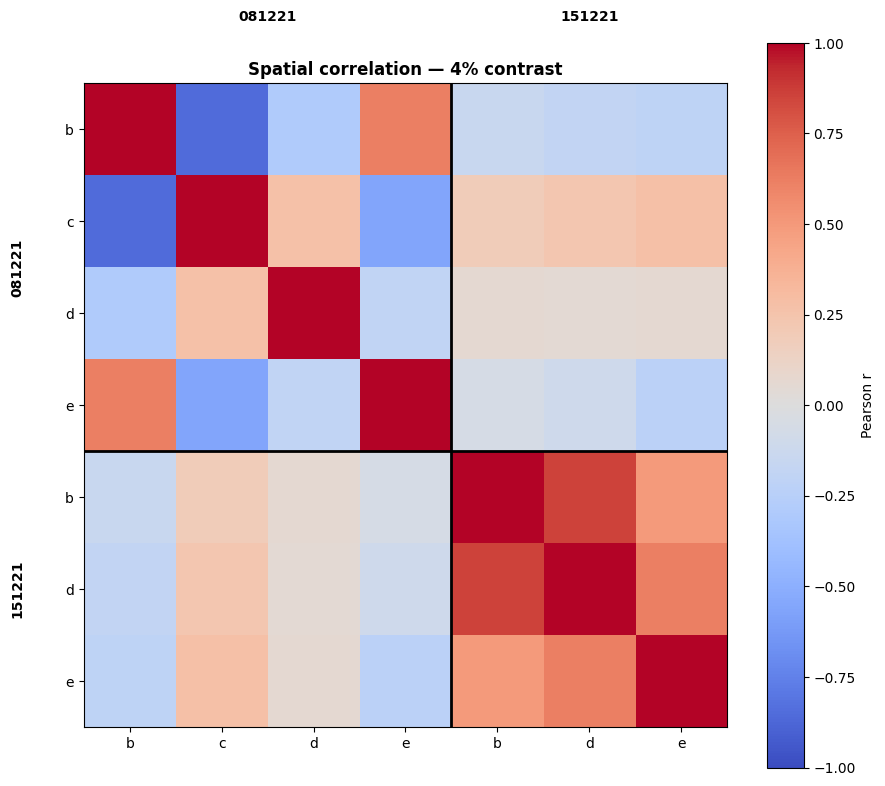

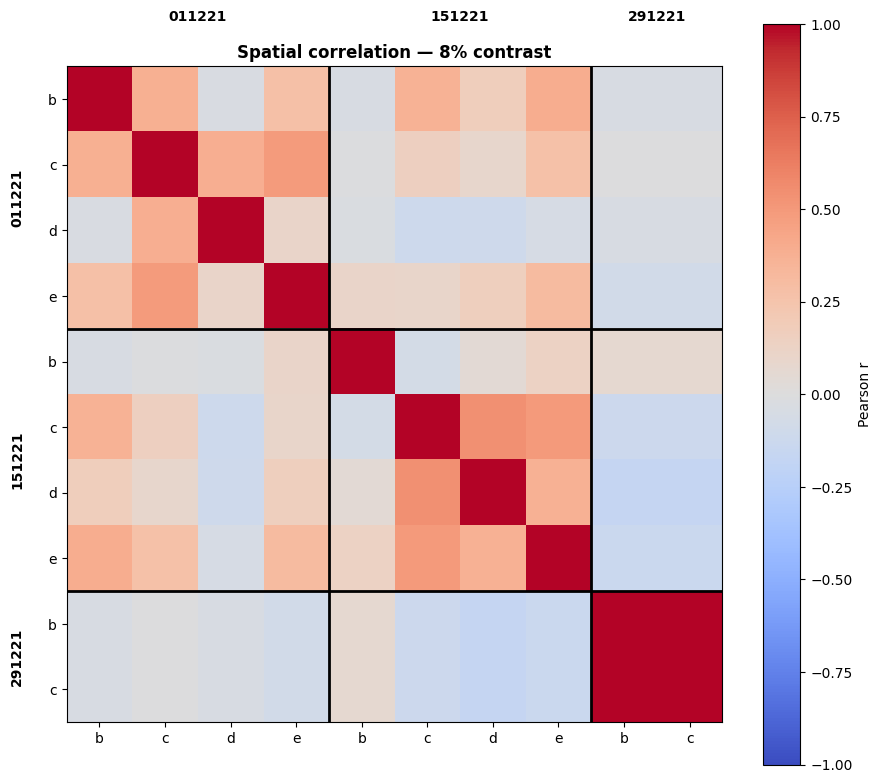

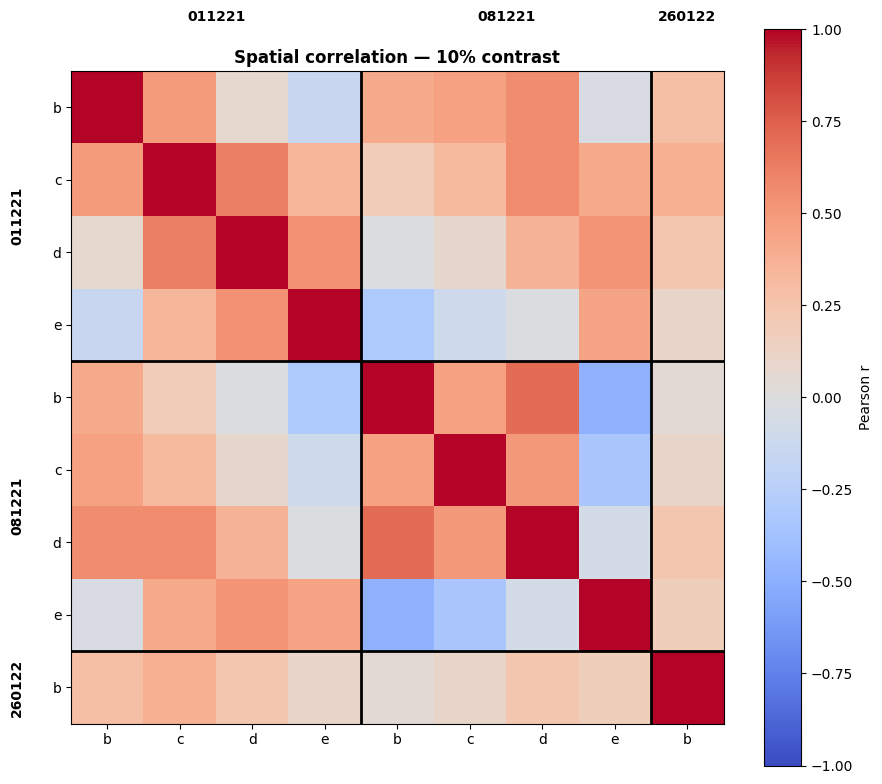

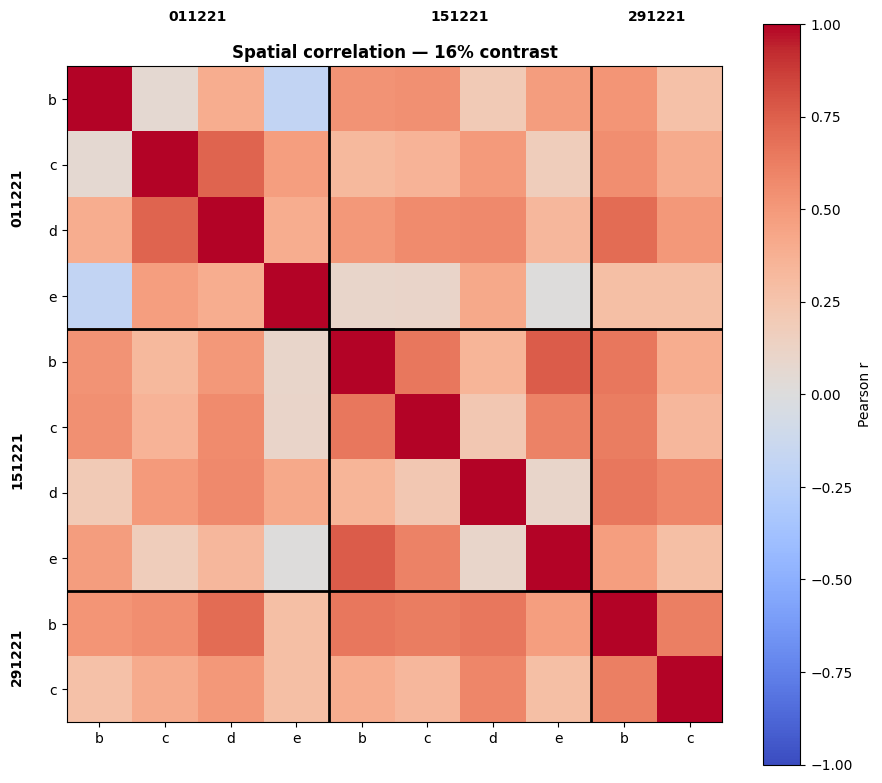

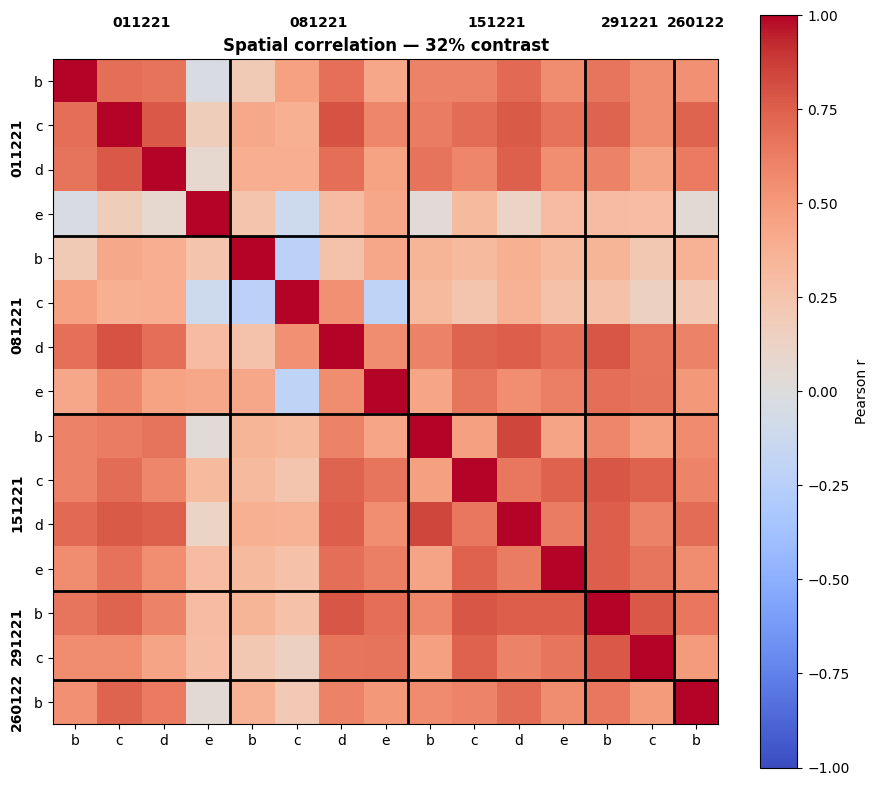

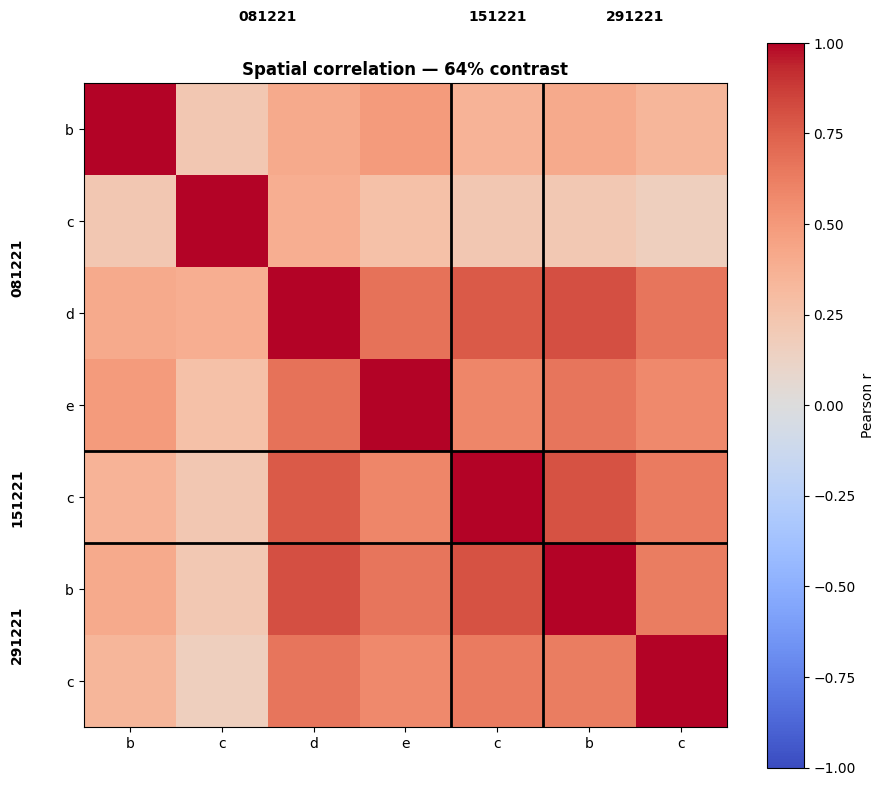

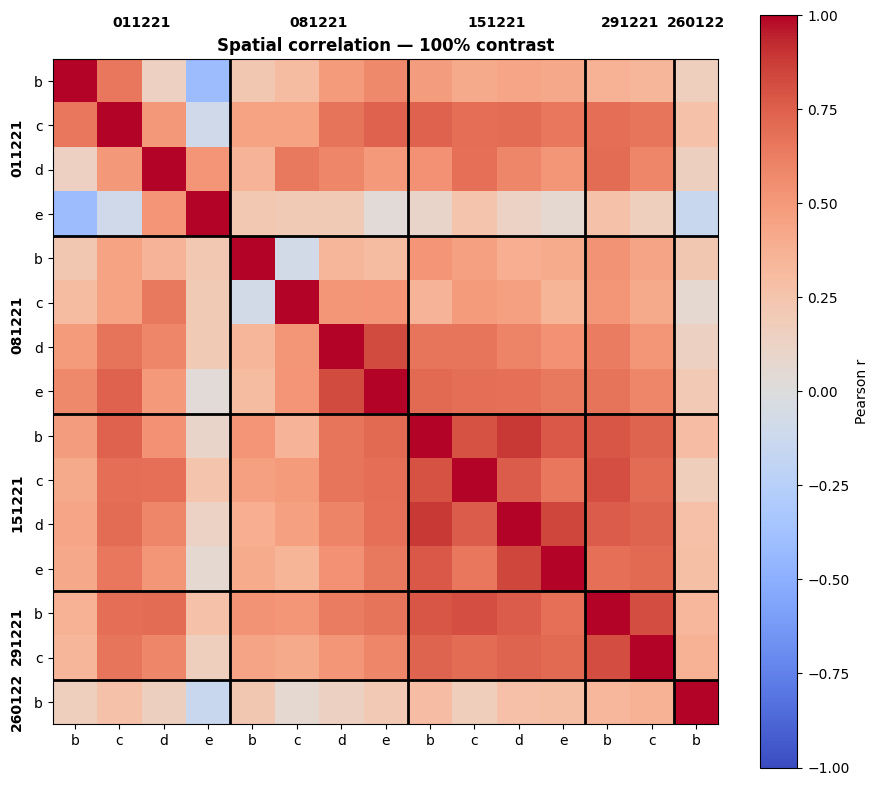

[SIM] Saved pairwise table: C:\Users\amity\Desktop\Learning\university\Msc\Vision Lab\Thesis\preprocessed_VSDdata\_overlays_by_contrast_from_excel_roi\sameDayColor\roiR10_auto1_boxX30-60_boxY30-60_seedC100_win100-200_moderaw_fbd2fe\pattern_similarity\pairs_all.csv (rows=2628)
   metric  signal_mean  signal_median  noise_mean  noise_median  n_signal  \
0       r     0.377515       0.411107    0.379383      0.453230       378   
1     1-r     0.622485       0.588893    0.620617      0.546770       378   
2  euclid    19.262203      19.291959   18.975891     18.589198       378   

   n_noise  
0      526  
1      526  
2      526  


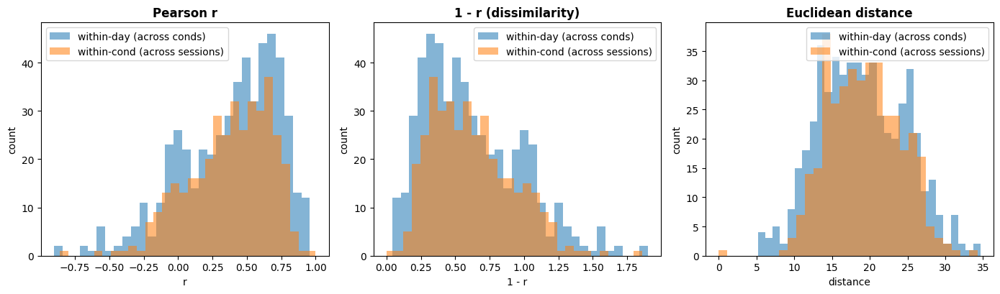

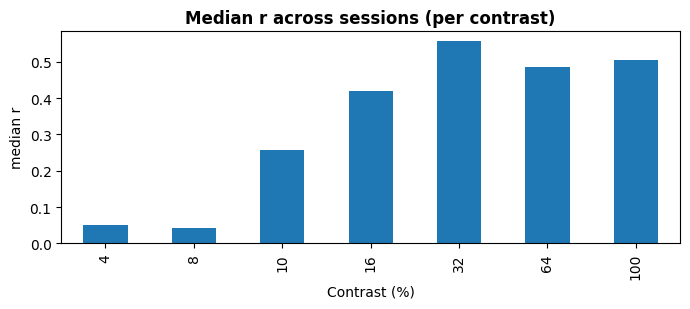

[BAL] noise days=5, signal WD units=20, signal AD units=33
                              group  n_units    r_mean  r_median  1-r_mean  \
0                  noise_within_day        5  0.519340  0.495172  0.480660   
1   signal_within_day_same_contrast       20  0.481332  0.422693  0.518668   
2  signal_across_days_same_contrast       33  0.401616  0.453497  0.598384   

   1-r_median  euclid_mean  euclid_median  
0    0.504828    17.302309      17.862007  
1    0.577307    17.139019      18.845517  
2    0.546503    19.121856      18.565828  


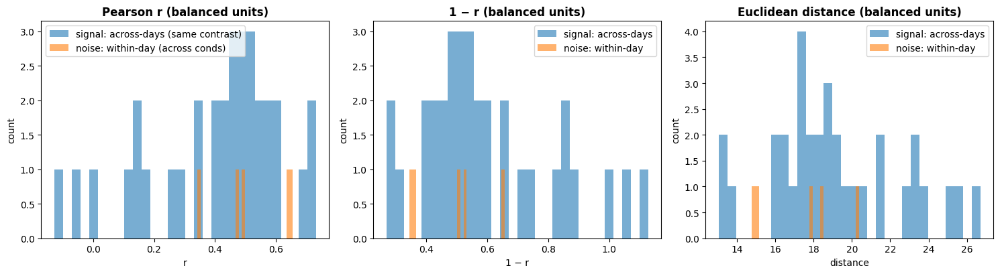

[BOOT] mean r(signal_across_days) − mean r(noise_within_day) = -0.1188  (95% CI -0.2432 .. 0.0043)


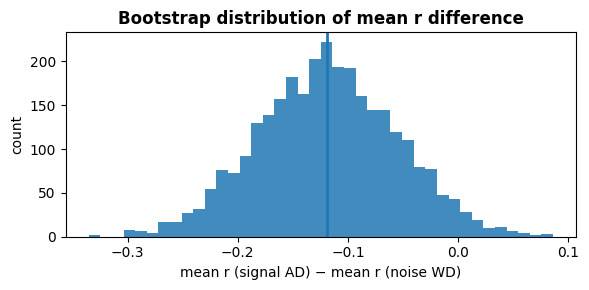

[SIM] Done.
[PER-C] Centroids built: 24 (day,contrast) units
[PER-C] Built 23 paired comparisons vs base 32%.
   contrast   n  r_sig_mean  r_sig_med  r_noi_mean  r_noi_med  diff_mean  \
0         4   1    0.091462   0.091462    0.257135   0.257135  -0.165673   
1         8   3    0.034347  -0.072243    0.570790   0.630239  -0.536443   
2        10   3    0.374796   0.376375    0.801139   0.794248  -0.426344   
3        16   3    0.716251   0.721625    0.895389   0.900521  -0.179138   
4        64   3    0.676526   0.639800    0.876923   0.876643  -0.200396   
5       100  10    0.573870   0.746382    0.855264   0.867111  -0.281394   

   diff_med  z_sig_mean  z_noi_mean  z_diff_mean  
0 -0.165673    0.091718    0.263038    -0.171320  
1 -0.493183    0.037968    0.682067    -0.644099  
2 -0.376542    0.405670    1.113873    -0.708203  
3 -0.168311    0.900912    1.450570    -0.549658  
4 -0.268319    0.845308    1.373233    -0.527925  
5 -0.151932    0.751442    1.311146    -0.559704  


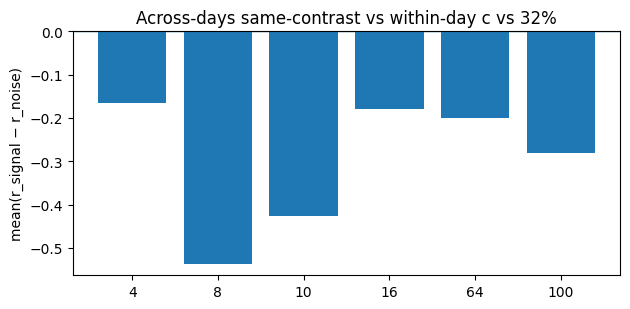

In [ ]:
# === Spatial pattern similarity (reuses roi_patterns_XXpct.npz) ================
# - For each contrast: session×session correlation heatmap, grouped by day
# - Across sessions/contrasts: pairwise table (r and Euclidean) + summary plots

from pathlib import Path
import re, json, numpy as np, pandas as pd, matplotlib.pyplot as plt
from collections import defaultdict

# ---------------- Config --------------------------------------------------------
SIM_EXCLUDE_ZERO = True                 # skip 0% “blank” condition
SIM_ZSCORE_BEFORE_EUCLIDEAN = True      # z-score each vector before Euclidean
SIM_OUTDIR_OVERRIDE = r"C:\Users\amity\Desktop\Learning\university\Msc\Vision Lab\Thesis\preprocessed_VSDdata\_overlays_by_contrast_from_excel_roi\sameDayColor\roiR10_auto1_boxX30-60_boxY30-60_seedC100_win100-200_moderaw_fbd2fe"               # optionally pin a specific run folder
HEATMAP_FIGSIZE = (9, 8)
HEATMAP_ANNOTATE_BLOCK_MEANS = False    # show mean r inside each day block
# Exclude contrasts that are under-represented:
SIM_MIN_DAYS_PER_CONTRAST = 2
SIM_MIN_TOTAL_SESS_PER_CONTRAST = 2

# ---------------- Resolve run folder with roi_patterns_* ------------------------
def _latest_outdir_with_patterns(root: Path):
    candidates = []
    for cfg in root.rglob("config.json"):
        d = cfg.parent
        if any(d.glob("roi_patterns_*pct.npz")):
            candidates.append((cfg.stat().st_mtime, d))
    if not candidates:
        raise RuntimeError("No runs with roi_patterns_*pct.npz found.")
    return max(candidates, key=lambda t: t[0])[1]

if SIM_OUTDIR_OVERRIDE:
    _outdir = Path(SIM_OUTDIR_OVERRIDE)
elif "_outdir" in globals():
    _outdir = Path(globals()["_outdir"])
else:
    ROOT = Path(PREPROC_BASE) / "_overlays_by_contrast_from_excel_roi"
    _outdir = _latest_outdir_with_patterns(ROOT)

print(f"[SIM] Using outdir: {_outdir}")

sim_dir = _outdir / "pattern_similarity"
sim_dir.mkdir(parents=True, exist_ok=True)

# Robust CSV saver: always create parent dir before writing
def _save_csv(df: pd.DataFrame, path, index: bool = False):
    p = Path(path)
    p.parent.mkdir(parents=True, exist_ok=True)
    df.to_csv(p, index=index)

with open(sim_dir / "meta.json", "w", encoding="utf-8") as f:
    json.dump({
        "outdir": str(_outdir),
        "exclude_zero": SIM_EXCLUDE_ZERO,
        "zscore_euclidean": SIM_ZSCORE_BEFORE_EUCLIDEAN,
        "min_days_per_contrast": SIM_MIN_DAYS_PER_CONTRAST,
        "min_total_sessions_per_contrast": SIM_MIN_TOTAL_SESS_PER_CONTRAST,
    }, f, indent=2)

# ---------------- Helpers -------------------------------------------------------
def _split_day_letter(lab: str):
    s = str(lab).strip().lower()
    m = re.match(r"(\d{6})([a-z])$", s)
    return (m.group(1), m.group(2)) if m else (s[:-1], s[-1])

try:
    datecode_to_dt  # defined earlier in your notebook
except NameError:
    from datetime import datetime
    def datecode_to_dt(dc): return datetime.strptime(dc, "%d%m%y")

def _pearson_corr(A):
    A = np.asarray(A, float)
    A = A - A.mean(axis=1, keepdims=True)
    denom = np.linalg.norm(A, axis=1, keepdims=True)
    denom[denom == 0] = 1.0
    Z = A / denom
    return Z @ Z.T

def _euclidean_dist(A, zscore=SIM_ZSCORE_BEFORE_EUCLIDEAN):
    A = np.asarray(A, float)
    if zscore:
        mu = A.mean(axis=1, keepdims=True)
        sd = A.std(axis=1, keepdims=True, ddof=1)
        sd[sd == 0] = 1.0
        A = (A - mu) / sd
    G = A @ A.T
    nrm = np.sum(A*A, axis=1, keepdims=True)
    D2 = nrm + nrm.T - 2*G
    D2[D2 < 0] = 0.0
    return np.sqrt(D2)

def _prep_df_for_contrast(patterns_df, contrast):
    sub = patterns_df.loc[patterns_df["contrast"] == contrast,
                          ["contrast", "label", "day", "letter", "vec"]].copy()
    if sub.empty:
        raise ValueError(f"No rows for contrast {contrast}.")
    # order: by day (chronological) then by session letter
    day_order = {d:i for i, d in enumerate(sorted(sub["day"].unique(), key=datecode_to_dt))}
    let_order = {l:i for i, l in enumerate(sorted(sub["letter"].unique()))}
    sub.sort_values(["day", "letter"],
                    key=lambda s: s.map(day_order) if s.name == "day" else s.map(let_order),
                    inplace=True)
    sub.reset_index(drop=True, inplace=True)
    return sub

def plot_corr_heatmap_by_day(patterns_df, contrast, figsize=HEATMAP_FIGSIZE,
                             annotate_means=HEATMAP_ANNOTATE_BLOCK_MEANS):
    sub = _prep_df_for_contrast(patterns_df, contrast)
    A = np.vstack(sub["vec"].to_list())
    R = _pearson_corr(A)

    # Build day blocks (indices in the sorted sub)
    days = sub["day"].tolist()
    blocks = []
    s = 0
    for i in range(1, len(days)):
        if days[i] != days[i-1]:
            blocks.append((days[s], s, i))
            s = i
    blocks.append((days[s], s, len(days)))

    # --- PLOT ---
    fig, ax = plt.subplots(figsize=figsize)
    im = ax.imshow(R, vmin=-1, vmax=1, cmap="coolwarm")
    ax.set_title(f"Spatial correlation — {contrast}% contrast", fontweight="bold")
    # use only the session letters for tick labels
    letters = sub["letter"].tolist()
    ax.set_xticks(range(len(letters))); ax.set_xticklabels(letters, rotation=0)
    ax.set_yticks(range(len(letters))); ax.set_yticklabels(letters)
    cb = plt.colorbar(im, ax=ax); cb.set_label("Pearson r")

    # thick lines between day blocks
    for _, start, end in blocks[:-1]:
        ax.axhline(end-0.5, color="k", lw=2)
        ax.axvline(end-0.5, color="k", lw=2)

    # day titles above columns and left of rows
    for day, start, end in blocks:
        center = (start + end - 1) / 2.0
        ax.text(center, -1.15, day, ha="center", va="bottom",
                fontsize=10, fontweight="bold")             # top
        ax.text(-1.15, center, day, ha="right", va="center",
                fontsize=10, fontweight="bold", rotation=90) # left

    # optional: annotate block means
    if annotate_means:
        for (day_i, si, ei) in blocks:
            for (day_j, sj, ej) in blocks:
                block = R[si:ei, sj:ej]
                if day_i == day_j:
                    if block.shape[0] > 1:
                        mask = ~np.eye(block.shape[0], dtype=bool)
                        val = np.nanmean(block[mask]) if mask.any() else np.nan
                    else:
                        val = np.nan
                else:
                    val = np.nanmean(block) if block.size else np.nan
                ax.text((sj+ej-1)/2, (si+ei-1)/2, f"{val:.2f}",
                        ha="center", va="center", fontsize=9, color="k",
                        bbox=dict(boxstyle="round,pad=0.15", fc="white", ec="none", alpha=0.6))

    # annotate only the minimum off-diagonal r ===
    n = R.shape[0]
    if n > 1:
        # upper triangle without diagonal
        iu, ju = np.triu_indices(n, k=1)
        if iu.size > 0:
            vals = R[iu, ju]
            kmin = np.argmin(vals)
            i_min, j_min = iu[kmin], ju[kmin]
            min_val = vals[kmin]

            text_color = "white" if abs(min_val) > 0.6 else "black"
            ax.text(
                j_min, i_min,
                f"{min_val:.2f}",
                ha="center", va="center",
                fontsize=11, fontweight="bold",
                color=text_color,
            )

    fig.tight_layout()
    return fig, ax, R, sub


# ---------------- Load all pattern files ---------------------------------------
pat_files = sorted(_outdir.glob("roi_patterns_*pct.npz"))
if not pat_files:
    raise RuntimeError("No roi_patterns_*pct.npz in the chosen outdir.")

all_items = []   # rows: (pct, label, day, letter, vec)
for f in pat_files:
    m = re.search(r"roi_patterns_(\d+)pct\.npz$", f.name)
    if not m:
        continue
    pct = int(m.group(1))
    if SIM_EXCLUDE_ZERO and pct == 0:
        continue
    Z = np.load(f, allow_pickle=True)
    labels = Z["labels"].astype(str)      # (N_sessions,)
    P = np.array(Z["patterns"])           # (N_sessions, n_pixels_in_roi)
    if P.ndim != 2:
        raise ValueError(f"{f.name}: expected 2D 'patterns' (S×P), got {P.shape}")
    for i, lab in enumerate(labels):
        day, let = _split_day_letter(lab)
        all_items.append((pct, lab, day, let, P[i]))

if not all_items:
    raise RuntimeError("No items loaded (check filters).")

patterns_df = pd.DataFrame(all_items, columns=["contrast", "label", "day", "letter", "vec"])

# ROI size sanity check + n_pix for the log line
n_pix = len(patterns_df.iloc[0]["vec"])
assert all(len(v) == n_pix for v in patterns_df["vec"]), "ROI size mismatch across items."

# global consistent ordering: contrast → day (chronological) → letter
day_order_all = {d:i for i, d in enumerate(sorted(patterns_df["day"].unique(), key=datecode_to_dt))}
let_order_all = {l:i for i, l in enumerate(sorted(patterns_df["letter"].unique()))}
patterns_df = patterns_df.sort_values(
    ["contrast", "day", "letter"],
    key=lambda s: (
        s if s.name == "contrast"
        else s.map(day_order_all) if s.name == "day"
        else s.map(let_order_all)
    )
).reset_index(drop=True)

print(f"[SIM] Loaded {len(patterns_df)} (session,contrast) vectors; ROI pixels = {n_pix}")

# ---------------- Filter contrasts with too few days/sessions -------------------
counts = (
    patterns_df.groupby("contrast")
    .agg(n_days=("day", "nunique"), n_total=("label", "count"))
    .reset_index()
)
keep_contrasts = counts.query(
    "n_days >= @SIM_MIN_DAYS_PER_CONTRAST and n_total >= @SIM_MIN_TOTAL_SESS_PER_CONTRAST"
)["contrast"].tolist()
dropped = sorted(set(patterns_df["contrast"]) - set(keep_contrasts))
if dropped:
    print(f"[SIM] Excluding contrasts (too few days/sessions): {dropped}")
patterns_df = patterns_df[patterns_df["contrast"].isin(keep_contrasts)].reset_index(drop=True)

# ---------------- Per-contrast heatmaps (grouped by day, letters on axes) ------
for pct in sorted(patterns_df["contrast"].unique()):
    sub = patterns_df.query("contrast == @pct")
    if sub["day"].nunique() < 2:
        print(f"[SIM] Skip heatmap for {pct}% (only one day present).")
        continue

    fig, ax, R, sub_sorted = plot_corr_heatmap_by_day(patterns_df, pct)
    # Save full matrix with full labels (not just letters) for provenance
    mat = pd.DataFrame(R, index=sub_sorted["label"], columns=sub_sorted["label"])
    _save_csv(mat, sim_dir / f"corr_sessions_{pct}pct.csv", index=True)
    fig.savefig(sim_dir / f"corr_sessions_{pct}pct.png", dpi=150)
    plt.show()

# ---------------- Global pairwise table (across kept items) ---------------------
rows = []
V = np.vstack(patterns_df["vec"].to_list())   # (N, P)
R = _pearson_corr(V)
D = _euclidean_dist(V)                        # z-scored if config True
N = len(patterns_df)

for i in range(N):
    for j in range(i+1, N):
        rows.append(dict(
            i=i, j=j,
            label_i=patterns_df.iloc[i]["label"], label_j=patterns_df.iloc[j]["label"],
            day_i=patterns_df.iloc[i]["day"], day_j=patterns_df.iloc[j]["day"],
            letter_i=patterns_df.iloc[i]["letter"], letter_j=patterns_df.iloc[j]["letter"],
            contrast_i=int(patterns_df.iloc[i]["contrast"]), contrast_j=int(patterns_df.iloc[j]["contrast"]),
            same_day = (patterns_df.iloc[i]["day"] == patterns_df.iloc[j]["day"]),
            same_contrast = (int(patterns_df.iloc[i]["contrast"]) == int(patterns_df.iloc[j]["contrast"])),
            r = float(R[i, j]),
            one_minus_r = float(1.0 - R[i, j]),
            euclid = float(D[i, j])
        ))

pairs = pd.DataFrame(rows)
_save_csv(pairs, sim_dir / "pairs_all.csv")
print(f"[SIM] Saved pairwise table: {sim_dir/'pairs_all.csv'} (rows={len(pairs)})")

# ---------------- Summary: signal (within-contrast) vs noise (within-day) ------
signal = pairs.query("same_contrast == True and label_i != label_j")
noise  = pairs.query("same_day == True and same_contrast == False")

summary = pd.DataFrame({
    "metric": ["r", "1-r", "euclid"],
    "signal_mean": [signal["r"].mean(), signal["one_minus_r"].mean(), signal["euclid"].mean()],
    "signal_median": [signal["r"].median(), signal["one_minus_r"].median(), signal["euclid"].median()],
    "noise_mean": [noise["r"].mean(), noise["one_minus_r"].mean(), noise["euclid"].mean()],
    "noise_median": [noise["r"].median(), noise["one_minus_r"].median(), noise["euclid"].median()],
    "n_signal": [len(signal)]*3,
    "n_noise": [len(noise)]*3
})
_save_csv(summary, sim_dir / "summary_signal_vs_noise.csv")
print(summary)

# ---------------- Distributions of r and distances (bold titles) ---------------
fig, axs = plt.subplots(1, 3, figsize=(14, 4.2))

def _plot_hist(ax, sig_series, noise_series, title, xlabel):
    ax.hist(noise_series.dropna(), bins=30, alpha=0.55, label="within-day (across conds)")
    ax.hist(sig_series.dropna(), bins=30, alpha=0.55, label="within-cond (across sessions)")
    ax.set_title(title, fontweight='bold'); ax.set_xlabel(xlabel); ax.set_ylabel("count"); ax.legend()

_plot_hist(axs[0], signal["r"],            noise["r"],            "Pearson r", "r")
_plot_hist(axs[1], signal["one_minus_r"],  noise["one_minus_r"],  "1 - r (dissimilarity)", "1 - r")
_plot_hist(axs[2], signal["euclid"],       noise["euclid"],       "Euclidean distance", "distance")

fig.tight_layout()
fig.savefig(sim_dir / "signal_vs_noise_hist.png", dpi=150)
plt.show()

# ---------------- Optional: per-contrast stability (exclude weak contrasts) -----
stable = pairs.query("same_contrast == True")
by_pct = stable.groupby("contrast_i")["r"].median().sort_index()
ax = by_pct.plot(kind="bar", figsize=(7, 3.2), title="Median r across sessions (per contrast)")
ax.set_xlabel("Contrast (%)"); ax.set_ylabel("median r"); ax.title.set_weight('bold')
plt.tight_layout(); plt.savefig(sim_dir / "median_r_by_contrast.png", dpi=150); plt.show()

# === Balanced, pair-count-fair comparison ======================================
# One value per "unit" so days with many sessions don't dominate.
#   • noise (within-day across conditions):     1 value per day
#   • signal across-days (same contrast):       1 value per (day-pair, contrast)
#   • (optional) signal within-day same contrast: 1 value per (day, contrast)

# Use a short subfolder + short filenames to avoid Windows path-length errors
balanced_dir = sim_dir / "balanced"
balanced_dir.mkdir(parents=True, exist_ok=True)

# Sanity: ensure required columns exist
_required = {
    "label_i","label_j","day_i","day_j","letter_i","letter_j",
    "contrast_i","contrast_j","same_day","same_contrast","r","one_minus_r","euclid"
}
_missing = _required - set(pairs.columns)
if _missing:
    raise ValueError(f"`pairs` is missing columns: {sorted(_missing)}")

def _day_pair(a, b):
    """Make an unordered day-pair key like ('011221','151221')."""
    return tuple(sorted((str(a), str(b))))

# --------- Aggregate units ---------
# Noise: same day, different contrasts -> one value per day
noise_raw = pairs.query("same_day and not same_contrast").copy()
noise_bal = (
    noise_raw
    .assign(day=lambda d: d["day_i"])  # (same as day_j)
    .groupby("day", as_index=False)
    .agg(r=("r","median"),
         one_minus_r=("one_minus_r","median"),
         euclid=("euclid","median"),
         n_pairs=("r","size"))
)
_save_csv(noise_bal, balanced_dir / "noise_day.csv")

# Signal within-day (same contrast, different sessions) -> one value per (day, contrast)
sig_wd_raw = pairs.query("same_contrast and same_day and label_i != label_j").copy()
sig_wd_bal = (
    sig_wd_raw
    .assign(day=lambda d: d["day_i"], contrast=lambda d: d["contrast_i"])
    .groupby(["day","contrast"], as_index=False)
    .agg(r=("r","median"),
         one_minus_r=("one_minus_r","median"),
         euclid=("euclid","median"),
         n_pairs=("r","size"))
)
_save_csv(sig_wd_bal, balanced_dir / "sig_wd.csv")

# Signal across-days (same contrast, different days) -> one value per (day-pair, contrast)
sig_ad_raw = pairs.query("same_contrast and day_i != day_j").copy()
sig_ad_bal = sig_ad_raw.copy()
sig_ad_bal["day_pair"] = sig_ad_bal.apply(lambda x: _day_pair(x["day_i"], x["day_j"]), axis=1)
sig_ad_bal["contrast"] = sig_ad_bal["contrast_i"]
sig_ad_bal = (
    sig_ad_bal
    .groupby(["day_pair","contrast"], as_index=False)
    .agg(r=("r","median"),
         one_minus_r=("one_minus_r","median"),
         euclid=("euclid","median"),
         n_pairs=("r","size"))
)
_save_csv(sig_ad_bal, balanced_dir / "sig_ad.csv")

print(f"[BAL] noise days={len(noise_bal)}, signal WD units={len(sig_wd_bal)}, signal AD units={len(sig_ad_bal)}")

# --------- Summary table (balanced units) ---------
def _summ(df, label):
    return {
        "group": label,
        "n_units": len(df),
        "r_mean": df["r"].mean(), "r_median": df["r"].median(),
        "1-r_mean": df["one_minus_r"].mean(), "1-r_median": df["one_minus_r"].median(),
        "euclid_mean": df["euclid"].mean(), "euclid_median": df["euclid"].median(),
    }

balanced_summary = pd.DataFrame([
    _summ(noise_bal,  "noise_within_day"),
    _summ(sig_wd_bal, "signal_within_day_same_contrast"),
    _summ(sig_ad_bal, "signal_across_days_same_contrast"),
])
_save_csv(balanced_summary, balanced_dir / "summary.csv")
print(balanced_summary)

# --------- Plots: balanced histograms ---------
fig, axs = plt.subplots(1, 3, figsize=(15, 4.2))

def _hist(ax, a, b, title, xlabel, lab_a, lab_b):
    ax.hist(a.dropna(),   bins=30, alpha=0.6, label=lab_a)
    ax.hist(b.dropna(),   bins=30, alpha=0.6, label=lab_b)
    ax.set_title(title, fontweight="bold"); ax.set_xlabel(xlabel); ax.set_ylabel("count"); ax.legend()

_hist(axs[0], sig_ad_bal["r"],           noise_bal["r"],
      "Pearson r (balanced units)", "r",
      "signal: across-days (same contrast)", "noise: within-day (across conds)")
_hist(axs[1], sig_ad_bal["one_minus_r"], noise_bal["one_minus_r"],
      "1 − r (balanced units)", "1 − r",
      "signal: across-days", "noise: within-day")
_hist(axs[2], sig_ad_bal["euclid"],      noise_bal["euclid"],
      "Euclidean distance (balanced units)", "distance",
      "signal: across-days", "noise: within-day")

fig.tight_layout()
fig.savefig(balanced_dir / "hist.png", dpi=150)
plt.show()

# --------- Optional: stratified bootstrap for CI on mean r difference ---------
rng = np.random.default_rng(0)

def _rows_by_key(df, key_cols):
    d = defaultdict(list)
    # Store row *integer* indices per key
    for idx, row in df.iterrows():
        d[tuple(row[c] for c in key_cols)].append(idx)
    return d

def stratified_bootstrap_mean_diff(sig_df, sig_key_cols, noise_df, noise_key_cols,
                                   value_col="r", n_iter=3000):
    # Build maps: key -> list of row indices
    sig_map   = _rows_by_key(sig_df,   sig_key_cols)
    noise_map = _rows_by_key(noise_df, noise_key_cols)

    sig_keys   = list(sig_map.keys())
    noise_keys = list(noise_map.keys())
    if len(sig_keys) == 0 or len(noise_keys) == 0:
        raise ValueError("Not enough balanced units to bootstrap.")

    diffs = np.empty(n_iter, float)

    for i in range(n_iter):
        # sample integer indices of keys (not the tuple keys themselves)
        sig_key_idx = rng.choice(np.arange(len(sig_keys)), size=len(sig_keys), replace=True)
        noi_key_idx = rng.choice(np.arange(len(noise_keys)), size=len(noise_keys), replace=True)

        # pick one row index from each sampled key's pool
        sig_row_idx = [rng.choice(sig_map[sig_keys[k]]) for k in sig_key_idx]
        noi_row_idx = [rng.choice(noise_map[noise_keys[k]]) for k in noi_key_idx]

        sig_mean = sig_df.loc[sig_row_idx, value_col].mean()
        noi_mean = noise_df.loc[noi_row_idx, value_col].mean()
        diffs[i] = sig_mean - noi_mean

    lo, hi = np.percentile(diffs, [2.5, 97.5])
    return diffs, (lo, hi)

# Bootstrap: mean r difference between signal (across-days) and noise (within-day)
if len(sig_ad_bal) and len(noise_bal):
    diffs, ci = stratified_bootstrap_mean_diff(
        sig_df=sig_ad_bal,  sig_key_cols=["day_pair","contrast"],
        noise_df=noise_bal, noise_key_cols=["day"],
        value_col="r", n_iter=3000
    )
    print(f"[BOOT] mean r(signal_across_days) − mean r(noise_within_day) "
          f"= {diffs.mean():.4f}  (95% CI {ci[0]:.4f} .. {ci[1]:.4f})")
    plt.figure(figsize=(6,3))
    plt.hist(diffs, bins=40, alpha=0.85)
    plt.axvline(diffs.mean(), lw=2)
    plt.title("Bootstrap distribution of mean r difference", fontweight="bold")
    plt.xlabel("mean r (signal AD) − mean r (noise WD)"); plt.ylabel("count")
    plt.tight_layout()
    plt.savefig((sim_dir / "balanced" / "bootstrap_diff_r.png"), dpi=150)
    plt.show()
else:
    print("[BOOT] Skipped bootstrap (not enough balanced units).")
# ===============================================================================


print("[SIM] Done.")



# === Per-contrast test: is across-day same-contrast more similar than within-day c vs 32%? ===

BASE_CONTRAST = 32   # change if you want a different baseline

# 1) Build day–contrast centroids (one vector per (day, contrast))
centroid_rows = []
for (day, contrast), g in patterns_df.groupby(["day", "contrast"]):
    M = np.vstack(g["vec"].to_list()).mean(axis=0)
    centroid_rows.append((contrast, str(day), day, "centroid", M))
centroids_df = pd.DataFrame(centroid_rows, columns=["contrast","label","day","letter","vec"])
print(f"[PER-C] Centroids built: {len(centroids_df)} (day,contrast) units")

def _get_centroid(day, contrast):
    s = centroids_df[(centroids_df["day"] == day) & (centroids_df["contrast"] == contrast)]
    return None if s.empty else s.iloc[0]["vec"]

# 2) Signal vs baseline (within-day c vs BASE_CONTRAST), Fisher-z for the baseline average
def _fish_z(r):
    r = np.clip(r, -0.999999, 0.999999)
    return np.arctanh(r)

per_contrast_rows = []
all_contrasts = sorted(set(centroids_df["contrast"]))
if BASE_CONTRAST not in all_contrasts:
    print(f"[PER-C] BASE_CONTRAST {BASE_CONTRAST}% not found in centroids; skipping per-contrast test.")
else:
    for c in [x for x in all_contrasts if x != BASE_CONTRAST]:
        days_c = set(centroids_df.loc[centroids_df["contrast"] == c, "day"])
        days_b = set(centroids_df.loc[centroids_df["contrast"] == BASE_CONTRAST, "day"])
        days_ok = sorted(days_c & days_b)
        if len(days_ok) < 2:
            print(f"[PER-C] Contrast {c}%: need ≥2 days that also have {BASE_CONTRAST}%; skipping.")
            continue
        for i in range(len(days_ok)):
            for j in range(i+1, len(days_ok)):
                dA, dB = days_ok[i], days_ok[j]
                vA_c = _get_centroid(dA, c);      vB_c = _get_centroid(dB, c)
                vA_b = _get_centroid(dA, BASE_CONTRAST); vB_b = _get_centroid(dB, BASE_CONTRAST)
                if any(v is None for v in (vA_c, vB_c, vA_b, vB_b)):
                    continue
                RS = _pearson_corr(np.vstack([vA_c, vB_c]))[0,1]
                rA = _pearson_corr(np.vstack([vA_c, vA_b]))[0,1]
                rB = _pearson_corr(np.vstack([vB_c, vB_b]))[0,1]
                RN = float(np.tanh((_fish_z(rA) + _fish_z(rB)) / 2.0))  # Fisher-z average
                per_contrast_rows.append(dict(
                    contrast=c, base=BASE_CONTRAST,
                    dayA=str(dA), dayB=str(dB),
                    r_signal=RS, r_noise=RN, diff=RS-RN
                ))

perC = pd.DataFrame(per_contrast_rows)

# ---- SHORT paths to avoid MAX_PATH issues on Windows ----
perC_dir = sim_dir / "pc"          # shorter than "per_contrast_vs_base"
perC_dir.mkdir(parents=True, exist_ok=True)
pairs_path   = perC_dir / f"pairs_vs{BASE_CONTRAST}.csv"
summary_path = perC_dir / f"sum_vs{BASE_CONTRAST}.csv"
boot_path    = perC_dir / f"boot_vs{BASE_CONTRAST}.csv"
plot_path    = perC_dir / f"diff_vs{BASE_CONTRAST}.png"

_save_csv(perC, pairs_path)
print(f"[PER-C] Built {len(perC)} paired comparisons vs base {BASE_CONTRAST}%.")

# 3) Summary per contrast + overall
summ_rows = []
for c, g in perC.groupby("contrast"):
    z_sig = _fish_z(g["r_signal"].dropna())
    z_noi = _fish_z(g["r_noise"].dropna())
    summ_rows.append(dict(
        contrast=c, n=len(g),
        r_sig_mean=g["r_signal"].mean(), r_sig_med=g["r_signal"].median(),
        r_noi_mean=g["r_noise"].mean(),  r_noi_med=g["r_noise"].median(),
        diff_mean=g["diff"].mean(),      diff_med=g["diff"].median(),
        z_sig_mean=z_sig.mean(),         z_noi_mean=z_noi.mean(),
        z_diff_mean=(z_sig - z_noi).mean()
    ))
perC_summary = pd.DataFrame(summ_rows).sort_values("contrast")
_save_csv(perC_summary, summary_path)
print(perC_summary)

# 4) Paired bootstrap on diff per contrast and overall
rng = np.random.default_rng(0)
def paired_bootstrap_mean(x, n_iter=5000):
    x = np.asarray(x, float); n = len(x)
    if n == 0: return np.nan, (np.nan, np.nan)
    idx = rng.integers(0, n, size=(n_iter, n))
    means = x[idx].mean(axis=1)
    lo, hi = np.percentile(means, [2.5, 97.5])
    return means.mean(), (lo, hi)

boot_rows = []
for c, g in perC.groupby("contrast"):
    m, (lo, hi) = paired_bootstrap_mean(g["diff"].dropna())
    boot_rows.append(dict(contrast=c, n=len(g), diff_bootstrap_mean=m, ci_lo=lo, ci_hi=hi))
m_all, (lo_all, hi_all) = paired_bootstrap_mean(perC["diff"].dropna())
boot_rows.append(dict(contrast="ALL", n=len(perC), diff_bootstrap_mean=m_all, ci_lo=lo_all, ci_hi=hi_all))
perC_boot = pd.DataFrame(boot_rows)
_save_csv(perC_boot, boot_path)
print(perC_boot)

# 5) Quick plot of paired diffs per contrast
if len(perC_summary):
    plt.figure(figsize=(6.4,3.2))
    x = np.arange(len(perC_summary))
    plt.bar(x, perC_summary["diff_mean"])
    plt.axhline(0, linewidth=1)
    plt.xticks(x, perC_summary["contrast"].astype(int))
    plt.ylabel("mean(r_signal − r_noise)")
    plt.title(f"Across-days same-contrast vs within-day c vs {BASE_CONTRAST}%")
    plt.tight_layout()
    plt.savefig(plot_path, dpi=150)
    plt.show()
else:
    print("[PER-C] No paired comparisons to plot.")

